The purpose of the notebook is to demonstrate whether SHAP values exhibit a causal effect with potential perturbations in our case Tgfbr2 and Jak2!

In [2]:
import os


# Import libraries from general conda environment
import anndata as ad
import numpy as np
import scanpy as sc
import pandas as pd
from scipy.stats import spearmanr, pearsonr
from sklearn.metrics import adjusted_rand_score, confusion_matrix, accuracy_score
from sklearn.utils.multiclass import unique_labels
from sklearn import preprocessing
from scipy.optimize import linear_sum_assignment
import copy as copy
import pickle
from functools import reduce
from pathlib import Path

# Import libraries from UnitedNet
import sys
import os
from unitednet.interface import UnitedNet
from unitednet.configs import *
from unitednet.data import partitions,save_umap,generate_adata
from unitednet.scripts import ordered_cmat,assignmene_align

# Import for SHAPs
import shap
import torch
import torch.nn as nn
from unitednet.modules import submodel_trans, submodel_clus
from unitednet.data import save_obj, load_obj, type_specific_mean
from unitednet.plots import markers_chord_plot,type_relevance_chord_plot,feature_relevance_chord_plot,merge_sub_feature

# Import for plotting
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter
from sklearn.neighbors import NearestNeighbors

# Import for more detailed plotting
import matplotlib as mpl
from  matplotlib.ticker import FuncFormatter

# Import STRINGdb for PPI network models and Networkx for visualisation and potential graph analysis
import stringdb
import networkx as nx
import math
from scipy.spatial import distance
import anndata
import scipy.sparse as sp
from sklearn.model_selection import train_test_split

/home/ggavriilidis/.conda/envs/uni_dev/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Data prep

## RNA

In [3]:
adata = sc.read_h5ad('../Data/perturbmap_stomicsdb/GSM5808054_10x_Visium_processed.h5ad')
adata

# Load phenotypic data
pheno = pd.read_csv("../Data/PertMap_metadata/spot_annotation_KP1.csv")
pheno = pheno.set_index("barcode")

# Add phenotypes to adata.obs
adata.obs["phenotypes"] = adata.obs.index.map(pheno["phenotypes"])
adata.obs['kmeans'] = adata.obs.index.map(pheno["kmeans"])

# Remove NA entries from phenotypes
adata_filtered = adata[adata.obs["phenotypes"].notna()].copy()

# Remove normal cells from phenotypes
adata_filtered = adata[(adata.obs["kmeans"] != "normal")].copy()
adata_filtered = adata_filtered[adata_filtered.obs["phenotypes"].notna()].copy()

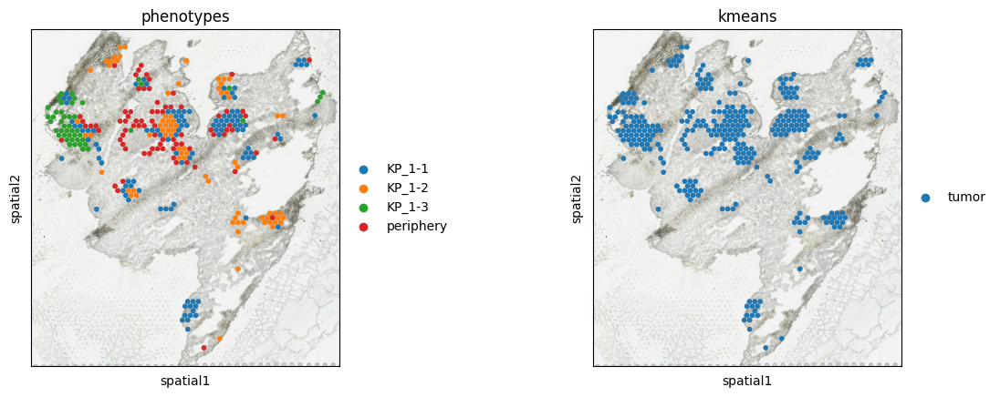

In [4]:
# Filter out CRISPR-KO regions
adata_filtered = adata_filtered[~adata_filtered.obs["phenotypes"].isin(["Tgfbr2_1", "Jak2_1"])].copy()
sc.pl.spatial(adata_filtered, img_key="hires", color=["phenotypes", 'kmeans'], size=1.5)

In [5]:
adata_tmp = adata_filtered.copy()
sc.pp.normalize_total(adata_tmp, target_sum=1e4)
sc.pp.log1p(adata_tmp)
sc.pp.highly_variable_genes(adata_tmp, n_top_genes=2500)

# Start with the HVG mask
hvg_mask = adata_tmp.var["highly_variable"].copy()

# List of genes to force-keep
forced_genes = ["Tgfbr2", "Jak2", 'Socs1', 'Ifngr2']

# Ensure they exist in the var_names
for g in forced_genes:
    if g in adata_tmp.var_names:
        hvg_mask.loc[g] = True
    else:
        print(f"⚠️ Gene {g} not found in adata.var_names")

# Now subset using the updated mask
adata_hvg = adata_filtered[:, hvg_mask].copy()
adata_hvg = adata_hvg[adata_hvg.obs["phenotypes"].notna()].copy()

print(f"Final HVG count: {hvg_mask.sum()}")  # should be 1004 if both are present

Final HVG count: 2504


In [6]:
adata_hvg.write_h5ad('../Data/processedData3/rna_modality.h5ad')

In [7]:
adata_hvg = sc.read('../Data/processedData3/rna_modality.h5ad')
adata_hvg

AnnData object with n_obs × n_vars = 311 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'dendrogram_clusters', 'hvg', 'kmeans_colors', 'leiden', 'neighbors', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'raw_count'
    obsp: 'connectivities', 'distances'

## Activity

In [8]:
from scminer_activity_to_adata import (
    create_adata_from_activity_matrix,
    compare_adata_objects,
)

import anndata as ad

In [9]:
activity = create_adata_from_activity_matrix(
    adata,
    "../Data/scMINER/PerturbMap_scminer_mtx_kp12.csv"
)
compare_adata_objects(adata, activity)
activity.write("../Data/scMINER/perturbmap_activity_matrix_full_v3.h5ad")

Found 478 common cells between datasets
Created new AnnData object:
  - Shape: (478, 8714)
  - Observations (cells): 478
  - Variables (activities): 8714
  - Preserved metadata: obs(18), obsm(3), obsp(2), uns(10)

Verifying alignment:
  - First 3 cell barcodes in new_adata: ['AAACCTCATGAAGTTG-1', 'AAACGAGACGGTTGAT-1', 'AAACTCGTGATATAAG-1']
  - First 3 cell barcodes in activity data: ['AAACCTCATGAAGTTG-1', 'AAACGAGACGGTTGAT-1', 'AAACTCGTGATATAAG-1']
  - Spatial coordinates shape: (478, 2)
=== AnnData Comparison ===
Original shape: (4992, 32289)
New shape: (478, 8714)
Common cells: 478
Original .obs columns: ['in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans']
New .obs columns: ['i

X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.


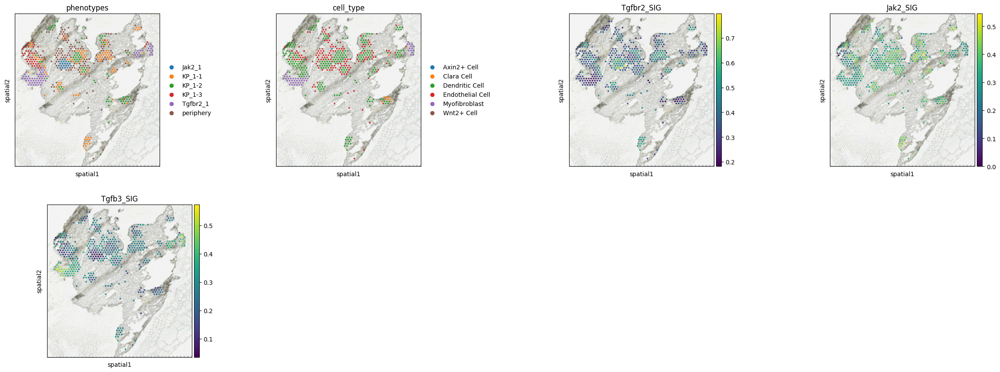

In [15]:
sc.pl.spatial(activity, img_key="hires", color=["phenotypes", "cell_type", 'Tgfbr2_SIG', 'Jak2_SIG', 'Tgfb3_SIG'])

In [10]:
# Run HVG selection on activity matrix, independently from the RNA modality
sc.pp.highly_variable_genes(activity, n_top_genes=2500)

# Copy the HVG mask
hvg_mask = activity.var["highly_variable"].copy()

# Force-include these genes
forced_genes = ["Tgfbr2_SIG", "Jak2_SIG", "Socs1_SIG", "Ifngr2_SIG"]

for g in forced_genes:
    if g in activity.var_names:
        hvg_mask.loc[g] = True
    else:
        print(f"⚠️ Gene {g} not found in activity.var_names")

# Subset with the updated mask
activity_hvg = activity[:, hvg_mask].copy()

print(f"Final HVG count: {hvg_mask.sum()}")

Final HVG count: 2503


In [11]:
common_spots = adata_hvg.obs_names.intersection(activity_hvg.obs_names)

# If you expect perfect overlap, this ensures the same order as 'smaller'
activity_aligned = activity_hvg[common_spots].copy()
activity_aligned = activity_aligned[adata_hvg.obs_names.intersection(activity_aligned.obs_names)].copy()

print("Final shape (spots × HVGs):", activity_aligned.n_obs, "×", activity_aligned.n_vars)

Final shape (spots × HVGs): 311 × 2503


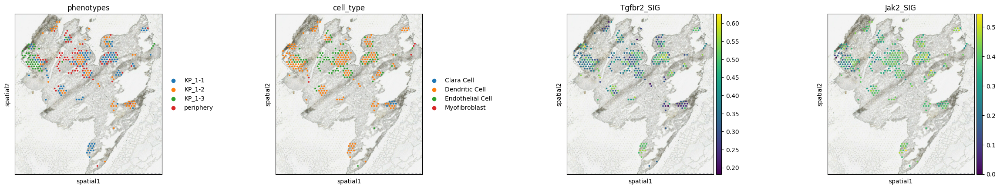

In [11]:
sc.pl.spatial(activity_aligned, img_key="hires", color=["phenotypes", "cell_type", 'Tgfbr2_SIG', 'Jak2_SIG'])

In [12]:
activity_aligned.write_h5ad('../Data/processedData3/activity_modality.h5ad')

## Flux

In [13]:
flux = sc.read('../Data/fluxestimator/flux_pertmap.h5ad')
flux

AnnData object with n_obs × n_vars = 4992 × 70
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans', 'has_flux_data', 'flux_data_source'
    var: 'flux_type', 'flux_units', 'metabolite_category'
    uns: 'clusters_colors', 'dendrogram_clusters', 'flux_info', 'hvg', 'leiden', 'neighbors', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    obsp: 'connectivities', 'distances'

In [14]:
common_spots = adata_hvg.obs_names.intersection(flux.obs_names)

# Overlap process with original adata
flux_aligned = flux[common_spots].copy()
flux_aligned = flux_aligned[adata_hvg.obs_names.intersection(flux_aligned.obs_names)].copy()

print("Final shape (spots × HVGs):", flux_aligned.n_obs, "×", flux_aligned.n_vars)

Final shape (spots × HVGs): 311 × 70


In [15]:
flux_aligned.write_h5ad('../Data/processedData3/flux_modality.h5ad')

## Niche

In [ ]:
# niche = run_niche_pipeline(
#     adata_in = adata_filtered,
#     output_path = "../Data/processedData3/niche_modality.h5ad",
#     reference_adata_path = "../Data/processedData3/rna_modality.h5ad",
#     overwrite = True,
#     log_level = "INFO",
# )

In [16]:
# same folder as your notebook
from niche_unitednet import run_niche_pipeline

niche = run_niche_pipeline(
    adata_in=adata_filtered,
    output_path="../Data/processedData3/niche_modality.h5ad",
    k=15,
    distance_type="euclidean",
    weight_mode="inverse",   # or "uniform" / "gaussian"
    include_self=False,
    pheno_csv="../Data/PertMap_metadata/spot_annotation_KP1.csv",
    pheno_barcode_col="barcode",
    pheno_cols=["phenotypes", "kmeans"],
    reference_adata_path='../Data/processedData3/rna_modality.h5ad',       # or "reference.h5ad"
    relabel_barcodes_to_reference=False,
    overwrite=True,
    log_level="INFO",
)
niche

2025-12-07 11:23:42,746 - INFO - Using provided AnnData object: (311, 32289)
2025-12-07 11:23:42,859 - INFO - Normalized barcodes.
2025-12-07 11:23:42,863 - INFO - Barcode overlap: 311 / 311 cells
2025-12-07 11:23:42,864 - INFO - Added phenotype column: phenotypes (311/311 cells matched, type: category)
2025-12-07 11:23:42,864 - INFO - Added phenotype column: kmeans (311/311 cells matched, type: category)
2025-12-07 11:23:43,337 - INFO - Subset to reference: (311, 32289)
2025-12-07 11:23:43,374 - INFO - Computed 3804 edges (k=15, metric=euclidean).


X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.


2025-12-07 11:23:43,947 - INFO - Saved niche AnnData to: ../Data/processedData3/niche_modality.h5ad
=== Barcode / Coordinate sanity check ===
Same barcodes & order: True
Same grid coords     : True
Same pixel coords    : True
Max abs pixel diff   : 0.000000


AnnData object with n_obs × n_vars = 311 × 32289
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'dendrogram_clusters', 'hvg', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'umap', 'phenotypes_colors', 'kmeans_colors', 'modality', 'niche_method'
    obsm: 'X_pca', 'X_umap', 'spatial'

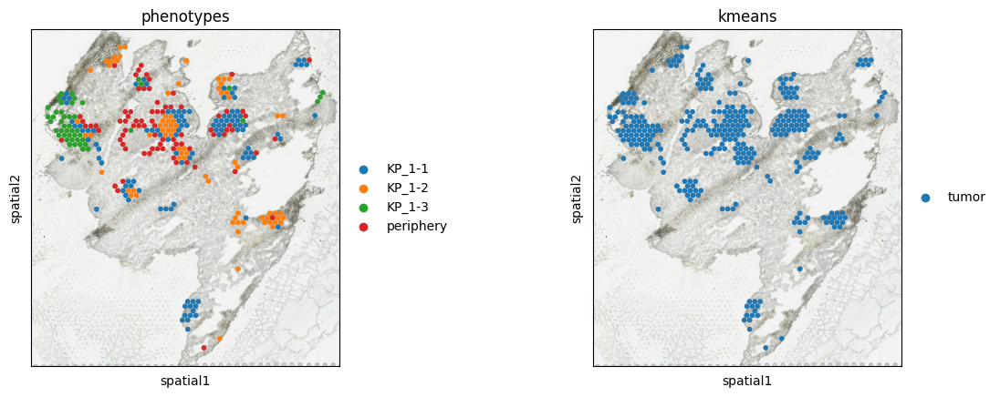

In [17]:
sc.pl.spatial(niche, img_key="hires", color=["phenotypes", 'kmeans'], size=1.5)

In [18]:
#  Get the HVG gene names
hvg_genes = adata_hvg.var_names

#  Intersect with genes available in niche
common_genes = hvg_genes.intersection(niche.var_names)

print(f"Requested HVGs: {len(hvg_genes)}")
print(f"Found in niche: {len(common_genes)}")

# Subset niche to those exact HVGs (keeping order of adata_hvg)
niche_hvg = niche[:, [g for g in hvg_genes if g in common_genes]].copy()

print("Final shape (spots × genes):", niche_hvg.n_obs, "×", niche_hvg.n_vars)

Requested HVGs: 2504
Found in niche: 2504
Final shape (spots × genes): 311 × 2504


In [19]:
niche_hvg.write_h5ad('../Data/processedData3/niche_modality.h5ad')

In [ ]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns

def calculate_niche_statistics(adata_filtered, niche_data, layer_name='niche'):
    """
    Calculate comprehensive statistics for niche modality and filtered AnnData
    
    Parameters:
    -----------
    adata_filtered : AnnData
        Filtered spatial transcriptomics data
    niche_data : np.ndarray, sparse matrix, or AnnData
        Niche expression data (cells x genes)
        Can be a matrix or AnnData object
    layer_name : str
        Name to store niche data in adata.layers
    """
    
    # Handle different input types for niche_data
    if hasattr(niche_data, 'X'):  # It's an AnnData object
        niche_matrix = niche_data.X
        print("Detected AnnData input for niche")
    else:  # It's already a matrix
        niche_matrix = niche_data
    
    # Store niche in adata for easier comparison
    adata_filtered.layers[layer_name] = niche_matrix
    
    print("="*70)
    print("BASIC DATASET STATISTICS")
    print("="*70)
    
    # Dataset dimensions
    print(f"\nDataset shape: {adata_filtered.shape}")
    print(f"  - Number of cells/spots: {adata_filtered.n_obs}")
    print(f"  - Number of genes: {adata_filtered.n_vars}")
    
    # Get expression matrices as dense arrays
    if hasattr(adata_filtered.X, 'toarray'):
        X_original = adata_filtered.X.toarray()
    else:
        X_original = np.array(adata_filtered.X)
    
    if hasattr(niche_matrix, 'toarray'):
        X_niche = niche_matrix.toarray()
    else:
        X_niche = np.array(niche_matrix)
    
    print("\n" + "="*70)
    print("EXPRESSION DISTRIBUTION STATISTICS")
    print("="*70)
    
    # Original expression stats
    print("\n--- Original Expression ---")
    print(f"Mean expression per cell: {X_original.mean(axis=1).mean():.4f} ± {X_original.mean(axis=1).std():.4f}")
    print(f"Mean expression per gene: {X_original.mean(axis=0).mean():.4f} ± {X_original.mean(axis=0).std():.4f}")
    print(f"Overall mean: {X_original.mean():.4f}")
    print(f"Overall std: {X_original.std():.4f}")
    print(f"Overall median: {np.median(X_original):.4f}")
    print(f"Min value: {X_original.min():.4f}")
    print(f"Max value: {X_original.max():.4f}")
    print(f"Sparsity: {(X_original == 0).sum() / X_original.size * 100:.2f}%")
    
    # Niche expression stats
    print("\n--- Niche Expression ---")
    print(f"Mean expression per cell: {X_niche.mean(axis=1).mean():.4f} ± {X_niche.mean(axis=1).std():.4f}")
    print(f"Mean expression per gene: {X_niche.mean(axis=0).mean():.4f} ± {X_niche.mean(axis=0).std():.4f}")
    print(f"Overall mean: {X_niche.mean():.4f}")
    print(f"Overall std: {X_niche.std():.4f}")
    print(f"Overall median: {np.median(X_niche):.4f}")
    print(f"Min value: {X_niche.min():.4f}")
    print(f"Max value: {X_niche.max():.4f}")
    print(f"Sparsity: {(X_niche == 0).sum() / X_niche.size * 100:.2f}%")
    
    # Smoothing effect
    print("\n--- Smoothing Effect ---")
    original_cv = X_original.std(axis=0) / (X_original.mean(axis=0) + 1e-10)
    niche_cv = X_niche.std(axis=0) / (X_niche.mean(axis=0) + 1e-10)
    print(f"Mean CV (original): {np.mean(original_cv[np.isfinite(original_cv)]):.4f}")
    print(f"Mean CV (niche): {np.mean(niche_cv[np.isfinite(niche_cv)]):.4f}")
    print(f"CV reduction: {(1 - np.mean(niche_cv[np.isfinite(niche_cv)]) / np.mean(original_cv[np.isfinite(original_cv)])) * 100:.2f}%")
    
    print("\n" + "="*70)
    print("GENE-LEVEL STATISTICS")
    print("="*70)
    
    # Per-gene comparison
    gene_stats = pd.DataFrame({
        'gene': adata_filtered.var_names,
        'original_mean': X_original.mean(axis=0),
        'original_std': X_original.std(axis=0),
        'niche_mean': X_niche.mean(axis=0),
        'niche_std': X_niche.std(axis=0),
        'original_nonzero': (X_original > 0).sum(axis=0),
        'niche_nonzero': (X_niche > 0).sum(axis=0)
    })
    
    gene_stats['std_ratio'] = gene_stats['niche_std'] / (gene_stats['original_std'] + 1e-10)
    gene_stats['detection_increase'] = gene_stats['niche_nonzero'] - gene_stats['original_nonzero']
    
    print(f"\nTop 10 most expressed genes (original):")
    print(gene_stats.nlargest(10, 'original_mean')[['gene', 'original_mean', 'niche_mean']])
    
    print(f"\nTop 10 genes with highest smoothing (std reduction):")
    print(gene_stats.nsmallest(10, 'std_ratio')[['gene', 'original_std', 'niche_std', 'std_ratio']])
    
    print("\n" + "="*70)
    print("CELL/SPOT-LEVEL STATISTICS")
    print("="*70)
    
    # Per-cell comparison
    cell_stats = pd.DataFrame({
        'original_total': X_original.sum(axis=1),
        'niche_total': X_niche.sum(axis=1),
        'original_detected': (X_original > 0).sum(axis=1),
        'niche_detected': (X_niche > 0).sum(axis=1)
    })
    
    print(f"\nGenes detected per cell:")
    print(f"  Original: {cell_stats['original_detected'].mean():.1f} ± {cell_stats['original_detected'].std():.1f}")
    print(f"  Niche: {cell_stats['niche_detected'].mean():.1f} ± {cell_stats['niche_detected'].std():.1f}")
    
    print(f"\nTotal expression per cell:")
    print(f"  Original: {cell_stats['original_total'].mean():.2f} ± {cell_stats['original_total'].std():.2f}")
    print(f"  Niche: {cell_stats['niche_total'].mean():.2f} ± {cell_stats['niche_total'].std():.2f}")
    
    print("\n" + "="*70)
    print("CORRELATION ANALYSIS")
    print("="*70)
    
    # Correlation between original and niche
    from scipy.stats import pearsonr, spearmanr
    
    # Flatten matrices for correlation
    X_orig_flat = X_original.flatten()
    X_niche_flat = X_niche.flatten()
    
    # Sample if too large
    if len(X_orig_flat) > 1000000:
        idx = np.random.choice(len(X_orig_flat), 1000000, replace=False)
        X_orig_flat = X_orig_flat[idx]
        X_niche_flat = X_niche_flat[idx]
    
    pearson_r, pearson_p = pearsonr(X_orig_flat, X_niche_flat)
    spearman_r, spearman_p = spearmanr(X_orig_flat, X_niche_flat)
    
    print(f"\nGlobal correlation (original vs niche):")
    print(f"  Pearson r: {pearson_r:.4f} (p={pearson_p:.2e})")
    print(f"  Spearman r: {spearman_r:.4f} (p={spearman_p:.2e})")
    
    # Gene-wise correlation
    gene_correlations = []
    for i in range(X_original.shape[1]):
        if X_original[:, i].std() > 0 and X_niche[:, i].std() > 0:
            r, _ = pearsonr(X_original[:, i], X_niche[:, i])
            gene_correlations.append(r)
    
    print(f"\nGene-wise correlation (mean): {np.mean(gene_correlations):.4f} ± {np.std(gene_correlations):.4f}")
    print(f"Median gene correlation: {np.median(gene_correlations):.4f}")
    
    return gene_stats, cell_stats


def plot_niche_diagnostics(adata_filtered, niche_data, figsize=(15, 10)):
    """
    Create diagnostic plots comparing original and niche expression
    
    Parameters:
    -----------
    adata_filtered : AnnData
        Filtered spatial transcriptomics data
    niche_data : np.ndarray, sparse matrix, or AnnData
        Niche expression data
    """
    # Handle different input types
    if hasattr(niche_data, 'X'):  # It's an AnnData object
        niche_matrix = niche_data.X
    else:  # It's already a matrix
        niche_matrix = niche_data
    
    # Convert to dense arrays
    if hasattr(adata_filtered.X, 'toarray'):
        X_original = adata_filtered.X.toarray()
    else:
        X_original = np.array(adata_filtered.X)
    
    if hasattr(niche_matrix, 'toarray'):
        X_niche = niche_matrix.toarray()
    else:
        X_niche = np.array(niche_matrix)
    
    fig, axes = plt.subplots(2, 3, figsize=figsize)
    
    # 1. Distribution comparison
    axes[0, 0].hist(X_original.flatten(), bins=50, alpha=0.5, label='Original', density=True)
    axes[0, 0].hist(X_niche.flatten(), bins=50, alpha=0.5, label='Niche', density=True)
    axes[0, 0].set_xlabel('Expression value')
    axes[0, 0].set_ylabel('Density')
    axes[0, 0].set_title('Expression Distribution')
    axes[0, 0].legend()
    axes[0, 0].set_yscale('log')
    
    # 2. Mean expression per cell
    axes[0, 1].scatter(X_original.mean(axis=1), X_niche.mean(axis=1), alpha=0.3, s=5)
    axes[0, 1].plot([X_original.mean(axis=1).min(), X_original.mean(axis=1).max()], 
                    [X_original.mean(axis=1).min(), X_original.mean(axis=1).max()], 
                    'r--', label='y=x')
    axes[0, 1].set_xlabel('Original mean expression')
    axes[0, 1].set_ylabel('Niche mean expression')
    axes[0, 1].set_title('Per-Cell Mean Expression')
    axes[0, 1].legend()
    
    # 3. Gene detection
    original_detect = (X_original > 0).sum(axis=1)
    niche_detect = (X_niche > 0).sum(axis=1)
    axes[0, 2].scatter(original_detect, niche_detect, alpha=0.3, s=5)
    axes[0, 2].plot([original_detect.min(), original_detect.max()],
                    [original_detect.min(), original_detect.max()], 'r--', label='y=x')
    axes[0, 2].set_xlabel('Genes detected (original)')
    axes[0, 2].set_ylabel('Genes detected (niche)')
    axes[0, 2].set_title('Gene Detection per Cell')
    axes[0, 2].legend()
    
    # 4. Variance comparison
    original_var = X_original.var(axis=0)
    niche_var = X_niche.var(axis=0)
    axes[1, 0].scatter(original_var, niche_var, alpha=0.3, s=5)
    axes[1, 0].plot([0, original_var.max()], [0, original_var.max()], 'r--', label='y=x')
    axes[1, 0].set_xlabel('Original variance')
    axes[1, 0].set_ylabel('Niche variance')
    axes[1, 0].set_title('Per-Gene Variance')
    axes[1, 0].set_xscale('log')
    axes[1, 0].set_yscale('log')
    axes[1, 0].legend()
    
    # 5. Coefficient of variation
    original_cv = X_original.std(axis=0) / (X_original.mean(axis=0) + 1e-10)
    niche_cv = X_niche.std(axis=0) / (X_niche.mean(axis=0) + 1e-10)
    valid = np.isfinite(original_cv) & np.isfinite(niche_cv)
    axes[1, 1].scatter(original_cv[valid], niche_cv[valid], alpha=0.3, s=5)
    axes[1, 1].plot([0, original_cv[valid].max()], [0, original_cv[valid].max()], 'r--', label='y=x')
    axes[1, 1].set_xlabel('Original CV')
    axes[1, 1].set_ylabel('Niche CV')
    axes[1, 1].set_title('Coefficient of Variation')
    axes[1, 1].legend()
    
    # 6. Sparsity per cell
    original_sparsity = (X_original == 0).sum(axis=1) / X_original.shape[1]
    niche_sparsity = (X_niche == 0).sum(axis=1) / X_niche.shape[1]
    axes[1, 2].hist(original_sparsity, bins=50, alpha=0.5, label='Original', density=True)
    axes[1, 2].hist(niche_sparsity, bins=50, alpha=0.5, label='Niche', density=True)
    axes[1, 2].set_xlabel('Sparsity (fraction of zeros)')
    axes[1, 2].set_ylabel('Density')
    axes[1, 2].set_title('Sparsity per Cell')
    axes[1, 2].legend()
    
    plt.tight_layout()
    return fig


# Example usage:
# If niche is an AnnData object:
# gene_stats, cell_stats = calculate_niche_statistics(adata_filtered, niche)
# fig = plot_niche_diagnostics(adata_filtered, niche)

# If niche is a matrix:
# gene_stats, cell_stats = calculate_niche_statistics(adata_filtered, niche_matrix)
# fig = plot_niche_diagnostics(adata_filtered, niche_matrix)

# plt.show()

In [ ]:
gene_stats, cell_stats = calculate_niche_statistics(adata_hvg, niche_hvg)
fig = plot_niche_diagnostics(adata_hvg, niche_hvg)
plt.show()

## UnitedNet inputs

In [20]:
from pm_splitter import split_any_modalities

paths = split_any_modalities(
    modalities={
        "rna": "../Data/processedData3/rna_modality.h5ad",
        "niche": "../Data/processedData3/niche_modality.h5ad",
        "activity": "../Data/processedData3/activity_modality.h5ad",
        "flux": "../Data/processedData3/flux_modality.h5ad"
    },
    output_dir="../Data/UnitedNet/input_data",
    dataset_id="KP2_1",
    train_size=0.80,
    random_state=42,
    stratify_col=None,     # or "phenotypes"
    stratify_on="rna",     # use labels from RNA.obs
)
paths

Train: 248, Test: 63
Saved: ../Data/UnitedNet/input_data/adata_rna_train_perturbmap_KP2_1.h5ad
Saved: ../Data/UnitedNet/input_data/adata_rna_test_perturbmap_KP2_1.h5ad
Saved: ../Data/UnitedNet/input_data/adata_niche_train_perturbmap_KP2_1.h5ad
Saved: ../Data/UnitedNet/input_data/adata_niche_test_perturbmap_KP2_1.h5ad
Saved: ../Data/UnitedNet/input_data/adata_activity_train_perturbmap_KP2_1.h5ad
Saved: ../Data/UnitedNet/input_data/adata_activity_test_perturbmap_KP2_1.h5ad
Saved: ../Data/UnitedNet/input_data/adata_flux_train_perturbmap_KP2_1.h5ad
Saved: ../Data/UnitedNet/input_data/adata_flux_test_perturbmap_KP2_1.h5ad
Splitting completed.
Files saved to: ../Data/UnitedNet/input_data


{'rna_train': PosixPath('../Data/UnitedNet/input_data/adata_rna_train_perturbmap_KP2_1.h5ad'),
 'rna_test': PosixPath('../Data/UnitedNet/input_data/adata_rna_test_perturbmap_KP2_1.h5ad'),
 'niche_train': PosixPath('../Data/UnitedNet/input_data/adata_niche_train_perturbmap_KP2_1.h5ad'),
 'niche_test': PosixPath('../Data/UnitedNet/input_data/adata_niche_test_perturbmap_KP2_1.h5ad'),
 'activity_train': PosixPath('../Data/UnitedNet/input_data/adata_activity_train_perturbmap_KP2_1.h5ad'),
 'activity_test': PosixPath('../Data/UnitedNet/input_data/adata_activity_test_perturbmap_KP2_1.h5ad'),
 'flux_train': PosixPath('../Data/UnitedNet/input_data/adata_flux_train_perturbmap_KP2_1.h5ad'),
 'flux_test': PosixPath('../Data/UnitedNet/input_data/adata_flux_test_perturbmap_KP2_1.h5ad')}

# Model Training/Fine-Tuning

In [21]:
import sys

sys.argv = [
    "uni_training_activity_flux_niche_capboost_supervised.py",
    "--data_path", "../Data/UnitedNet/input_data",
    "--dataset_id", "KP2_1",
    "--train_epochs", "40",
    "--finetune_epochs", "20",
    "--n_clusters", "4",                        # 4 supervised classes
    "--noise_level", "0.0", "0.02", "0.0",
    "--model_suffix", "supervised",
    "--timestamp",
    "--verbose",
    "--device", "cuda:0",

    # Scaling options (same as unsupervised version)
    "--scale_activity",
    "--scale_niche",
    "--scale_flux",

    # Optional label-aware cross-modal boost
    "--cmp_edge_activity_to_niche", "2.0",
]

from uni_training_activity_flux_niche_capboost_supervised import main
main()

Output directory: ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251207_112409
Edge-specific CMP enabled: Activity→Niche x2.0
Configuration saved to ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251207_112409/config.json
Seed set to 42. Device: cuda:0

=== Loading Data (Activity + Flux + Niche) ===
Loading activity_train: ../Data/UnitedNet/input_data/adata_activity_train_perturbmap_KP2_1.h5ad
Loading activity_test: ../Data/UnitedNet/input_data/adata_activity_test_perturbmap_KP2_1.h5ad
Loading flux_train: ../Data/UnitedNet/input_data/adata_flux_train_perturbmap_KP2_1.h5ad
Loading flux_test: ../Data/UnitedNet/input_data/adata_flux_test_perturbmap_KP2_1.h5ad
Loading niche_train: ../Data/UnitedNet/input_data/adata_niche_train_perturbmap_KP2_1.h5ad
Loading niche_test: ../Data/UnitedNet/input_data/adata_niche_test_perturbmap_KP2_1.h5ad

=== Validating Alignment ===

=== Applying Split Labels ===

=== Feature scaling ===
Saved scaling param

X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.



=== Configuring Model I/O from data (CapBoost Supervised) ===
Modality 0 (Activity): input/output = 2503
Modality 1 (Flux): input/output = 70
Modality 2 (Niche): input/output = 2504
Configuration saved to ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251207_112409/config_resolved.json

=== Training UnitedNet (CapBoost Supervised) ===
Training...
training


  2%|▎         | 1/40 [00:01<00:49,  1.26s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[-0.10744423 -0.05176447 -0.09040833]
                                [-1.23246849 -1.15084493 -0.88171399]
                                [-0.13298835 -0.05587957 -0.09899183]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


  5%|▌         | 2/40 [00:02<00:46,  1.22s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.07289056 -0.0144202   0.00707664]
                                [-0.76287305 -0.49722758 -0.59304893]
                                [-0.01826918 -0.01435209 -0.00758738]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


  8%|▊         | 3/40 [00:03<00:44,  1.20s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.28427631  0.00079918  0.10833786]
                                [-0.45511621 -0.21755627 -0.4480544 ]
                                [ 0.00625758 -0.00574496  0.00944766]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 10%|█         | 4/40 [00:04<00:42,  1.19s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.54022247  0.03924139  0.3546406 ]
                                [-0.28106678 -0.17440984 -0.42454481]
                                [ 0.02499576 -0.00228779  0.03481971]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 12%|█▎        | 5/40 [00:05<00:41,  1.19s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.63106984  0.11670468  0.549757  ]
                                [-0.16963641 -0.177148   -0.31940672]
                                [ 0.05040378  0.00239747  0.07587706]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 15%|█▌        | 6/40 [00:07<00:40,  1.18s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64175016  0.20876272  0.59025013]
                                [-0.10341813 -0.18909888 -0.24886093]
                                [ 0.06966548  0.00940217  0.1109127 ]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 18%|█▊        | 7/40 [00:08<00:38,  1.16s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64692366  0.29302984  0.60544485]
                                [-0.05778623 -0.19120978 -0.18844694]
                                [ 0.08303789  0.02022623  0.14726301]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 20%|██        | 8/40 [00:09<00:36,  1.15s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64877033  0.35821339  0.61666685]
                                [-0.08477376 -0.17225894 -0.11995192]
                                [ 0.09093674  0.03361315  0.18390973]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 22%|██▎       | 9/40 [00:10<00:35,  1.14s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64837629  0.38281605  0.61575359]
                                [-0.07403681 -0.11756376 -0.09959742]
                                [ 0.09488555  0.03984651  0.20284355]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 25%|██▌       | 10/40 [00:11<00:33,  1.13s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64909941  0.43820727  0.62361091]
                                [-0.08099553 -0.03866259 -0.10488306]
                                [ 0.09723525  0.05890021  0.23118976]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 28%|██▊       | 11/40 [00:12<00:32,  1.13s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64925897  0.48567599  0.62342978]
                                [-0.05558742 -0.00738281 -0.09053671]
                                [ 0.10000749  0.07876876  0.24584657]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 30%|███       | 12/40 [00:13<00:31,  1.14s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64922738  0.51926053  0.62406623]
                                [-0.04430337  0.01678141 -0.08294155]
                                [ 0.10572472  0.09608442  0.27715182]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 32%|███▎      | 13/40 [00:15<00:30,  1.15s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.6498391   0.54105055  0.63221937]
                                [-0.02624773  0.03850578 -0.05923058]
                                [ 0.11264067  0.11507957  0.29491627]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 35%|███▌      | 14/40 [00:16<00:30,  1.15s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64858896  0.56276464  0.63317192]
                                [-0.01099682  0.0585807  -0.05907673]
                                [ 0.12920202  0.13129947  0.31705803]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 38%|███▊      | 15/40 [00:17<00:29,  1.17s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64903599  0.57346147  0.63654399]
                                [-0.04257377  0.0636251  -0.02437793]
                                [ 0.1348221   0.14836241  0.33780953]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 40%|████      | 16/40 [00:18<00:28,  1.17s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64855456  0.58786923  0.64141643]
                                [-0.00206045  0.08339732 -0.03808013]
                                [ 0.1462726   0.1674301   0.35335875]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 42%|████▎     | 17/40 [00:19<00:27,  1.18s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64335918  0.59212083  0.62527263]
                                [-0.02686153  0.09653534 -0.00942416]
                                [ 0.13959254  0.17632023  0.37364751]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 45%|████▌     | 18/40 [00:20<00:25,  1.18s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64218605  0.61094749  0.64148736]
                                [-0.00689249  0.10724581  0.01200552]
                                [ 0.16798076  0.20424008  0.39980838]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 48%|████▊     | 19/40 [00:22<00:24,  1.18s/it]



Metrics                        Value
-----------------------------  ---------------------------------------------------
R2                             [[ 6.49435639e-01  6.11970246e-01  6.45673811e-01]
                                [-2.34840598e-04  1.20480113e-01  1.32883228e-02]
                                [ 1.68714672e-01  2.22105563e-01  4.22086954e-01]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0
model saved at None/train_epoch_20.pt 



 50%|█████     | 20/40 [00:23<00:23,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.64829147 0.62240362 0.64696354]
                                [0.0059352  0.13624279 0.02856154]
                                [0.17824182 0.23781383 0.43748859]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 52%|█████▎    | 21/40 [00:24<00:22,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.64776832 0.62761921 0.64758432]
                                [0.0011964  0.15028943 0.04500584]
                                [0.15107812 0.25187296 0.45174253]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 55%|█████▌    | 22/40 [00:25<00:21,  1.18s/it]



Metrics                        Value
-----------------------------  ---------------------------------------------------
R2                             [[ 6.49886549e-01  6.34298503e-01  6.48502588e-01]
                                [-2.23124880e-04  1.60430551e-01  4.67127226e-02]
                                [ 1.57569185e-01  2.65531242e-01  4.50888038e-01]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 57%|█████▊    | 23/40 [00:26<00:20,  1.18s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64987314  0.6376313   0.64889145]
                                [-0.00296722  0.17288937  0.05184899]
                                [ 0.18123463  0.28239849  0.47869298]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 60%|██████    | 24/40 [00:28<00:18,  1.19s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.6497159  0.64198381 0.64919466]
                                [0.0079005  0.18955109 0.06287698]
                                [0.17960033 0.29658806 0.49061677]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 62%|██████▎   | 25/40 [00:29<00:17,  1.19s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65070814 0.64409697 0.64961839]
                                [0.00717389 0.20512863 0.06998358]
                                [0.17540284 0.31317133 0.5038262 ]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 65%|██████▌   | 26/40 [00:30<00:16,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.64808041 0.64464164 0.64973205]
                                [0.00880009 0.22032982 0.06995806]
                                [0.19553293 0.32637799 0.51572657]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 68%|██████▊   | 27/40 [00:31<00:15,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65047711 0.64641494 0.64930153]
                                [0.01810632 0.23571889 0.07769961]
                                [0.1884238  0.34087652 0.53032434]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 70%|███████   | 28/40 [00:32<00:14,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65069532 0.64877594 0.64981532]
                                [0.01490186 0.24818127 0.08852917]
                                [0.18756764 0.35655957 0.54575902]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 72%|███████▎  | 29/40 [00:33<00:12,  1.16s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.64959049 0.64946294 0.6492101 ]
                                [0.01080412 0.26375952 0.09698935]
                                [0.19299126 0.37028778 0.55678344]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 75%|███████▌  | 30/40 [00:35<00:11,  1.15s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.6515044  0.65182173 0.65136015]
                                [0.01148834 0.27559337 0.08972412]
                                [0.21202824 0.38638532 0.56684315]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 78%|███████▊  | 31/40 [00:36<00:10,  1.15s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65112656 0.65243512 0.65130728]
                                [0.01885567 0.29035282 0.09349203]
                                [0.23179117 0.40324381 0.58067977]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 80%|████████  | 32/40 [00:37<00:09,  1.16s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.64880759 0.65379369 0.64933515]
                                [0.00803733 0.29871595 0.10765947]
                                [0.23820566 0.4153299  0.58722615]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 82%|████████▎ | 33/40 [00:38<00:08,  1.17s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65213501 0.65435451 0.65264833]
                                [0.02957946 0.31230214 0.1127294 ]
                                [0.25926185 0.43063462 0.60670084]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 85%|████████▌ | 34/40 [00:39<00:07,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65251786 0.65712982 0.65303463]
                                [0.03616092 0.32463616 0.12172752]
                                [0.27942041 0.44666991 0.61528331]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 88%|████████▊ | 35/40 [00:40<00:05,  1.18s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64899349  0.64538693  0.62403017]
                                [-0.09291446  0.31983995  0.05722465]
                                [ 0.23306352  0.43816999  0.50143194]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 90%|█████████ | 36/40 [00:42<00:04,  1.19s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65301627 0.65327191 0.63628376]
                                [0.03595959 0.339733   0.10322864]
                                [0.25631031 0.46051586 0.61045527]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 92%|█████████▎| 37/40 [00:43<00:03,  1.19s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.6471135   0.65433484  0.60928601]
                                [-0.05681403  0.34876353  0.07278067]
                                [ 0.1642478   0.47678715  0.5899837 ]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 95%|█████████▌| 38/40 [00:44<00:02,  1.19s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65120447 0.65655714 0.63461095]
                                [0.0410993  0.35898221 0.09130262]
                                [0.31043875 0.50195926 0.63555187]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 98%|█████████▊| 39/40 [00:45<00:01,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65308148 0.66095203 0.64115942]
                                [0.05296478 0.37562644 0.11550865]
                                [0.32422766 0.50921297 0.65450877]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0
model saved at None/train_epoch_40.pt 



100%|██████████| 40/40 [00:46<00:00,  1.17s/it]




Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65329885 0.66169482 0.64606118]
                                [0.04580369 0.38777691 0.11892899]
                                [0.33843702 0.52934897 0.66517884]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  0  0 63]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0
Finetuning (train+test concatenated per modality)...
finetuning


  5%|▌         | 1/20 [00:01<00:27,  1.45s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65023065 0.52142096 0.52349406]
                                [0.01037143 0.28106999 0.02884916]
                                [0.26698041 0.38554022 0.6289283 ]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 10%|█         | 2/20 [00:02<00:26,  1.45s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.65252042  0.54647732  0.55518532]
                                [-0.00095821  0.27486837  0.02161161]
                                [ 0.27246869  0.39622229  0.64444184]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 15%|█▌        | 3/20 [00:04<00:24,  1.45s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.65045267  0.54770154  0.58567208]
                                [-0.01601113  0.28662851  0.03848371]
                                [ 0.27421916  0.4039959   0.65740311]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 20%|██        | 4/20 [00:05<00:23,  1.45s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65240097 0.57133669 0.6012885 ]
                                [0.0184368  0.29249832 0.02952392]
                                [0.29947871 0.42287809 0.66394991]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 25%|██▌       | 5/20 [00:07<00:21,  1.45s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65080792 0.56866956 0.59141034]
                                [0.00411663 0.281607   0.02103846]
                                [0.3075546  0.43474337 0.66744137]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 30%|███       | 6/20 [00:08<00:20,  1.45s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.65377671  0.58309102  0.60955924]
                                [-0.02666061  0.2499443   0.03155335]
                                [ 0.24393693  0.44028831  0.6557399 ]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 35%|███▌      | 7/20 [00:10<00:18,  1.45s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65181798 0.57767469 0.6247474 ]
                                [0.00312704 0.28498799 0.0130239 ]
                                [0.28119418 0.45838246 0.6647507 ]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 40%|████      | 8/20 [00:11<00:17,  1.42s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.65544051  0.60220981  0.63882041]
                                [-0.00983059  0.26975244 -0.02977689]
                                [ 0.2788057   0.47024235  0.66574299]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 45%|████▌     | 9/20 [00:12<00:15,  1.42s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.65406299  0.60814893  0.63921165]
                                [-0.02469961  0.25953183 -0.00955718]
                                [ 0.30093923  0.47086123  0.68536788]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 50%|█████     | 10/20 [00:14<00:14,  1.42s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.65532541  0.5805704   0.64339036]
                                [-0.01381857  0.26496235  0.02533587]
                                [ 0.29721877  0.48205498  0.67984682]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 55%|█████▌    | 11/20 [00:15<00:12,  1.43s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.65523845  0.62447435  0.6417712 ]
                                [-0.01567308  0.28850019  0.01754661]
                                [ 0.30622455  0.49207523  0.68178755]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 60%|██████    | 12/20 [00:17<00:11,  1.43s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.65510213  0.60739332  0.63672215]
                                [-0.04117745  0.255876   -0.0953991 ]
                                [ 0.31943622  0.491833    0.67409176]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 65%|██████▌   | 13/20 [00:18<00:10,  1.44s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.65059167  0.54273427  0.53442049]
                                [-0.04552595  0.27663675 -0.01718319]
                                [ 0.21922238  0.45001212  0.60585445]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 70%|███████   | 14/20 [00:20<00:08,  1.44s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.65388298  0.60626632  0.5991528 ]
                                [-0.01918104  0.31010458  0.0052813 ]
                                [ 0.24220705  0.48642311  0.68002385]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 75%|███████▌  | 15/20 [00:21<00:07,  1.44s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65404159 0.603423   0.6155597 ]
                                [0.0020575  0.31886336 0.01158902]
                                [0.26688498 0.50858909 0.68853378]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 80%|████████  | 16/20 [00:22<00:05,  1.43s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65644675 0.60465038 0.62021112]
                                [0.00919938 0.32208234 0.0208719 ]
                                [0.27760732 0.52678531 0.70454258]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 85%|████████▌ | 17/20 [00:24<00:04,  1.43s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65823299 0.62671393 0.63182211]
                                [0.0042125  0.34015021 0.02599333]
                                [0.29306215 0.53802401 0.71341676]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 90%|█████████ | 18/20 [00:25<00:02,  1.44s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65779114 0.63420558 0.63594514]
                                [0.00580305 0.33804053 0.02453587]
                                [0.32485586 0.54603523 0.72388291]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0


 95%|█████████▌| 19/20 [00:27<00:01,  1.44s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65992272 0.64348209 0.6260196 ]
                                [0.01894325 0.35265628 0.05117601]
                                [0.33061087 0.56247842 0.7315042 ]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0
model saved at None/finetune_epoch_20.pt 



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.6604591  0.63837761 0.63970125]
                                [0.01093421 0.32062101 0.04206911]
                                [0.34798285 0.56359285 0.7317611 ]]
Confusion Matrix               [[110   0   0   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   0   0  79]]
Accuracy                       1.0
Adjusted Rand Index            1.0
Normalized Mutual Information  1.0
Training complete.

=== Saving Model & Summary ===
Saved model to ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251207_112409/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251207_112527.pkl
Summary saved to ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251207_112409/training_summary.json

=== Notes =

In [36]:
import sys
sys.argv = [
    "uni_training_activity_flux_niche_capboost_v1.py",     # adjust for features (1000, 1000, 70)
    "--data_path", "../Data/UnitedNet/input_data",
    "--dataset_id", "KP2_1",
    "--train_epochs", "40",
    "--finetune_epochs", "20",
    "--n_clusters", "4",
    "--noise_level", "0.0", "0.02", "0.0",
    "--model_suffix", "capboost",
    "--timestamp",
    "--verbose",
    "--device", "cuda:0",
    "--scale_activity",
    "--scale_niche",
    "--cmp_edge_activity_to_niche", "2.0",
]
from uni_training_activity_flux_niche_capboost_v1 import main
main()

Output directory: ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_v1_20251026_072125
Edge‑specific CMP enabled: Activity→Niche x2.0
Configuration saved to ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_v1_20251026_072125/config.json
Seed set to 42. Device: cuda:0

=== Loading Data (Activity + Flux + Niche) ===
Loading activity_train: ../Data/UnitedNet/input_data/adata_activity_train_perturbmap_KP2_1.h5ad
Loading activity_test: ../Data/UnitedNet/input_data/adata_activity_test_perturbmap_KP2_1.h5ad
Loading flux_train: ../Data/UnitedNet/input_data/adata_flux_train_perturbmap_KP2_1.h5ad
Loading flux_test: ../Data/UnitedNet/input_data/adata_flux_test_perturbmap_KP2_1.h5ad
Loading niche_train: ../Data/UnitedNet/input_data/adata_niche_train_perturbmap_KP2_1.h5ad
Loading niche_test: ../Data/UnitedNet/input_data/adata_niche_test_perturbmap_KP2_1.h5ad

=== Validating Alignment ===

=== Applying Split Labels ===

=== Feature scaling ===
Saved scaling params: flux_zscore_m

X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.



=== Configuring Model I/O from data (CapBoost) ===
Modality 0 (Activity): input/output = 2503
Modality 1 (Flux): input/output = 70
Modality 2 (Niche): input/output = 2504
Configuration saved to ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_v1_20251026_072125/config_resolved.json

=== Training UnitedNet (CapBoost) ===
Training...
training


  2%|▎         | 1/40 [00:01<00:45,  1.17s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.02107703 -0.05243786 -0.05003579]
                                [-0.56539118 -1.57385576 -1.79599333]
                                [-0.03730411 -0.05298834 -0.03533534]]
Confusion Matrix               [[76  2 13  2]
                                [ 3 28  4 20]
                                [ 4  2 31  0]
                                [55  1  6  1]]
Accuracy                       0.5483870967741935
Adjusted Rand Index            0.3347363258912966
Normalized Mutual Information  0.39040658532445066


  5%|▌         | 2/40 [00:02<00:38,  1.02s/it]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.13144033 -0.01666736 -0.00104993]
                                [-0.24010698 -0.70429516 -0.68252909]
                                [-0.00365134 -0.01721338 -0.00328085]]
Confusion Matrix               [[87  0  4  2]
                                [ 3 32  2 18]
                                [ 2  0 35  0]
                                [63  0  0  0]]
Accuracy                       0.6209677419354839
Adjusted Rand Index            0.4523084663477042
Normalized Mutual Information  0.5968747560497029


  8%|▊         | 3/40 [00:03<00:36,  1.02it/s]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.34316558  0.00356865  0.07613835]
                                [-0.13243461 -0.36772311 -0.30957404]
                                [ 0.00447434 -0.00785416  0.01067222]]
Confusion Matrix               [[93  0  0  0]
                                [ 1 43  0 11]
                                [ 2  0 35  0]
                                [63  0  0  0]]
Accuracy                       0.6895161290322581
Adjusted Rand Index            0.5311022453755964
Normalized Mutual Information  0.7276422729179295


 10%|█         | 4/40 [00:03<00:34,  1.06it/s]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.55160272  0.04465197  0.251196  ]
                                [-0.10780698 -0.24913414 -0.16116896]
                                [ 0.01614527 -0.00455015  0.03310181]]
Confusion Matrix               [[93  0  0  0]
                                [ 1 52  0  2]
                                [ 3  0 34  0]
                                [63  0  0  0]]
Accuracy                       0.7217741935483871
Adjusted Rand Index            0.5500994135628428
Normalized Mutual Information  0.7440900122105736


 12%|█▎        | 5/40 [00:04<00:32,  1.08it/s]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.62721294  0.10617255  0.37462696]
                                [-0.13155559 -0.17670189 -0.12863348]
                                [ 0.03641175 -0.00157041  0.07710498]]
Confusion Matrix               [[92  0  1  0]
                                [ 0 52  0  3]
                                [ 0  0 36  1]
                                [ 1  0  0 62]]
Accuracy                       0.9758064516129032
Adjusted Rand Index            0.940530457828461
Normalized Mutual Information  0.917750568603453


 15%|█▌        | 6/40 [00:05<00:31,  1.09it/s]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64468062  0.17618769  0.44716087]
                                [-0.04718406 -0.12596545 -0.07492287]
                                [ 0.06212181  0.00597609  0.13897735]]
Confusion Matrix               [[92  0  1  0]
                                [ 0 53  0  2]
                                [ 0  0 37  0]
                                [ 1  1  0 61]]
Accuracy                       0.9798387096774194
Adjusted Rand Index            0.9486377990338599
Normalized Mutual Information  0.9269219704300753


 18%|█▊        | 7/40 [00:06<00:30,  1.09it/s]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64798075  0.23390855  0.48944771]
                                [-0.03832164 -0.09411594 -0.06585437]
                                [ 0.08210465  0.02031873  0.18703692]]
Confusion Matrix               [[93  0  0  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9959677419354839
Adjusted Rand Index            0.990388571353042
Normalized Mutual Information  0.9846576536475461


 20%|██        | 8/40 [00:07<00:29,  1.09it/s]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64819646  0.29911783  0.51436967]
                                [-0.02780508 -0.05770561 -0.04277364]
                                [ 0.09776769  0.03571326  0.22483236]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 22%|██▎       | 9/40 [00:08<00:28,  1.09it/s]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64844185  0.35647443  0.5363313 ]
                                [-0.00193635 -0.03351425 -0.03063146]
                                [ 0.12182746  0.05518495  0.26740536]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 25%|██▌       | 10/40 [00:09<00:27,  1.09it/s]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64597416  0.40051681  0.55817026]
                                [ 0.00951441 -0.01092601 -0.01471403]
                                [ 0.14423482  0.07456269  0.3036831 ]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 28%|██▊       | 11/40 [00:10<00:26,  1.09it/s]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.64676452  0.43963572  0.55631369]
                                [-0.00956736  0.01093337 -0.00515459]
                                [ 0.16660151  0.09794045  0.33524558]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 30%|███       | 12/40 [00:11<00:25,  1.09it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.64639544 0.47700697 0.58104658]
                                [0.01498065 0.03156164 0.01867094]
                                [0.19131358 0.12112555 0.3607668 ]]
Confusion Matrix               [[92  0  1  0]
                                [ 0 55  0  0]
                                [ 0  1 36  0]
                                [ 0  1  0 62]]
Accuracy                       0.9879032258064516
Adjusted Rand Index            0.9722786897693682
Normalized Mutual Information  0.9548337597849168


 32%|███▎      | 13/40 [00:12<00:24,  1.09it/s]



Metrics                        Value
-----------------------------  ---------------------------------------
R2                             [[ 0.6471684   0.50705093  0.5545072 ]
                                [ 0.01208243  0.05633138 -0.01933439]
                                [ 0.22005202  0.14846553  0.3870824 ]]
Confusion Matrix               [[91  1  1  0]
                                [ 0 55  0  0]
                                [ 0  1 36  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9600537740077825
Normalized Mutual Information  0.9389173817120637


 35%|███▌      | 14/40 [00:13<00:23,  1.10it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.64560896 0.53418982 0.59104306]
                                [0.00449406 0.07325995 0.00992513]
                                [0.23753396 0.17783512 0.41830865]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 38%|███▊      | 15/40 [00:13<00:22,  1.11it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.64525443 0.55645198 0.59799773]
                                [0.01249349 0.08986437 0.0334454 ]
                                [0.28555432 0.20171829 0.45191318]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  1 36  0]
                                [ 0  1  0 62]]
Accuracy                       0.9798387096774194
Adjusted Rand Index            0.9496588825256375
Normalized Mutual Information  0.9279131033453788


 40%|████      | 16/40 [00:14<00:21,  1.11it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.64550209 0.56936938 0.61304003]
                                [0.03624941 0.10487729 0.04539093]
                                [0.2904087  0.23115262 0.46665618]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  1 36  0]
                                [ 0  1  0 62]]
Accuracy                       0.9798387096774194
Adjusted Rand Index            0.9496588825256375
Normalized Mutual Information  0.9279131033453788


 42%|████▎     | 17/40 [00:15<00:20,  1.11it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.64726567 0.58431458 0.61212814]
                                [0.0378911  0.13247313 0.06981258]
                                [0.3427012  0.26001734 0.4920741 ]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  1 36  0]
                                [ 0  1  0 62]]
Accuracy                       0.9798387096774194
Adjusted Rand Index            0.9496588825256375
Normalized Mutual Information  0.9279131033453788


 45%|████▌     | 18/40 [00:16<00:19,  1.12it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.6491676  0.59438646 0.61674172]
                                [0.03800055 0.14813784 0.06588754]
                                [0.36931294 0.28729102 0.51731378]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  1 36  0]
                                [ 0  1  0 62]]
Accuracy                       0.9798387096774194
Adjusted Rand Index            0.9496588825256375
Normalized Mutual Information  0.9279131033453788


 48%|████▊     | 19/40 [00:17<00:18,  1.12it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.64949048 0.60504913 0.62337804]
                                [0.05486932 0.17518131 0.09200788]
                                [0.39339626 0.31195569 0.53306758]]
Confusion Matrix               [[89  1  2  1]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9798387096774194
Adjusted Rand Index            0.9446121194343045
Normalized Mutual Information  0.9264431900896295
model saved at None/train_epoch_20.pt 



 50%|█████     | 20/40 [00:18<00:17,  1.12it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.649095   0.61047846 0.63002193]
                                [0.08292328 0.18650626 0.09036613]
                                [0.42154369 0.33754542 0.55123317]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  1 36  0]
                                [ 0  1  0 62]]
Accuracy                       0.9798387096774194
Adjusted Rand Index            0.9496588825256375
Normalized Mutual Information  0.9279131033453788


 52%|█████▎    | 21/40 [00:19<00:17,  1.12it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.64999849 0.61755222 0.61269397]
                                [0.09611837 0.20537049 0.12305988]
                                [0.44094357 0.36163765 0.57313943]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 55%|█████▌    | 22/40 [00:20<00:16,  1.12it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65080416 0.62180501 0.61876458]
                                [0.10010488 0.22400516 0.12022749]
                                [0.46225038 0.38443714 0.58899981]]
Confusion Matrix               [[89  1  3  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9798387096774194
Adjusted Rand Index            0.9467983792054336
Normalized Mutual Information  0.9329325765577234


 57%|█████▊    | 23/40 [00:21<00:15,  1.12it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65195942 0.6271891  0.62908679]
                                [0.11498974 0.23973975 0.13185878]
                                [0.47084284 0.40834945 0.59657407]]
Confusion Matrix               [[88  1  3  1]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9758064516129032
Adjusted Rand Index            0.9343234717316674
Normalized Mutual Information  0.9170044612365073


 60%|██████    | 24/40 [00:21<00:14,  1.12it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65182626 0.6326738  0.64036328]
                                [0.10874232 0.25476572 0.14773281]
                                [0.49997729 0.42817762 0.60973197]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 62%|██████▎   | 25/40 [00:22<00:13,  1.12it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65244019 0.63583899 0.63627458]
                                [0.12057137 0.26806182 0.1428767 ]
                                [0.51880193 0.44749779 0.62600589]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 65%|██████▌   | 26/40 [00:23<00:12,  1.12it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65335345 0.63866347 0.64371496]
                                [0.13350797 0.2856667  0.16096915]
                                [0.53609496 0.46912894 0.64066875]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 68%|██████▊   | 27/40 [00:24<00:11,  1.12it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65546525 0.64361197 0.64772081]
                                [0.14874467 0.30268902 0.17269655]
                                [0.5461973  0.48716292 0.65350062]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 70%|███████   | 28/40 [00:25<00:10,  1.12it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65697211 0.64695537 0.64772207]
                                [0.1482114  0.31557596 0.17951585]
                                [0.52705592 0.50385273 0.65909284]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 72%|███████▎  | 29/40 [00:26<00:09,  1.12it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.65688318 0.64987683 0.65140003]
                                [0.16844901 0.33132648 0.19945934]
                                [0.55788928 0.52327567 0.67072946]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 75%|███████▌  | 30/40 [00:27<00:09,  1.11it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.6590752  0.65227157 0.65092957]
                                [0.17561254 0.34631482 0.20062348]
                                [0.58688217 0.54013717 0.67430526]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 78%|███████▊  | 31/40 [00:28<00:08,  1.10it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.66034347 0.6554805  0.65360624]
                                [0.18269362 0.36053488 0.20765354]
                                [0.58590817 0.55708003 0.68243718]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 80%|████████  | 32/40 [00:29<00:07,  1.10it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.66101921 0.6583696  0.65614039]
                                [0.21008684 0.37593424 0.22104932]
                                [0.60526919 0.57040817 0.69187349]]
Confusion Matrix               [[89  2  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9798387096774194
Adjusted Rand Index            0.9451805419194771
Normalized Mutual Information  0.930751848980871


 82%|████████▎ | 33/40 [00:30<00:06,  1.10it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.6631341  0.66041297 0.65648085]
                                [0.21007054 0.38753918 0.23722684]
                                [0.62779337 0.58556056 0.69587356]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 85%|████████▌ | 34/40 [00:30<00:05,  1.10it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.66535562 0.66450775 0.6625272 ]
                                [0.22025739 0.40342855 0.23662025]
                                [0.64400864 0.60243016 0.70904821]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 88%|████████▊ | 35/40 [00:31<00:04,  1.10it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.66692412 0.66629642 0.66179425]
                                [0.24236287 0.41624665 0.25403592]
                                [0.65219116 0.6121763  0.71511239]]
Confusion Matrix               [[90  1  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9838709677419355
Adjusted Rand Index            0.9571383651109028
Normalized Mutual Information  0.9424119763902759


 90%|█████████ | 36/40 [00:32<00:03,  1.10it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.66934961 0.66815203 0.66533667]
                                [0.25787669 0.42625046 0.26639268]
                                [0.65543067 0.6258536  0.72095126]]
Confusion Matrix               [[91  0  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9879032258064516
Adjusted Rand Index            0.9692348835877599
Normalized Mutual Information  0.9582553770370512


 92%|█████████▎| 37/40 [00:33<00:02,  1.09it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.6694842  0.67103761 0.66553032]
                                [0.26066276 0.44071674 0.26240113]
                                [0.67375726 0.634139   0.7094056 ]]
Confusion Matrix               [[91  0  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9879032258064516
Adjusted Rand Index            0.9692348835877599
Normalized Mutual Information  0.9582553770370512


 95%|█████████▌| 38/40 [00:34<00:01,  1.09it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.67264783 0.67276424 0.66729027]
                                [0.28128636 0.45204824 0.26814473]
                                [0.68202037 0.64677238 0.72437596]]
Confusion Matrix               [[91  0  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9879032258064516
Adjusted Rand Index            0.9692348835877599
Normalized Mutual Information  0.9582553770370512


 98%|█████████▊| 39/40 [00:35<00:00,  1.09it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.67339516 0.67441171 0.65502834]
                                [0.28285661 0.46359727 0.26871195]
                                [0.68950254 0.65572649 0.73077017]]
Confusion Matrix               [[91  0  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9879032258064516
Adjusted Rand Index            0.9692348835877599
Normalized Mutual Information  0.9582553770370512
model saved at None/train_epoch_40.pt 



100%|██████████| 40/40 [00:36<00:00,  1.10it/s]




Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.67512715 0.67577052 0.66175681]
                                [0.28677908 0.47591978 0.28306183]
                                [0.68909305 0.66663909 0.73853838]]
Confusion Matrix               [[91  0  2  0]
                                [ 0 55  0  0]
                                [ 0  0 37  0]
                                [ 0  1  0 62]]
Accuracy                       0.9879032258064516
Adjusted Rand Index            0.9692348835877599
Normalized Mutual Information  0.9582553770370512
Finetuning (train+test concatenated per modality)...
finetuning


  0%|          | 0/20 [00:00<?, ?it/s]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.66643387 0.51505065 0.57259464]
                                [0.17212351 0.34329644 0.1397811 ]
                                [0.57894492 0.50124305 0.70230705]]
Confusion Matrix               [[106   1   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9807073954983923
Adjusted Rand Index            0.9508881871565541
Normalized Mutual Information  0.9320047098877409


  5%|▌         | 1/20 [00:01<00:22,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.66570556 0.55083895 0.57993072]
                                [0.20396784 0.36114398 0.15356147]
                                [0.5869838  0.52024287 0.72049809]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 10%|█         | 2/20 [00:02<00:21,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.6662339  0.5631519  0.604891  ]
                                [0.19815598 0.36539283 0.17726779]
                                [0.62385184 0.5339694  0.72905946]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 15%|█▌        | 3/20 [00:03<00:20,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.66999418 0.56321192 0.60175556]
                                [0.20678963 0.36642963 0.19898786]
                                [0.63896263 0.54185772 0.73433042]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 20%|██        | 4/20 [00:04<00:18,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.67183459 0.57455856 0.62545264]
                                [0.20819451 0.36125389 0.19197743]
                                [0.62073517 0.55206549 0.73661673]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 25%|██▌       | 5/20 [00:05<00:17,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.67299873 0.57859927 0.61483264]
                                [0.22376157 0.37815666 0.2036062 ]
                                [0.65713769 0.55677855 0.74041259]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 30%|███       | 6/20 [00:07<00:16,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.66703969 0.58121872 0.62569606]
                                [0.17356932 0.3774682  0.18025169]
                                [0.66346049 0.57427734 0.74185985]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 35%|███▌      | 7/20 [00:08<00:15,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.67385912 0.60430151 0.62267387]
                                [0.20305544 0.36490124 0.18715975]
                                [0.66029131 0.57845515 0.74310452]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 40%|████      | 8/20 [00:09<00:14,  1.18s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.67770153 0.60138774 0.61270505]
                                [0.20973462 0.39578542 0.21981208]
                                [0.67053252 0.5864175  0.75024831]]
Confusion Matrix               [[106   0   3   1]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9807073954983923
Adjusted Rand Index            0.9508362469147845
Normalized Mutual Information  0.9319881292616008


 45%|████▌     | 9/20 [00:10<00:12,  1.17s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.67813313 0.59381801 0.64797056]
                                [0.2130428  0.36775026 0.21002869]
                                [0.6758371  0.58258563 0.74762261]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 50%|█████     | 10/20 [00:11<00:11,  1.16s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.6794824  0.60189718 0.65098947]
                                [0.21984445 0.34731188 0.20098037]
                                [0.66521937 0.59746057 0.75694394]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 55%|█████▌    | 11/20 [00:12<00:10,  1.16s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.68187964 0.61730301 0.65666711]
                                [0.2202998  0.3863301  0.23071447]
                                [0.67928427 0.60350931 0.76225972]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 60%|██████    | 12/20 [00:14<00:09,  1.16s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.68443638 0.61963981 0.63346708]
                                [0.24853532 0.38361552 0.22869034]
                                [0.701873   0.61109376 0.76686186]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 65%|██████▌   | 13/20 [00:15<00:08,  1.17s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.68691581 0.61849421 0.65434289]
                                [0.23487657 0.3896682  0.23071496]
                                [0.7023924  0.61975527 0.77118647]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 70%|███████   | 14/20 [00:16<00:06,  1.17s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.68637633 0.63340276 0.65954131]
                                [0.25145915 0.40460715 0.23451361]
                                [0.71167696 0.6216411  0.77810013]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 75%|███████▌  | 15/20 [00:17<00:05,  1.17s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.69087219 0.62782228 0.66842341]
                                [0.26462117 0.40444162 0.26718184]
                                [0.72666728 0.63335472 0.77787822]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 80%|████████  | 16/20 [00:18<00:04,  1.17s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.69269526 0.64721119 0.67078561]
                                [0.22785242 0.3777512  0.2276936 ]
                                [0.7230022  0.63909173 0.78002381]]
Confusion Matrix               [[106   1   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9807073954983923
Adjusted Rand Index            0.9508881871565541
Normalized Mutual Information  0.9320047098877409


 85%|████████▌ | 17/20 [00:19<00:03,  1.17s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.69430351 0.63727045 0.67007387]
                                [0.27182552 0.40413991 0.24669462]
                                [0.7354272  0.64148289 0.78273374]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 90%|█████████ | 18/20 [00:21<00:02,  1.17s/it]



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.69824821 0.64428949 0.68143952]
                                [0.2739704  0.41553545 0.26359007]
                                [0.73740572 0.64506561 0.78929007]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


 95%|█████████▌| 19/20 [00:22<00:01,  1.17s/it]

model saved at None/finetune_epoch_20.pt 



Metrics                        Value
-----------------------------  ------------------------------------
R2                             [[0.70151967 0.64889234 0.6815815 ]
                                [0.28065988 0.41036442 0.27096114]
                                [0.74691063 0.659495   0.79552609]]
Confusion Matrix               [[107   0   3   0]
                                [  0  75   0   0]
                                [  0   0  47   0]
                                [  0   1   1  77]]
Accuracy                       0.9839228295819936
Adjusted Rand Index            0.9605908495014895
Normalized Mutual Information  0.9450936582472415


100%|██████████| 20/20 [00:23<00:00,  1.17s/it]

Training complete.

=== Saving Model & Summary ===
Saved model to ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_v1_20251026_072125/model_perturbmap_activity_flux_niche_capboost_v1_KP2_1_capboost_20251026_072228.pkl
Summary saved to ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_v1_20251026_072125/training_summary.json

=== Notes ===
- CapBoost widens the Niche branch and reduces decoder dropout for more stable recon.
- Global CMP is higher; optionally bias Activity→Niche CMP if your build supports cmp_edge_weights.
- Enable --scale_niche (and --scale_activity) for better cross‑modal stability.

=== Done ===


In [2]:
import scanpy as sc

FINAL METRICS (Last Epoch)

Training Phase:
  Train Accuracy: 1.0000
  Train NMI: 1.0000
  Train ARI: 1.0000
  Train Loss: 1.0751

Finetuning Phase:
  Finetune Accuracy: 1.0000
  Finetune NMI: 1.0000
  Finetune ARI: 1.0000
  Finetune Loss: 13.5056

Cross-Modal Prediction:
  Mean R²: Not available

Configuration:
  Learning Rate: 0.0005
  Dataset: KP2_1

EPOCH-BY-EPOCH HISTORY

Last 5 Epochs:
 epoch  train_acc  train_nmi  train_ari  train_loss  ft_acc  ft_nmi  ft_ari   ft_loss  r2_mean
    36        1.0        1.0        1.0    1.147055     1.0     1.0     1.0 14.045064      NaN
    37        1.0        1.0        1.0    1.208635     1.0     1.0     1.0 13.640649      NaN
    38        1.0        1.0        1.0    1.112172     1.0     1.0     1.0 13.675984      NaN
    39        1.0        1.0        1.0    1.090265     1.0     1.0     1.0 14.037826      NaN
    40        1.0        1.0        1.0    1.075140     1.0     1.0     1.0 13.505650      NaN

BEST PERFORMANCE
  train_acc: 1.00

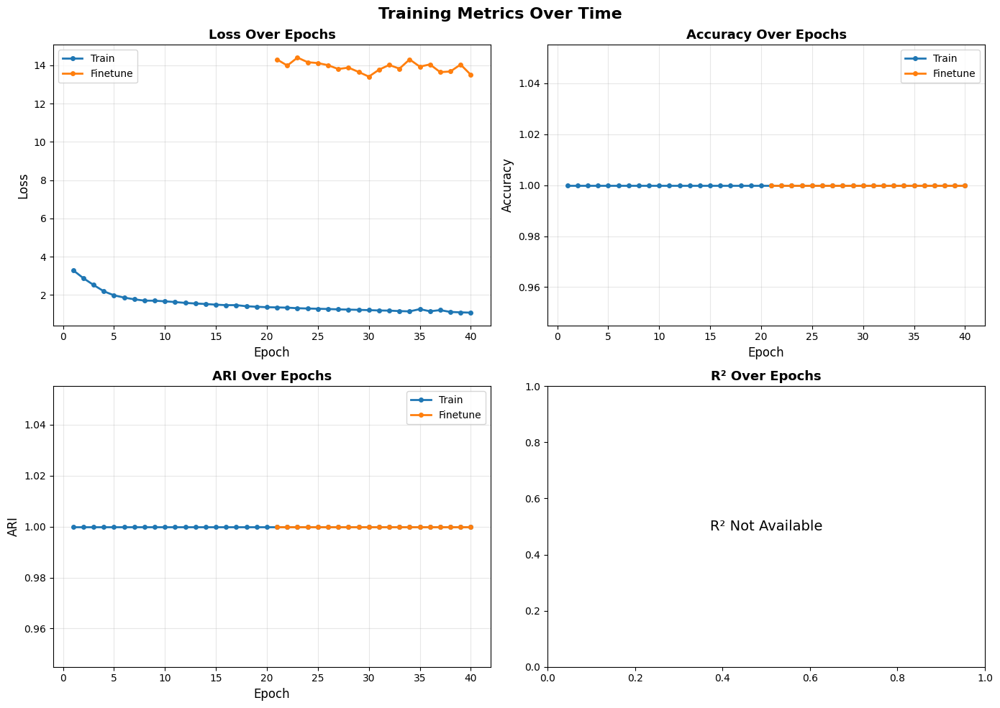


EXPORTING SUMMARY
Summary saved to: ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/metrics_summary.csv

Summary:
    Metric      Best    Final
 train_acc  1.000000  1.00000
 train_ari  1.000000  1.00000
 train_nmi  1.000000  1.00000
train_loss  1.075140  1.07514
    ft_acc  1.000000  1.00000
    ft_ari  1.000000  1.00000
    ft_nmi  1.000000  1.00000
   ft_loss 13.407033 13.50565
   r2_mean       NaN      NaN


In [3]:
import json
import pandas as pd
from pathlib import Path
import numpy as np

# Path to your model output directory
output_dir = Path("../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122")

# Load final metrics with None handling
with open(output_dir / "final_metrics.json", "r") as f:
    final_metrics = json.load(f)

def safe_print(name, value, decimals=4):
    """Print metric, handling None values"""
    if value is not None:
        print(f"  {name}: {value:.{decimals}f}")
    else:
        print(f"  {name}: Not available")

print("=" * 50)
print("FINAL METRICS (Last Epoch)")
print("=" * 50)
print("\nTraining Phase:")
safe_print("Train Accuracy", final_metrics.get('train_acc'))
safe_print("Train NMI", final_metrics.get('train_nmi'))
safe_print("Train ARI", final_metrics.get('train_ari'))
safe_print("Train Loss", final_metrics.get('train_loss'))

print("\nFinetuning Phase:")
safe_print("Finetune Accuracy", final_metrics.get('ft_acc'))
safe_print("Finetune NMI", final_metrics.get('ft_nmi'))
safe_print("Finetune ARI", final_metrics.get('ft_ari'))
safe_print("Finetune Loss", final_metrics.get('ft_loss'))

print("\nCross-Modal Prediction:")
safe_print("Mean R²", final_metrics.get('mean_R2'))

print("\nConfiguration:")
print(f"  Learning Rate: {final_metrics.get('lr')}")
print(f"  Dataset: {final_metrics.get('dataset_id', 'N/A')}")

# Load epoch-by-epoch history
print("\n" + "=" * 50)
print("EPOCH-BY-EPOCH HISTORY")
print("=" * 50)

history_df = pd.read_csv(output_dir / "history.csv")

# Display summary statistics
print("\nLast 5 Epochs:")
print(history_df.tail(5).to_string(index=False))

# Find best epochs for each metric (ignoring None values)
print("\n" + "=" * 50)
print("BEST PERFORMANCE")
print("=" * 50)

metrics_to_check = {
    'train_acc': 'max',
    'train_ari': 'max',
    'train_nmi': 'max',
    'train_loss': 'min',
    'ft_acc': 'max',
    'ft_ari': 'max',
    'ft_nmi': 'max',
    'ft_loss': 'min',
    'r2_mean': 'max'
}

for metric, mode in metrics_to_check.items():
    if metric in history_df.columns:
        # Drop NaN/None values
        valid_values = history_df[metric].dropna()
        
        if len(valid_values) > 0:
            if mode == 'max':
                best_idx = valid_values.idxmax()
                best_value = valid_values.max()
            else:
                best_idx = valid_values.idxmin()
                best_value = valid_values.min()
            
            best_epoch = history_df.loc[best_idx, 'epoch']
            print(f"  {metric}: {best_value:.4f} (epoch {int(best_epoch)})")
        else:
            print(f"  {metric}: No valid data")

# Plot metrics
print("\n" + "=" * 50)
print("GENERATING PLOTS")
print("=" * 50)

import matplotlib.pyplot as plt

fig, axes = plt.subplots(2, 2, figsize=(14, 10))
fig.suptitle('Training Metrics Over Time', fontsize=16, fontweight='bold')

# Helper function to plot with None handling
def plot_metric(ax, df, metric_cols, labels, title, ylabel):
    for col, label in zip(metric_cols, labels):
        if col in df.columns:
            # Only plot non-None values
            mask = df[col].notna()
            if mask.any():
                ax.plot(df.loc[mask, 'epoch'], df.loc[mask, col], 
                       marker='o', label=label, linewidth=2, markersize=4)
    
    ax.set_xlabel('Epoch', fontsize=12)
    ax.set_ylabel(ylabel, fontsize=12)
    ax.set_title(title, fontsize=13, fontweight='bold')
    ax.legend()
    ax.grid(True, alpha=0.3)

# Plot 1: Loss
plot_metric(axes[0, 0], history_df, 
           ['train_loss', 'ft_loss'], 
           ['Train', 'Finetune'],
           'Loss Over Epochs', 'Loss')

# Plot 2: Accuracy
plot_metric(axes[0, 1], history_df,
           ['train_acc', 'ft_acc'],
           ['Train', 'Finetune'],
           'Accuracy Over Epochs', 'Accuracy')

# Plot 3: ARI
plot_metric(axes[1, 0], history_df,
           ['train_ari', 'ft_ari'],
           ['Train', 'Finetune'],
           'ARI Over Epochs', 'ARI')

# Plot 4: R² (if available)
if 'r2_mean' in history_df.columns and history_df['r2_mean'].notna().any():
    plot_metric(axes[1, 1], history_df,
               ['r2_mean'],
               ['Mean R²'],
               'R² Over Epochs', 'R²')
else:
    axes[1, 1].text(0.5, 0.5, 'R² Not Available', 
                    ha='center', va='center', fontsize=14)
    axes[1, 1].set_title('R² Over Epochs', fontsize=13, fontweight='bold')

plt.tight_layout()
plot_path = output_dir / "metrics_visualization.png"
plt.savefig(plot_path, dpi=300, bbox_inches='tight')
print(f"Plot saved to: {plot_path}")
plt.show()

# Export summary to CSV
print("\n" + "=" * 50)
print("EXPORTING SUMMARY")
print("=" * 50)

summary_data = []
for metric, mode in metrics_to_check.items():
    if metric in history_df.columns:
        valid_values = history_df[metric].dropna()
        if len(valid_values) > 0:
            if mode == 'max':
                best_value = valid_values.max()
            else:
                best_value = valid_values.min()
            final_value = history_df[metric].dropna().iloc[-1] if len(valid_values) > 0 else None
        else:
            best_value = None
            final_value = None
    else:
        best_value = None
        final_value = None
    
    summary_data.append({
        'Metric': metric,
        'Best': best_value,
        'Final': final_value
    })

summary_df = pd.DataFrame(summary_data)
summary_path = output_dir / "metrics_summary.csv"
summary_df.to_csv(summary_path, index=False)
print(f"Summary saved to: {summary_path}")
print("\nSummary:")
print(summary_df.to_string(index=False))

In [5]:
import numpy as np
import scanpy as sc
import pickle
from pathlib import Path

# ------------------------------------------------------------------
# 1. SET YOUR PATHS HERE (3-MODALITY MODEL)
# ------------------------------------------------------------------
model_path = Path("../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251115_163240.pkl")
data_path  = Path("../Data/UnitedNet/input_data")
dataset_id = "KP2_1"

# ------------------------------------------------------------------
# 2. LOAD MODEL
# ------------------------------------------------------------------
print("Loading model from:", model_path)
with open(model_path, "rb") as f:
    model = pickle.load(f)

print("\n=== MODEL INSPECTION ===")
if hasattr(model, "technique"):
    print("model.technique:", model.technique)

if hasattr(model, "n_clusters"):
    print("model.n_clusters:", model.n_clusters)

if hasattr(model, "n_classes_"):
    print("model.n_classes_:", model.n_classes_)

# ------------------------------------------------------------------
# 3. LOAD ACTIVITY + FLUX + NICHE (train + test)
# ------------------------------------------------------------------
def load_modality(mod):
    train = sc.read_h5ad(data_path / f"adata_{mod}_train_perturbmap_{dataset_id}.h5ad")
    test  = sc.read_h5ad(data_path / f"adata_{mod}_test_perturbmap_{dataset_id}.h5ad")
    return sc.concat([train, test], join="inner")

print("\nLoading activity, flux, niche...")
adata_activity = load_modality("activity")
adata_flux     = load_modality("flux")
adata_niche    = load_modality("niche")

# Convert sparse → dense
for ad in [adata_activity, adata_flux, adata_niche]:
    if hasattr(ad.X, "toarray"):
        ad.X = ad.X.toarray()
    ad.X = np.asarray(ad.X, dtype=np.float32)

# Order matters: must match what the model expects (activity, flux, niche)
adatas_all = [adata_activity, adata_flux, adata_niche]

print("Shapes:")
print("  activity:", adata_activity.X.shape)
print("  flux:    ", adata_flux.X.shape)
print("  niche:   ", adata_niche.X.shape)

# ------------------------------------------------------------------
# 4. RUN PREDICT_LABEL DIRECTLY
# ------------------------------------------------------------------
print("\nRunning model.predict_label(adatas_all)...")
try:
    preds = model.predict_label(adatas_all)
    preds = np.asarray(preds)
    print("Success!")
except Exception as e:
    print("ERROR calling predict_label:", e)
    raise

# ------------------------------------------------------------------
# 5. INSPECT LABEL DISTRIBUTION
# ------------------------------------------------------------------
print("\n=== PREDICTED LABELS ===")
print("Total cells:", len(preds))
print("Unique labels:", np.unique(preds))

uniq, counts = np.unique(preds, return_counts=True)
print("\nCluster counts:")
for u, c in zip(uniq, counts):
    print(f"  Cluster {u}: {c} cells")

print("\nMin label:", preds.min(), "Max label:", preds.max())
print("Any negative labels?:", np.any(preds < 0))


Loading model from: ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251115_163240.pkl

=== MODEL INSPECTION ===

Loading activity, flux, niche...
Shapes:
  activity: (311, 2503)
  flux:     (311, 70)
  niche:    (311, 2504)

Running model.predict_label(adatas_all)...
Success!

=== PREDICTED LABELS ===
Total cells: 311
Unique labels: [0 1 2 3]

Cluster counts:
  Cluster 0: 110 cells
  Cluster 1: 75 cells
  Cluster 2: 47 cells
  Cluster 3: 79 cells

Min label: 0 Max label: 3
Any negative labels?: False


In [6]:
import numpy as np
import pandas as pd

# 1. True phenotypes (strings)
y_true = adata_activity.obs["phenotypes"].astype(str).values
print("y_true unique phenotypes:", np.unique(y_true))

# 2. Supervised head: probably what training confusion matrix used
print("\n=== SUPERISED PHENOTYPE PREDICTION (model.predict) ===")
try:
    y_pred_cls = np.asarray(model.predict(adatas_all))
    print("Shape:", y_pred_cls.shape)
    print("Unique predicted classes:", np.unique(y_pred_cls))
except Exception as e:
    print("model.predict() failed:", e)
    y_pred_cls = None

# 3. Clustering head: what we used in the correspondence script
print("\n=== UNSUPERVISED CLUSTER LABELS (model.predict_label) ===")
y_pred_cluster = np.asarray(model.predict_label(adatas_all))
print("Shape:", y_pred_cluster.shape)
print("Unique cluster labels:", np.unique(y_pred_cluster))

# 4. Confusion matrix: true phenotypes vs supervised head
if y_pred_cls is not None:
    print("\nConfusion matrix (PHENOTYPE head: y_true vs model.predict):")
    cm_cls = pd.crosstab(
        pd.Series(y_true, name="Phenotype"),
        pd.Series(y_pred_cls, name="Predicted_class"),
        dropna=False
    )
    display(cm_cls)

# 5. Confusion matrix: true phenotypes vs cluster head
print("\nConfusion matrix (CLUSTER head: y_true vs model.predict_label):")
cm_cluster = pd.crosstab(
    pd.Series(y_true, name="Phenotype"),
    pd.Series(y_pred_cluster, name="Cluster"),
    dropna=False
)
display(cm_cluster)


y_true unique phenotypes: ['KP_1-1' 'KP_1-2' 'KP_1-3' 'periphery']

=== SUPERISED PHENOTYPE PREDICTION (model.predict) ===
model.predict() failed: setting an array element with a sequence. The requested array has an inhomogeneous shape after 3 dimensions. The detected shape was (3, 3, 311) + inhomogeneous part.

=== UNSUPERVISED CLUSTER LABELS (model.predict_label) ===
Shape: (311,)
Unique cluster labels: [0 1 2 3]

Confusion matrix (CLUSTER head: y_true vs model.predict_label):


Cluster,0,1,2,3
Phenotype,,,,
KP_1-1,110,0,0,0
KP_1-2,0,75,0,0
KP_1-3,0,0,47,0
periphery,0,0,0,79


In [7]:
import numpy as np
import pandas as pd

# We already computed this earlier:
y_true = adata_activity.obs["phenotypes"].astype(str).values
y_pred_cluster = np.asarray(model.predict_label(adatas_all))

print("Unique cluster labels from model.predict_label:", np.unique(y_pred_cluster))

# If n_clusters = 4, let's assume cluster indices are 0..3 or 1..4.
# We'll check both possibilities.

print("\n=== Counts assuming cluster IDs 0..3 ===")
for cid in range(4):
    count = np.sum(y_pred_cluster == cid)
    print(f"Cluster {cid}: {count} cells")

print("\n=== Counts assuming cluster IDs 1..4 ===")
for cid in range(1, 5):
    count = np.sum(y_pred_cluster == cid)
    print(f"Cluster {cid}: {count} cells")

# For clarity, show the confusion we already saw:
print("\nConfusion matrix (y_true vs cluster labels):")
cm_cluster = pd.crosstab(
    pd.Series(y_true, name="Phenotype"),
    pd.Series(y_pred_cluster, name="Cluster"),
    dropna=False
)
display(cm_cluster)

Unique cluster labels from model.predict_label: [0 1 2 3]

=== Counts assuming cluster IDs 0..3 ===
Cluster 0: 110 cells
Cluster 1: 75 cells
Cluster 2: 47 cells
Cluster 3: 79 cells

=== Counts assuming cluster IDs 1..4 ===
Cluster 1: 75 cells
Cluster 2: 47 cells
Cluster 3: 79 cells
Cluster 4: 0 cells

Confusion matrix (y_true vs cluster labels):


Cluster,0,1,2,3
Phenotype,,,,
KP_1-1,110,0,0,0
KP_1-2,0,75,0,0
KP_1-3,0,0,47,0
periphery,0,0,0,79


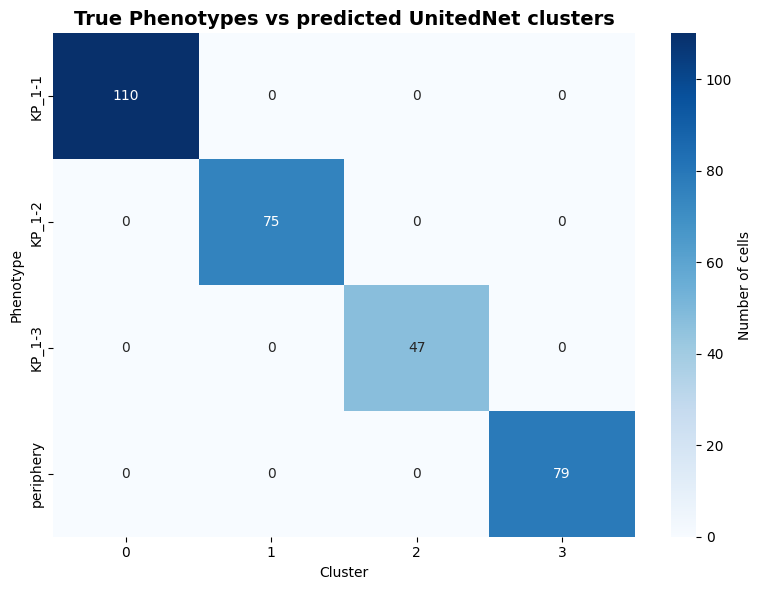

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns

# Convert to numeric matrix for plotting
cm = cm_cluster.values
phenotypes = cm_cluster.index.tolist()
cluster_labels = cm_cluster.columns.tolist()

plt.figure(figsize=(8, 6))
sns.heatmap(
    cm,
    annot=True,
    fmt="d",
    cmap="Blues",
    xticklabels=cluster_labels,
    yticklabels=phenotypes,
    cbar_kws={"label": "Number of cells"},
    # grid removed by omitting linewidths and linecolor
)

plt.title("True Phenotypes vs predicted UnitedNet clusters", fontsize=14, weight="bold")
plt.xlabel("Cluster")
plt.ylabel("Phenotype")
plt.tight_layout()
plt.show()

In [10]:
import sys
sys.argv = [
    "analyze_cluster_phenotype_correspondence.py",
    "--model_path", "../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251115_163240.pkl",
    "--data_path", "../Data/UnitedNet/input_data", 
    "--dataset_id", "KP2_1",
    "--output_dir", "../Analysis/Cluster_Phenotype_Correspondence"
]

from analyze_cluster_phenotype_correspondence import main
main()


CLUSTER-PHENOTYPE CORRESPONDENCE ANALYSIS
Model: ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251115_163240.pkl
Dataset: KP2_1
Results directory: ../Analysis/Cluster_Phenotype_Correspondence/correspondence_analysis_20251115_163650

Loading model from: ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251115_163240.pkl
Loading adata_activity_train from ../Data/UnitedNet/input_data/adata_activity_train_perturbmap_KP2_1.h5ad
Loading adata_flux_train from ../Data/UnitedNet/input_data/adata_flux_train_perturbmap_KP2_1.h5ad
Loading adata_niche_train from ../Data/UnitedNet/input_data/adata_niche_train_perturbmap_KP2_1.h5ad
Loading adata_activity_test from ../Data/UnitedNet/input_data/adata_activity_test_perturbmap_KP2_1.h5ad
Loading adata_flux_test from ../Data/Uni

0

In [11]:
import sys
sys.argv = [
    "analyze_unitednet_clusters.py",
    "--model_path", "../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251115_163240.pkl",
    "--data_path", "../Data/UnitedNet/input_data", 
    "--dataset_id", "KP2_1",
    "--output_dir", "../Analysis/Cluster_Phenotype_Correspondence",
    "--update_input_files" 
    # No --update_input_files flag = analysis only
]
from analyze_unitednet_clusters import main
main()

Loading model from: ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251115_163240.pkl
Loading adata_activity_train from ../Data/UnitedNet/input_data/adata_activity_train_perturbmap_KP2_1.h5ad
Loading adata_flux_train from ../Data/UnitedNet/input_data/adata_flux_train_perturbmap_KP2_1.h5ad
Loading adata_niche_train from ../Data/UnitedNet/input_data/adata_niche_train_perturbmap_KP2_1.h5ad
Loading adata_activity_test from ../Data/UnitedNet/input_data/adata_activity_test_perturbmap_KP2_1.h5ad
Loading adata_flux_test from ../Data/UnitedNet/input_data/adata_flux_test_perturbmap_KP2_1.h5ad
Loading adata_niche_test from ../Data/UnitedNet/input_data/adata_niche_test_perturbmap_KP2_1.h5ad
Phenotype mapping:
  KP_1-1 -> 0 (110 cells)
  KP_1-2 -> 1 (75 cells)
  KP_1-3 -> 2 (47 cells)
  periphery -> 3 (79 cells)
Getting model predictions...
✓ Obtained predictions from model.predict_lab

In [12]:
niche_train = sc.read('../Data/UnitedNet/input_data/adata_niche_train_perturbmap_KP2_1.h5ad')
niche_train

AnnData object with n_obs × n_vars = 248 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans', 'discovered_cluster_id', 'discovered_cluster', 'cluster_discovery_timestamp', 'cluster_discovery_method', 'cluster_total_count'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cluster_phenotype_mapping', 'clusters_colors', 'dendrogram_clusters', 'hvg', 'kmeans_colors', 'leiden', 'modality', 'neighbors', 'niche_method', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial'

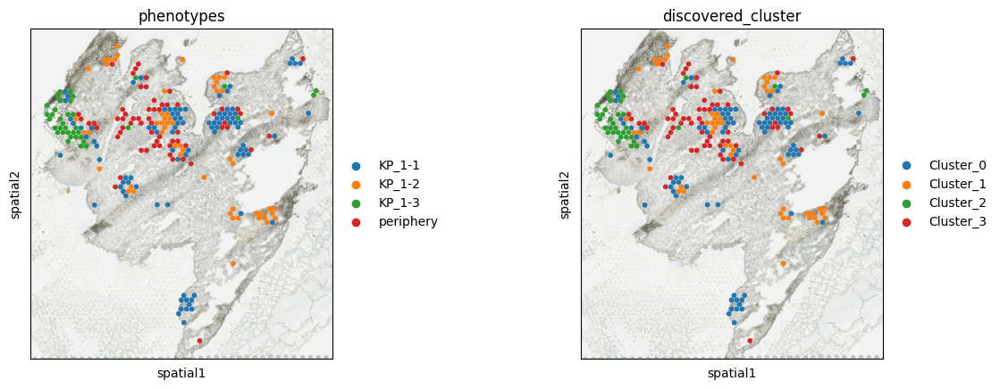

In [13]:
sc.pl.spatial(niche_train, img_key="hires", color=["phenotypes", 'discovered_cluster'], size=1.5)

In [ ]:
# -*- coding: utf-8 -*-
"""
Model report (no R²): summarize structure, parameters, training history,
checkpoints, config/hparams, and list/array attributes — while filtering out
anything whose name includes 'r2' (case-insensitive).
"""

import os
import sys
import json
import math
import time
import pickle
import inspect
import numpy as np
from pathlib import Path
from typing import Any, Dict

# Optional torch block (used for checkpoints and param counting if available)
try:
    import torch
    import torch.nn as nn
except Exception:
    torch = None
    nn = None

# ===================== USER INPUTS =====================
MODEL_PKL = Path("../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_v1_20251015_092503/"
                 "model_perturbmap_activity_flux_niche_capboost_v1_KP2_1_capboost_20251015_092607.pkl")
# ======================================================


# ---------- Helpers ----------
def is_excluded_key(name: str) -> bool:
    """Exclude keys/attributes that look like R²."""
    return "r2" in (name or "").lower()


def safe_type(x: Any) -> str:
    try:
        return str(type(x))
    except Exception:
        return "<unknown type>"


def brief_value(x: Any, max_len: int = 200) -> str:
    """Human-friendly one-line preview of a value (arrays/lists summarized)."""
    try:
        if isinstance(x, np.ndarray):
            return f"ndarray shape={x.shape}, dtype={x.dtype}"
        if torch is not None and isinstance(x, torch.Tensor):
            return f"tensor shape={tuple(x.shape)}, dtype={x.dtype}"
        if isinstance(x, (list, tuple)):
            return f"{type(x).__name__} len={len(x)}"
        if isinstance(x, dict):
            return f"dict keys={list(x.keys())[:8]}{'...' if len(x)>8 else ''}"
        s = repr(x)
        return s if len(s) <= max_len else s[:max_len] + "…"
    except Exception as e:
        return f"<unprintable: {e}>"


def param_count(module) -> Dict[str, int]:
    """Count total/trainable params if it's a torch.nn.Module."""
    if torch is None or nn is None or not isinstance(module, nn.Module):
        return {}
    total = sum(p.numel() for p in module.parameters())
    trainable = sum(p.numel() for p in module.parameters() if p.requires_grad)
    buffers = sum(b.numel() for b in module.buffers())
    return {"total_params": int(total), "trainable_params": int(trainable), "buffers": int(buffers)}


def try_get(obj, name, default=None):
    try:
        return getattr(obj, name)
    except Exception:
        return default


def extract_hparams(obj: Any) -> Dict[str, Any]:
    """Collect likely hyperparameters/config while filtering out R²."""
    candidates = {}
    for key in ["config", "cfg", "hparams", "hyperparams", "params", "settings", "options"]:
        val = try_get(obj, key, None)
        if val is not None and not is_excluded_key(key):
            try:
                if isinstance(val, dict):
                    candidates[key] = {k: v for k, v in val.items() if not is_excluded_key(str(k))}
                else:
                    # Convert simple namespaces/objects to dict when possible
                    if hasattr(val, "__dict__"):
                        d = {k: getattr(val, k) for k in dir(val) if not k.startswith("_")}
                        candidates[key] = {k: v for k, v in d.items() if not is_excluded_key(str(k))}
                    else:
                        candidates[key] = brief_value(val)
            except Exception:
                candidates[key] = brief_value(val)
    return candidates


def summarize_history(obj: Any) -> Dict[str, Any]:
    """Find common training-history arrays/lists (loss, mae, mse, etc.) excluding R²."""
    hist = {}
    keys_of_interest = ["loss", "train_loss", "val_loss", "mae", "mse", "rmse",
                        "pearson", "spearman", "kendall", "cosine", "mape", "accuracy"]
    for a in dir(obj):
        if a.startswith("_") or is_excluded_key(a):
            continue
        try:
            v = getattr(obj, a)
        except Exception:
            continue
        low = a.lower()
        if any(k in low for k in keys_of_interest):
            try:
                if isinstance(v, (list, tuple, np.ndarray)):
                    arr = np.array(v, dtype=float) if not isinstance(v, np.ndarray) else v
                    if arr.ndim == 0:
                        hist[a] = float(arr)
                    else:
                        hist[a] = {
                            "length": int(arr.shape[0]),
                            "first": float(arr[0]) if arr.shape[0] > 0 and np.isfinite(arr[0]).all() else brief_value(arr[0]),
                            "last": float(arr[-1]) if arr.shape[0] > 0 and np.isfinite(arr[-1]).all() else brief_value(arr[-1]),
                            "min": float(np.nanmin(arr)) if arr.size else None,
                            "max": float(np.nanmax(arr)) if arr.size else None,
                        }
                else:
                    hist[a] = brief_value(v)
            except Exception:
                hist[a] = brief_value(v)
    return hist


def explore_attributes(obj: Any, prefix: str, max_depth: int, current_depth: int,
                       report_dict: Dict[str, Any]):
    """Recursively explore object attributes, excluding R² fields."""
    if current_depth >= max_depth:
        return
    attrs = [a for a in dir(obj) if not a.startswith("_") and not is_excluded_key(a)]
    for attr in attrs:
        full = f"{prefix}.{attr}" if prefix else attr
        try:
            val = getattr(obj, attr)
        except Exception:
            continue

        # Skip large callables
        if callable(val):
            continue

        # Record a brief line
        report_dict["attributes"].append({
            "name": full,
            "type": safe_type(val),
            "preview": brief_value(val)
        })

        # Recurse
        if hasattr(val, "__dict__"):
            explore_attributes(val, full, max_depth, current_depth + 1, report_dict)


def list_array_attributes(obj: Any, prefix: str, out_list: list):
    """Capture list/array-like attributes (excluding R²)."""
    for attr in dir(obj):
        if attr.startswith("_") or is_excluded_key(attr):
            continue
        try:
            v = getattr(obj, attr)
        except Exception:
            continue
        if isinstance(v, list) and len(v) > 0:
            try:
                entry = {
                    "name": f"{prefix}.{attr}" if prefix else attr,
                    "container": "list",
                    "len": len(v),
                    "elem0_type": safe_type(v[0]),
                    "last_preview": brief_value(v[-1])
                }
                out_list.append(entry)
            except Exception:
                pass
        elif isinstance(v, np.ndarray):
            out_list.append({
                "name": f"{prefix}.{attr}" if prefix else attr,
                "container": "ndarray",
                "shape": v.shape,
                "dtype": str(v.dtype)
            })
        elif torch is not None and isinstance(v, torch.Tensor):
            out_list.append({
                "name": f"{prefix}.{attr}" if prefix else attr,
                "container": "tensor",
                "shape": tuple(v.shape),
                "dtype": str(v.dtype)
            })


# ---------- Load model ----------
print("=" * 70)
print("DEEP DIVE: EXPLORING MODEL STRUCTURE (R² EXCLUDED)")
print("=" * 70)

if not MODEL_PKL.exists():
    print(f"❌ Model file not found: {MODEL_PKL}")
    sys.exit(1)

with open(MODEL_PKL, "rb") as f:
    model = pickle.load(f)

out_dir = MODEL_PKL.parent

# ---------- File info ----------
stat = MODEL_PKL.stat()
file_info = {
    "path": str(MODEL_PKL),
    "size_bytes": int(stat.st_size),
    "modified_utc": time.strftime("%Y-%m-%dT%H:%M:%SZ", time.gmtime(stat.st_mtime))
}
print("\n[File]")
for k, v in file_info.items():
    print(f"- {k}: {v}")

# ---------- Top-level summary ----------
top_summary = {
    "class": type(model).__name__,
    "module": type(model).__module__,
}
print("\n[Model]")
print(f"- class:  {top_summary['class']}")
print(f"- module: {top_summary['module']}")

# ---------- Torch param counts ----------
torch_params = {}
if torch is not None and nn is not None:
    # Try on the object itself and on a nested '.model'
    if isinstance(model, nn.Module):
        torch_params["model"] = param_count(model)
    inner = try_get(model, "model", None)
    if isinstance(inner, nn.Module):
        torch_params["model.model"] = param_count(inner)

if torch_params:
    print("\n[Parameters]")
    for k, p in torch_params.items():
        print(f"- {k}: {p}")

# ---------- Hyperparameters/config ----------
hparams = extract_hparams(model)
if not hparams and hasattr(model, "model"):
    # Also look one level down
    inner = try_get(model, "model", None)
    if inner is not None:
        inner_h = extract_hparams(inner)
        if inner_h:
            hparams = {"(from model.model)": inner_h}

if hparams:
    print("\n[Config / Hparams]")
    print(json.dumps(hparams, indent=2, default=str))

# ---------- Training history (loss/mae/mse/…; R² excluded) ----------
history = summarize_history(model)
if not history and hasattr(model, "model"):
    inner = try_get(model, "model", None)
    if inner is not None:
        history = summarize_history(inner)

if history:
    print("\n[Training History]")
    for k, v in history.items():
        print(f"- {k}: {v}")

# ---------- Attribute exploration ----------
report = {"attributes": []}
print("\n[Attributes]")
explore_attributes(model, "model", max_depth=2, current_depth=0, report_dict=report)
if hasattr(model, "model"):
    explore_attributes(model.model, "model.model", max_depth=2, current_depth=0, report_dict=report)

# Print a compact preview (first N)
N = 20
for row in report["attributes"][:N]:
    print(f"- {row['name']}: {row['type']} | {row['preview']}")
if len(report["attributes"]) > N:
    print(f"... ({len(report['attributes']) - N} more)")

# ---------- List/array attributes snapshot ----------
print("\n[List / Array Attributes]")
listish = []
list_array_attributes(model, "model", listish)
if hasattr(model, "model"):
    list_array_attributes(model.model, "model.model", listish)
for row in listish[:N]:
    print(f"- {row}")
if len(listish) > N:
    print(f"... ({len(listish) - N} more)")

# ---------- Checkpoints (skip any R² keys) ----------
ckpt_info = {"count": 0, "latest": None, "latest_keys": []}
if torch is not None:
    ckpts = sorted(out_dir.glob("finetune_epoch_*.pt"))
    ckpt_info["count"] = len(ckpts)
    if ckpts:
        latest = ckpts[-1]
        ckpt_info["latest"] = str(latest)
        try:
            ck = torch.load(latest, map_location="cpu")
            # Keep non-R² keys only
            ckpt_info["latest_keys"] = [k for k in ck.keys() if not is_excluded_key(k)]
        except Exception as e:
            ckpt_info["latest_error"] = str(e)

print("\n[Checkpoints]")
print(json.dumps(ckpt_info, indent=2))

# ---------- Build JSON report (no R²) ----------
json_report = {
    "file": file_info,
    "model": top_summary,
    "torch_params": torch_params,
    "hparams": hparams,
    "history": history,
    "attributes_sample": report["attributes"][:N],
    "list_array_attrs_sample": listish[:N],
    "checkpoints": ckpt_info,
    "notes": "All fields that contain 'r2' in their name were excluded from this report."
}

report_path = out_dir / "model_report_no_R2.json"
with open(report_path, "w") as f:
    json.dump(json_report, f, indent=2, default=str)

print("\n" + "=" * 70)
print(f"✓ COMPLETE - WROTE {report_path.name} (R² excluded)")
print("=" * 70)


# Joint Group Identification

In [2]:
import sys
sys.argv = [
    "calculate_shap_values_capboost.py",
    "--model_path", "../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251115_163240.pkl",
    "--data_path", "../Data/UnitedNet/input_data",
    "--dataset_id", "KP2_1",
    "--technique", "perturbmap_capboost",
    "--top_k_features", "10",
    "--output_dir", "../Task1_JGI"
]

from calculate_shap_values_capboost import main
main()

Results will be saved to: ../Task1_JGI/shap_analysis_capboost_20251207_114703
Analyzing CapBoost model with Activity(1500) + Flux(70) + Niche(1500) modalities
Using specified model: ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251115_163240.pkl
Loading model from: ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251115_163240.pkl
Loading adata_activity_train from ../Data/UnitedNet/input_data/adata_activity_train_perturbmap_KP2_1.h5ad
Loading adata_flux_train from ../Data/UnitedNet/input_data/adata_flux_train_perturbmap_KP2_1.h5ad
Loading adata_niche_train from ../Data/UnitedNet/input_data/adata_niche_train_perturbmap_KP2_1.h5ad
Loading adata_activity_test from ../Data/UnitedNet/input_data/adata_activity_test_perturbmap_KP2_1.h5ad
Loading adata_flux_test from

X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.


Prepared data shapes:
  ACTIVITY: (311, 2503) (expected features: 1500)
    ⚠️  Warning: Expected 1500 features, got 2503
  FLUX: (311, 70) (expected features: 70)
  NICHE: (311, 2504) (expected features: 1500)
    ⚠️  Warning: Expected 1500 features, got 2504

=== Calculating SHAP Values for CapBoost Model ===
Setup complete:
Number of modalities: 3
Modality names: ['ACTIVITY', 'FLUX', 'NICHE']
Expected dimensions: Activity(1500), Flux(70), Niche(1500)
ACTIVITY: (311, 2503) (features: 2503)
FLUX: (311, 70) (features: 70)
NICHE: (311, 2504) (features: 2504)
ACTIVITY: torch.Size([311, 2503])
FLUX: torch.Size([311, 70])
NICHE: torch.Size([311, 2504])

Cluster prototypes:
ACTIVITY: torch.Size([4, 2503])
FLUX: torch.Size([4, 70])
NICHE: torch.Size([4, 2504])

Getting model predictions...
Predicted labels: [0 1 2 3] (shape: (311,))
Predicted label annotation: [0 1 2 3]

Calculating SHAP values...
This may take some time depending on data size...


Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.


SHAP values saved to: ../Task1_JGI/shap_analysis_capboost_20251207_114703/shap_values_perturbmap_capboost.pkl

=== Creating Chord Plots for Activity+Flux+Niche ===
Cluster mapping: {0: 'Cluster 0', 1: 'Cluster 1', 2: 'Cluster 2', 3: 'Cluster 3'}
markers_chord_plot completed successfully
Debug info:
  predict_label unique values: [0 1 2 3]
  predict_label_anno unique values: ['0' '1' '2' '3']
  major_dict: {0: 'Cluster 0', 1: 'Cluster 1', 2: 'Cluster 2', 3: 'Cluster 3'}
Unmapped labels: ['1', '0', '3', '2']
major_dict keys sample: [0, 1, 2, 3]
Found unmapped labels. Creating extended major_dict...
Extended major_dict: {0: 'Cluster 0', 1: 'Cluster 1', 2: 'Cluster 2', 3: 'Cluster 3', '1': 'Cluster 1', '0': 'Cluster 0', '3': 'Cluster 3', '2': 'Cluster 2'}

Creating and saving UMAP plot...
Debug: colors_type keys: ['0', '1', '2', '3']
Debug: pr_ty_dict sample: {'1': '1', '0': '0', '3': '3', '2': '2'}
Final colors_type keys: ['0', '1', '2', '3']
Final pr_ty_dict: {'1': '1', '0': '0', '3': '3

0

# Cross-Modal Prediction

In [3]:
import subprocess
import sys

result = subprocess.run([
    sys.executable, 'capboost_feature_v2.py',
    '--dataset_id', 'KP2_1',
    '--shap_dir', '../Task1_JGI/shap_analysis_capboost_20251115_163824',
    '--model_path', '../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251115_163240.pkl',
    '--data_path', '../Data/UnitedNet/input_data',
    '--combinations', '0,1', '0,2',
    '--output_dir', '../Task2_CMP',
    '--calculate_shap'
], capture_output=True, text=True)

print("STDOUT:")
print(result.stdout)
print("\nSTDERR:")
print(result.stderr)
print(f"\nReturn code: {result.returncode}")

STDOUT:
CapBoost Cross-Modal Analysis
Results will be saved to: ../Task2_CMP/capboost_cross_modal_analysis_20251204_134023
Modalities: Activity(0), Flux(1), Niche(2)

=== Loading CapBoost SHAP Results ===
Looking for CapBoost SHAP results in: ../Task1_JGI/shap_analysis_capboost_20251115_163824
Directory exists: True
Files in directory:
  plots
  shap_values_perturbmap_capboost.pkl
  aggregated_shap_perturbmap_capboost.pkl
  scores_perturbmap_capboost.pkl
  analysis_metadata.json
  all_type_features_perturbmap_capboost.pkl
Checking for all_type_features: ../Task1_JGI/shap_analysis_capboost_20251115_163824/all_type_features_perturbmap_capboost.pkl
✓ Successfully loaded all_type_features
Checking for scores: ../Task1_JGI/shap_analysis_capboost_20251115_163824/scores_perturbmap_capboost.pkl
✓ Successfully loaded scores
Checking for aggregated_shap: ../Task1_JGI/shap_analysis_capboost_20251115_163824/aggregated_shap_perturbmap_capboost.pkl
✓ Successfully loaded aggregated_shap
Checking for 

In [27]:
%%bash

python capboost_feature_v2.py \
  --dataset_id KP2_1 \
  --shap_dir ../Task1_JGI/shap_analysis_capboost_20251115_163824 \
  --model_path ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_supervised_20251115_163122/model_perturbmap_activity_flux_niche_capboost_supervised_KP2_1_supervised_20251115_163240.pkl \
  --data_path ../Data/UnitedNet/input_data \
  --combinations 2,0 2,1 \
  --output_dir ../Task2_CMP \
  --calculate_shap

2025-12-04 13:43:50.674970: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-12-04 13:43:50.681977: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-12-04 13:43:50.689708: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-12-04 13:43:50.692113: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-12-04 13:43:50.698223: I tensorflow/core/platform/cpu_feature_guar

CapBoost Cross-Modal Analysis
Results will be saved to: ../Task2_CMP/capboost_cross_modal_analysis_20251204_134351
Modalities: Activity(0), Flux(1), Niche(2)

=== Loading CapBoost SHAP Results ===
Looking for CapBoost SHAP results in: ../Task1_JGI/shap_analysis_capboost_20251115_163824
Directory exists: True
Files in directory:
  plots
  shap_values_perturbmap_capboost.pkl
  aggregated_shap_perturbmap_capboost.pkl
  scores_perturbmap_capboost.pkl
  analysis_metadata.json
  all_type_features_perturbmap_capboost.pkl
Checking for all_type_features: ../Task1_JGI/shap_analysis_capboost_20251115_163824/all_type_features_perturbmap_capboost.pkl
✓ Successfully loaded all_type_features
Checking for scores: ../Task1_JGI/shap_analysis_capboost_20251115_163824/scores_perturbmap_capboost.pkl
✓ Successfully loaded scores
Checking for aggregated_shap: ../Task1_JGI/shap_analysis_capboost_20251115_163824/aggregated_shap_perturbmap_capboost.pkl
✓ Successfully loaded aggregated_shap
Checking for shap_val

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [7]:
# %%bash

# python capboost_feature_v2.py \
#   --dataset_id KP2_1 \
#   --shap_dir ../Task1_JGI/shap_analysis_capboost_20251026_091838 \
#   --model_path Mongoose/Models/UnitedNet/perturbmap_activity_flux_niche_capboost_v1_20251026_072125/model_perturbmap_activity_flux_niche_capboost_v1_KP2_1_capboost_20251026_072228.pkl \
#   --data_path ../Data/UnitedNet/input_data \
#   --combinations 2,0 2,1 \
#   --output_dir ../Task2_CMP \
#   --calculate_shap

2025-10-26 09:22:12.150782: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-10-26 09:22:12.157776: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-10-26 09:22:12.165609: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-10-26 09:22:12.168004: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-10-26 09:22:12.174216: I tensorflow/core/platform/cpu_feature_guar

CapBoost Cross-Modal Analysis
Results will be saved to: ../Task2_CMP/capboost_cross_modal_analysis_20251026_092213
Modalities: Activity(0), Flux(1), Niche(2)

=== Loading CapBoost SHAP Results ===
Looking for CapBoost SHAP results in: ../Task1_JGI/shap_analysis_capboost_20251026_091838
Directory exists: True
Files in directory:
  plots
  shap_values_perturbmap_capboost.pkl
  aggregated_shap_perturbmap_capboost.pkl
  scores_perturbmap_capboost.pkl
  analysis_metadata.json
  all_type_features_perturbmap_capboost.pkl
Checking for all_type_features: ../Task1_JGI/shap_analysis_capboost_20251026_091838/all_type_features_perturbmap_capboost.pkl
✓ Successfully loaded all_type_features
Checking for scores: ../Task1_JGI/shap_analysis_capboost_20251026_091838/scores_perturbmap_capboost.pkl
✓ Successfully loaded scores
Checking for aggregated_shap: ../Task1_JGI/shap_analysis_capboost_20251026_091838/aggregated_shap_perturbmap_capboost.pkl
✓ Successfully loaded aggregated_shap
Checking for shap_val

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Traceback (most recent call last):
  File "/home/ggavriilidis/Mongoose/Scripts/capboost_feature_v2.py", line 788, in <module>
    exit(main())
  File "/home/ggavriilidis/Mongoose/Scripts/capboost_feature_v2.py", line 665, in main
    shap_values = compute_cross_modal_shap_capboost(
  File "/home/ggavriilidis/Mongoose/Scripts/capboost_feature_v2.py", line 321, in compute_cross_modal_shap_capboost
    shap_values = e.shap_values(test_type, check_additivity=True)
  File "/home/ggavriilidis/.conda/envs/uni_dev/lib/python3.9/site-packages/shap/explainers/_deep/__init__.py", line 124, in shap_values
    return self.explainer.shap_values(X, ranked_outputs, output_rank_order, check_additivity=check_additivity)
  File "/home/ggavriilidis/.conda/envs/uni_dev/lib/python3.9/site-packages/shap/explainers/_deep/deep_pytorch.py", line 185, in shap_values
    sample_phis = self.gradient(feature_ind, joint_x)
  File "/home/ggavriilidis/.conda/envs/uni_dev/lib/python3.9/site-packages/shap/explainers/_de

Error while terminating subprocess (pid=324160): 


In [ ]:
# %%bash 

# python capboost_feature_feature_analysis.py \
#   --dataset_id KP2_1 \
#   --shap_dir ../Task1_JGI/shap_analysis_capboost_20251024_102129 \
#   --model_path ../Models/UnitedNet/perturbmap_activity_flux_niche_capboost_v1_20251024_101738/model_perturbmap_activity_flux_niche_capboost_v1_KP2_1_capboost_20251024_101917.pkl \
#   --data_path ../Data/UnitedNet/input_data \
#   --combinations 2,0 2,1 \
#   --output_dir ../Task2_CMP \
#   --calculate_shap

In [ ]:
import pandas as pd
from pathlib import Path

src_path = Path("../Task2_CMP_CapBoost/capboost_cross_modal_analysis_20251015_101619/capboost_feature_feature_importance_activity_flux_niche.csv")  # adjust path
out_txt  = Path("../Mongoose_post_hoc/Heatmaps/CMP_SHAP.txt")

df = pd.read_csv(src_path, sep=None, engine="python")
an = df[(df["Cluster"] == 0) &
        (df["Direction"].str.upper().str.strip().eq("ACTIVITY -> NICHE"))].copy()



activity = an["Source"] if "Source" in an.columns else an["Source_clean"]
niche    = an["Target_clean"] if "Target_clean" in an.columns else an["Target"]

long_df = pd.DataFrame({
    "Activity": activity.astype(str),
    "Niche": niche.astype(str),
    "Value": pd.to_numeric(an["Value"], errors="coerce"),
}).dropna(subset=["Activity", "Niche", "Value"])

mat = long_df.pivot_table(
    index="Activity", columns="Niche", values="Value",
    aggfunc="max", fill_value=0.0
).sort_index().sort_index(axis=1)

# Remove index label so the top-left cell is blank
mat.index.name = None

mat.to_csv(out_txt, sep="\t", float_format="%.6g", header=True)

print(f"Saved: {out_txt}")


In [ ]:
# https://appyters.maayanlab.cloud/Clustergrammer_Appyter/ec04d5251091323c9f23bd0a40135fbcdfa9d8df/

# hc_activity_niche.py
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from pathlib import Path

# ========= CONFIG =========
infile   = "../Mongoose_post_hoc/Heatmaps/CMP_SHAP.txt"  # your uploaded file
out_dir  = "../Mongoose_post_hoc/Heatmaps/"
figfile  = "hc_activity_niche_clustermap_socs1.png"
matfile  = "hc_activity_niche_ordered_socs1.tsv"
rowsfile = "hc_row_order_socs1.txt"
colsfile = "hc_col_order_socs1.txt"

# Clustering params
METHOD = "average"        # options: 'single','complete','average','weighted','centroid','median','ward'
METRIC = "correlation"    # common: 'euclidean','cityblock','cosine','correlation' (use 'euclidean' if METHOD='ward')
Z_SCORE_AXIS = None          # 0=z-score rows, 1=z-score cols, or None to skip

# ========= LOAD =========
df = pd.read_csv(infile, sep="\t", index_col=0)  # rows: activities (keep _SIG), cols: niche genes

# ========= CLUSTERED HEATMAP =========
Path(out_dir).mkdir(parents=True, exist_ok=True)
sns.set_context("talk")
sns.set_style("white")
cg = sns.clustermap(
    df,
    method=METHOD,
    metric=METRIC,
    z_score=Z_SCORE_AXIS,   # now None → plot raw values
    cmap="viridis",         # sequential works better for 0–1 data
    vmin=0, vmax=1,         # lock color range to raw SHAP scale
    linewidths=0.0,
    figsize=(12, 10),
    cbar_kws={"label": "SHAP (raw)"}
)
# <<< make tick labels smaller >>>
cg.ax_heatmap.tick_params(axis="x", labelsize=6)   # x-axis gene labels
cg.ax_heatmap.tick_params(axis="y", labelsize=6)   # y-axis gene labels
plt.setp(cg.ax_heatmap.get_xticklabels(), rotation=90, ha="center", va="top")

# (optional) smaller colorbar ticks/label
cg.ax_cbar.tick_params(labelsize=8)
cg.ax_cbar.set_ylabel("SHAP (raw)", fontsize=9)

# (optional) improve export quality with lots of labels
cg.ax_heatmap.set_rasterized(True)

cg.fig.suptitle("Activity SHAP connections for GenKI Tgfbr2 KO responsive genes",
                y=1.02, fontsize=12)
cg.savefig(Path(out_dir, figfile), dpi=300, bbox_inches="tight")

# ========= EXPORT ORDERED MATRIX & ORDERS =========
row_order = [df.index[i] for i in cg.dendrogram_row.reordered_ind]
col_order = [df.columns[i] for i in cg.dendrogram_col.reordered_ind]

df_ordered = df.loc[row_order, col_order]
df_ordered.to_csv(Path(out_dir, matfile), sep="\t")

with open(Path(out_dir, rowsfile), "w") as f:
    f.write("\n".join(map(str, row_order)))
with open(Path(out_dir, colsfile), "w") as f:
    f.write("\n".join(map(str, col_order)))

print(f"Saved:\n- Figure: {Path(out_dir, figfile)}\n- Ordered matrix: {Path(out_dir, matfile)}\n- Row order: {Path(out_dir, rowsfile)}\n- Col order: {Path(out_dir, colsfile)}")


In [ ]:
import pandas as pd
from pathlib import Path

src_path = Path("../Task2_CMP_CapBoost/capboost_cross_modal_analysis_20251015_101619/capboost_feature_feature_importance_activity_flux_niche.csv")  # adjust path
out_txt  = Path("../Mongoose_post_hoc/Heatmaps/CMP_SHAP_cluster1.txt")

df = pd.read_csv(src_path, sep=None, engine="python")
an = df[(df["Cluster"] == 1) &
        (df["Direction"].str.upper().str.strip().eq("ACTIVITY -> NICHE"))].copy()



activity = an["Source"] if "Source" in an.columns else an["Source_clean"]
niche    = an["Target_clean"] if "Target_clean" in an.columns else an["Target"]

long_df = pd.DataFrame({
    "Activity": activity.astype(str),
    "Niche": niche.astype(str),
    "Value": pd.to_numeric(an["Value"], errors="coerce"),
}).dropna(subset=["Activity", "Niche", "Value"])

mat = long_df.pivot_table(
    index="Activity", columns="Niche", values="Value",
    aggfunc="max", fill_value=0.0
).sort_index().sort_index(axis=1)

# Remove index label so the top-left cell is blank
mat.index.name = None

mat.to_csv(out_txt, sep="\t", float_format="%.6g", header=True)

print(f"Saved: {out_txt}")


In [ ]:
# https://appyters.maayanlab.cloud/Clustergrammer_Appyter/44a5963ac62dfeb4a81848b4b54481eabe4ceca7/

# hc_activity_niche.py
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from pathlib import Path

# ========= CONFIG =========
infile   = "../Mongoose_post_hoc/Heatmaps/CMP_SHAP_cluster1.txt"  # your uploaded file
out_dir  = "../Mongoose_post_hoc/Heatmaps/"
figfile  = "hc_activity_niche_clustermap_socs1.png"
matfile  = "hc_activity_niche_ordered_socs1.tsv"
rowsfile = "hc_row_order_socs1.txt"
colsfile = "hc_col_order_socs1.txt"

# Clustering params
METHOD = "average"        # options: 'single','complete','average','weighted','centroid','median','ward'
METRIC = "correlation"    # common: 'euclidean','cityblock','cosine','correlation' (use 'euclidean' if METHOD='ward')
Z_SCORE_AXIS = None          # 0=z-score rows, 1=z-score cols, or None to skip

# ========= LOAD =========
df = pd.read_csv(infile, sep="\t", index_col=0)  # rows: activities (keep _SIG), cols: niche genes

# ========= CLUSTERED HEATMAP =========
Path(out_dir).mkdir(parents=True, exist_ok=True)
sns.set_context("talk")
sns.set_style("white")
cg = sns.clustermap(
    df,
    method=METHOD,
    metric=METRIC,
    z_score=Z_SCORE_AXIS,   # now None → plot raw values
    cmap="viridis",         # sequential works better for 0–1 data
    vmin=0, vmax=1,         # lock color range to raw SHAP scale
    linewidths=0.0,
    figsize=(12, 10),
    cbar_kws={"label": "SHAP (raw)"}
)
# <<< make tick labels smaller >>>
cg.ax_heatmap.tick_params(axis="x", labelsize=6)   # x-axis gene labels
cg.ax_heatmap.tick_params(axis="y", labelsize=6)   # y-axis gene labels
plt.setp(cg.ax_heatmap.get_xticklabels(), rotation=90, ha="center", va="top")

# (optional) smaller colorbar ticks/label
cg.ax_cbar.tick_params(labelsize=8)
cg.ax_cbar.set_ylabel("SHAP (raw)", fontsize=9)

# (optional) improve export quality with lots of labels
cg.ax_heatmap.set_rasterized(True)

cg.fig.suptitle("Activity SHAP connections for GenKI Tgfbr2 KO responsive genes",
                y=1.02, fontsize=12)
cg.savefig(Path(out_dir, figfile), dpi=300, bbox_inches="tight")

# ========= EXPORT ORDERED MATRIX & ORDERS =========
row_order = [df.index[i] for i in cg.dendrogram_row.reordered_ind]
col_order = [df.columns[i] for i in cg.dendrogram_col.reordered_ind]

df_ordered = df.loc[row_order, col_order]
df_ordered.to_csv(Path(out_dir, matfile), sep="\t")

with open(Path(out_dir, rowsfile), "w") as f:
    f.write("\n".join(map(str, row_order)))
with open(Path(out_dir, colsfile), "w") as f:
    f.write("\n".join(map(str, col_order)))

print(f"Saved:\n- Figure: {Path(out_dir, figfile)}\n- Ordered matrix: {Path(out_dir, matfile)}\n- Row order: {Path(out_dir, rowsfile)}\n- Col order: {Path(out_dir, colsfile)}")


In [ ]:
import pandas as pd
from pathlib import Path

src_path = Path("../Task2_CMP_CapBoost/capboost_cross_modal_analysis_20251015_101619/capboost_feature_feature_importance_activity_flux_niche.csv")  # adjust path
out_txt  = Path("../Mongoose_post_hoc/Heatmaps/CMP_SHAP_cluster2.txt")

df = pd.read_csv(src_path, sep=None, engine="python")
an = df[(df["Cluster"] == 2) &
        (df["Direction"].str.upper().str.strip().eq("ACTIVITY -> NICHE"))].copy()



activity = an["Source"] if "Source" in an.columns else an["Source_clean"]
niche    = an["Target_clean"] if "Target_clean" in an.columns else an["Target"]

long_df = pd.DataFrame({
    "Activity": activity.astype(str),
    "Niche": niche.astype(str),
    "Value": pd.to_numeric(an["Value"], errors="coerce"),
}).dropna(subset=["Activity", "Niche", "Value"])

mat = long_df.pivot_table(
    index="Activity", columns="Niche", values="Value",
    aggfunc="max", fill_value=0.0
).sort_index().sort_index(axis=1)

# Remove index label so the top-left cell is blank
mat.index.name = None

mat.to_csv(out_txt, sep="\t", float_format="%.6g", header=True)

print(f"Saved: {out_txt}")


In [ ]:
# https://appyters.maayanlab.cloud/Clustergrammer_Appyter/bb236d5ec23cfcf18b28b4357543d1351cc9ca3d/

In [ ]:
# https://appyters.maayanlab.cloud/Clustergrammer_Appyter/44a5963ac62dfeb4a81848b4b54481eabe4ceca7/

# hc_activity_niche.py
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from pathlib import Path

# ========= CONFIG =========
infile   = "../Mongoose_post_hoc/Heatmaps/CMP_SHAP_cluster2.txt"  # your uploaded file
out_dir  = "../Mongoose_post_hoc/Heatmaps/"
figfile  = "hc_activity_niche_clustermap_socs1.png"
matfile  = "hc_activity_niche_ordered_socs1.tsv"
rowsfile = "hc_row_order_socs1.txt"
colsfile = "hc_col_order_socs1.txt"

# Clustering params
METHOD = "average"        # options: 'single','complete','average','weighted','centroid','median','ward'
METRIC = "correlation"    # common: 'euclidean','cityblock','cosine','correlation' (use 'euclidean' if METHOD='ward')
Z_SCORE_AXIS = None          # 0=z-score rows, 1=z-score cols, or None to skip

# ========= LOAD =========
df = pd.read_csv(infile, sep="\t", index_col=0)  # rows: activities (keep _SIG), cols: niche genes

# ========= CLUSTERED HEATMAP =========
Path(out_dir).mkdir(parents=True, exist_ok=True)
sns.set_context("talk")
sns.set_style("white")
cg = sns.clustermap(
    df,
    method=METHOD,
    metric=METRIC,
    z_score=Z_SCORE_AXIS,   # now None → plot raw values
    cmap="viridis",         # sequential works better for 0–1 data
    vmin=0, vmax=1,         # lock color range to raw SHAP scale
    linewidths=0.0,
    figsize=(12, 10),
    cbar_kws={"label": "SHAP (raw)"}
)
# <<< make tick labels smaller >>>
cg.ax_heatmap.tick_params(axis="x", labelsize=6)   # x-axis gene labels
cg.ax_heatmap.tick_params(axis="y", labelsize=6)   # y-axis gene labels
plt.setp(cg.ax_heatmap.get_xticklabels(), rotation=90, ha="center", va="top")

# (optional) smaller colorbar ticks/label
cg.ax_cbar.tick_params(labelsize=8)
cg.ax_cbar.set_ylabel("SHAP (raw)", fontsize=9)

# (optional) improve export quality with lots of labels
cg.ax_heatmap.set_rasterized(True)

cg.fig.suptitle("Activity SHAP connections for GenKI Tgfbr2 KO responsive genes",
                y=1.02, fontsize=12)
cg.savefig(Path(out_dir, figfile), dpi=300, bbox_inches="tight")

# ========= EXPORT ORDERED MATRIX & ORDERS =========
row_order = [df.index[i] for i in cg.dendrogram_row.reordered_ind]
col_order = [df.columns[i] for i in cg.dendrogram_col.reordered_ind]

df_ordered = df.loc[row_order, col_order]
df_ordered.to_csv(Path(out_dir, matfile), sep="\t")

with open(Path(out_dir, rowsfile), "w") as f:
    f.write("\n".join(map(str, row_order)))
with open(Path(out_dir, colsfile), "w") as f:
    f.write("\n".join(map(str, col_order)))

print(f"Saved:\n- Figure: {Path(out_dir, figfile)}\n- Ordered matrix: {Path(out_dir, matfile)}\n- Row order: {Path(out_dir, rowsfile)}\n- Col order: {Path(out_dir, colsfile)}")


In [ ]:
import pandas as pd
from pathlib import Path

src_path = Path("../Task2_CMP_CapBoost/capboost_cross_modal_analysis_20251015_101619/capboost_feature_feature_importance_activity_flux_niche.csv")  # adjust path
out_txt  = Path("../Mongoose_post_hoc/Heatmaps/CMP_SHAP_cluster3.txt")

df = pd.read_csv(src_path, sep=None, engine="python")
an = df[(df["Cluster"] == 3) &
        (df["Direction"].str.upper().str.strip().eq("ACTIVITY -> NICHE"))].copy()



activity = an["Source"] if "Source" in an.columns else an["Source_clean"]
niche    = an["Target_clean"] if "Target_clean" in an.columns else an["Target"]

long_df = pd.DataFrame({
    "Activity": activity.astype(str),
    "Niche": niche.astype(str),
    "Value": pd.to_numeric(an["Value"], errors="coerce"),
}).dropna(subset=["Activity", "Niche", "Value"])

mat = long_df.pivot_table(
    index="Activity", columns="Niche", values="Value",
    aggfunc="max", fill_value=0.0
).sort_index().sort_index(axis=1)

# Remove index label so the top-left cell is blank
mat.index.name = None

mat.to_csv(out_txt, sep="\t", float_format="%.6g", header=True)

print(f"Saved: {out_txt}")


In [ ]:
# https://appyters.maayanlab.cloud/Clustergrammer_Appyter/fec33b854f068f83b15694e59e69e5e897a8293b/

In [ ]:
# https://appyters.maayanlab.cloud/Clustergrammer_Appyter/44a5963ac62dfeb4a81848b4b54481eabe4ceca7/

# hc_activity_niche.py
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from pathlib import Path

# ========= CONFIG =========
infile   = "../Mongoose_post_hoc/Heatmaps/CMP_SHAP_cluster3.txt"  # your uploaded file
out_dir  = "../Mongoose_post_hoc/Heatmaps/"
figfile  = "hc_activity_niche_clustermap_socs1.png"
matfile  = "hc_activity_niche_ordered_socs1.tsv"
rowsfile = "hc_row_order_socs1.txt"
colsfile = "hc_col_order_socs1.txt"

# Clustering params
METHOD = "average"        # options: 'single','complete','average','weighted','centroid','median','ward'
METRIC = "correlation"    # common: 'euclidean','cityblock','cosine','correlation' (use 'euclidean' if METHOD='ward')
Z_SCORE_AXIS = None          # 0=z-score rows, 1=z-score cols, or None to skip

# ========= LOAD =========
df = pd.read_csv(infile, sep="\t", index_col=0)  # rows: activities (keep _SIG), cols: niche genes

# ========= CLUSTERED HEATMAP =========
Path(out_dir).mkdir(parents=True, exist_ok=True)
sns.set_context("talk")
sns.set_style("white")
cg = sns.clustermap(
    df,
    method=METHOD,
    metric=METRIC,
    z_score=Z_SCORE_AXIS,   # now None → plot raw values
    cmap="viridis",         # sequential works better for 0–1 data
    vmin=0, vmax=1,         # lock color range to raw SHAP scale
    linewidths=0.0,
    figsize=(12, 10),
    cbar_kws={"label": "SHAP (raw)"}
)
# <<< make tick labels smaller >>>
cg.ax_heatmap.tick_params(axis="x", labelsize=6)   # x-axis gene labels
cg.ax_heatmap.tick_params(axis="y", labelsize=6)   # y-axis gene labels
plt.setp(cg.ax_heatmap.get_xticklabels(), rotation=90, ha="center", va="top")

# (optional) smaller colorbar ticks/label
cg.ax_cbar.tick_params(labelsize=8)
cg.ax_cbar.set_ylabel("SHAP (raw)", fontsize=9)

# (optional) improve export quality with lots of labels
cg.ax_heatmap.set_rasterized(True)

cg.fig.suptitle("Activity SHAP connections for GenKI Tgfbr2 KO responsive genes",
                y=1.02, fontsize=12)
cg.savefig(Path(out_dir, figfile), dpi=300, bbox_inches="tight")

# ========= EXPORT ORDERED MATRIX & ORDERS =========
row_order = [df.index[i] for i in cg.dendrogram_row.reordered_ind]
col_order = [df.columns[i] for i in cg.dendrogram_col.reordered_ind]

df_ordered = df.loc[row_order, col_order]
df_ordered.to_csv(Path(out_dir, matfile), sep="\t")

with open(Path(out_dir, rowsfile), "w") as f:
    f.write("\n".join(map(str, row_order)))
with open(Path(out_dir, colsfile), "w") as f:
    f.write("\n".join(map(str, col_order)))

print(f"Saved:\n- Figure: {Path(out_dir, figfile)}\n- Ordered matrix: {Path(out_dir, matfile)}\n- Row order: {Path(out_dir, rowsfile)}\n- Col order: {Path(out_dir, colsfile)}")


In [ ]:
import pandas as pd
from pathlib import Path

src_path = Path("../Task2_CMP_CapBoost/capboost_cross_modal_analysis_20251015_101619/capboost_feature_feature_importance_activity_flux_niche.csv")  # adjust path
out_txt  = Path("../Mongoose_post_hoc/Heatmaps/CMP_SHAP__flux_cluster0.txt")

df = pd.read_csv(src_path, sep=None, engine="python")
an = df[(df["Cluster"] == 0) &
        (df["Direction"].str.upper().str.strip().eq("ACTIVITY -> FLUX"))].copy()



activity = an["Source"] if "Source" in an.columns else an["Source_clean"]
niche    = an["Target_clean"] if "Target_clean" in an.columns else an["Target"]

long_df = pd.DataFrame({
    "Activity": activity.astype(str),
    "Niche": niche.astype(str),
    "Value": pd.to_numeric(an["Value"], errors="coerce"),
}).dropna(subset=["Activity", "Niche", "Value"])

mat = long_df.pivot_table(
    index="Activity", columns="Niche", values="Value",
    aggfunc="max", fill_value=0.0
).sort_index().sort_index(axis=1)

# Remove index label so the top-left cell is blank
mat.index.name = None

mat.to_csv(out_txt, sep="\t", float_format="%.6g", header=True)

print(f"Saved: {out_txt}")


In [ ]:
import pandas as pd
from pathlib import Path

src_path = Path("../Task2_CMP_CapBoost/capboost_cross_modal_analysis_20251015_101619/capboost_feature_feature_importance_activity_flux_niche.csv")  # adjust path
out_txt  = Path("../Mongoose_post_hoc/Heatmaps/CMP_SHAP__flux_cluster1.txt")

df = pd.read_csv(src_path, sep=None, engine="python")
an = df[(df["Cluster"] == 1) &
        (df["Direction"].str.upper().str.strip().eq("ACTIVITY -> FLUX"))].copy()



activity = an["Source"] if "Source" in an.columns else an["Source_clean"]
niche    = an["Target_clean"] if "Target_clean" in an.columns else an["Target"]

long_df = pd.DataFrame({
    "Activity": activity.astype(str),
    "Niche": niche.astype(str),
    "Value": pd.to_numeric(an["Value"], errors="coerce"),
}).dropna(subset=["Activity", "Niche", "Value"])

mat = long_df.pivot_table(
    index="Activity", columns="Niche", values="Value",
    aggfunc="max", fill_value=0.0
).sort_index().sort_index(axis=1)

# Remove index label so the top-left cell is blank
mat.index.name = None

mat.to_csv(out_txt, sep="\t", float_format="%.6g", header=True)

print(f"Saved: {out_txt}")


In [ ]:
import pandas as pd
from pathlib import Path

src_path = Path("../Task2_CMP_CapBoost/capboost_cross_modal_analysis_20251015_101619/capboost_feature_feature_importance_activity_flux_niche.csv")  # adjust path
out_txt  = Path("../Mongoose_post_hoc/Heatmaps/CMP_SHAP__flux_cluster2.txt")

df = pd.read_csv(src_path, sep=None, engine="python")
an = df[(df["Cluster"] == 2) &
        (df["Direction"].str.upper().str.strip().eq("ACTIVITY -> FLUX"))].copy()



activity = an["Source"] if "Source" in an.columns else an["Source_clean"]
niche    = an["Target_clean"] if "Target_clean" in an.columns else an["Target"]

long_df = pd.DataFrame({
    "Activity": activity.astype(str),
    "Niche": niche.astype(str),
    "Value": pd.to_numeric(an["Value"], errors="coerce"),
}).dropna(subset=["Activity", "Niche", "Value"])

mat = long_df.pivot_table(
    index="Activity", columns="Niche", values="Value",
    aggfunc="max", fill_value=0.0
).sort_index().sort_index(axis=1)

# Remove index label so the top-left cell is blank
mat.index.name = None

mat.to_csv(out_txt, sep="\t", float_format="%.6g", header=True)

print(f"Saved: {out_txt}")


In [ ]:
import pandas as pd
from pathlib import Path

src_path = Path("../Task2_CMP_CapBoost/capboost_cross_modal_analysis_20251015_101619/capboost_feature_feature_importance_activity_flux_niche.csv")  # adjust path
out_txt  = Path("../Mongoose_post_hoc/Heatmaps/CMP_SHAP__flux_cluster3.txt")

df = pd.read_csv(src_path, sep=None, engine="python")
an = df[(df["Cluster"] == 3) &
        (df["Direction"].str.upper().str.strip().eq("ACTIVITY -> FLUX"))].copy()



activity = an["Source"] if "Source" in an.columns else an["Source_clean"]
niche    = an["Target_clean"] if "Target_clean" in an.columns else an["Target"]

long_df = pd.DataFrame({
    "Activity": activity.astype(str),
    "Niche": niche.astype(str),
    "Value": pd.to_numeric(an["Value"], errors="coerce"),
}).dropna(subset=["Activity", "Niche", "Value"])

mat = long_df.pivot_table(
    index="Activity", columns="Niche", values="Value",
    aggfunc="max", fill_value=0.0
).sort_index().sort_index(axis=1)

# Remove index label so the top-left cell is blank
mat.index.name = None

mat.to_csv(out_txt, sep="\t", float_format="%.6g", header=True)

print(f"Saved: {out_txt}")


# Digital KOs on RNA modality

In [7]:
rna1 = sc.read('../Data/UnitedNet/input_data/adata_rna_train_perturbmap_KP2_1.h5ad')
rna2 = sc.read('../Data/UnitedNet/input_data/adata_rna_test_perturbmap_KP2_1.h5ad')

In [8]:
import anndata as ad

rna1.obs_names_make_unique()
rna2.obs_names_make_unique()

rna_temp = ad.concat(
    [rna1, rna2],
    join="outer",           # 'inner' if you only want shared genes
    label="batch",
    keys=["niche1","niche2"],
    index_unique=None,
    merge="same"
)

rna_temp

AnnData object with n_obs × n_vars = 311 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans', 'batch'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'raw_count'

In [9]:
rna = sc.read('../Data/processedData3/rna_modality.h5ad')
rna

AnnData object with n_obs × n_vars = 311 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'dendrogram_clusters', 'hvg', 'kmeans_colors', 'leiden', 'neighbors', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'raw_count'
    obsp: 'connectivities', 'distances'

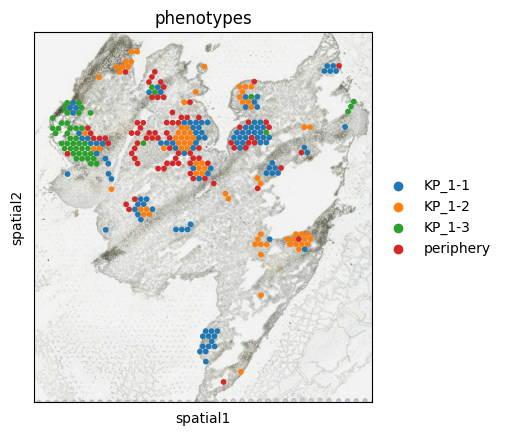

In [11]:
sc.pl.spatial(rna, img_key="hires", color=["phenotypes"], size=1.5)

## KP1_1

In [13]:
kp11rna = rna[(rna.obs['phenotypes'] == 'KP_1-1')]
kp11rna

View of AnnData object with n_obs × n_vars = 110 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'dendrogram_clusters', 'hvg', 'kmeans_colors', 'leiden', 'neighbors', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'raw_count'
    obsp: 'connectivities', 'distances'

In [14]:
kp11rna.write_h5ad('../Data/processedData3/kpn11rna.h5ad')

In [15]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kpn11rna.h5ad",
    genes_of_interest=["Tgfbr2"],
    num_top_genes_for_summary=  500,
    run_significance_test=True,
    n_permutations=30,
    alpha=0.1,
    grn_rebuild=True,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

2025-11-15 22:41:45,884	INFO util.py:154 -- Missing packages: ['ipywidgets']. Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.


[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_20251115_224145
[GenKI] Loading AnnData from: ../Data/processedData3/kpn11rna.h5ad
load counts from ../Data/processedData3/kpn11rna.h5ad
[GenKI] AnnData: 2504 genes × 110 cells

[GenKI] (1/1) KO: Tgfbr2


2025-11-15 22:41:46,820	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 22:41:56,784 E 446671 446700] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_22-41-46_120211_446213 is over 95% full, available space: 13140869120; capacity: 489997189120. Object creation will fail if spilling is required.
(raylet) [2025-11-15 22:42:06,788 E 446671 446700] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_22-41-46_120211_446213 is over 95% full, available space: 13140852736; capacity: 489997189120. Object creation will fail if spilling is required.
(raylet) [2025-11-15 22:42:16,791 E 446671 446700] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_22-41-46_120211_446213 is over 95% full, available space: 13140852736; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=30)


Permutating: 100%|██████████| 30/30 [00:01<00:00, 16.68it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 20

[GenKI] Combined significant saved.
  • Pairs: 20 | Unique genes: 20

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_20251115_224145


## KP1_2

In [37]:
kp12rna = rna[(rna.obs['phenotypes'] == 'KP_1-2')]
kp12rna

View of AnnData object with n_obs × n_vars = 75 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'dendrogram_clusters', 'hvg', 'kmeans_colors', 'leiden', 'neighbors', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'raw_count'
    obsp: 'connectivities', 'distances'

In [38]:
kp12rna.write_h5ad('../Data/processedData3/kpn12rna.h5ad')

In [39]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kpn12rna.h5ad",
    genes_of_interest=["Tgfbr2"],
    num_top_genes_for_summary=  500,
    run_significance_test=True,
    n_permutations=30,
    alpha=0.1,
    grn_rebuild=True,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_20251115_234825
[GenKI] Loading AnnData from: ../Data/processedData3/kpn12rna.h5ad
load counts from ../Data/processedData3/kpn12rna.h5ad
[GenKI] AnnData: 2504 genes × 75 cells

[GenKI] (1/1) KO: Tgfbr2


2025-11-15 23:48:26,006	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 23:48:35,952 E 449972 450001] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_23-48-25_297400_446213 is over 95% full, available space: 12860555264; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=30)


Permutating: 100%|██████████| 30/30 [00:01<00:00, 16.41it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 30

[GenKI] Combined significant saved.
  • Pairs: 30 | Unique genes: 30

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_20251115_234825


## KP1_3

In [40]:
kp13rna = rna[(rna.obs['phenotypes'] == 'KP_1-3')]
kp13rna

View of AnnData object with n_obs × n_vars = 47 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'dendrogram_clusters', 'hvg', 'kmeans_colors', 'leiden', 'neighbors', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'raw_count'
    obsp: 'connectivities', 'distances'

In [41]:
kp13rna.write_h5ad('../Data/processedData3/kpn13rna.h5ad')

In [42]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kpn13rna.h5ad",
    genes_of_interest=["Tgfbr2"],
    num_top_genes_for_summary=  500,
    run_significance_test=True,
    n_permutations=30,
    alpha=0.1,
    grn_rebuild=True,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_20251115_235015
[GenKI] Loading AnnData from: ../Data/processedData3/kpn13rna.h5ad
load counts from ../Data/processedData3/kpn13rna.h5ad
[GenKI] AnnData: 2504 genes × 47 cells

[GenKI] (1/1) KO: Tgfbr2


2025-11-15 23:50:16,330	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 23:50:26,280 E 451354 451383] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_23-50-15_620102_446213 is over 95% full, available space: 12739391488; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=30)


Permutating: 100%|██████████| 30/30 [00:01<00:00, 16.74it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 85

[GenKI] Combined significant saved.
  • Pairs: 85 | Unique genes: 85

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_20251115_235015


## periphery

In [17]:
kpperna = rna[(rna.obs['phenotypes'] == 'periphery')]
kpperna

View of AnnData object with n_obs × n_vars = 79 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'dendrogram_clusters', 'hvg', 'kmeans_colors', 'leiden', 'neighbors', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'raw_count'
    obsp: 'connectivities', 'distances'

In [18]:
kpperna.write_h5ad('../Data/processedData3/kpperna.h5ad')

In [19]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kpperna.h5ad",
    genes_of_interest=["Tgfbr2"],
    num_top_genes_for_summary=  500,
    run_significance_test=True,
    n_permutations=30,
    alpha=0.1,
    grn_rebuild=True,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_20251115_224749
[GenKI] Loading AnnData from: ../Data/processedData3/kpperna.h5ad
load counts from ../Data/processedData3/kpperna.h5ad
[GenKI] AnnData: 2504 genes × 79 cells

[GenKI] (1/1) KO: Tgfbr2


2025-11-15 22:47:50,426	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 22:48:00,377 E 448138 448167] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_22-47-49_726615_446213 is over 95% full, available space: 13002457088; capacity: 489997189120. Object creation will fail if spilling is required.
(raylet) [2025-11-15 22:48:10,380 E 448138 448167] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_22-47-49_726615_446213 is over 95% full, available space: 13002432512; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=30)


Permutating: 100%|██████████| 30/30 [00:01<00:00, 16.62it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 105

[GenKI] Combined significant saved.
  • Pairs: 105 | Unique genes: 105

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_20251115_224749


## How does GenKI results align with differential RNA expression?

### KP1_1

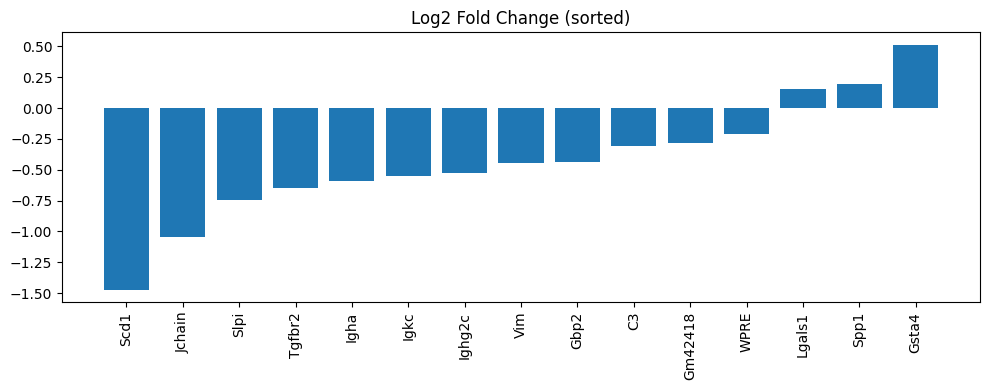

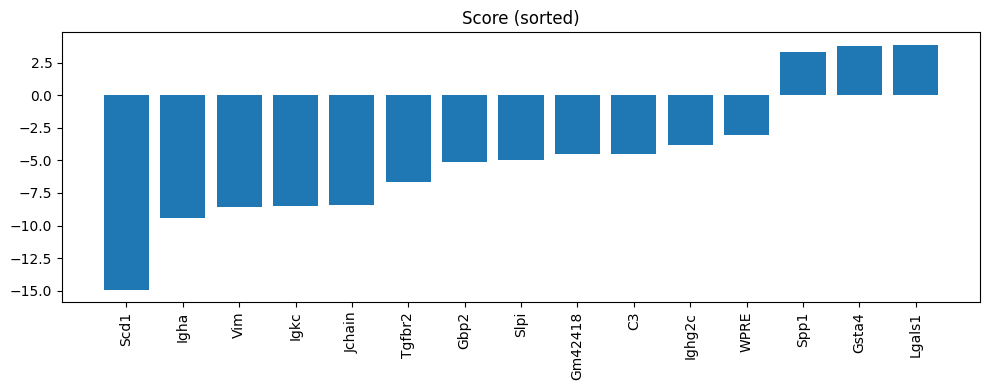

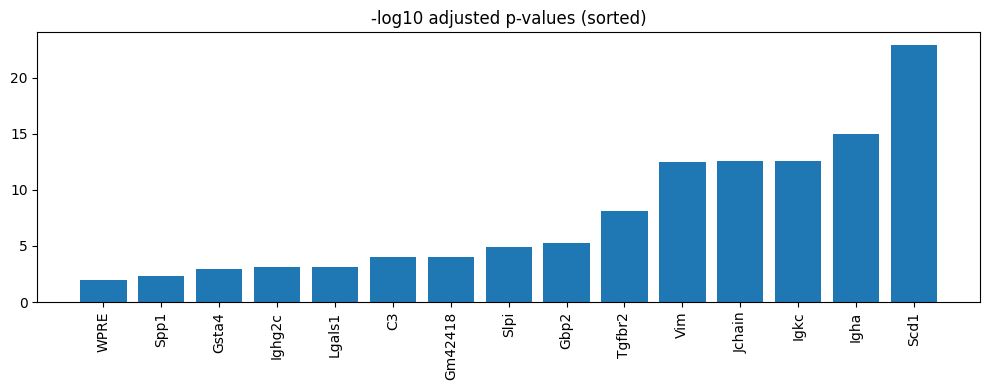

In [16]:
import pandas as pd
import numpy as np

all_sig = pd.read_csv("../GenKI/GenKI_NB_Tgfbr2_20251115_224145/ALL_Significant_Genes_Combined.csv", index_col=0)
deg = pd.read_csv("../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv", index_col=0)


# dedupe
all_sig = all_sig[~all_sig.index.duplicated(keep='first')]
deg = deg[~deg.index.duplicated(keep='first')]

common = all_sig.index.intersection(deg.index)
merged = pd.concat([deg.loc[common], all_sig.loc[common]], axis=1)

if "pvals_adj" in merged.columns:
    merged["-log10_padj"] = -np.log10(merged["pvals_adj"])

merged.head()


import matplotlib.pyplot as plt

# --- Barplot 1: log2FC ---
df1 = merged.sort_values("logfoldchanges")
plt.figure(figsize=(10,4))
plt.bar(df1.index, df1["logfoldchanges"])
plt.xticks(rotation=90)
plt.title("Log2 Fold Change (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 2: Scores ---
df2 = merged.sort_values("scores")
plt.figure(figsize=(10,4))
plt.bar(df2.index, df2["scores"])
plt.xticks(rotation=90)
plt.title("Score (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 3: -log10(padj) ---
df3 = merged.sort_values("-log10_padj")
plt.figure(figsize=(10,4))
plt.bar(df3.index, df3["-log10_padj"])
plt.xticks(rotation=90)
plt.title("-log10 adjusted p-values (sorted)")
plt.tight_layout()
plt.show()

### Periphery

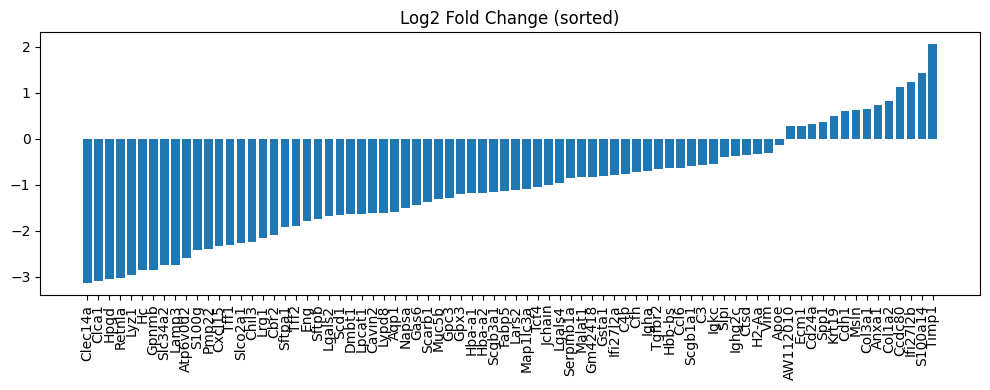

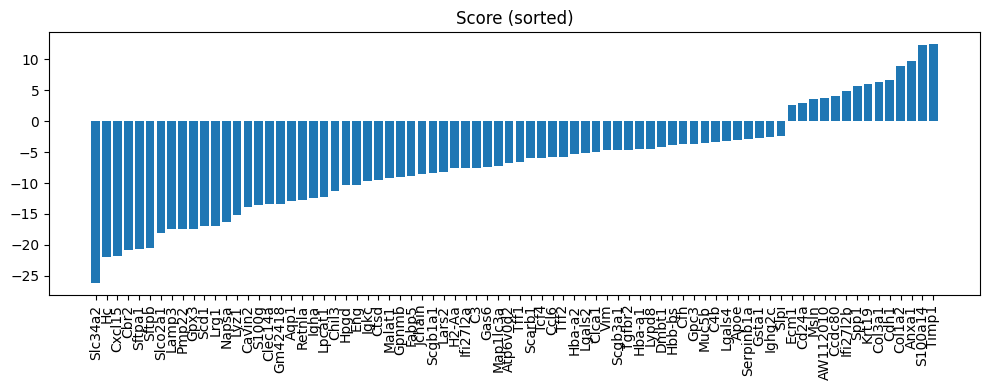

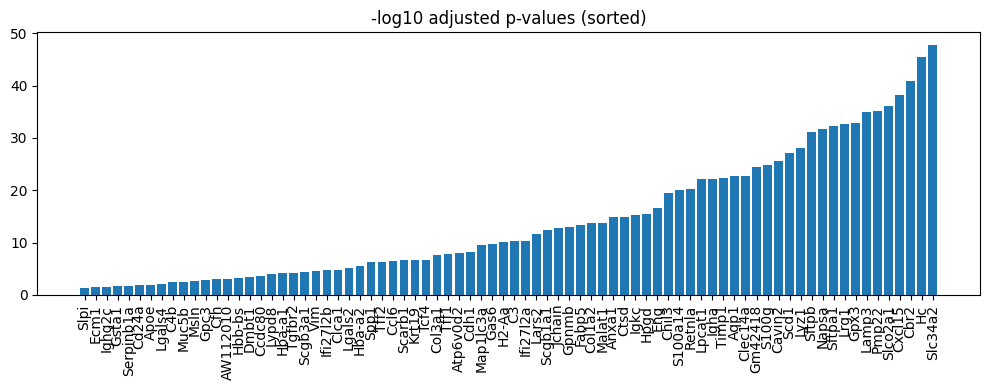

In [20]:
import pandas as pd
import numpy as np

all_sig = pd.read_csv("../GenKI/GenKI_NB_Tgfbr2_20251115_224749/ALL_Significant_Genes_Combined.csv", index_col=0)
deg = pd.read_csv("../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv", index_col=0)


# dedupe
all_sig = all_sig[~all_sig.index.duplicated(keep='first')]
deg = deg[~deg.index.duplicated(keep='first')]

common = all_sig.index.intersection(deg.index)
merged = pd.concat([deg.loc[common], all_sig.loc[common]], axis=1)

if "pvals_adj" in merged.columns:
    merged["-log10_padj"] = -np.log10(merged["pvals_adj"])

merged.head()


import matplotlib.pyplot as plt

# --- Barplot 1: log2FC ---
df1 = merged.sort_values("logfoldchanges")
plt.figure(figsize=(10,4))
plt.bar(df1.index, df1["logfoldchanges"])
plt.xticks(rotation=90)
plt.title("Log2 Fold Change (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 2: Scores ---
df2 = merged.sort_values("scores")
plt.figure(figsize=(10,4))
plt.bar(df2.index, df2["scores"])
plt.xticks(rotation=90)
plt.title("Score (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 3: -log10(padj) ---
df3 = merged.sort_values("-log10_padj")
plt.figure(figsize=(10,4))
plt.bar(df3.index, df3["-log10_padj"])
plt.xticks(rotation=90)
plt.title("-log10 adjusted p-values (sorted)")
plt.tight_layout()
plt.show()

# Digital KOs  on niche modality

In [16]:
niche1 = sc.read('../Data/UnitedNet/input_data/adata_niche_train_perturbmap_KP2_1.h5ad')
niche2 = sc.read('../Data/UnitedNet/input_data/adata_niche_test_perturbmap_KP2_1.h5ad')

In [17]:
import anndata as ad

niche1.obs_names_make_unique()
niche2.obs_names_make_unique()

niche_temp = ad.concat(
    [niche1, niche2],
    join="outer",           # 'inner' if you only want shared genes
    label="batch",
    keys=["niche1","niche2"],
    index_unique=None,
    merge="same"
)

niche_temp

AnnData object with n_obs × n_vars = 311 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans', 'discovered_cluster_id', 'discovered_cluster', 'cluster_discovery_timestamp', 'cluster_discovery_method', 'cluster_total_count', 'batch'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    obsm: 'X_pca', 'X_umap', 'spatial'

In [14]:
niche_temp.obs

,in_tissue,array_row,array_col,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,...,clusters,cell_type,phenotypes,kmeans,discovered_cluster_id,discovered_cluster,cluster_discovery_timestamp,cluster_discovery_method,cluster_total_count,batch
CCTTCTTGATCCAGTG,1,19,73,6413,8.766238,29550.0,10.293873,25.082910,35.607445,46.243655,...,10,Dendritic Cell,KP_1-2,tumor,0,Cluster_0,2025-11-15T16:01:32.520402,UnitedNet_predict_label,4,niche1
TCAGGGTGTAACGTAA,1,28,72,7522,8.925720,39892.0,10.593956,23.393162,32.926401,42.850697,...,10,Dendritic Cell,KP_1-1,tumor,2,Cluster_2,2025-11-15T16:01:32.520402,UnitedNet_predict_label,4,niche1
TATCCTATCAACTGGT,1,69,59,5118,8.540714,17028.0,9.742673,21.658445,30.708245,40.715292,...,9,Dendritic Cell,KP_1-1,tumor,2,Cluster_2,2025-11-15T16:01:32.520402,UnitedNet_predict_label,4,niche1
GTACTAAGATTTGGAG,1,27,55,6769,8.820256,31855.0,10.368981,22.815884,33.115680,42.614974,...,10,Dendritic Cell,KP_1-2,tumor,0,Cluster_0,2025-11-15T16:01:32.520402,UnitedNet_predict_label,4,niche1
CAATAAACCTTGGCCC,1,26,74,7188,8.880307,36471.0,10.504300,22.516520,32.170766,41.956623,...,10,Dendritic Cell,KP_1-1,tumor,2,Cluster_2,2025-11-15T16:01:32.520402,UnitedNet_predict_label,4,niche1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GGTGATAAGGAGCAGT,1,37,79,4658,8.446556,14802.0,9.602585,26.199162,35.022294,44.095393,...,4,Endothelial Cell,periphery,tumor,0,Cluster_0,2025-11-15T16:01:34.738572,UnitedNet_predict_label,4,niche2
GTGATCACTAACGCCT,1,47,97,6312,8.750366,29064.0,10.277290,34.035233,42.399532,50.488577,...,3,Clara Cell,KP_1-2,tumor,2,Cluster_2,2025-11-15T16:01:34.738572,UnitedNet_predict_label,4,niche2
TAGAGTCTAAGCGAAC,1,29,55,8199,9.011889,47151.0,10.761131,21.649594,30.798923,40.056414,...,10,Dendritic Cell,KP_1-2,tumor,0,Cluster_0,2025-11-15T16:01:34.738572,UnitedNet_predict_label,4,niche2
GAGACTGATGGGTAGA,1,28,56,7777,8.959055,43312.0,10.676208,22.298670,31.979590,41.554304,...,10,Dendritic Cell,KP_1-2,tumor,0,Cluster_0,2025-11-15T16:01:34.738572,UnitedNet_predict_label,4,niche2


In [18]:
niche = sc.read('../Data/processedData3/niche_modality.h5ad')
niche

AnnData object with n_obs × n_vars = 311 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'dendrogram_clusters', 'hvg', 'kmeans_colors', 'leiden', 'modality', 'neighbors', 'niche_method', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'

In [19]:

# 1) Align barcodes (just in case formats differ)
def norm(idx: pd.Index) -> pd.Index:
    return idx.astype(str).str.replace(r"-1$", "", regex=True).str.upper()

niche.obs_names      = norm(niche.obs_names)
niche_temp.obs_names = norm(niche_temp.obs_names)

# 2) Subset `niche` to the 311 spots of `niche_temp`, preserving order
keep = niche_temp.obs_names.intersection(niche.obs_names, sort=False)
niche_311 = niche[keep].copy()          # now 311 × 2504, same order as niche_temp

# (optional) sanity checks
assert len(niche_311) == len(niche_temp)
assert (niche_311.obs_names == niche_temp.obs_names).all()

# 3) Transfer columns from niche_temp → niche_311
col = "discovered_cluster"
if col in niche_temp.obs:
    niche_311.obs[col] = niche_temp.obs[col].values
else:
    raise KeyError(f"Column '{col}' not found in niche_temp.obs")



print(niche.shape, "→ downsampled to", niche_311.shape)
print(niche_311.obs.columns[-8:])  # quick peek

# 4) (optional) Save
# niche_311.write_h5ad("adata_niche_downsampled_to_311.h5ad")

(311, 2504) → downsampled to (311, 2504)
Index(['total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito',
       'clusters', 'cell_type', 'phenotypes', 'kmeans', 'discovered_cluster'],
      dtype='object')


In [16]:
niche_311.obs

,in_tissue,array_row,array_col,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mito,log1p_total_counts_mito,pct_counts_mito,clusters,cell_type,phenotypes,kmeans,discovered_cluster
CCTTCTTGATCCAGTG,1,19,73,6413,8.766238,29550.0,10.293873,25.082910,35.607445,46.243655,58.084602,1160.0,7.057037,3.925550,10,Dendritic Cell,KP_1-2,tumor,Cluster_0
TCAGGGTGTAACGTAA,1,28,72,7522,8.925720,39892.0,10.593956,23.393162,32.926401,42.850697,55.259200,1264.0,7.142828,3.168555,10,Dendritic Cell,KP_1-1,tumor,Cluster_2
TATCCTATCAACTGGT,1,69,59,5118,8.540714,17028.0,9.742673,21.658445,30.708245,40.715292,54.175476,529.0,6.272877,3.106648,9,Dendritic Cell,KP_1-1,tumor,Cluster_2
GTACTAAGATTTGGAG,1,27,55,6769,8.820256,31855.0,10.368981,22.815884,33.115680,42.614974,55.288024,789.0,6.672033,2.476848,10,Dendritic Cell,KP_1-2,tumor,Cluster_0
CAATAAACCTTGGCCC,1,26,74,7188,8.880307,36471.0,10.504300,22.516520,32.170766,41.956623,54.489869,1159.0,7.056175,3.177867,10,Dendritic Cell,KP_1-1,tumor,Cluster_2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GGTGATAAGGAGCAGT,1,37,79,4658,8.446556,14802.0,9.602585,26.199162,35.022294,44.095393,56.370761,438.0,6.084499,2.959059,4,Endothelial Cell,periphery,tumor,Cluster_0
GTGATCACTAACGCCT,1,47,97,6312,8.750366,29064.0,10.277290,34.035233,42.399532,50.488577,60.814066,775.0,6.654152,2.666529,3,Clara Cell,KP_1-2,tumor,Cluster_2
TAGAGTCTAAGCGAAC,1,29,55,8199,9.011889,47151.0,10.761131,21.649594,30.798923,40.056414,52.376408,1368.0,7.221836,2.901317,10,Dendritic Cell,KP_1-2,tumor,Cluster_0
GAGACTGATGGGTAGA,1,28,56,7777,8.959055,43312.0,10.676208,22.298670,31.979590,41.554304,54.227466,1063.0,6.969790,2.454285,10,Dendritic Cell,KP_1-2,tumor,Cluster_0


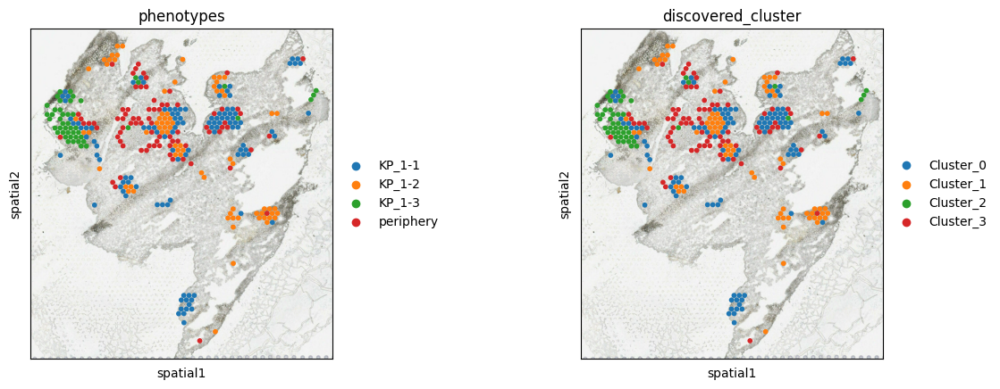

In [20]:
sc.pl.spatial(niche_311, img_key="hires", color=["phenotypes", 'discovered_cluster'], size=1.5)

In [23]:
niche = niche_311

## KP1_2

In [24]:
# This is the only pure Cluster with KP1_2
kp12n = niche[(niche.obs['discovered_cluster'] == 'Cluster_1')]
kp12n

View of AnnData object with n_obs × n_vars = 75 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans', 'discovered_cluster'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'dendrogram_clusters', 'hvg', 'kmeans_colors', 'leiden', 'modality', 'neighbors', 'niche_method', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial', 'umap', 'discovered_cluster_colors'
    obsm: 'X_pca', 'X_umap', 'spatial'

In [25]:
kp12n.write_h5ad('../Data/processedData3/kpn12n.h5ad')

In [26]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kpn12n.h5ad",
    genes_of_interest=["Tgfbr2"],
    num_top_genes_for_summary=  500,
    run_significance_test=True,
    n_permutations=30,
    alpha=0.1,
    grn_rebuild=True,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

2025-11-15 17:15:01,915	INFO util.py:154 -- Missing packages: ['ipywidgets']. Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.


[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_20251115_171501
[GenKI] Loading AnnData from: ../Data/processedData3/kpn12n.h5ad
load counts from ../Data/processedData3/kpn12n.h5ad
[GenKI] AnnData: 2504 genes × 75 cells

[GenKI] (1/1) KO: Tgfbr2


2025-11-15 17:15:02,990	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 17:15:12,958 E 432916 432945] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-15-02_186892_432393 is over 95% full, available space: 13256437760; capacity: 489997189120. Object creation will fail if spilling is required.
(raylet) [2025-11-15 17:15:22,961 E 432916 432945] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-15-02_186892_432393 is over 95% full, available space: 13256413184; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=30)


Permutating: 100%|██████████| 30/30 [00:01<00:00, 16.69it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 21

[GenKI] Combined significant saved.
  • Pairs: 21 | Unique genes: 21

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_20251115_171501


In [27]:
res["combined_significant"].head(40)

,dis,index,hit,rank,KO_gene
Tgfbr2,50568.112211,1359,29,1,Tgfbr2
Scgb1a1,5.943073,2333,30,2,Tgfbr2
Ighg1,5.336398,1774,30,3,Tgfbr2
Scgb3a1,2.485089,1536,30,4,Tgfbr2
Lgals1,2.248838,2002,30,5,Tgfbr2
Igkc,2.244724,818,29,6,Tgfbr2
Ighg2b,2.124178,1773,29,7,Tgfbr2
Jchain,1.853698,665,29,8,Tgfbr2
Vim,1.289246,166,29,9,Tgfbr2
Tff2,1.210337,2177,29,10,Tgfbr2


## KP1_1

In [28]:
kp11n = niche[(niche.obs['discovered_cluster'] == 'Cluster_0')]
kp11n

View of AnnData object with n_obs × n_vars = 110 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans', 'discovered_cluster'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'dendrogram_clusters', 'hvg', 'kmeans_colors', 'leiden', 'modality', 'neighbors', 'niche_method', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial', 'umap', 'discovered_cluster_colors'
    obsm: 'X_pca', 'X_umap', 'spatial'

In [29]:
kp11n.write_h5ad('../Data/processedData3/kpn11n.h5ad')

In [30]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kpn11n.h5ad",
    genes_of_interest=["Tgfbr2"],
    num_top_genes_for_summary=  500,
    run_significance_test=True,
    n_permutations=30,
    alpha=0.1,
    grn_rebuild=True,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_20251115_171757
[GenKI] Loading AnnData from: ../Data/processedData3/kpn11n.h5ad
load counts from ../Data/processedData3/kpn11n.h5ad
[GenKI] AnnData: 2504 genes × 110 cells

[GenKI] (1/1) KO: Tgfbr2


2025-11-15 17:17:58,147	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 17:18:08,089 E 434311 434340] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-17-57_413110_432393 is over 95% full, available space: 13254410240; capacity: 489997189120. Object creation will fail if spilling is required.
(raylet) [2025-11-15 17:18:18,093 E 434311 434340] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-17-57_413110_432393 is over 95% full, available space: 13254389760; capacity: 489997189120. Object creation will fail if spilling is required.
(raylet) [2025-11-15 17:18:28,096 E 434311 434340] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-17-57_413110_432393 is over 95% full, available space: 13254389760; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=30)


Permutating: 100%|██████████| 30/30 [00:01<00:00, 16.70it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 79

[GenKI] Combined significant saved.
  • Pairs: 79 | Unique genes: 79

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_20251115_171757


In [31]:
res["combined_significant"].head(40)

,dis,index,hit,rank,KO_gene
Tgfbr2,1.534739e+06,1359,30,1,Tgfbr2
Ighg2c,7.511787e+03,1772,30,2,Tgfbr2
Ighg1,7.287322e+03,1774,30,3,Tgfbr2
Igha,5.794564e+01,1770,30,4,Tgfbr2
Ighg2b,4.644629e+01,1773,30,5,Tgfbr2
Spp1,3.918306e+01,685,30,6,Tgfbr2
Trf,1.878950e+01,1337,30,7,Tgfbr2
Ambp,1.753240e+01,526,30,8,Tgfbr2
Tff1,1.672103e+01,2178,30,9,Tgfbr2
Scgb3a1,1.565909e+01,1536,30,10,Tgfbr2


## Periphery

In [32]:
kppern = niche[(niche.obs['phenotypes'] == 'periphery')]
kppern

View of AnnData object with n_obs × n_vars = 79 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans', 'discovered_cluster'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'dendrogram_clusters', 'hvg', 'kmeans_colors', 'leiden', 'modality', 'neighbors', 'niche_method', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial', 'umap', 'discovered_cluster_colors'
    obsm: 'X_pca', 'X_umap', 'spatial'

In [33]:
kppern.write_h5ad('../Data/processedData3/kppern.h5ad')

In [34]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kppern.h5ad",
    genes_of_interest=["Tgfbr2"],
    num_top_genes_for_summary=  500,
    run_significance_test=True,
    n_permutations=30,
    alpha=0.1,
    grn_rebuild=True,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_20251115_171959
[GenKI] Loading AnnData from: ../Data/processedData3/kppern.h5ad
load counts from ../Data/processedData3/kppern.h5ad
[GenKI] AnnData: 2504 genes × 79 cells

[GenKI] (1/1) KO: Tgfbr2


2025-11-15 17:20:00,638	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 17:20:10,579 E 435694 435723] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-19-59_913038_432393 is over 95% full, available space: 13252395008; capacity: 489997189120. Object creation will fail if spilling is required.
(raylet) [2025-11-15 17:20:20,581 E 435694 435723] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-19-59_913038_432393 is over 95% full, available space: 13252374528; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=30)


Permutating: 100%|██████████| 30/30 [00:01<00:00, 16.31it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 90

[GenKI] Combined significant saved.
  • Pairs: 90 | Unique genes: 90

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_20251115_171959


In [35]:
res["combined_significant"].head(40)

,dis,index,hit,rank,KO_gene
Tgfbr2,1.811949e+06,1359,30,1,Tgfbr2
Ighg2c,2.414455e+04,1772,30,2,Tgfbr2
Ighg1,1.309908e+04,1774,30,3,Tgfbr2
Retnla,1.069476e+04,2110,30,4,Tgfbr2
Lypd8,1.060528e+04,1547,30,5,Tgfbr2
Scgb1a1,9.502308e+03,2333,30,6,Tgfbr2
Lgals2,9.003338e+03,2001,30,7,Tgfbr2
Clca1,8.920851e+03,478,30,8,Tgfbr2
Ighg2b,7.706794e+03,1773,30,9,Tgfbr2
Gm42418,7.647742e+03,2207,30,10,Tgfbr2


## KP1_3

In [36]:
kp13n = niche[(niche.obs['phenotypes'] == 'KP_1-3')]
kp13n

View of AnnData object with n_obs × n_vars = 47 × 2504
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans', 'discovered_cluster'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'dendrogram_clusters', 'hvg', 'kmeans_colors', 'leiden', 'modality', 'neighbors', 'niche_method', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'spatial', 'umap', 'discovered_cluster_colors'
    obsm: 'X_pca', 'X_umap', 'spatial'

In [37]:
kp13n.write_h5ad('../Data/processedData3/kp13n.h5ad')

In [38]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kp13n.h5ad",
    genes_of_interest=["Tgfbr2"],
    num_top_genes_for_summary=  500,
    run_significance_test=True,
    n_permutations=30,
    alpha=0.1,
    grn_rebuild=True,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_20251115_172120
[GenKI] Loading AnnData from: ../Data/processedData3/kp13n.h5ad
load counts from ../Data/processedData3/kp13n.h5ad
[GenKI] AnnData: 2504 genes × 47 cells

[GenKI] (1/1) KO: Tgfbr2


2025-11-15 17:21:21,674	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 17:21:31,614 E 437074 437103] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-21-20_929412_432393 is over 95% full, available space: 13251534848; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=30)


Permutating: 100%|██████████| 30/30 [00:01<00:00, 16.30it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 68

[GenKI] Combined significant saved.
  • Pairs: 68 | Unique genes: 68

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_20251115_172120


In [39]:
res["combined_significant"].head(40)

,dis,index,hit,rank,KO_gene
Tgfbr2,64680.468976,1359,30,1,Tgfbr2
Ighg1,1.134927,1774,30,2,Tgfbr2
Iglc1,0.774627,2064,30,3,Tgfbr2
Igha,0.575516,1770,30,4,Tgfbr2
Gm42418,0.552744,2207,30,5,Tgfbr2
Igkc,0.542181,818,30,6,Tgfbr2
Malat1,0.537218,2330,30,7,Tgfbr2
Scgb1a1,0.501462,2333,30,8,Tgfbr2
Eln,0.474558,728,30,9,Tgfbr2
Jchain,0.468343,665,30,10,Tgfbr2


## How does GenKI results align with differential activity analysis?

### KP1_1

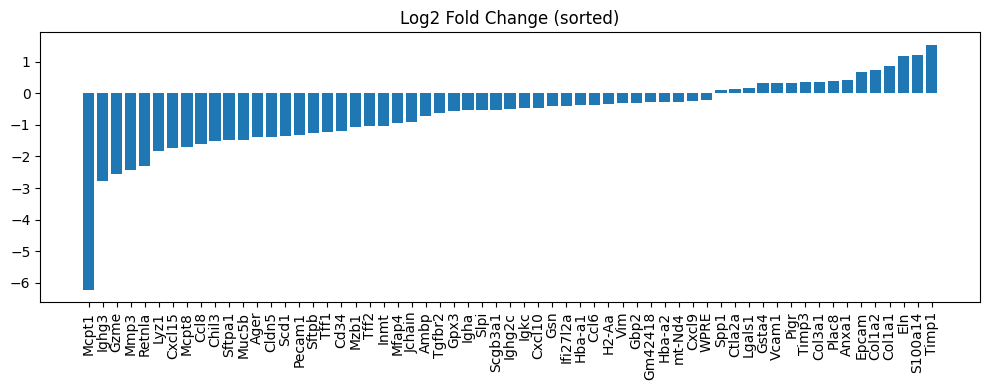

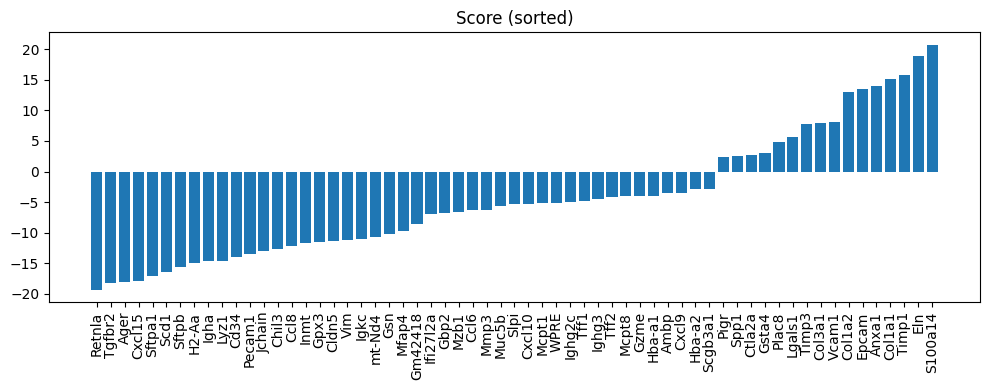

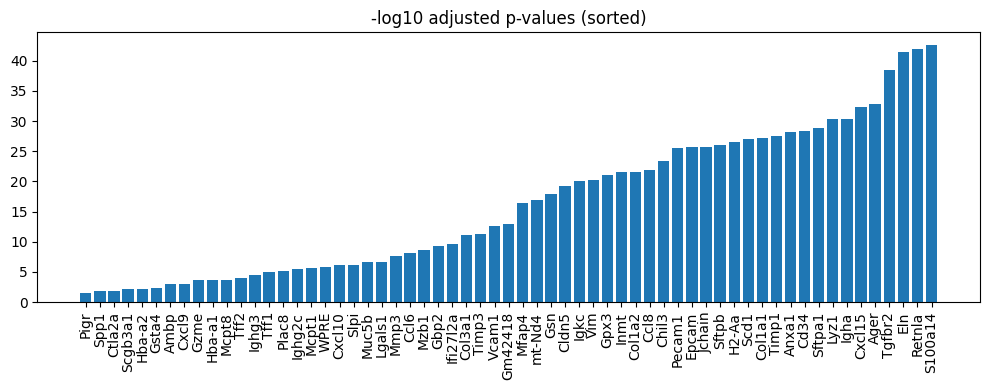

In [41]:
import pandas as pd
import numpy as np

all_sig = pd.read_csv("../GenKI/GenKI_NB_Tgfbr2_20251115_171757/ALL_Significant_Genes_Combined.csv", index_col=0)
deg = pd.read_csv("../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv", index_col=0)


# dedupe
all_sig = all_sig[~all_sig.index.duplicated(keep='first')]
deg = deg[~deg.index.duplicated(keep='first')]

common = all_sig.index.intersection(deg.index)
merged = pd.concat([deg.loc[common], all_sig.loc[common]], axis=1)

if "pvals_adj" in merged.columns:
    merged["-log10_padj"] = -np.log10(merged["pvals_adj"])

merged.head()


import matplotlib.pyplot as plt

# --- Barplot 1: log2FC ---
df1 = merged.sort_values("logfoldchanges")
plt.figure(figsize=(10,4))
plt.bar(df1.index, df1["logfoldchanges"])
plt.xticks(rotation=90)
plt.title("Log2 Fold Change (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 2: Scores ---
df2 = merged.sort_values("scores")
plt.figure(figsize=(10,4))
plt.bar(df2.index, df2["scores"])
plt.xticks(rotation=90)
plt.title("Score (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 3: -log10(padj) ---
df3 = merged.sort_values("-log10_padj")
plt.figure(figsize=(10,4))
plt.bar(df3.index, df3["-log10_padj"])
plt.xticks(rotation=90)
plt.title("-log10 adjusted p-values (sorted)")
plt.tight_layout()
plt.show()

### KP1_2

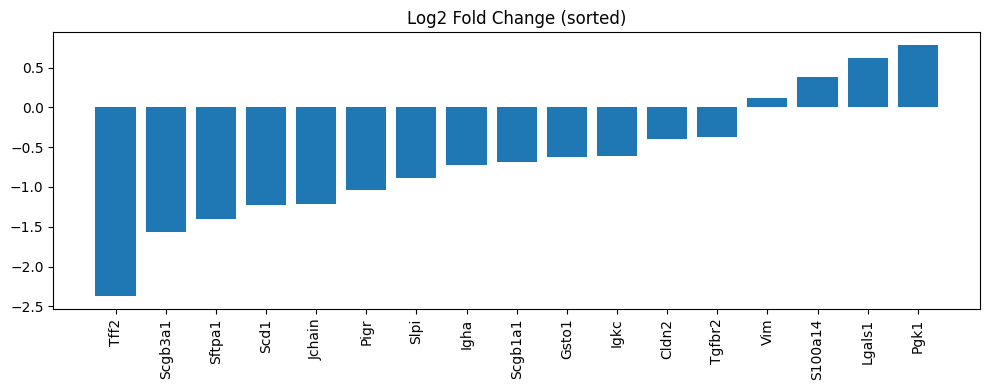

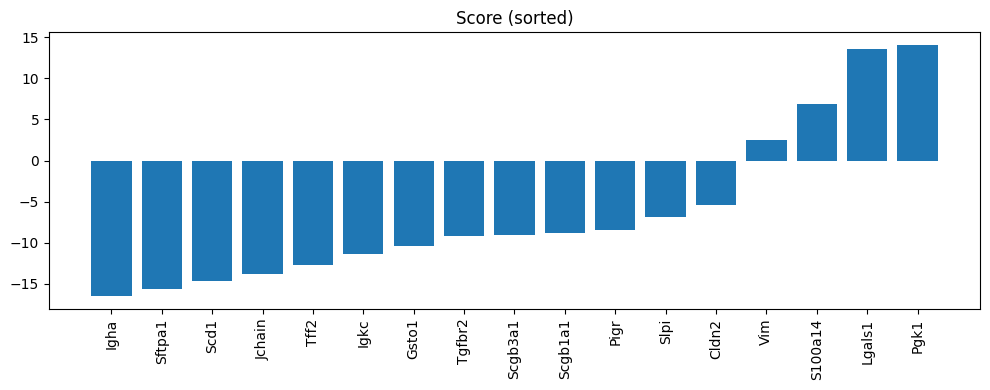

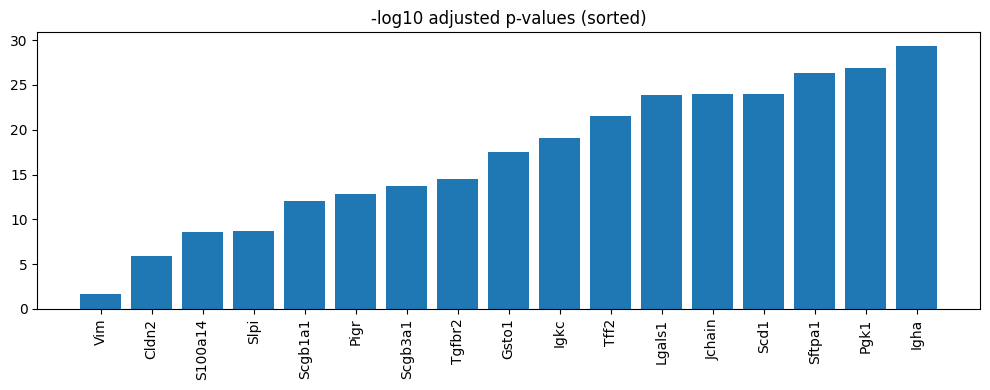

In [43]:
import pandas as pd
import numpy as np

all_sig = pd.read_csv("../GenKI/GenKI_NB_Tgfbr2_20251115_171501/ALL_Significant_Genes_Combined.csv", index_col=0)
deg = pd.read_csv("../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-2/DEGs_padj_lt_0.05_niche.csv", index_col=0)


# dedupe
all_sig = all_sig[~all_sig.index.duplicated(keep='first')]
deg = deg[~deg.index.duplicated(keep='first')]

common = all_sig.index.intersection(deg.index)
merged = pd.concat([deg.loc[common], all_sig.loc[common]], axis=1)

if "pvals_adj" in merged.columns:
    merged["-log10_padj"] = -np.log10(merged["pvals_adj"])

merged.head()


import matplotlib.pyplot as plt

# --- Barplot 1: log2FC ---
df1 = merged.sort_values("logfoldchanges")
plt.figure(figsize=(10,4))
plt.bar(df1.index, df1["logfoldchanges"])
plt.xticks(rotation=90)
plt.title("Log2 Fold Change (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 2: Scores ---
df2 = merged.sort_values("scores")
plt.figure(figsize=(10,4))
plt.bar(df2.index, df2["scores"])
plt.xticks(rotation=90)
plt.title("Score (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 3: -log10(padj) ---
df3 = merged.sort_values("-log10_padj")
plt.figure(figsize=(10,4))
plt.bar(df3.index, df3["-log10_padj"])
plt.xticks(rotation=90)
plt.title("-log10 adjusted p-values (sorted)")
plt.tight_layout()
plt.show()

### periphery

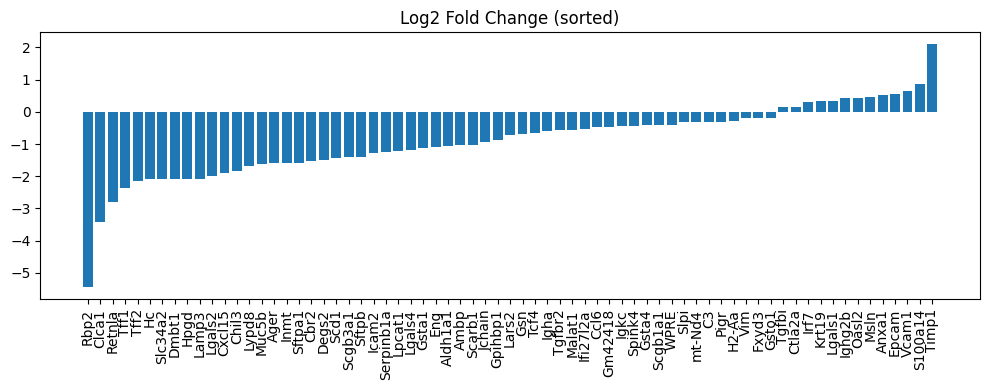

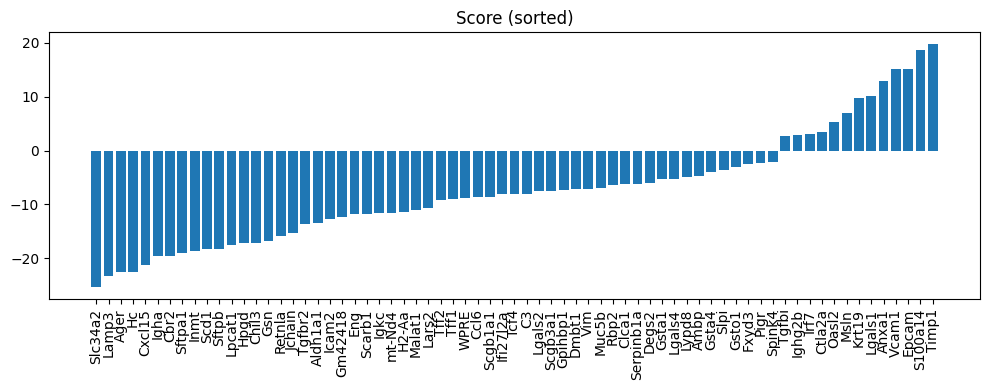

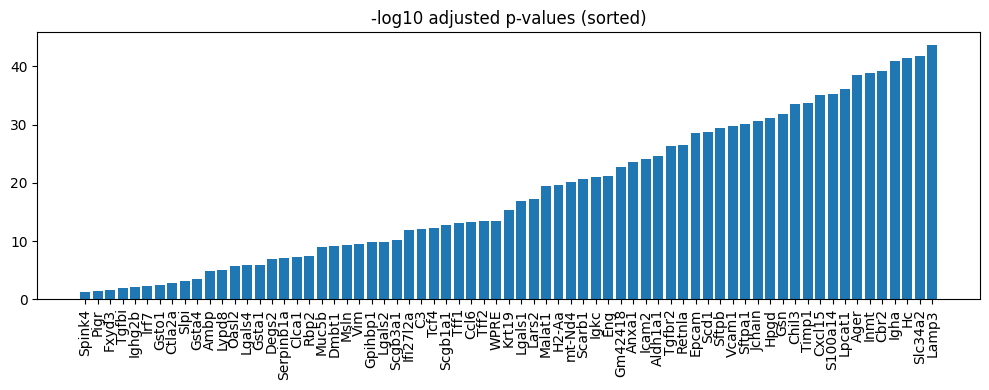

In [44]:
import pandas as pd
import numpy as np

all_sig = pd.read_csv("../GenKI/GenKI_NB_Tgfbr2_20251115_171959/ALL_Significant_Genes_Combined.csv", index_col=0)
deg = pd.read_csv("../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv", index_col=0)


# dedupe
all_sig = all_sig[~all_sig.index.duplicated(keep='first')]
deg = deg[~deg.index.duplicated(keep='first')]

common = all_sig.index.intersection(deg.index)
merged = pd.concat([deg.loc[common], all_sig.loc[common]], axis=1)

if "pvals_adj" in merged.columns:
    merged["-log10_padj"] = -np.log10(merged["pvals_adj"])

merged.head()


import matplotlib.pyplot as plt

# --- Barplot 1: log2FC ---
df1 = merged.sort_values("logfoldchanges")
plt.figure(figsize=(10,4))
plt.bar(df1.index, df1["logfoldchanges"])
plt.xticks(rotation=90)
plt.title("Log2 Fold Change (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 2: Scores ---
df2 = merged.sort_values("scores")
plt.figure(figsize=(10,4))
plt.bar(df2.index, df2["scores"])
plt.xticks(rotation=90)
plt.title("Score (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 3: -log10(padj) ---
df3 = merged.sort_values("-log10_padj")
plt.figure(figsize=(10,4))
plt.bar(df3.index, df3["-log10_padj"])
plt.xticks(rotation=90)
plt.title("-log10 adjusted p-values (sorted)")
plt.tight_layout()
plt.show()

### KP1_3

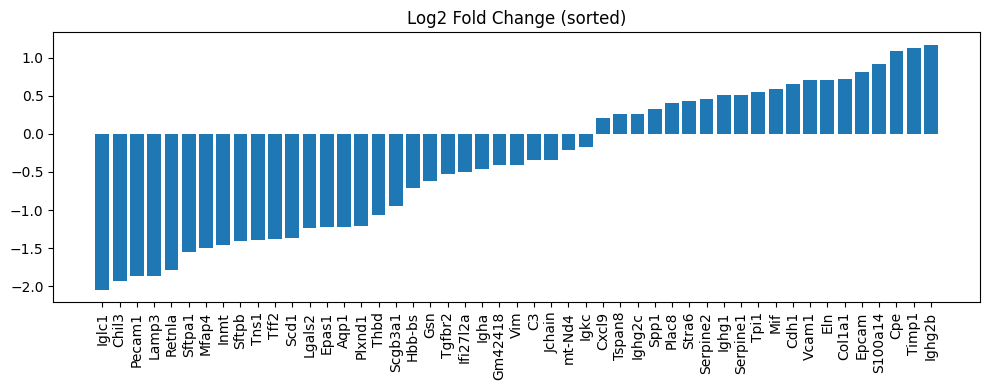

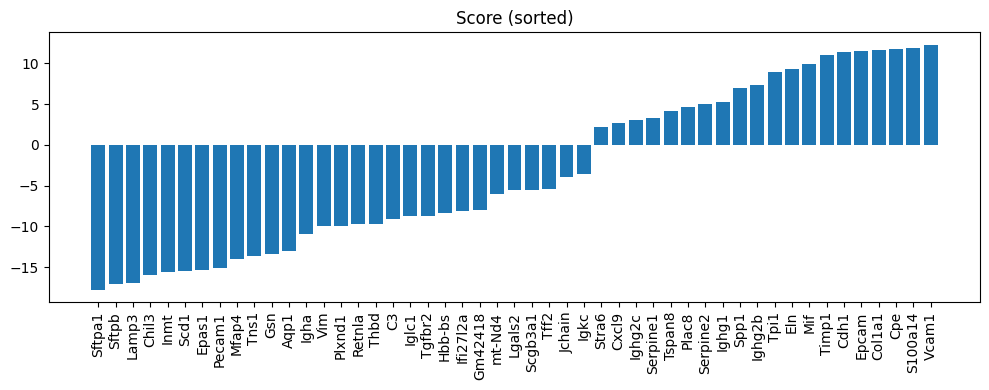

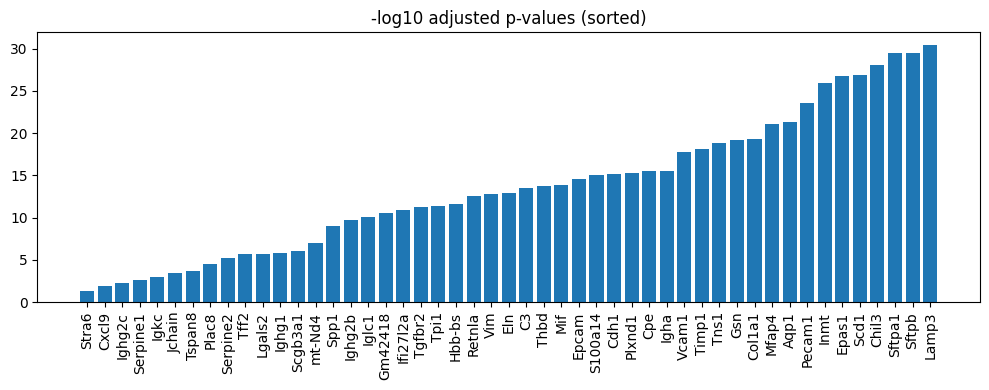

In [45]:
import pandas as pd
import numpy as np

all_sig = pd.read_csv("../GenKI/GenKI_NB_Tgfbr2_20251115_172120/ALL_Significant_Genes_Combined.csv", index_col=0)
deg = pd.read_csv("../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-3/DEGs_padj_lt_0.05.csv", index_col=0)


# dedupe
all_sig = all_sig[~all_sig.index.duplicated(keep='first')]
deg = deg[~deg.index.duplicated(keep='first')]

common = all_sig.index.intersection(deg.index)
merged = pd.concat([deg.loc[common], all_sig.loc[common]], axis=1)

if "pvals_adj" in merged.columns:
    merged["-log10_padj"] = -np.log10(merged["pvals_adj"])

merged.head()


import matplotlib.pyplot as plt

# --- Barplot 1: log2FC ---
df1 = merged.sort_values("logfoldchanges")
plt.figure(figsize=(10,4))
plt.bar(df1.index, df1["logfoldchanges"])
plt.xticks(rotation=90)
plt.title("Log2 Fold Change (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 2: Scores ---
df2 = merged.sort_values("scores")
plt.figure(figsize=(10,4))
plt.bar(df2.index, df2["scores"])
plt.xticks(rotation=90)
plt.title("Score (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 3: -log10(padj) ---
df3 = merged.sort_values("-log10_padj")
plt.figure(figsize=(10,4))
plt.bar(df3.index, df3["-log10_padj"])
plt.xticks(rotation=90)
plt.title("-log10 adjusted p-values (sorted)")
plt.tight_layout()
plt.show()

# Digital KO on activity modality

In [46]:
activity1 = sc.read('../Data/UnitedNet/input_data/adata_activity_train_perturbmap_KP2_1.h5ad')
activity2 = sc.read('../Data/UnitedNet/input_data/adata_activity_test_perturbmap_KP2_1.h5ad')

In [47]:
activity1.obs_names_make_unique()
activity2.obs_names_make_unique()

activity_temp = ad.concat(
    [activity1, activity2],
    join="outer",           # 'inner' if you only want shared genes
    label="batch",
    keys=["activity1","activity2"],
    index_unique=None,
    merge="same"
)

activity_temp

AnnData object with n_obs × n_vars = 311 × 2503
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans', 'discovered_cluster_id', 'discovered_cluster', 'cluster_discovery_timestamp', 'cluster_discovery_method', 'cluster_total_count', 'batch'
    var: 'activity_type', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    obsm: 'X_pca', 'X_umap', 'spatial'

In [48]:
activity = sc.read('../Data/processedData3/activity_modality.h5ad')
activity

AnnData object with n_obs × n_vars = 311 × 2503
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'clusters', 'cell_type', 'phenotypes', 'kmeans'
    var: 'activity_type', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell_type_colors', 'clusters_colors', 'dendrogram_clusters', 'hvg', 'leiden', 'neighbors', 'pca', 'phenotypes_colors', 'rank_genes_groups', 'scMINER_info', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    obsp: 'connectivities', 'distances'

In [50]:
import pandas as pd

# 1) Align barcodes (just in case formats differ)
def norm(idx: pd.Index) -> pd.Index:
    return idx.astype(str).str.replace(r"-1$", "", regex=True).str.upper()

activity.obs_names      = norm(activity.obs_names)
activity_temp.obs_names = norm(activity_temp.obs_names)

# 2) Subset `activity` to the 311 spots of `activity_temp`, preserving order
keep = activity_temp.obs_names.intersection(activity.obs_names, sort=False)
activity_311 = activity[keep].copy()   # now 311 × n_vars, same order as activity_temp

# (optional) sanity checks
assert len(activity_311) == len(activity_temp)
assert (activity_311.obs_names == activity_temp.obs_names).all()

# 3) Transfer columns from activity_temp → activity_311
col = "discovered_cluster"
if col in activity_temp.obs:
    activity_311.obs[col] = activity_temp.obs[col].values
else:
    raise KeyError(f"Column '{col}' not found in activity_temp.obs")

print(activity.shape, "→ downsampled to", activity_311.shape)
print(activity_311.obs.columns[-8:])  # quick peek

# 4) (optional) Save
# activity_311.write_h5ad("adata_activity_downsampled_to_311.h5ad")


(311, 2503) → downsampled to (311, 2503)
Index(['total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito',
       'clusters', 'cell_type', 'phenotypes', 'kmeans', 'discovered_cluster'],
      dtype='object')


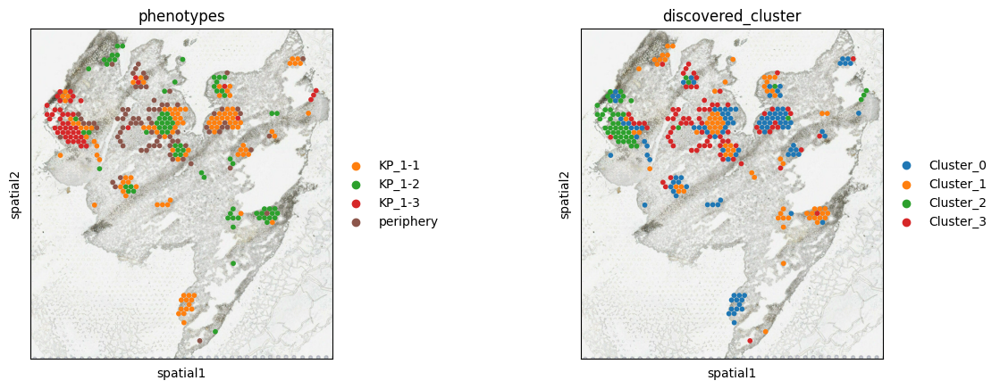

In [51]:
sc.pl.spatial(activity_311, img_key="hires", color=["phenotypes", 'discovered_cluster'], size=1.5)

In [52]:
activity = activity_311

## KP1_2

In [54]:
kp12act = activity[(activity.obs['discovered_cluster'] == 'Cluster_1')]
kp12act.write_h5ad('../Data/processedData3/kpn12act.h5ad')

In [55]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kpn12act.h5ad",
    genes_of_interest=["Tgfbr2_SIG"],
    num_top_genes_for_summary=  500,
    grn_rebuild=True,
    learning_rate=0.001,
    beta=0.0005,
    epochs=100,
    run_significance_test=True,
    n_permutations=300,
    alpha=0.1,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_173747
[GenKI] Loading AnnData from: ../Data/processedData3/kpn12act.h5ad
load counts from ../Data/processedData3/kpn12act.h5ad
[GenKI] AnnData: 2503 genes × 75 cells

[GenKI] (1/1) KO: Tgfbr2_SIG


2025-11-15 17:37:48,909	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 17:37:58,843 E 438607 438636] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-37-48_126041_432393 is over 95% full, available space: 13257506816; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=300)


Permutating: 100%|██████████| 300/300 [00:18<00:00, 16.45it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 2

[GenKI] Combined significant saved.
  • Pairs: 2 | Unique genes: 2

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_173747


In [57]:
res["combined_significant"].head(40)

,dis,index,hit,rank,KO_gene
Tgfbr2_SIG,23.859177,2203,300,1,Tgfbr2_SIG
Kdm5d_SIG,0.000007,1148,285,2,Tgfbr2_SIG


## KP1_1

In [58]:
kp11act = activity[(activity.obs['phenotypes'] == 'KP_1-1')]
kp11act.write_h5ad('../Data/processedData3/kpn11act.h5ad')

In [59]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kpn11act.h5ad",
    genes_of_interest=["Tgfbr2_SIG"],
    num_top_genes_for_summary=  500,
    run_significance_test=True,
    n_permutations=30,
    alpha=0.1,
    grn_rebuild=True,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_173901
[GenKI] Loading AnnData from: ../Data/processedData3/kpn11act.h5ad
load counts from ../Data/processedData3/kpn11act.h5ad
[GenKI] AnnData: 2503 genes × 110 cells

[GenKI] (1/1) KO: Tgfbr2_SIG


2025-11-15 17:39:02,204	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 17:39:12,133 E 439980 440009] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-39-01_399094_432393 is over 95% full, available space: 13263585280; capacity: 489997189120. Object creation will fail if spilling is required.
(raylet) [2025-11-15 17:39:22,136 E 439980 440009] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-39-01_399094_432393 is over 95% full, available space: 13263568896; capacity: 489997189120. Object creation will fail if spilling is required.
(raylet) [2025-11-15 17:39:32,139 E 439980 440009] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-39-01_399094_432393 is over 95% full, available space: 13263568896; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=30)


Permutating: 100%|██████████| 30/30 [00:01<00:00, 16.53it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 72

[GenKI] Combined significant saved.
  • Pairs: 72 | Unique genes: 72

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_173901


## periphery

In [60]:
kpperact = activity[(activity.obs['phenotypes'] == 'periphery')]
kpperact.write_h5ad('../Data/processedData3/kpperact.h5ad')

In [61]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kpperact.h5ad",
    genes_of_interest=["Tgfbr2_SIG"],
    num_top_genes_for_summary=  500,
    run_significance_test=True,
    n_permutations=30,
    alpha=0.1,
    grn_rebuild=True,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_174028
[GenKI] Loading AnnData from: ../Data/processedData3/kpperact.h5ad
load counts from ../Data/processedData3/kpperact.h5ad
[GenKI] AnnData: 2503 genes × 79 cells

[GenKI] (1/1) KO: Tgfbr2_SIG


2025-11-15 17:40:29,674	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 17:40:39,608 E 441360 441389] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-40-28_887541_432393 is over 95% full, available space: 13259890688; capacity: 489997189120. Object creation will fail if spilling is required.
(raylet) [2025-11-15 17:40:49,611 E 441360 441389] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-40-28_887541_432393 is over 95% full, available space: 13259702272; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=30)


Permutating: 100%|██████████| 30/30 [00:01<00:00, 16.68it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 93

[GenKI] Combined significant saved.
  • Pairs: 93 | Unique genes: 93

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_174028


## KP1_3

In [62]:
kp13act = activity[(activity.obs['phenotypes'] == 'KP_1-3')]
kp13act.write_h5ad('../Data/processedData3/kpn13act.h5ad')

In [63]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kpn13act.h5ad",
    genes_of_interest=["Tgfbr2_SIG"],
    num_top_genes_for_summary=  500,
    run_significance_test=True,
    n_permutations=30,
    alpha=0.1,
    grn_rebuild=True,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_174121
[GenKI] Loading AnnData from: ../Data/processedData3/kpn13act.h5ad
load counts from ../Data/processedData3/kpn13act.h5ad
[GenKI] AnnData: 2503 genes × 47 cells

[GenKI] (1/1) KO: Tgfbr2_SIG


2025-11-15 17:41:22,370	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 17:41:32,297 E 442741 442770] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-41-21_563544_432393 is over 95% full, available space: 13259870208; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=30)


Permutating: 100%|██████████| 30/30 [00:01<00:00, 16.44it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 1

[GenKI] Combined significant saved.
  • Pairs: 1 | Unique genes: 1

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_174121


In [64]:
from genki_notebook import run_genki_notebook

res = run_genki_notebook(
    adata_or_path="../Data/processedData3/kpn13act.h5ad",
    genes_of_interest=["Tgfbr2_SIG"],
    num_top_genes_for_summary=  500,
    run_significance_test=True,
    n_permutations=300,
    alpha=0.05,
    grn_rebuild=True,
    learning_rate=0.001,
    beta=0.0005,
    epochs=100,
    edge_percentile=85.0,
    extract_adjacency=False,
    write_to_disk=True,      # set False to keep everything in-memory
    save_dense_adjacency=False  # keep False unless your matrix is small
)

[GenKI] Starting notebook run -> ../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_174155
[GenKI] Loading AnnData from: ../Data/processedData3/kpn13act.h5ad
load counts from ../Data/processedData3/kpn13act.h5ad
[GenKI] AnnData: 2503 genes × 47 cells

[GenKI] (1/1) KO: Tgfbr2_SIG


2025-11-15 17:41:56,347	INFO worker.py:1783 -- Started a local Ray instance.


ray init, using 20 CPUs


(raylet) [2025-11-15 17:42:06,273 E 444112 444141] (raylet) file_system_monitor.cc:111: /tmp/ray/session_2025-11-15_17-41-55_524095_432393 is over 95% full, available space: 13272391680; capacity: 489997189120. Object creation will fail if spilling is required.


  • Data prepared
  • VGAE trained
  • Running permutation test (n=300)


Permutating: 100%|██████████| 300/300 [00:18<00:00, 16.53it/s]

  ! No p-value columns found; using full permutation result
  • Done. Significant: 7

[GenKI] Combined significant saved.
  • Pairs: 7 | Unique genes: 7

[GenKI] Completed. Results in: ../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_174155


## How does GenKI results align with differential activity analysis?

### KP1_1

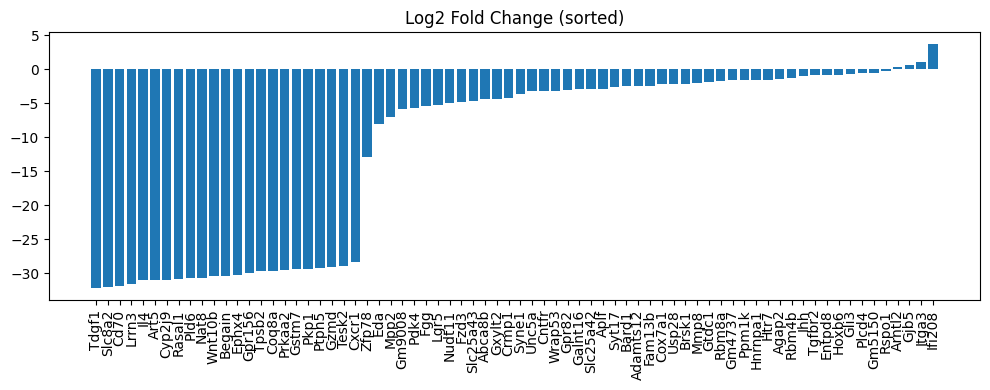

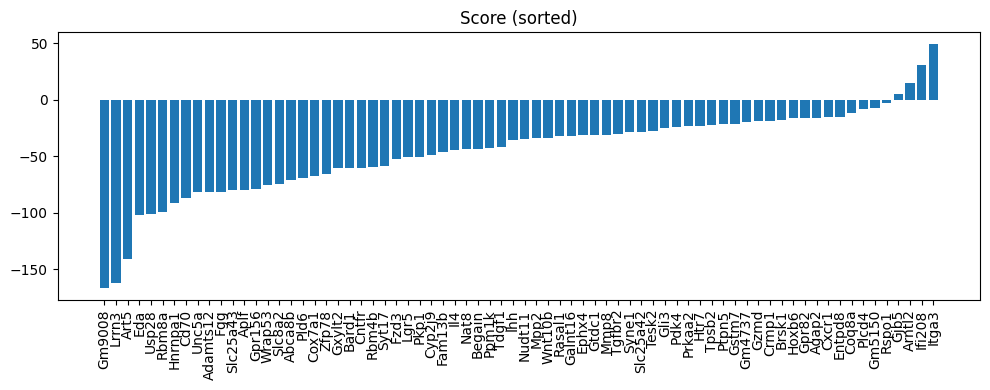

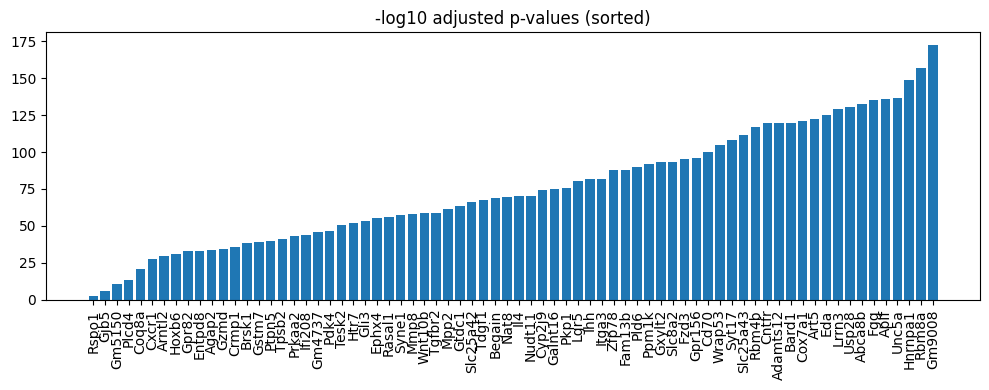

In [68]:
import pandas as pd
import numpy as np

all_sig = pd.read_csv("../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_173901/ALL_Significant_Genes_Combined.csv", index_col=0)
deg = pd.read_csv("../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv", index_col=0)
all_sig.index = all_sig.index.str.replace("_SIG","",regex=False)

# dedupe
all_sig = all_sig[~all_sig.index.duplicated(keep='first')]
deg = deg[~deg.index.duplicated(keep='first')]

common = all_sig.index.intersection(deg.index)
merged = pd.concat([deg.loc[common], all_sig.loc[common]], axis=1)

if "pvals_adj" in merged.columns:
    merged["-log10_padj"] = -np.log10(merged["pvals_adj"])

merged.head()


import matplotlib.pyplot as plt

# --- Barplot 1: log2FC ---
df1 = merged.sort_values("logfoldchanges")
plt.figure(figsize=(10,4))
plt.bar(df1.index, df1["logfoldchanges"])
plt.xticks(rotation=90)
plt.title("Log2 Fold Change (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 2: Scores ---
df2 = merged.sort_values("scores")
plt.figure(figsize=(10,4))
plt.bar(df2.index, df2["scores"])
plt.xticks(rotation=90)
plt.title("Score (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 3: -log10(padj) ---
df3 = merged.sort_values("-log10_padj")
plt.figure(figsize=(10,4))
plt.bar(df3.index, df3["-log10_padj"])
plt.xticks(rotation=90)
plt.title("-log10 adjusted p-values (sorted)")
plt.tight_layout()
plt.show()

### KP1_2

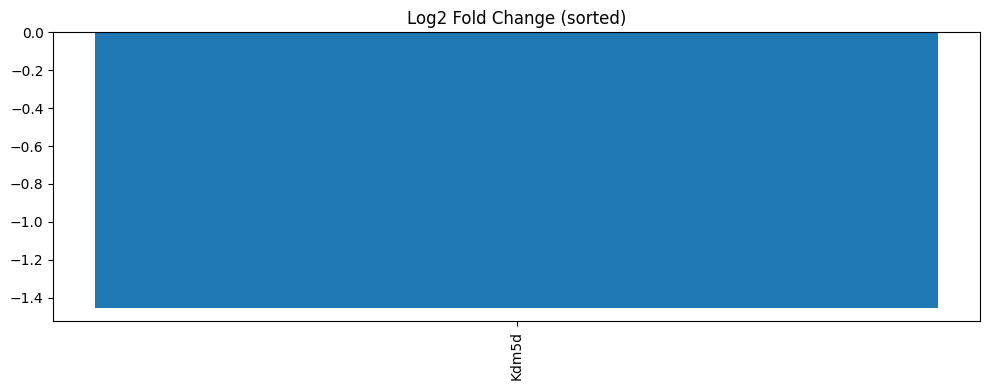

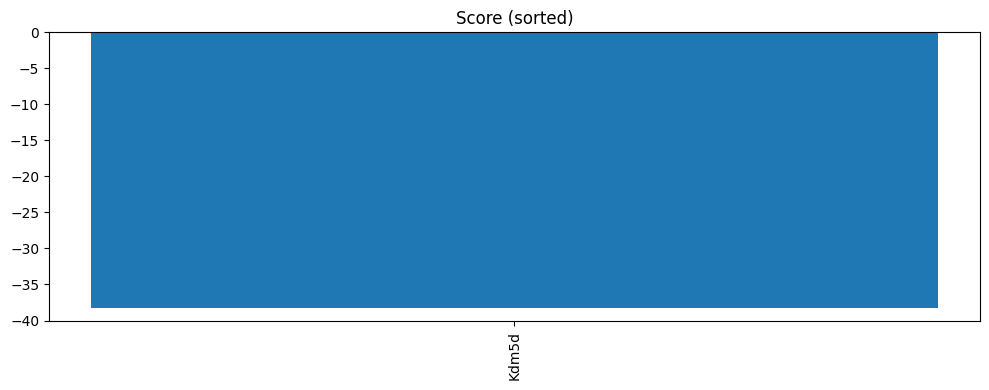

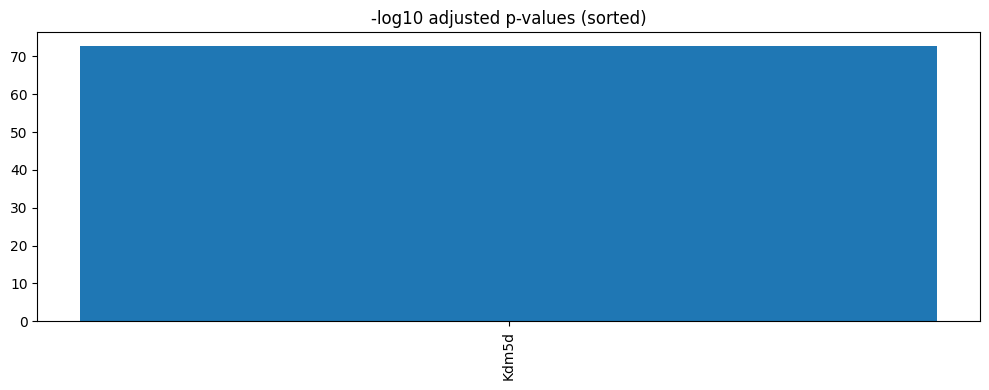

In [70]:
import pandas as pd
import numpy as np

all_sig = pd.read_csv("../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_173747/ALL_Significant_Genes_Combined.csv", index_col=0)
deg = pd.read_csv("../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-2/DEGs_padj_lt_0.05_activity.csv", index_col=0)
all_sig.index = all_sig.index.str.replace("_SIG","",regex=False)

# dedupe
all_sig = all_sig[~all_sig.index.duplicated(keep='first')]
deg = deg[~deg.index.duplicated(keep='first')]

common = all_sig.index.intersection(deg.index)
merged = pd.concat([deg.loc[common], all_sig.loc[common]], axis=1)

if "pvals_adj" in merged.columns:
    merged["-log10_padj"] = -np.log10(merged["pvals_adj"])

merged.head()


import matplotlib.pyplot as plt

# --- Barplot 1: log2FC ---
df1 = merged.sort_values("logfoldchanges")
plt.figure(figsize=(10,4))
plt.bar(df1.index, df1["logfoldchanges"])
plt.xticks(rotation=90)
plt.title("Log2 Fold Change (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 2: Scores ---
df2 = merged.sort_values("scores")
plt.figure(figsize=(10,4))
plt.bar(df2.index, df2["scores"])
plt.xticks(rotation=90)
plt.title("Score (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 3: -log10(padj) ---
df3 = merged.sort_values("-log10_padj")
plt.figure(figsize=(10,4))
plt.bar(df3.index, df3["-log10_padj"])
plt.xticks(rotation=90)
plt.title("-log10 adjusted p-values (sorted)")
plt.tight_layout()
plt.show()

### KP1_3

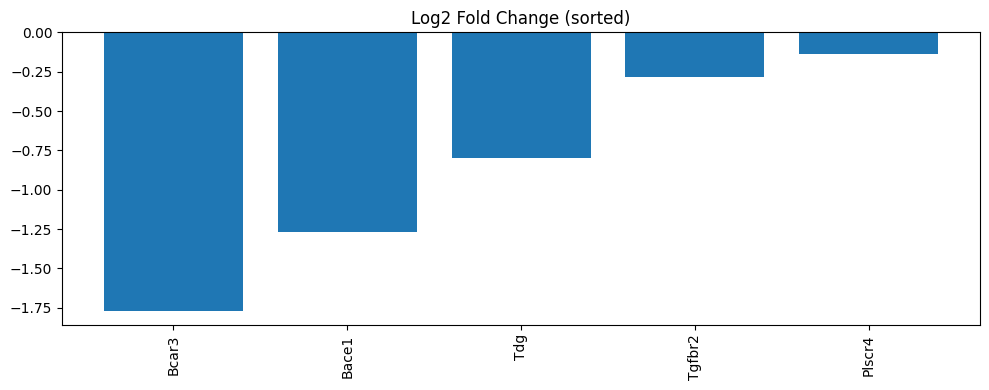

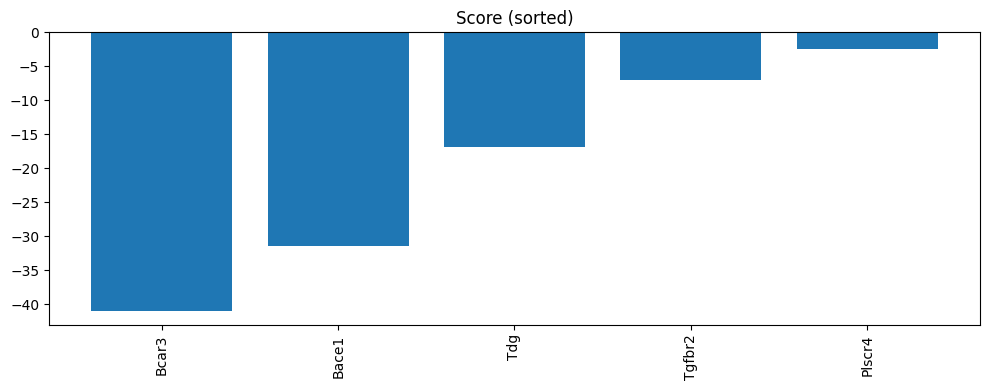

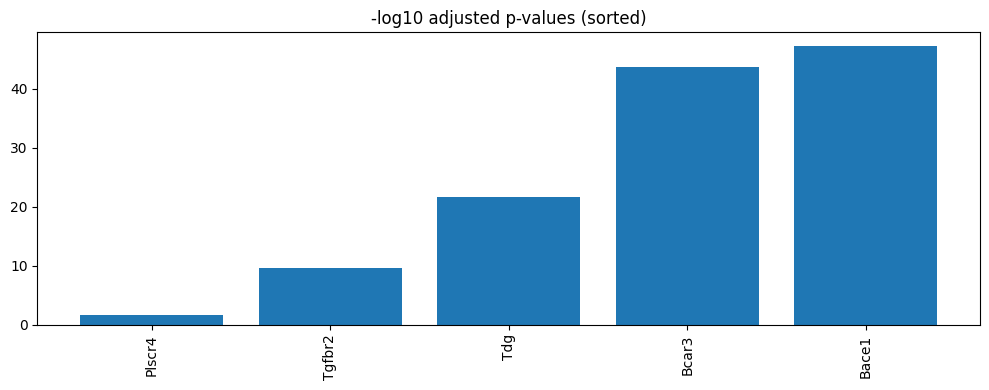

In [71]:
import pandas as pd
import numpy as np

all_sig = pd.read_csv("../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_174155/ALL_Significant_Genes_Combined.csv", index_col=0)
deg = pd.read_csv("../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-3/DEGs_padj_lt_0.05.csv", index_col=0)
all_sig.index = all_sig.index.str.replace("_SIG","",regex=False)

# dedupe
all_sig = all_sig[~all_sig.index.duplicated(keep='first')]
deg = deg[~deg.index.duplicated(keep='first')]

common = all_sig.index.intersection(deg.index)
merged = pd.concat([deg.loc[common], all_sig.loc[common]], axis=1)

if "pvals_adj" in merged.columns:
    merged["-log10_padj"] = -np.log10(merged["pvals_adj"])

merged.head()


import matplotlib.pyplot as plt

# --- Barplot 1: log2FC ---
df1 = merged.sort_values("logfoldchanges")
plt.figure(figsize=(10,4))
plt.bar(df1.index, df1["logfoldchanges"])
plt.xticks(rotation=90)
plt.title("Log2 Fold Change (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 2: Scores ---
df2 = merged.sort_values("scores")
plt.figure(figsize=(10,4))
plt.bar(df2.index, df2["scores"])
plt.xticks(rotation=90)
plt.title("Score (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 3: -log10(padj) ---
df3 = merged.sort_values("-log10_padj")
plt.figure(figsize=(10,4))
plt.bar(df3.index, df3["-log10_padj"])
plt.xticks(rotation=90)
plt.title("-log10 adjusted p-values (sorted)")
plt.tight_layout()
plt.show()

### periphery

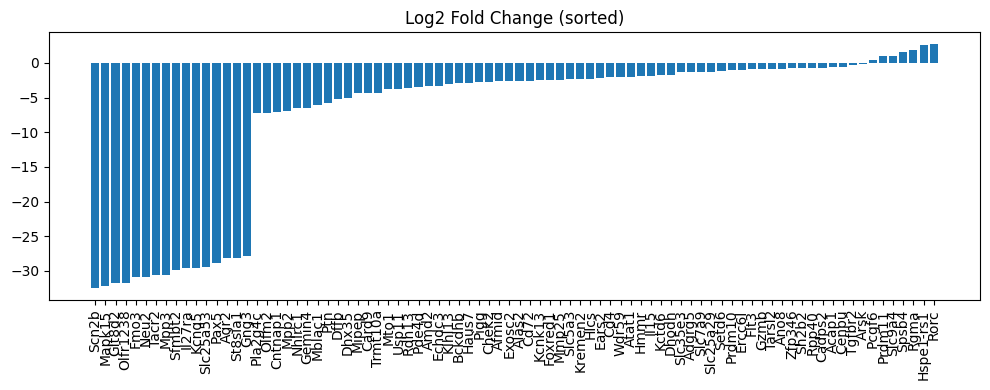

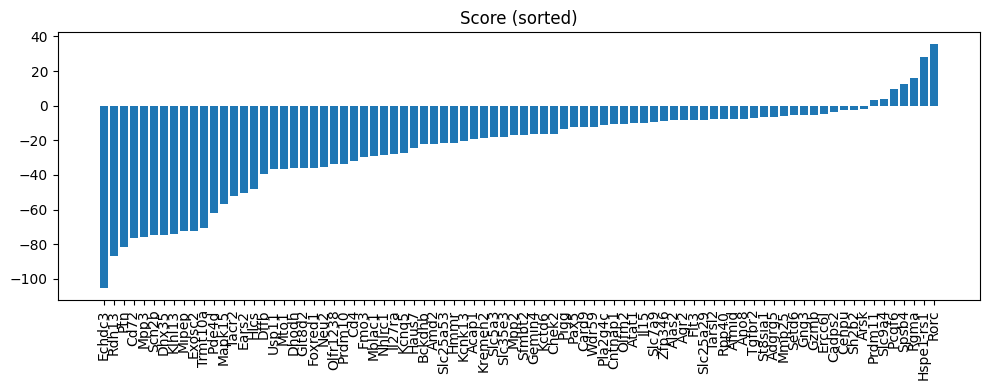

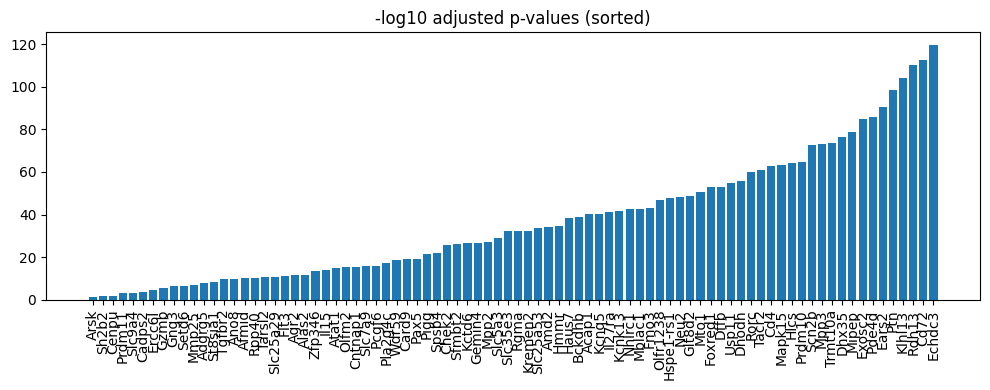

In [72]:
import pandas as pd
import numpy as np

all_sig = pd.read_csv("../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_174028/ALL_Significant_Genes_Combined.csv", index_col=0)
deg = pd.read_csv("../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv", index_col=0)
all_sig.index = all_sig.index.str.replace("_SIG","",regex=False)

# dedupe
all_sig = all_sig[~all_sig.index.duplicated(keep='first')]
deg = deg[~deg.index.duplicated(keep='first')]

common = all_sig.index.intersection(deg.index)
merged = pd.concat([deg.loc[common], all_sig.loc[common]], axis=1)

if "pvals_adj" in merged.columns:
    merged["-log10_padj"] = -np.log10(merged["pvals_adj"])

merged.head()


import matplotlib.pyplot as plt

# --- Barplot 1: log2FC ---
df1 = merged.sort_values("logfoldchanges")
plt.figure(figsize=(10,4))
plt.bar(df1.index, df1["logfoldchanges"])
plt.xticks(rotation=90)
plt.title("Log2 Fold Change (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 2: Scores ---
df2 = merged.sort_values("scores")
plt.figure(figsize=(10,4))
plt.bar(df2.index, df2["scores"])
plt.xticks(rotation=90)
plt.title("Score (sorted)")
plt.tight_layout()
plt.show()

# --- Barplot 3: -log10(padj) ---
df3 = merged.sort_values("-log10_padj")
plt.figure(figsize=(10,4))
plt.bar(df3.index, df3["-log10_padj"])
plt.xticks(rotation=90)
plt.title("-log10 adjusted p-values (sorted)")
plt.tight_layout()
plt.show()

# Mongoose (UnitedNet + GenKI)

In [35]:
# import os
# import re
# import pandas as pd
# from datetime import datetime

# # ========= PATHS (edit if needed) =========
# SHAP_CSV     = "../Task2_CMP/capboost_cross_modal_analysis_20251024_092343/capboost_feature_feature_importance_activity_flux_niche.csv"
# BIO_NICHE    = "../GenKI/GenKI_NB_Tgfbr2_20251024_092505/ALL_Significant_Genes_Combined.csv"
# BIO_ACTIVITY = "../GenKI/GenKI_NB_Tgfbr2_SIG_20251024_092638/ALL_Significant_Genes_Combined.csv"

# OUT_DIR = "../Mongoose_post_hoc/"
# os.makedirs(OUT_DIR, exist_ok=True)
# STAMP   = datetime.now().strftime("%Y%m%d_%H%M%S")
# OUT_CSV = os.path.join(OUT_DIR, f"niche_to_activity_shap_edges_with_ranks_clusters45_{STAMP}.csv")

# CLUSTERS_TO_KEEP = {0}   # the UnitedNet cluster that included the KP1_2 region during super-vised clustering

# # ========= HELPERS =========
# def clean_gene(x: str):
#     if pd.isna(x): return None
#     x = str(x).strip()
#     x = re.sub(r"(_SIG|_TF)$", "", x, flags=re.IGNORECASE)
#     return x.upper()

# def detect_col(df, candidates_exact, candidates_contains=()):
#     for c in df.columns:
#         if c.lower() in candidates_exact:
#             return c
#     for c in df.columns:
#         cl = c.lower()
#         if any(k in cl for k in candidates_contains):
#             return c
#     return None

# def pick_gene_col(df):
#     prefer_exact = {"gene","genes","symbol","gene_symbol","names","name"}
#     prefer_contains = ("gene","symbol","name")
#     c = detect_col(df, prefer_exact, prefer_contains)
#     if c: return c
#     obj_cols = [c for c in df.columns if df[c].dtype == "O"]
#     return obj_cols[0] if obj_cols else df.columns[0]

# def pick_rank_col(df):
#     prefer_exact = {"rank","order","position","idx","index"}
#     c = detect_col(df, prefer_exact, ("rank","order","position","idx","index"))
#     if c: return c
#     for cand in ["dis","score","scores","priority","rnk"]:
#         for col in df.columns:
#             if col.lower()==cand and pd.api.types.is_numeric_dtype(df[col]):
#                 return col
#     numeric_cols = [c for c in df.columns if pd.api.types.is_numeric_dtype(df[c])]
#     return numeric_cols[0] if numeric_cols else None

# def load_gene_rank_lookup(path, role="niche"):
#     df = pd.read_csv(path)
#     gcol = pick_gene_col(df)
#     rcol = pick_rank_col(df)
#     if gcol is None:
#         raise ValueError(f"[{role}] Could not detect gene column in {path}. Columns = {list(df.columns)}")
#     if rcol is None:
#         rcol = "__ROW_ORDER__"
#         df[rcol] = range(1, len(df)+1)

#     tmp = df[[gcol, rcol]].copy()
#     tmp["gene_clean"] = tmp[gcol].map(clean_gene)
#     tmp = tmp.dropna(subset=["gene_clean"])

#     with pd.option_context('mode.use_inf_as_na', True):
#         tmp[rcol] = pd.to_numeric(tmp[rcol], errors="coerce")
#     if not pd.api.types.is_numeric_dtype(tmp[rcol]):
#         tmp[rcol] = pd.factorize(tmp[rcol])[0] + 1

#     ser = tmp.groupby("gene_clean")[rcol].min().rename(f"{role}_rank")
#     return ser.reset_index()

# def pick_value_col(shap_df: pd.DataFrame) -> str:
#     name_pat = re.compile(r"(shap|feature[_-]?importance|importance|weight|gain)$", re.I)
#     cand = [c for c in shap_df.columns if name_pat.search(c)]
#     cand = [c for c in cand if pd.api.types.is_numeric_dtype(shap_df[c])]
#     if not cand:
#         exclude_pat = re.compile(r"(source|target|gene|name|id|idx|rank|cluster)$", re.I)
#         cand = [c for c in shap_df.columns
#                 if pd.api.types.is_numeric_dtype(shap_df[c]) and not exclude_pat.search(c)]
#     if not cand:
#         raise ValueError("Could not find a numeric SHAP/importance column in the SHAP CSV.")

#     def score_col(c):
#         has_shap = 0 if re.search(r"shap", c, re.I) else 1
#         nunique  = shap_df[c].nunique()
#         stdv     = float(shap_df[c].std(skipna=True) or 0.0)
#         return (has_shap, -nunique, -stdv)

#     cand.sort(key=score_col)
#     return cand[0]

# def pick_cluster_col(df):
#     # common names: Cluster, cluster, cluster_id, cluster_label, etc.
#     c = detect_col(df, {"cluster","cluster_id","clusters"}, ("cluster",))
#     return c

# def to_cluster_num(series):
#     # Try numeric directly; if fails, extract first integer from strings like "Cluster 4"
#     s = pd.to_numeric(series, errors="coerce")
#     if s.notna().any():
#         return s
#     # extract first integer found per entry
#     return series.astype(str).str.extract(r"(\d+)")[0].astype(float)

# # ========= LOAD LOOKUPS =========
# niche_lookup    = load_gene_rank_lookup(BIO_NICHE,    role="niche")
# activity_lookup = load_gene_rank_lookup(BIO_ACTIVITY, role="activity")

# # ========= READ SHAP, DETECT COLS, FILTER CLUSTERS =========
# shap = pd.read_csv(SHAP_CSV)

# src_col = detect_col(shap, {"source","src","from","niche","niche_gene"}, ("source","src","from","niche"))
# tgt_col = detect_col(shap, {"target","tgt","to","activity","activity_gene"}, ("target","tgt","to","activity"))
# cluster_col = pick_cluster_col(shap)

# if not all([src_col, tgt_col]):
#     raise ValueError(
#         f"Could not infer source/target columns. source={src_col}, target={tgt_col}. "
#         f"Columns available: {list(shap.columns)}"
#     )

# # Filter to clusters 4 & 5 if cluster column exists
# if cluster_col:
#     clusters_num = to_cluster_num(shap[cluster_col])
#     shap = shap.loc[clusters_num.isin(CLUSTERS_TO_KEEP)].copy()
#     shap["_cluster_num_"] = clusters_num.loc[shap.index]
# else:
#     print("[WARN] No cluster column detected; proceeding without cluster filter.")

# # Now pick the best 'value' column AFTER cluster filtering
# val_col = pick_value_col(shap)
# shap[val_col] = pd.to_numeric(shap[val_col], errors="coerce")

# print(f"[INFO] Using value column: {val_col} | nunique={shap[val_col].nunique()}")

# # ========= CLEAN, MERGE RANKS, FILTER =========
# cols = [src_col, tgt_col, val_col] + (["_cluster_num_"] if "_cluster_num_" in shap.columns else [])
# df = shap[cols].copy()
# rename_map = {src_col: "source", tgt_col: "target", val_col: "value"}
# if "_cluster_num_" in df.columns:
#     rename_map["_cluster_num_"] = "cluster"
# df = df.rename(columns=rename_map)

# df["source_clean"] = df["source"].map(clean_gene)
# df["target_clean"] = df["target"].map(clean_gene)
# df = df.dropna(subset=["source_clean","target_clean","value"])

# df = df.merge(niche_lookup,    how="left", left_on="source_clean", right_on="gene_clean").drop(columns=["gene_clean"])
# df = df.merge(activity_lookup, how="left", left_on="target_clean", right_on="gene_clean").drop(columns=["gene_clean"])

# filtered = df[df["niche_rank"].notna() & df["activity_rank"].notna()].copy()
# sort_keys = ["value","niche_rank","activity_rank"]
# filtered = filtered.sort_values(sort_keys, ascending=[False, True, True]).reset_index(drop=True)

# # ========= OUTPUT =========
# keep_cols = ["source","target","value","niche_rank","activity_rank"]
# if "cluster" in filtered.columns:
#     keep_cols.insert(0, "cluster")  # put cluster first for readability
# filtered_out = filtered[keep_cols].copy()

# filtered_out.to_csv(OUT_CSV, index=False)
# print(f"\nSaved: {OUT_CSV}")
# print(f"Rows: {len(filtered_out)} | Unique sources: {filtered_out['source'].nunique()} | Unique targets: {filtered_out['target'].nunique()}")
# print("\nPreview:")
# print(filtered_out.head(20))

[INFO] Using value column: Value | nunique=4910

Saved: ../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251024_095849.csv
Rows: 140 | Unique sources: 28 | Unique targets: 5

Preview:
    cluster  source       target     value  niche_rank  activity_rank
0         0  Ighg2b   Slc51b_SIG  1.000000      1773.0         2061.0
1         0  Ighg2c   B3gnt5_SIG  1.000000      1772.0          219.0
2         0  Ighg2c    Gpr82_SIG  1.000000      1772.0          896.0
3         0  Ighg2b  Sdr42e1_SIG  1.000000      1773.0         1911.0
4         0  Ighg2b    Il12a_SIG  0.883730      1773.0         1042.0
5         0  Ighg2c   Slc51b_SIG  0.794310      1772.0         2061.0
6         0  Ighg2c  Sdr42e1_SIG  0.766576      1772.0         1911.0
7         0   Gsta4  Sdr42e1_SIG  0.721155      1318.0         1911.0
8         0   Ighg1   B3gnt5_SIG  0.717222      1774.0          219.0
9         0  Ighg2b   B3gnt5_SIG  0.667752      1773.0          219.0
10        0    Igkc  

In [11]:
import os
import re
import pandas as pd
from datetime import datetime

# ========= PATHS (edit if needed) =========
SHAP_CSV     = "../Task2_CMP/capboost_cross_modal_analysis_20251026_092330/capboost_feature_feature_importance_activity_flux_niche.csv"
BIO_NICHE    = "../GenKI/GenKI_NB_Tgfbr2_20251025_072032/ALL_Significant_Genes_Combined.csv"
BIO_ACTIVITY = "../GenKI/GenKI_NB_Tgfbr2_SIG_20251025_123803/ALL_Significant_Genes_Combined.csv"

OUT_DIR = "../Mongoose_post_hoc/"
os.makedirs(OUT_DIR, exist_ok=True)
STAMP   = datetime.now().strftime("%Y%m%d_%H%M%S")
OUT_CSV = os.path.join(OUT_DIR, f"niche_to_activity_shap_edges_with_ranks_clusters45_{STAMP}.csv")

CLUSTERS_TO_KEEP = {1}   # the UnitedNet cluster that included the KP1_2 region during super-vised clustering

# ========= HELPERS =========
def clean_gene(x: str):
    if pd.isna(x): return None
    x = str(x).strip()
    x = re.sub(r"(_SIG|_TF)$", "", x, flags=re.IGNORECASE)
    return x.upper()

def detect_col(df, candidates_exact, candidates_contains=()):
    for c in df.columns:
        if c.lower() in candidates_exact:
            return c
    for c in df.columns:
        cl = c.lower()
        if any(k in cl for k in candidates_contains):
            return c
    return None

def pick_gene_col(df):
    prefer_exact = {"gene","genes","symbol","gene_symbol","names","name"}
    prefer_contains = ("gene","symbol","name")
    c = detect_col(df, prefer_exact, prefer_contains)
    if c: return c
    obj_cols = [c for c in df.columns if df[c].dtype == "O"]
    return obj_cols[0] if obj_cols else df.columns[0]

def pick_rank_col(df):
    # FIXED: Prioritize "rank" over "index" by checking rank first
    # Check for exact "rank" column first
    for c in df.columns:
        if c.lower() == "rank":
            return c
    
    # Then check for other exact matches (excluding "index" to avoid confusion)
    prefer_exact = {"order","position","rnk"}
    c = detect_col(df, prefer_exact, ("order","position"))
    if c: return c
    
    # Check for columns containing "rank" in the name
    for col in df.columns:
        if "rank" in col.lower() and pd.api.types.is_numeric_dtype(df[col]):
            return col
    
    # Only if nothing else found, check other numeric candidates
    for cand in ["dis","score","scores","priority"]:
        for col in df.columns:
            if col.lower()==cand and pd.api.types.is_numeric_dtype(df[col]):
                return col
    
    # Last resort: use row number or first numeric column
    numeric_cols = [c for c in df.columns if pd.api.types.is_numeric_dtype(df[c])]
    return numeric_cols[0] if numeric_cols else None

def load_gene_rank_lookup(path, role="niche"):
    df = pd.read_csv(path)
    gcol = pick_gene_col(df)
    rcol = pick_rank_col(df)
    if gcol is None:
        raise ValueError(f"[{role}] Could not detect gene column in {path}. Columns = {list(df.columns)}")
    if rcol is None:
        rcol = "__ROW_ORDER__"
        df[rcol] = range(1, len(df)+1)

    print(f"[INFO] {role}: Using gene column '{gcol}' and rank column '{rcol}'")

    tmp = df[[gcol, rcol]].copy()
    tmp["gene_clean"] = tmp[gcol].map(clean_gene)
    tmp = tmp.dropna(subset=["gene_clean"])

    with pd.option_context('mode.use_inf_as_na', True):
        tmp[rcol] = pd.to_numeric(tmp[rcol], errors="coerce")
    if not pd.api.types.is_numeric_dtype(tmp[rcol]):
        tmp[rcol] = pd.factorize(tmp[rcol])[0] + 1

    ser = tmp.groupby("gene_clean")[rcol].min().rename(f"{role}_rank")
    return ser.reset_index()

def pick_value_col(shap_df: pd.DataFrame) -> str:
    name_pat = re.compile(r"(shap|feature[_-]?importance|importance|weight|gain)$", re.I)
    cand = [c for c in shap_df.columns if name_pat.search(c)]
    cand = [c for c in cand if pd.api.types.is_numeric_dtype(shap_df[c])]
    if not cand:
        exclude_pat = re.compile(r"(source|target|gene|name|id|idx|rank|cluster)$", re.I)
        cand = [c for c in shap_df.columns
                if pd.api.types.is_numeric_dtype(shap_df[c]) and not exclude_pat.search(c)]
    if not cand:
        raise ValueError("Could not find a numeric SHAP/importance column in the SHAP CSV.")

    def score_col(c):
        has_shap = 0 if re.search(r"shap", c, re.I) else 1
        nunique  = shap_df[c].nunique()
        stdv     = float(shap_df[c].std(skipna=True) or 0.0)
        return (has_shap, -nunique, -stdv)

    cand.sort(key=score_col)
    return cand[0]

def pick_cluster_col(df):
    # common names: Cluster, cluster, cluster_id, cluster_label, etc.
    c = detect_col(df, {"cluster","cluster_id","clusters"}, ("cluster",))
    return c

def to_cluster_num(series):
    # Try numeric directly; if fails, extract first integer from strings like "Cluster 4"
    s = pd.to_numeric(series, errors="coerce")
    if s.notna().any():
        return s
    # extract first integer found per entry
    return series.astype(str).str.extract(r"(\d+)")[0].astype(float)

# ========= LOAD LOOKUPS =========
niche_lookup    = load_gene_rank_lookup(BIO_NICHE,    role="niche")
activity_lookup = load_gene_rank_lookup(BIO_ACTIVITY, role="activity")

print(f"\n[INFO] Loaded {len(niche_lookup)} niche genes with ranks from {min(niche_lookup['niche_rank'])} to {max(niche_lookup['niche_rank'])}")
print(f"[INFO] Loaded {len(activity_lookup)} activity genes with ranks from {min(activity_lookup['activity_rank'])} to {max(activity_lookup['activity_rank'])}")

# ========= READ SHAP, DETECT COLS, FILTER CLUSTERS =========
shap = pd.read_csv(SHAP_CSV)

src_col = detect_col(shap, {"source","src","from","niche","niche_gene"}, ("source","src","from","niche"))
tgt_col = detect_col(shap, {"target","tgt","to","activity","activity_gene"}, ("target","tgt","to","activity"))
cluster_col = pick_cluster_col(shap)

if not all([src_col, tgt_col]):
    raise ValueError(
        f"Could not infer source/target columns. source={src_col}, target={tgt_col}. "
        f"Columns available: {list(shap.columns)}"
    )

# Filter to clusters 4 & 5 if cluster column exists
if cluster_col:
    clusters_num = to_cluster_num(shap[cluster_col])
    shap = shap.loc[clusters_num.isin(CLUSTERS_TO_KEEP)].copy()
    shap["_cluster_num_"] = clusters_num.loc[shap.index]
else:
    print("[WARN] No cluster column detected; proceeding without cluster filter.")

# Now pick the best 'value' column AFTER cluster filtering
val_col = pick_value_col(shap)
shap[val_col] = pd.to_numeric(shap[val_col], errors="coerce")

print(f"[INFO] Using value column: {val_col} | nunique={shap[val_col].nunique()}")

# ========= CLEAN, MERGE RANKS, FILTER =========
cols = [src_col, tgt_col, val_col] + (["_cluster_num_"] if "_cluster_num_" in shap.columns else [])
df = shap[cols].copy()
rename_map = {src_col: "source", tgt_col: "target", val_col: "value"}
if "_cluster_num_" in df.columns:
    rename_map["_cluster_num_"] = "cluster"
df = df.rename(columns=rename_map)

df["source_clean"] = df["source"].map(clean_gene)
df["target_clean"] = df["target"].map(clean_gene)
df = df.dropna(subset=["source_clean","target_clean","value"])

df = df.merge(niche_lookup,    how="left", left_on="source_clean", right_on="gene_clean").drop(columns=["gene_clean"])
df = df.merge(activity_lookup, how="left", left_on="target_clean", right_on="gene_clean").drop(columns=["gene_clean"])

filtered = df[df["niche_rank"].notna() & df["activity_rank"].notna()].copy()
sort_keys = ["value","niche_rank","activity_rank"]
filtered = filtered.sort_values(sort_keys, ascending=[False, True, True]).reset_index(drop=True)

# ========= OUTPUT =========
keep_cols = ["source","target","value","niche_rank","activity_rank"]
if "cluster" in filtered.columns:
    keep_cols.insert(0, "cluster")  # put cluster first for readability
filtered_out = filtered[keep_cols].copy()

filtered_out.to_csv(OUT_CSV, index=False)
print(f"\nSaved: {OUT_CSV}")
print(f"Rows: {len(filtered_out)} | Unique sources: {filtered_out['source'].nunique()} | Unique targets: {filtered_out['target'].nunique()}")
print("\nPreview:")
print(filtered_out.head(20))

[INFO] niche: Using gene column 'Unnamed: 0' and rank column 'rank'
[INFO] activity: Using gene column 'Unnamed: 0' and rank column 'rank'

[INFO] Loaded 64 niche genes with ranks from 1 to 64
[INFO] Loaded 15 activity genes with ranks from 1 to 15
[INFO] Using value column: Value | nunique=4906

Saved: ../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251026_195156.csv
Rows: 0 | Unique sources: 0 | Unique targets: 0

Preview:
Empty DataFrame
Columns: [cluster, source, target, value, niche_rank, activity_rank]
Index: []


## periphery

In [76]:
import os
import re
import pandas as pd
from datetime import datetime

# ========= PATHS (edit if needed) =========
SHAP_CSV     = "../Task2_CMP/capboost_cross_modal_analysis_20251115_164209/capboost_feature_feature_importance_activity_flux_niche.csv"
BIO_NICHE    = "../GenKI/GenKI_NB_Tgfbr2_20251115_171959/ALL_Significant_Genes_Combined.csv"
BIO_ACTIVITY = "../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_174028/ALL_Significant_Genes_Combined.csv"

OUT_DIR = "../Mongoose_post_hoc/"
os.makedirs(OUT_DIR, exist_ok=True)
STAMP   = datetime.now().strftime("%Y%m%d_%H%M%S")
OUT_CSV = os.path.join(OUT_DIR, f"niche_to_activity_shap_edges_with_ranks_clusters45_{STAMP}.csv")

CLUSTERS_TO_KEEP = {3}   # the UnitedNet cluster that included the periphery region during super-vised clustering

# ========= HELPERS =========
def clean_gene(x: str):
    if pd.isna(x): return None
    x = str(x).strip()
    x = re.sub(r"(_SIG|_TF)$", "", x, flags=re.IGNORECASE)
    return x.upper()

def detect_col(df, candidates_exact, candidates_contains=()):
    for c in df.columns:
        if c.lower() in candidates_exact:
            return c
    for c in df.columns:
        cl = c.lower()
        if any(k in cl for k in candidates_contains):
            return c
    return None

def pick_gene_col(df):
    prefer_exact = {"gene","genes","symbol","gene_symbol","names","name"}
    prefer_contains = ("gene","symbol","name")
    c = detect_col(df, prefer_exact, prefer_contains)
    if c: return c
    obj_cols = [c for c in df.columns if df[c].dtype == "O"]
    return obj_cols[0] if obj_cols else df.columns[0]

def pick_rank_col(df):
    # FIXED: Prioritize "rank" over "index" by checking rank first
    # Check for exact "rank" column first
    for c in df.columns:
        if c.lower() == "rank":
            return c
    
    # Then check for other exact matches (excluding "index" to avoid confusion)
    prefer_exact = {"order","position","rnk"}
    c = detect_col(df, prefer_exact, ("order","position"))
    if c: return c
    
    # Check for columns containing "rank" in the name
    for col in df.columns:
        if "rank" in col.lower() and pd.api.types.is_numeric_dtype(df[col]):
            return col
    
    # Only if nothing else found, check other numeric candidates
    for cand in ["dis","score","scores","priority"]:
        for col in df.columns:
            if col.lower()==cand and pd.api.types.is_numeric_dtype(df[col]):
                return col
    
    # Last resort: use row number or first numeric column
    numeric_cols = [c for c in df.columns if pd.api.types.is_numeric_dtype(df[c])]
    return numeric_cols[0] if numeric_cols else None

def load_gene_rank_lookup(path, role="niche"):
    df = pd.read_csv(path)
    gcol = pick_gene_col(df)
    rcol = pick_rank_col(df)
    if gcol is None:
        raise ValueError(f"[{role}] Could not detect gene column in {path}. Columns = {list(df.columns)}")
    if rcol is None:
        rcol = "__ROW_ORDER__"
        df[rcol] = range(1, len(df)+1)

    print(f"[INFO] {role}: Using gene column '{gcol}' and rank column '{rcol}'")

    tmp = df[[gcol, rcol]].copy()
    tmp["gene_clean"] = tmp[gcol].map(clean_gene)
    tmp = tmp.dropna(subset=["gene_clean"])

    with pd.option_context('mode.use_inf_as_na', True):
        tmp[rcol] = pd.to_numeric(tmp[rcol], errors="coerce")
    if not pd.api.types.is_numeric_dtype(tmp[rcol]):
        tmp[rcol] = pd.factorize(tmp[rcol])[0] + 1

    ser = tmp.groupby("gene_clean")[rcol].min().rename(f"{role}_rank")
    return ser.reset_index()

def pick_value_col(shap_df: pd.DataFrame) -> str:
    name_pat = re.compile(r"(shap|feature[_-]?importance|importance|weight|gain)$", re.I)
    cand = [c for c in shap_df.columns if name_pat.search(c)]
    cand = [c for c in cand if pd.api.types.is_numeric_dtype(shap_df[c])]
    if not cand:
        exclude_pat = re.compile(r"(source|target|gene|name|id|idx|rank|cluster)$", re.I)
        cand = [c for c in shap_df.columns
                if pd.api.types.is_numeric_dtype(shap_df[c]) and not exclude_pat.search(c)]
    if not cand:
        raise ValueError("Could not find a numeric SHAP/importance column in the SHAP CSV.")

    def score_col(c):
        has_shap = 0 if re.search(r"shap", c, re.I) else 1
        nunique  = shap_df[c].nunique()
        stdv     = float(shap_df[c].std(skipna=True) or 0.0)
        return (has_shap, -nunique, -stdv)

    cand.sort(key=score_col)
    return cand[0]

def pick_cluster_col(df):
    # common names: Cluster, cluster, cluster_id, cluster_label, etc.
    c = detect_col(df, {"cluster","cluster_id","clusters"}, ("cluster",))
    return c

def to_cluster_num(series):
    # Try numeric directly; if fails, extract first integer from strings like "Cluster 4"
    s = pd.to_numeric(series, errors="coerce")
    if s.notna().any():
        return s
    # extract first integer found per entry
    return series.astype(str).str.extract(r"(\d+)")[0].astype(float)

# ========= LOAD LOOKUPS =========
niche_lookup    = load_gene_rank_lookup(BIO_NICHE,    role="niche")
activity_lookup = load_gene_rank_lookup(BIO_ACTIVITY, role="activity")

print(f"\n[INFO] Loaded {len(niche_lookup)} niche genes with ranks from {min(niche_lookup['niche_rank'])} to {max(niche_lookup['niche_rank'])}")
print(f"[INFO] Loaded {len(activity_lookup)} activity genes with ranks from {min(activity_lookup['activity_rank'])} to {max(activity_lookup['activity_rank'])}")

# ========= READ SHAP, DETECT COLS, FILTER CLUSTERS =========
shap = pd.read_csv(SHAP_CSV)

src_col = detect_col(shap, {"source","src","from","niche","niche_gene"}, ("source","src","from","niche"))
tgt_col = detect_col(shap, {"target","tgt","to","activity","activity_gene"}, ("target","tgt","to","activity"))
cluster_col = pick_cluster_col(shap)

if not all([src_col, tgt_col]):
    raise ValueError(
        f"Could not infer source/target columns. source={src_col}, target={tgt_col}. "
        f"Columns available: {list(shap.columns)}"
    )

# Filter to clusters 4 & 5 if cluster column exists
if cluster_col:
    clusters_num = to_cluster_num(shap[cluster_col])
    shap = shap.loc[clusters_num.isin(CLUSTERS_TO_KEEP)].copy()
    shap["_cluster_num_"] = clusters_num.loc[shap.index]
else:
    print("[WARN] No cluster column detected; proceeding without cluster filter.")

# Now pick the best 'value' column AFTER cluster filtering
val_col = pick_value_col(shap)
shap[val_col] = pd.to_numeric(shap[val_col], errors="coerce")

print(f"[INFO] Using value column: {val_col} | nunique={shap[val_col].nunique()}")

# ========= CLEAN, MERGE RANKS, FILTER =========
cols = [src_col, tgt_col, val_col] + (["_cluster_num_"] if "_cluster_num_" in shap.columns else [])
df = shap[cols].copy()
rename_map = {src_col: "source", tgt_col: "target", val_col: "value"}
if "_cluster_num_" in df.columns:
    rename_map["_cluster_num_"] = "cluster"
df = df.rename(columns=rename_map)

df["source_clean"] = df["source"].map(clean_gene)
df["target_clean"] = df["target"].map(clean_gene)
df = df.dropna(subset=["source_clean","target_clean","value"])

df = df.merge(niche_lookup,    how="left", left_on="source_clean", right_on="gene_clean").drop(columns=["gene_clean"])
df = df.merge(activity_lookup, how="left", left_on="target_clean", right_on="gene_clean").drop(columns=["gene_clean"])

filtered = df[df["niche_rank"].notna() & df["activity_rank"].notna()].copy()
sort_keys = ["value","niche_rank","activity_rank"]
filtered = filtered.sort_values(sort_keys, ascending=[False, True, True]).reset_index(drop=True)

# ========= OUTPUT =========
keep_cols = ["source","target","value","niche_rank","activity_rank"]
if "cluster" in filtered.columns:
    keep_cols.insert(0, "cluster")  # put cluster first for readability
filtered_out = filtered[keep_cols].copy()

filtered_out.to_csv(OUT_CSV, index=False)
print(f"\nSaved: {OUT_CSV}")
print(f"Rows: {len(filtered_out)} | Unique sources: {filtered_out['source'].nunique()} | Unique targets: {filtered_out['target'].nunique()}")
print("\nPreview:")
print(filtered_out.head(20))

[INFO] niche: Using gene column 'Unnamed: 0' and rank column 'rank'
[INFO] activity: Using gene column 'Unnamed: 0' and rank column 'rank'

[INFO] Loaded 90 niche genes with ranks from 1 to 90
[INFO] Loaded 93 activity genes with ranks from 1 to 93
[INFO] Using value column: Value | nunique=4921

Saved: ../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251115_180250.csv
Rows: 529 | Unique sources: 23 | Unique targets: 23

Preview:
    cluster   source       target  value  niche_rank  activity_rank
0         3  Scgb1a1      Mafa_TF    1.0         6.0           27.0
1         3  Scgb1a1     Neu2_SIG    1.0         6.0           42.0
2         3  Scgb1a1    Acap1_SIG    1.0         6.0           82.0
3         3    Ighg1  Pla2g4c_SIG    1.0         3.0           51.0
4         3  Scgb1a1     Fmo3_SIG    1.0         6.0           10.0
5         3  Scgb1a1     Mto1_SIG    1.0         6.0           13.0
6         3  Scgb1a1   Mapk15_SIG    1.0         6.0           14

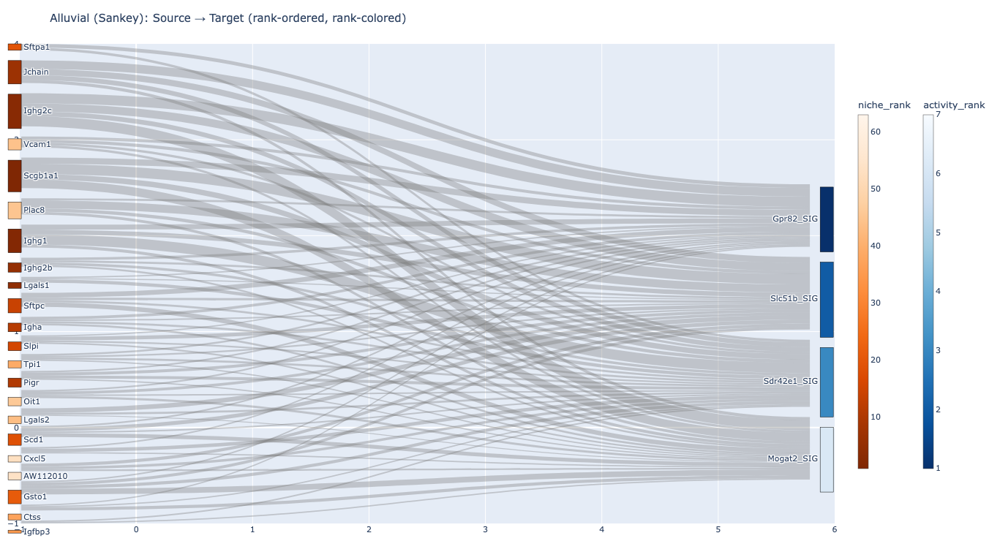

✓ Saved alluvial_rankordered_legend.html | Sources: 22 | Targets: 4 | Edges: 79


In [17]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from matplotlib import cm, colors as mpl_colors
from pathlib import Path

# ====== OPTIONS ======
CSV_PATH    = Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251026_200015.csv")
CLUSTERS    = None          # e.g., {0} or None
MIN_WEIGHT  = 0.1          # try 0.8 (few edges), 0.5, 0.3, etc.
TOP_N_EDGES = None          # e.g., 60 or None
TITLE       = "Alluvial (Sankey): Source → Target (rank-ordered, rank-colored)"
OUT_HTML    = "alluvial_rankordered_legend.html"
# =====================

def to_hex(v01, cmap="Oranges"):
    rgba = cm.get_cmap(cmap)(float(np.clip(v01, 0, 1)))
    return mpl_colors.to_hex(rgba)

# ---- Load ----
df = pd.read_csv(CSV_PATH)
req = {"cluster","source","target","value","niche_rank","activity_rank"}
missing = req - set(df.columns)
if missing:
    raise ValueError(f"Missing columns: {missing}")

if CLUSTERS is not None:
    df = df[df["cluster"].isin(CLUSTERS)].copy()

for c in ["value","niche_rank","activity_rank"]:
    df[c] = pd.to_numeric(df[c], errors="coerce")
df = df.dropna(subset=["source","target","value"])

# ---- Aggregate edges & filter ----
edges = (df.groupby(["source","target"], as_index=False)["value"].sum()
           .sort_values("value", ascending=False))
edges = edges[edges["value"] >= MIN_WEIGHT]
if TOP_N_EDGES:
    edges = edges.head(TOP_N_EDGES)
if edges.empty:
    raise SystemExit("No edges left — lower MIN_WEIGHT or adjust CLUSTERS.")

# ---- Best (smallest) per-node ranks ----
src_best = df.groupby("source")["niche_rank"].min()          # sources (left)
tgt_best = df.groupby("target")["activity_rank"].min()       # targets (right)

# ---- Order nodes darkest→light (best rank→worst) per side ----
def order_by_rank(names, best_series):
    recs = []
    for n in names:
        r = best_series.get(n, np.inf)       # missing ranks go to bottom
        recs.append((n, r))
    recs.sort(key=lambda t: (not np.isfinite(t[1]), t[1]))   # finite ranks first, ascending
    ordered_names  = [n for n, _ in recs]
    ordered_ranks  = [r if np.isfinite(r) else np.nan for _, r in recs]
    return ordered_names, ordered_ranks

unique_sources_raw = edges["source"].astype(str).unique()
unique_targets_raw = edges["target"].astype(str).unique()

ordered_sources, src_ranks_used = order_by_rank(unique_sources_raw, src_best)
ordered_targets, tgt_ranks_used = order_by_rank(unique_targets_raw, tgt_best)

# Re-map edges to the new node order
nodes = ordered_sources + ordered_targets
node_idx = {n: i for i, n in enumerate(nodes)}
edges_sorted = edges.copy()
edges_sorted["source_idx"] = edges_sorted["source"].astype(str).map(node_idx)
edges_sorted["target_idx"] = edges_sorted["target"].astype(str).map(node_idx)
edges_sorted = edges_sorted.sort_values(["source_idx","target_idx"])

link_source = edges_sorted["source_idx"].tolist()
link_target = edges_sorted["target_idx"].tolist()
link_value  = edges_sorted["value"].astype(float).tolist()

# ---- Colors from ranks (smaller rank = darker), normalized per side ----
def side_colors(names, ranks, cmap):
    arr = np.array(ranks, dtype=float)
    finite = np.isfinite(arr)
    if finite.any():
        rmin, rmax = np.nanmin(arr[finite]), np.nanmax(arr[finite])
        span = (rmax - rmin) if rmax != rmin else 1.0
        v01  = np.where(finite, (rmax - arr) / span, np.nan)   # 0..1 (best rank -> 1)
        v01  = np.nan_to_num(v01, nan=0.15)                    # missing -> light
        v01  = 0.15 + 0.85 * v01                               # visible range
    else:
        v01 = np.full(len(names), 0.4)                         # fallback
    return [to_hex(v, cmap) for v in v01], v01

src_colors, _ = side_colors(ordered_sources, src_ranks_used, "Oranges")
tgt_colors, _ = side_colors(ordered_targets, tgt_ranks_used, "Blues")
node_colors   = src_colors + tgt_colors

# ---- Node hover text with ranks ----
node_hover = []
for n, rk in zip(ordered_sources, src_ranks_used):
    node_hover.append(f"{n}<br>niche_rank: {rk:.0f}" if np.isfinite(rk) else f"{n}<br>niche_rank: NA")
for n, rk in zip(ordered_targets, tgt_ranks_used):
    node_hover.append(f"{n}<br>activity_rank: {rk:.0f}" if np.isfinite(rk) else f"{n}<br>activity_rank: NA")

# ---- Sankey ----
fig = go.Figure()

fig.add_trace(go.Sankey(
    arrangement="snap",   # respect our node ordering
    node=dict(
        pad=14, thickness=18, line=dict(color="black", width=0.5),
        label=nodes, color=node_colors,
        customdata=node_hover, hovertemplate="%{customdata}<extra></extra>",
    ),
    link=dict(
        source=link_source, target=link_target, value=link_value,
        color=["rgba(120,120,120,0.35)"] * len(link_value),
        hovertemplate="Source: %{source.label}<br>Target: %{target.label}"
                      "<br>Weight: %{value:.3g}<extra></extra>",
    )
))

# ---- Colorbar legends (reversed so rank 1 is darkest; start scale at 1) ----
def add_colorbar(fig, cmin, cmax, colorscale, title, x=1.02):
    cmin = 1 if np.isfinite(cmin) else 1
    if not np.isfinite(cmax) or cmax < cmin:
        cmax = cmin + 1
    fig.add_trace(go.Scatter(
        x=[None], y=[None], mode="markers",
        marker=dict(
            size=0.1,
            color=[cmin],
            cmin=cmin, cmax=cmax,
            colorscale=colorscale,
            reversescale=True,      # <<< lower rank (1) = darker on the legend
            showscale=True,
            colorbar=dict(
                title=title,
                x=x, xanchor="left",
                len=0.8, thickness=14,
                outlinewidth=0.5
            ),
        ),
        hoverinfo="skip",
        showlegend=False,
    ))

# Compute rank ranges, force legend to start at 1
src_finite = np.array([r for r in src_ranks_used if np.isfinite(r)])
tgt_finite = np.array([r for r in tgt_ranks_used if np.isfinite(r)])
src_min, src_max = (float(src_finite.min()), float(src_finite.max())) if src_finite.size else (1, 1)
tgt_min, tgt_max = (float(tgt_finite.min()), float(tgt_finite.max())) if tgt_finite.size else (1, 1)

add_colorbar(fig, src_min, src_max, "Oranges", "niche_rank",    x=1.02)
add_colorbar(fig, tgt_min, tgt_max, "Blues",   "activity_rank", x=1.10)

fig.update_layout(
    title=TITLE, font_size=11,
    height=740, width=1200,
    margin=dict(l=10, r=120, t=60, b=10)  # extra right margin for the two colorbars
)

fig.show()
fig.write_html(OUT_HTML, include_plotlyjs="cdn")
print(f"✓ Saved {OUT_HTML} | Sources: {len(ordered_sources)} | Targets: {len(ordered_targets)} | Edges: {len(edges_sorted)}")


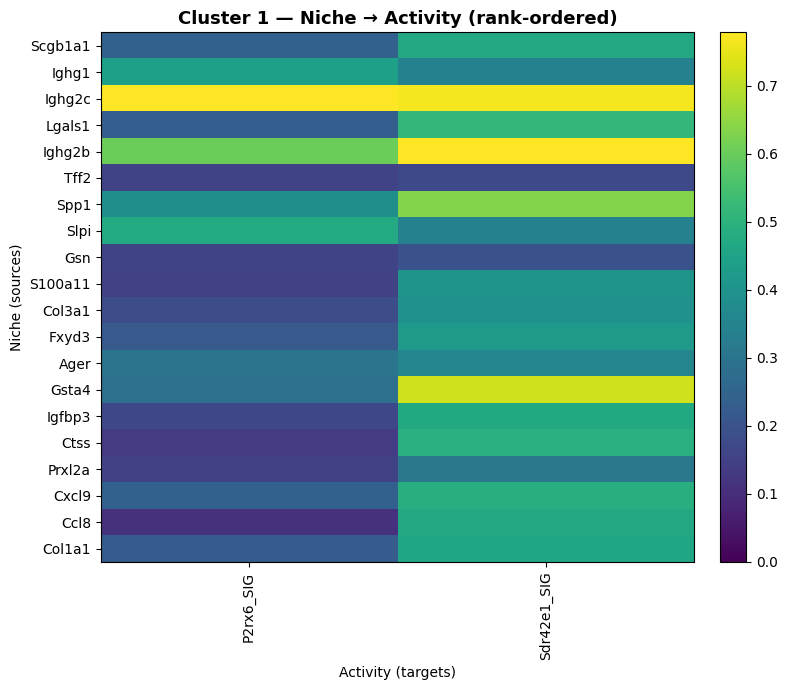

['../Mongoose_post_hoc/heatmaps_from_csv/heatmap_cluster1.png']

In [9]:
# Visualize the uploaded CSV as rank-ordered heatmaps (per cluster) and a differential heatmap (if two clusters exist)
# - Uses matplotlib only (as requested by the tools policy).
# - Saves outputs to /mnt/data and also displays them inline.
#
# Path provided by you:
CSV_PATH = "../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251025_073708.csv"

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

OUTDIR = Path("../Mongoose_post_hoc/heatmaps_from_csv")
OUTDIR.mkdir(parents=True, exist_ok=True)

# ------- Load
df = pd.read_csv(CSV_PATH)

# ------- Basic normalization of column names (lowercase) and checks
df.columns = [c.strip().lower() for c in df.columns]
required = {"cluster","source","target","value","niche_rank","activity_rank"}
missing = required - set(df.columns)
if missing:
    raise SystemExit(f"Missing columns in CSV: {missing}")

# ------- Coerce numeric
for c in ["value","niche_rank","activity_rank","cluster"]:
    df[c] = pd.to_numeric(df[c], errors="coerce")
df = df.dropna(subset=["source","target","value","cluster"])

# ------- Keep only NICHE->ACTIVITY if a direction column exists
if "direction" in df.columns:
    mask = df["direction"].str.upper().str.replace(" ", "") == "NICHE->ACTIVITY"
    # Allow fallback if direction column exists but nothing matches exactly
    df_sub = df[mask].copy()
    if df_sub.empty:
        df_sub = df.copy()
else:
    df_sub = df.copy()

# ------- Aggregate edges within cluster
edges = (
    df_sub.groupby(["cluster","source","target"], as_index=False)["value"]
    .sum()
    .sort_values("value", ascending=False)
)

if edges.empty:
    raise SystemExit("No edges present after filtering/aggregation.")

# ------- Rank-based ordering (lower rank = earlier)
src_best = df_sub.groupby("source", as_index=True)["niche_rank"].min()
tgt_best = df_sub.groupby("target", as_index=True)["activity_rank"].min()

def order_by_rank(names, best_series):
    recs = []
    for n in names:
        r = best_series.get(n, np.nan)
        recs.append((n, r))
    recs.sort(key=lambda t: (not np.isfinite(t[1]), t[1], str(t[0]).lower()))
    return [n for n, _ in recs]

clusters_present = sorted(edges["cluster"].unique().tolist())
all_sources = order_by_rank(edges["source"].unique().tolist(), src_best)
all_targets = order_by_rank(edges["target"].unique().tolist(), tgt_best)

def cluster_matrix(c):
    sub = edges[edges["cluster"] == c]
    mat = pd.DataFrame(0.0, index=all_sources, columns=all_targets)
    for _, row in sub.iterrows():
        mat.loc[row["source"], row["target"]] = float(row["value"])
    return mat

mats = {c: cluster_matrix(c) for c in clusters_present}

# ------- Plot helper (matplotlib only; one chart per figure)
def plot_heatmap(matrix: pd.DataFrame, title: str, outpath: Path, vmin=None, vmax=None, center=None, cmap=None):
    plt.figure(figsize=(max(8, matrix.shape[1]*0.35), max(6, matrix.shape[0]*0.35)))
    # If center is provided, use TwoSlopeNorm to center the colormap at 0
    norm = None
    if center is not None:
        from matplotlib.colors import TwoSlopeNorm
        vmin = vmin if vmin is not None else float(np.nanmin(matrix.values))
        vmax = vmax if vmax is not None else float(np.nanmax(matrix.values))
        # ensure symmetric if not set
        max_abs = max(abs(vmin), abs(vmax))
        vmin, vmax = -max_abs, max_abs
        norm = TwoSlopeNorm(vmin=vmin, vcenter=center, vmax=vmax)

    im = plt.imshow(matrix.values, aspect='auto', interpolation='nearest',
                    vmin=vmin, vmax=vmax, cmap=cmap, norm=norm)
    plt.colorbar(im, fraction=0.046, pad=0.04)
    plt.title(title, fontsize=13, fontweight='bold')
    plt.xticks(ticks=np.arange(matrix.shape[1]), labels=matrix.columns, rotation=90)
    plt.yticks(ticks=np.arange(matrix.shape[0]), labels=matrix.index)
    plt.xlabel("Activity (targets)")
    plt.ylabel("Niche (sources)")
    plt.tight_layout()
    plt.savefig(outpath, dpi=300, bbox_inches="tight")
    plt.show()

# ------- Per-cluster heatmaps
saved_files = []
for c, mat in mats.items():
    out_png = OUTDIR / f"heatmap_cluster{int(c)}.png"
    # cap vmax for comparable scaling across clusters (p95)
    vmax = float(np.nanpercentile(mat.values, 95)) if np.isfinite(mat.values).any() else None
    plot_heatmap(mat, f"Cluster {int(c)} — Niche → Activity (rank-ordered)",
                 out_png, vmin=0, vmax=vmax, center=None, cmap="viridis")
    saved_files.append(str(out_png))
    # also export matrix
    mat.to_csv(OUTDIR / f"matrix_cluster{int(c)}.csv")

# ------- Differential heatmap (if at least two clusters)
if len(clusters_present) >= 2:
    # choose two clusters deterministically (first two in ascending order)
    cA, cB = clusters_present[:2]
    diff_mat = mats[cA] - mats[cB]
    out_png = OUTDIR / f"heatmap_diff_C{int(cA)}_minus_C{int(cB)}.png"
    plot_heatmap(diff_mat, f"Differential (Cluster {int(cA)} − Cluster {int(cB)}) — Niche → Activity",
                 out_png, vmin=None, vmax=None, center=0.0, cmap="RdBu_r")
    saved_files.append(str(out_png))
    diff_mat.to_csv(OUTDIR / f"matrix_diff_C{int(cA)}_minus_C{int(cB)}.csv")

saved_files


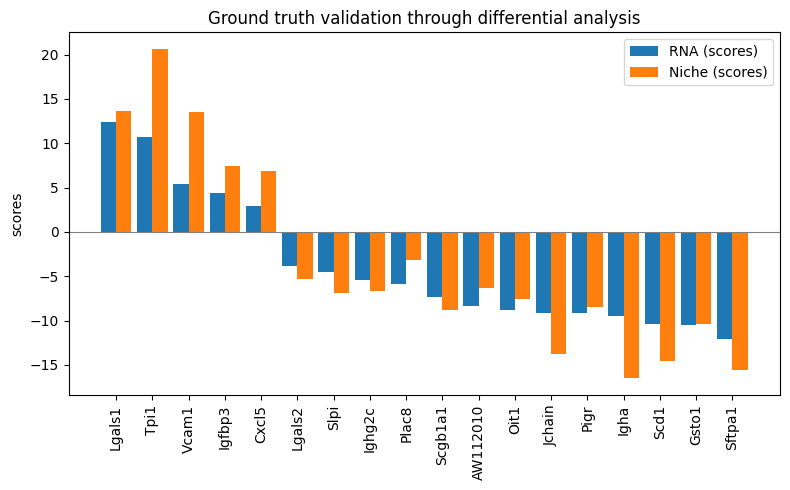

In [18]:
# --- RNA vs Niche barplot, original size + ranked ---
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

# ---- paths ----
RNA_DEG   = Path("../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-2/DEGs_padj_lt_0.05.csv")
NICHE_DEG = Path("../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-2/DEGs_padj_lt_0.05_niche.csv")
EDGES_CSV = Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251026_200015.csv")

# ---- ranking rule ----
# options: "RNA", "Niche", "mean", "sum", "absmax"
ORDER_BY = "RNA"

def detect_gene_col(df: pd.DataFrame) -> str:
    for c in df.columns:
        if c.lower() in {"names","gene","genesymbol","symbol"}:
            return c
    return df.columns[0]

def load_deg_scores(path: Path) -> pd.DataFrame:
    df = pd.read_csv(path)
    gcol = detect_gene_col(df)
    scol = "scores" if "scores" in df.columns else df.columns[1]
    out = df[[gcol, scol]].copy()
    out.columns = ["gene", "score"]
    out["gene"]  = out["gene"].astype(str)
    out["score"] = pd.to_numeric(out["score"], errors="coerce")
    return out

def load_edges(path: Path) -> pd.DataFrame:
    e = pd.read_csv(path)
    src = next((c for c in e.columns if c.lower() in {"source","src","from"}), e.columns[0])
    tgt = next((c for c in e.columns if c.lower() in {"target","tgt","to"}),    e.columns[1])
    return e[[src, tgt]].rename(columns={src:"source", tgt:"target"}).astype(str)

# ---- load & merge ----
rna_deg   = load_deg_scores(RNA_DEG)
niche_deg = load_deg_scores(NICHE_DEG)
edges     = load_edges(EDGES_CSV)

alluvial_genes = pd.unique(pd.concat([edges["source"], edges["target"]], ignore_index=True))

merged = (pd.DataFrame({"gene": alluvial_genes})
          .merge(rna_deg.rename(columns={"score":"RNA"}),   on="gene", how="left")
          .merge(niche_deg.rename(columns={"score":"Niche"}), on="gene", how="left"))

# keep genes with at least one score
merged = merged[merged[["RNA","Niche"]].notna().any(axis=1)].copy()

# ---- compute ordering key (ranking) ----
if ORDER_BY == "RNA":
    key = merged["RNA"].fillna(-np.inf)
elif ORDER_BY == "Niche":
    key = merged["Niche"].fillna(-np.inf)
elif ORDER_BY == "mean":
    key = merged[["RNA","Niche"]].mean(axis=1, skipna=True)
elif ORDER_BY == "sum":
    key = merged[["RNA","Niche"]].sum(axis=1, skipna=True)
elif ORDER_BY == "absmax":
    key = merged[["RNA","Niche"]].abs().max(axis=1, skipna=True)
else:
    key = merged["RNA"].fillna(-np.inf)

merged = merged.assign(_rank=key).sort_values("_rank", ascending=False).drop(columns="_rank")

# ---- plot: original size & bar width ----
genes = merged["gene"].tolist()
x = np.arange(len(genes))
width = 0.42  # original bar width

plt.figure(figsize=(max(8, len(genes)*0.35), 5))  # original sizing
plt.bar(x - width/2, np.nan_to_num(merged["RNA"].to_numpy(),   nan=0.0), width, label="RNA (scores)")
plt.bar(x + width/2, np.nan_to_num(merged["Niche"].to_numpy(), nan=0.0), width, label="Niche (scores)")

plt.axhline(0, lw=0.8, color="grey")
plt.xticks(x, genes, rotation=90)
plt.ylabel("scores")
plt.title("Ground truth validation through differential analysis")
plt.legend()
plt.tight_layout()
plt.show()


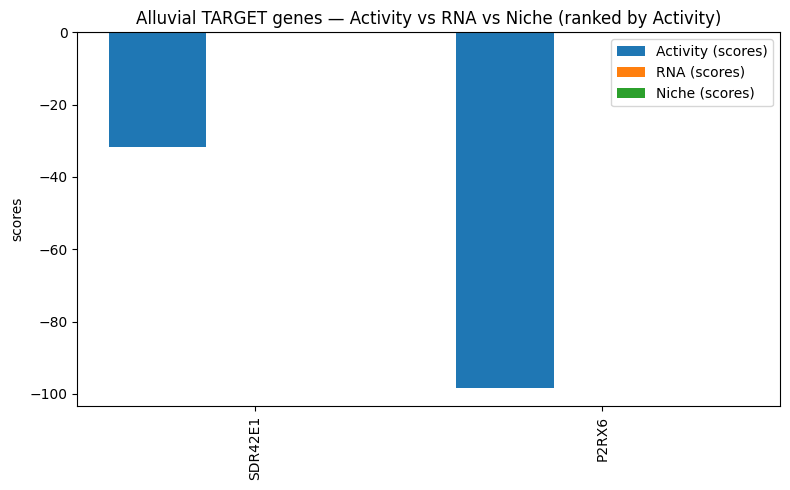

In [56]:
# --- 3-bar plot (Activity, RNA, Niche) for alluvial TARGET genes (activity side), with cleaned names ---
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
from pathlib import Path
from typing import Optional

# -------- Paths --------
RNA_DEG      = Path("../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-2/DEGs_padj_lt_0.05.csv")
NICHE_DEG    = Path("../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-2/DEGs_padj_lt_0.05_niche.csv")
ACTIVITY_DEG = Path("../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-2/DEGs_padj_lt_0.05_activity.csv")
EDGES_CSV    = Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251025_073708.csv")

# Column detection preferences
TSCORE_PREFS = ["scores"]  # add fallbacks if needed, e.g. ["t","scores","stat","logfoldchanges"]

# -------- Helpers --------
def norm_key(x: str) -> str:
    """Clean gene label: strip trailing _SIG/_TF and uppercase."""
    x = str(x).strip()
    x = re.sub(r"(_SIG|_TF)$", "", x, flags=re.IGNORECASE)
    return x.upper()

def detect_gene_col(df: pd.DataFrame) -> str:
    cand = [c for c in df.columns if c.lower() in {"names","gene","genesymbol","symbol"}]
    return cand[0] if cand else df.columns[0]

def detect_score_col(df: pd.DataFrame) -> Optional[str]:
    cl = {c.lower(): c for c in df.columns}
    for pref in TSCORE_PREFS:
        if pref in cl:
            return cl[pref]
    return None

def load_deg(path: Path, label: str) -> pd.DataFrame:
    """Return columns: gene_key (cleaned), score_<label>."""
    df = pd.read_csv(path)
    gcol = detect_gene_col(df)
    scol = detect_score_col(df)
    out = pd.DataFrame({
        "gene_key": df[gcol].astype(str).map(norm_key),
        f"score_{label}": pd.to_numeric(df[scol], errors="coerce") if scol else np.nan
    })
    # keep the best unique row per gene if duplicates
    out = out.groupby("gene_key", as_index=False).agg({f"score_{label}": "mean"})
    return out

def load_edges_targets(path: Path) -> pd.DataFrame:
    """Return DataFrame with target genes (cleaned) used in alluvial (activity side)."""
    e = pd.read_csv(path)
    # try to find source/target columns
    src = next((c for c in e.columns if c.lower() in {"source","src","from"}), None) \
          or next((c for c in e.columns if "source" in c.lower()), None) \
          or e.columns[0]
    tgt = next((c for c in e.columns if c.lower() in {"target","tgt","to"}), None) \
          or next((c for c in e.columns if "target" in c.lower()), None) \
          or e.columns[1]
    targets_raw = e[tgt].astype(str)
    targets_key = targets_raw.map(norm_key)
    return pd.DataFrame({"gene_key": pd.unique(targets_key)})

# -------- Load --------
targets   = load_edges_targets(EDGES_CSV)               # alluvial TARGET genes (activity side)
deg_act   = load_deg(ACTIVITY_DEG, "Activity")
deg_rna   = load_deg(RNA_DEG,      "RNA")
deg_niche = load_deg(NICHE_DEG,    "Niche")

# Merge 3 analyses; keep only targets present in alluvial
merged = (targets
          .merge(deg_act,   on="gene_key", how="left")
          .merge(deg_rna,   on="gene_key", how="left")
          .merge(deg_niche, on="gene_key", how="left"))

# Keep genes with at least one available score
merged = merged[merged[["score_Activity","score_RNA","score_Niche"]].notna().any(axis=1)].copy()

# Ranking order (by Activity by default)
ORDER_BY = "Activity"  # options: "Activity" | "RNA" | "Niche" | "mean" | "sum" | "absmax"
if ORDER_BY in {"Activity","RNA","Niche"}:
    key = merged[f"score_{ORDER_BY}"].fillna(-np.inf)
elif ORDER_BY == "mean":
    key = merged[["score_Activity","score_RNA","score_Niche"]].mean(axis=1, skipna=True)
elif ORDER_BY == "sum":
    key = merged[["score_Activity","score_RNA","score_Niche"]].sum(axis=1, skipna=True)
elif ORDER_BY == "absmax":
    key = merged[["score_Activity","score_RNA","score_Niche"]].abs().max(axis=1, skipna=True)
else:
    key = merged["score_Activity"].fillna(-np.inf)

merged = merged.assign(_rank=key).sort_values("_rank", ascending=False).drop(columns="_rank")

# -------- Plot (3 bars per gene, original size) --------
genes = merged["gene_key"].tolist()        # cleaned names used for display
x = np.arange(len(genes))
width = 0.28                               # 3 bars → slightly narrower so they fit

plt.figure(figsize=(max(8, len(genes)*0.35), 5))
plt.bar(x - width,   np.nan_to_num(merged["score_Activity"].to_numpy(), nan=0.0),
        width, label="Activity (scores)")
plt.bar(x,           np.nan_to_num(merged["score_RNA"].to_numpy(),      nan=0.0),
        width, label="RNA (scores)")
plt.bar(x + width,   np.nan_to_num(merged["score_Niche"].to_numpy(),    nan=0.0),
        width, label="Niche (scores)")

plt.axhline(0, lw=0.8, color="grey")
plt.xticks(x, genes, rotation=90)
plt.ylabel("scores")
plt.title(f"Alluvial TARGET genes — Activity vs RNA vs Niche (ranked by {ORDER_BY})")
plt.legend()
plt.tight_layout()
plt.show()

# Optional: export table
# merged.to_csv("alluvial_target_genes_scores_Activity_RNA_Niche.csv", index=False)


## KP1_1

In [80]:
import os
import re
import pandas as pd
from datetime import datetime

# ========= PATHS (edit if needed) =========
import os
import re
import pandas as pd
from datetime import datetime

# ========= PATHS (edit if needed) =========
SHAP_CSV     = "../Task2_CMP/capboost_cross_modal_analysis_20251115_164209/capboost_feature_feature_importance_activity_flux_niche.csv"
BIO_NICHE    = "../GenKI/GenKI_NB_Tgfbr2_20251115_171757/ALL_Significant_Genes_Combined.csv"
BIO_ACTIVITY = "../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_173901/ALL_Significant_Genes_Combined.csv"

OUT_DIR = "../Mongoose_post_hoc/"
os.makedirs(OUT_DIR, exist_ok=True)
STAMP   = datetime.now().strftime("%Y%m%d_%H%M%S")
OUT_CSV = os.path.join(OUT_DIR, f"niche_to_activity_shap_edges_with_ranks_clusters45_{STAMP}.csv")

CLUSTERS_TO_KEEP = {0}   # the UnitedNet cluster that included the KP1_1 region during super-vised clustering

# ========= HELPERS =========
def clean_gene(x: str):
    if pd.isna(x): return None
    x = str(x).strip()
    x = re.sub(r"(_SIG|_TF)$", "", x, flags=re.IGNORECASE)
    return x.upper()

def detect_col(df, candidates_exact, candidates_contains=()):
    for c in df.columns:
        if c.lower() in candidates_exact:
            return c
    for c in df.columns:
        cl = c.lower()
        if any(k in cl for k in candidates_contains):
            return c
    return None

def pick_gene_col(df):
    prefer_exact = {"gene","genes","symbol","gene_symbol","names","name"}
    prefer_contains = ("gene","symbol","name")
    c = detect_col(df, prefer_exact, prefer_contains)
    if c: return c
    obj_cols = [c for c in df.columns if df[c].dtype == "O"]
    return obj_cols[0] if obj_cols else df.columns[0]

def pick_rank_col(df):
    # FIXED: Prioritize "rank" over "index" by checking rank first
    # Check for exact "rank" column first
    for c in df.columns:
        if c.lower() == "rank":
            return c
    
    # Then check for other exact matches (excluding "index" to avoid confusion)
    prefer_exact = {"order","position","rnk"}
    c = detect_col(df, prefer_exact, ("order","position"))
    if c: return c
    
    # Check for columns containing "rank" in the name
    for col in df.columns:
        if "rank" in col.lower() and pd.api.types.is_numeric_dtype(df[col]):
            return col
    
    # Only if nothing else found, check other numeric candidates
    for cand in ["dis","score","scores","priority"]:
        for col in df.columns:
            if col.lower()==cand and pd.api.types.is_numeric_dtype(df[col]):
                return col
    
    # Last resort: use row number or first numeric column
    numeric_cols = [c for c in df.columns if pd.api.types.is_numeric_dtype(df[c])]
    return numeric_cols[0] if numeric_cols else None

def load_gene_rank_lookup(path, role="niche"):
    df = pd.read_csv(path)
    gcol = pick_gene_col(df)
    rcol = pick_rank_col(df)
    if gcol is None:
        raise ValueError(f"[{role}] Could not detect gene column in {path}. Columns = {list(df.columns)}")
    if rcol is None:
        rcol = "__ROW_ORDER__"
        df[rcol] = range(1, len(df)+1)

    print(f"[INFO] {role}: Using gene column '{gcol}' and rank column '{rcol}'")

    tmp = df[[gcol, rcol]].copy()
    tmp["gene_clean"] = tmp[gcol].map(clean_gene)
    tmp = tmp.dropna(subset=["gene_clean"])

    with pd.option_context('mode.use_inf_as_na', True):
        tmp[rcol] = pd.to_numeric(tmp[rcol], errors="coerce")
    if not pd.api.types.is_numeric_dtype(tmp[rcol]):
        tmp[rcol] = pd.factorize(tmp[rcol])[0] + 1

    ser = tmp.groupby("gene_clean")[rcol].min().rename(f"{role}_rank")
    return ser.reset_index()

def pick_value_col(shap_df: pd.DataFrame) -> str:
    name_pat = re.compile(r"(shap|feature[_-]?importance|importance|weight|gain)$", re.I)
    cand = [c for c in shap_df.columns if name_pat.search(c)]
    cand = [c for c in cand if pd.api.types.is_numeric_dtype(shap_df[c])]
    if not cand:
        exclude_pat = re.compile(r"(source|target|gene|name|id|idx|rank|cluster)$", re.I)
        cand = [c for c in shap_df.columns
                if pd.api.types.is_numeric_dtype(shap_df[c]) and not exclude_pat.search(c)]
    if not cand:
        raise ValueError("Could not find a numeric SHAP/importance column in the SHAP CSV.")

    def score_col(c):
        has_shap = 0 if re.search(r"shap", c, re.I) else 1
        nunique  = shap_df[c].nunique()
        stdv     = float(shap_df[c].std(skipna=True) or 0.0)
        return (has_shap, -nunique, -stdv)

    cand.sort(key=score_col)
    return cand[0]

def pick_cluster_col(df):
    # common names: Cluster, cluster, cluster_id, cluster_label, etc.
    c = detect_col(df, {"cluster","cluster_id","clusters"}, ("cluster",))
    return c

def to_cluster_num(series):
    # Try numeric directly; if fails, extract first integer from strings like "Cluster 4"
    s = pd.to_numeric(series, errors="coerce")
    if s.notna().any():
        return s
    # extract first integer found per entry
    return series.astype(str).str.extract(r"(\d+)")[0].astype(float)

# ========= LOAD LOOKUPS =========
niche_lookup    = load_gene_rank_lookup(BIO_NICHE,    role="niche")
activity_lookup = load_gene_rank_lookup(BIO_ACTIVITY, role="activity")

print(f"\n[INFO] Loaded {len(niche_lookup)} niche genes with ranks from {min(niche_lookup['niche_rank'])} to {max(niche_lookup['niche_rank'])}")
print(f"[INFO] Loaded {len(activity_lookup)} activity genes with ranks from {min(activity_lookup['activity_rank'])} to {max(activity_lookup['activity_rank'])}")

# ========= READ SHAP, DETECT COLS, FILTER CLUSTERS =========
shap = pd.read_csv(SHAP_CSV)

src_col = detect_col(shap, {"source","src","from","niche","niche_gene"}, ("source","src","from","niche"))
tgt_col = detect_col(shap, {"target","tgt","to","activity","activity_gene"}, ("target","tgt","to","activity"))
cluster_col = pick_cluster_col(shap)

if not all([src_col, tgt_col]):
    raise ValueError(
        f"Could not infer source/target columns. source={src_col}, target={tgt_col}. "
        f"Columns available: {list(shap.columns)}"
    )

# Filter to clusters 4 & 5 if cluster column exists
if cluster_col:
    clusters_num = to_cluster_num(shap[cluster_col])
    shap = shap.loc[clusters_num.isin(CLUSTERS_TO_KEEP)].copy()
    shap["_cluster_num_"] = clusters_num.loc[shap.index]
else:
    print("[WARN] No cluster column detected; proceeding without cluster filter.")

# Now pick the best 'value' column AFTER cluster filtering
val_col = pick_value_col(shap)
shap[val_col] = pd.to_numeric(shap[val_col], errors="coerce")

print(f"[INFO] Using value column: {val_col} | nunique={shap[val_col].nunique()}")

# ========= CLEAN, MERGE RANKS, FILTER =========
cols = [src_col, tgt_col, val_col] + (["_cluster_num_"] if "_cluster_num_" in shap.columns else [])
df = shap[cols].copy()
rename_map = {src_col: "source", tgt_col: "target", val_col: "value"}
if "_cluster_num_" in df.columns:
    rename_map["_cluster_num_"] = "cluster"
df = df.rename(columns=rename_map)

df["source_clean"] = df["source"].map(clean_gene)
df["target_clean"] = df["target"].map(clean_gene)
df = df.dropna(subset=["source_clean","target_clean","value"])

df = df.merge(niche_lookup,    how="left", left_on="source_clean", right_on="gene_clean").drop(columns=["gene_clean"])
df = df.merge(activity_lookup, how="left", left_on="target_clean", right_on="gene_clean").drop(columns=["gene_clean"])

filtered = df[df["niche_rank"].notna() & df["activity_rank"].notna()].copy()
sort_keys = ["value","niche_rank","activity_rank"]
filtered = filtered.sort_values(sort_keys, ascending=[False, True, True]).reset_index(drop=True)

# ========= OUTPUT =========
keep_cols = ["source","target","value","niche_rank","activity_rank"]
if "cluster" in filtered.columns:
    keep_cols.insert(0, "cluster")  # put cluster first for readability
filtered_out = filtered[keep_cols].copy()

filtered_out.to_csv(OUT_CSV, index=False)
print(f"\nSaved: {OUT_CSV}")
print(f"Rows: {len(filtered_out)} | Unique sources: {filtered_out['source'].nunique()} | Unique targets: {filtered_out['target'].nunique()}")
print("\nPreview:")
print(filtered_out.head(20))

OUT_DIR = "../Mongoose_post_hoc/"
os.makedirs(OUT_DIR, exist_ok=True)
STAMP   = datetime.now().strftime("%Y%m%d_%H%M%S")
OUT_CSV = os.path.join(OUT_DIR, f"niche_to_activity_shap_edges_with_ranks_clusters45_{STAMP}.csv")

CLUSTERS_TO_KEEP = {0}   # the UnitedNet cluster that included the KP1_2 region during super-vised clustering

# ========= HELPERS =========
def clean_gene(x: str):
    if pd.isna(x): return None
    x = str(x).strip()
    x = re.sub(r"(_SIG|_TF)$", "", x, flags=re.IGNORECASE)
    return x.upper()

def detect_col(df, candidates_exact, candidates_contains=()):
    for c in df.columns:
        if c.lower() in candidates_exact:
            return c
    for c in df.columns:
        cl = c.lower()
        if any(k in cl for k in candidates_contains):
            return c
    return None

def pick_gene_col(df):
    prefer_exact = {"gene","genes","symbol","gene_symbol","names","name"}
    prefer_contains = ("gene","symbol","name")
    c = detect_col(df, prefer_exact, prefer_contains)
    if c: return c
    obj_cols = [c for c in df.columns if df[c].dtype == "O"]
    return obj_cols[0] if obj_cols else df.columns[0]

def pick_rank_col(df):
    # FIXED: Prioritize "rank" over "index" by checking rank first
    # Check for exact "rank" column first
    for c in df.columns:
        if c.lower() == "rank":
            return c
    
    # Then check for other exact matches (excluding "index" to avoid confusion)
    prefer_exact = {"order","position","rnk"}
    c = detect_col(df, prefer_exact, ("order","position"))
    if c: return c
    
    # Check for columns containing "rank" in the name
    for col in df.columns:
        if "rank" in col.lower() and pd.api.types.is_numeric_dtype(df[col]):
            return col
    
    # Only if nothing else found, check other numeric candidates
    for cand in ["dis","score","scores","priority"]:
        for col in df.columns:
            if col.lower()==cand and pd.api.types.is_numeric_dtype(df[col]):
                return col
    
    # Last resort: use row number or first numeric column
    numeric_cols = [c for c in df.columns if pd.api.types.is_numeric_dtype(df[c])]
    return numeric_cols[0] if numeric_cols else None

def load_gene_rank_lookup(path, role="niche"):
    df = pd.read_csv(path)
    gcol = pick_gene_col(df)
    rcol = pick_rank_col(df)
    if gcol is None:
        raise ValueError(f"[{role}] Could not detect gene column in {path}. Columns = {list(df.columns)}")
    if rcol is None:
        rcol = "__ROW_ORDER__"
        df[rcol] = range(1, len(df)+1)

    print(f"[INFO] {role}: Using gene column '{gcol}' and rank column '{rcol}'")

    tmp = df[[gcol, rcol]].copy()
    tmp["gene_clean"] = tmp[gcol].map(clean_gene)
    tmp = tmp.dropna(subset=["gene_clean"])

    with pd.option_context('mode.use_inf_as_na', True):
        tmp[rcol] = pd.to_numeric(tmp[rcol], errors="coerce")
    if not pd.api.types.is_numeric_dtype(tmp[rcol]):
        tmp[rcol] = pd.factorize(tmp[rcol])[0] + 1

    ser = tmp.groupby("gene_clean")[rcol].min().rename(f"{role}_rank")
    return ser.reset_index()

def pick_value_col(shap_df: pd.DataFrame) -> str:
    name_pat = re.compile(r"(shap|feature[_-]?importance|importance|weight|gain)$", re.I)
    cand = [c for c in shap_df.columns if name_pat.search(c)]
    cand = [c for c in cand if pd.api.types.is_numeric_dtype(shap_df[c])]
    if not cand:
        exclude_pat = re.compile(r"(source|target|gene|name|id|idx|rank|cluster)$", re.I)
        cand = [c for c in shap_df.columns
                if pd.api.types.is_numeric_dtype(shap_df[c]) and not exclude_pat.search(c)]
    if not cand:
        raise ValueError("Could not find a numeric SHAP/importance column in the SHAP CSV.")

    def score_col(c):
        has_shap = 0 if re.search(r"shap", c, re.I) else 1
        nunique  = shap_df[c].nunique()
        stdv     = float(shap_df[c].std(skipna=True) or 0.0)
        return (has_shap, -nunique, -stdv)

    cand.sort(key=score_col)
    return cand[0]

def pick_cluster_col(df):
    # common names: Cluster, cluster, cluster_id, cluster_label, etc.
    c = detect_col(df, {"cluster","cluster_id","clusters"}, ("cluster",))
    return c

def to_cluster_num(series):
    # Try numeric directly; if fails, extract first integer from strings like "Cluster 4"
    s = pd.to_numeric(series, errors="coerce")
    if s.notna().any():
        return s
    # extract first integer found per entry
    return series.astype(str).str.extract(r"(\d+)")[0].astype(float)

# ========= LOAD LOOKUPS =========
niche_lookup    = load_gene_rank_lookup(BIO_NICHE,    role="niche")
activity_lookup = load_gene_rank_lookup(BIO_ACTIVITY, role="activity")

print(f"\n[INFO] Loaded {len(niche_lookup)} niche genes with ranks from {min(niche_lookup['niche_rank'])} to {max(niche_lookup['niche_rank'])}")
print(f"[INFO] Loaded {len(activity_lookup)} activity genes with ranks from {min(activity_lookup['activity_rank'])} to {max(activity_lookup['activity_rank'])}")

# ========= READ SHAP, DETECT COLS, FILTER CLUSTERS =========
shap = pd.read_csv(SHAP_CSV)

src_col = detect_col(shap, {"source","src","from","niche","niche_gene"}, ("source","src","from","niche"))
tgt_col = detect_col(shap, {"target","tgt","to","activity","activity_gene"}, ("target","tgt","to","activity"))
cluster_col = pick_cluster_col(shap)

if not all([src_col, tgt_col]):
    raise ValueError(
        f"Could not infer source/target columns. source={src_col}, target={tgt_col}. "
        f"Columns available: {list(shap.columns)}"
    )

# Filter to clusters 4 & 5 if cluster column exists
if cluster_col:
    clusters_num = to_cluster_num(shap[cluster_col])
    shap = shap.loc[clusters_num.isin(CLUSTERS_TO_KEEP)].copy()
    shap["_cluster_num_"] = clusters_num.loc[shap.index]
else:
    print("[WARN] No cluster column detected; proceeding without cluster filter.")

# Now pick the best 'value' column AFTER cluster filtering
val_col = pick_value_col(shap)
shap[val_col] = pd.to_numeric(shap[val_col], errors="coerce")

print(f"[INFO] Using value column: {val_col} | nunique={shap[val_col].nunique()}")

# ========= CLEAN, MERGE RANKS, FILTER =========
cols = [src_col, tgt_col, val_col] + (["_cluster_num_"] if "_cluster_num_" in shap.columns else [])
df = shap[cols].copy()
rename_map = {src_col: "source", tgt_col: "target", val_col: "value"}
if "_cluster_num_" in df.columns:
    rename_map["_cluster_num_"] = "cluster"
df = df.rename(columns=rename_map)

df["source_clean"] = df["source"].map(clean_gene)
df["target_clean"] = df["target"].map(clean_gene)
df = df.dropna(subset=["source_clean","target_clean","value"])

df = df.merge(niche_lookup,    how="left", left_on="source_clean", right_on="gene_clean").drop(columns=["gene_clean"])
df = df.merge(activity_lookup, how="left", left_on="target_clean", right_on="gene_clean").drop(columns=["gene_clean"])

filtered = df[df["niche_rank"].notna() & df["activity_rank"].notna()].copy()
sort_keys = ["value","niche_rank","activity_rank"]
filtered = filtered.sort_values(sort_keys, ascending=[False, True, True]).reset_index(drop=True)

# ========= OUTPUT =========
keep_cols = ["source","target","value","niche_rank","activity_rank"]
if "cluster" in filtered.columns:
    keep_cols.insert(0, "cluster")  # put cluster first for readability
filtered_out = filtered[keep_cols].copy()

filtered_out.to_csv(OUT_CSV, index=False)
print(f"\nSaved: {OUT_CSV}")
print(f"Rows: {len(filtered_out)} | Unique sources: {filtered_out['source'].nunique()} | Unique targets: {filtered_out['target'].nunique()}")
print("\nPreview:")
print(filtered_out.head(20))

[INFO] niche: Using gene column 'Unnamed: 0' and rank column 'rank'
[INFO] activity: Using gene column 'Unnamed: 0' and rank column 'rank'

[INFO] Loaded 79 niche genes with ranks from 1 to 79
[INFO] Loaded 72 activity genes with ranks from 1 to 72
[INFO] Using value column: Value | nunique=4903

Saved: ../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251115_180636.csv
Rows: 1221 | Unique sources: 33 | Unique targets: 37

Preview:
    cluster  source        target  value  niche_rank  activity_rank
0         0  Ighg2c    Wnt10b_SIG    1.0         2.0           49.0
1         0  Jchain    Gm9008_SIG    1.0        30.0            2.0
2         0  Ighg2c      Pld6_SIG    1.0         2.0            5.0
3         0  Ighg2c  Slc25a42_SIG    1.0         2.0            7.0
4         0  Ighg2c     Zfp78_SIG    1.0         2.0           11.0
5         0  Ighg2c       Eda_SIG    1.0         2.0           12.0
6         0  Ighg2c    Slc8a2_SIG    1.0         2.0           1

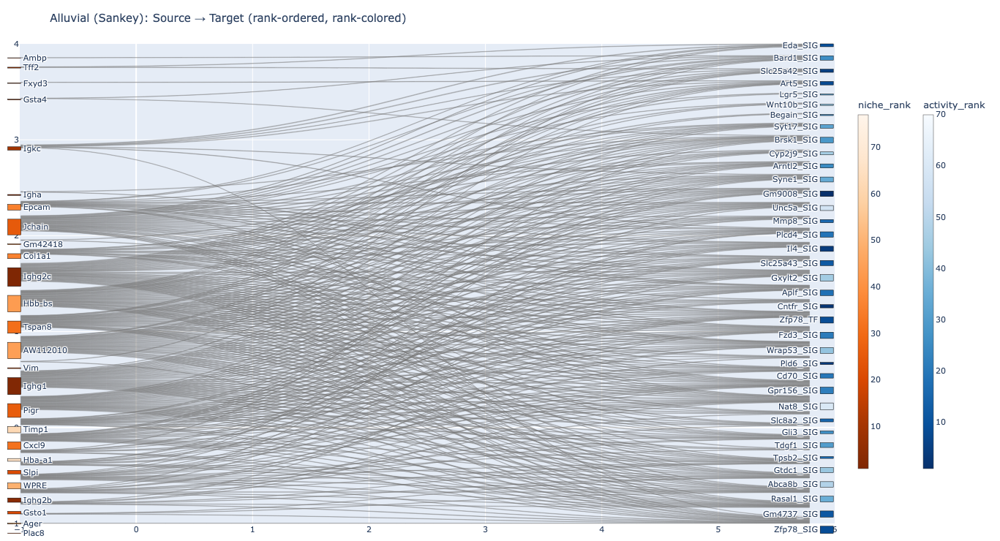

✓ Saved alluvial_rankordered_legend.html | Sources: 26 | Targets: 37 | Edges: 358


In [81]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from matplotlib import cm, colors as mpl_colors
from pathlib import Path

# ====== OPTIONS ======
CSV_PATH    = Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251115_180636.csv")
CLUSTERS    = None          # e.g., {0} or None
MIN_WEIGHT  = 0.5         # try 0.8 (few edges), 0.5, 0.3, etc.
TOP_N_EDGES = None          # e.g., 60 or None
TITLE       = "Alluvial (Sankey): Source → Target (rank-ordered, rank-colored)"
OUT_HTML    = "alluvial_rankordered_legend.html"
# =====================

def to_hex(v01, cmap="Oranges"):
    rgba = cm.get_cmap(cmap)(float(np.clip(v01, 0, 1)))
    return mpl_colors.to_hex(rgba)

# ---- Load ----
df = pd.read_csv(CSV_PATH)
req = {"cluster","source","target","value","niche_rank","activity_rank"}
missing = req - set(df.columns)
if missing:
    raise ValueError(f"Missing columns: {missing}")

if CLUSTERS is not None:
    df = df[df["cluster"].isin(CLUSTERS)].copy()

for c in ["value","niche_rank","activity_rank"]:
    df[c] = pd.to_numeric(df[c], errors="coerce")
df = df.dropna(subset=["source","target","value"])

# ---- Aggregate edges & filter ----
edges = (df.groupby(["source","target"], as_index=False)["value"].sum()
           .sort_values("value", ascending=False))
edges = edges[edges["value"] >= MIN_WEIGHT]
if TOP_N_EDGES:
    edges = edges.head(TOP_N_EDGES)
if edges.empty:
    raise SystemExit("No edges left — lower MIN_WEIGHT or adjust CLUSTERS.")

# ---- Best (smallest) per-node ranks ----
src_best = df.groupby("source")["niche_rank"].min()          # sources (left)
tgt_best = df.groupby("target")["activity_rank"].min()       # targets (right)

# ---- Order nodes darkest→light (best rank→worst) per side ----
def order_by_rank(names, best_series):
    recs = []
    for n in names:
        r = best_series.get(n, np.inf)       # missing ranks go to bottom
        recs.append((n, r))
    recs.sort(key=lambda t: (not np.isfinite(t[1]), t[1]))   # finite ranks first, ascending
    ordered_names  = [n for n, _ in recs]
    ordered_ranks  = [r if np.isfinite(r) else np.nan for _, r in recs]
    return ordered_names, ordered_ranks

unique_sources_raw = edges["source"].astype(str).unique()
unique_targets_raw = edges["target"].astype(str).unique()

ordered_sources, src_ranks_used = order_by_rank(unique_sources_raw, src_best)
ordered_targets, tgt_ranks_used = order_by_rank(unique_targets_raw, tgt_best)

# Re-map edges to the new node order
nodes = ordered_sources + ordered_targets
node_idx = {n: i for i, n in enumerate(nodes)}
edges_sorted = edges.copy()
edges_sorted["source_idx"] = edges_sorted["source"].astype(str).map(node_idx)
edges_sorted["target_idx"] = edges_sorted["target"].astype(str).map(node_idx)
edges_sorted = edges_sorted.sort_values(["source_idx","target_idx"])

link_source = edges_sorted["source_idx"].tolist()
link_target = edges_sorted["target_idx"].tolist()
link_value  = edges_sorted["value"].astype(float).tolist()

# ---- Colors from ranks (smaller rank = darker), normalized per side ----
def side_colors(names, ranks, cmap):
    arr = np.array(ranks, dtype=float)
    finite = np.isfinite(arr)
    if finite.any():
        rmin, rmax = np.nanmin(arr[finite]), np.nanmax(arr[finite])
        span = (rmax - rmin) if rmax != rmin else 1.0
        v01  = np.where(finite, (rmax - arr) / span, np.nan)   # 0..1 (best rank -> 1)
        v01  = np.nan_to_num(v01, nan=0.15)                    # missing -> light
        v01  = 0.15 + 0.85 * v01                               # visible range
    else:
        v01 = np.full(len(names), 0.4)                         # fallback
    return [to_hex(v, cmap) for v in v01], v01

src_colors, _ = side_colors(ordered_sources, src_ranks_used, "Oranges")
tgt_colors, _ = side_colors(ordered_targets, tgt_ranks_used, "Blues")
node_colors   = src_colors + tgt_colors

# ---- Node hover text with ranks ----
node_hover = []
for n, rk in zip(ordered_sources, src_ranks_used):
    node_hover.append(f"{n}<br>niche_rank: {rk:.0f}" if np.isfinite(rk) else f"{n}<br>niche_rank: NA")
for n, rk in zip(ordered_targets, tgt_ranks_used):
    node_hover.append(f"{n}<br>activity_rank: {rk:.0f}" if np.isfinite(rk) else f"{n}<br>activity_rank: NA")

# ---- Sankey ----
fig = go.Figure()

fig.add_trace(go.Sankey(
    arrangement="snap",   # respect our node ordering
    node=dict(
        pad=14, thickness=18, line=dict(color="black", width=0.5),
        label=nodes, color=node_colors,
        customdata=node_hover, hovertemplate="%{customdata}<extra></extra>",
    ),
    link=dict(
        source=link_source, target=link_target, value=link_value,
        color=["rgba(120,120,120,0.35)"] * len(link_value),
        hovertemplate="Source: %{source.label}<br>Target: %{target.label}"
                      "<br>Weight: %{value:.3g}<extra></extra>",
    )
))

# ---- Colorbar legends (reversed so rank 1 is darkest; start scale at 1) ----
def add_colorbar(fig, cmin, cmax, colorscale, title, x=1.02):
    cmin = 1 if np.isfinite(cmin) else 1
    if not np.isfinite(cmax) or cmax < cmin:
        cmax = cmin + 1
    fig.add_trace(go.Scatter(
        x=[None], y=[None], mode="markers",
        marker=dict(
            size=0.1,
            color=[cmin],
            cmin=cmin, cmax=cmax,
            colorscale=colorscale,
            reversescale=True,      # <<< lower rank (1) = darker on the legend
            showscale=True,
            colorbar=dict(
                title=title,
                x=x, xanchor="left",
                len=0.8, thickness=14,
                outlinewidth=0.5
            ),
        ),
        hoverinfo="skip",
        showlegend=False,
    ))

# Compute rank ranges, force legend to start at 1
src_finite = np.array([r for r in src_ranks_used if np.isfinite(r)])
tgt_finite = np.array([r for r in tgt_ranks_used if np.isfinite(r)])
src_min, src_max = (float(src_finite.min()), float(src_finite.max())) if src_finite.size else (1, 1)
tgt_min, tgt_max = (float(tgt_finite.min()), float(tgt_finite.max())) if tgt_finite.size else (1, 1)

add_colorbar(fig, src_min, src_max, "Oranges", "niche_rank",    x=1.02)
add_colorbar(fig, tgt_min, tgt_max, "Blues",   "activity_rank", x=1.10)

fig.update_layout(
    title=TITLE, font_size=11,
    height=740, width=1200,
    margin=dict(l=10, r=120, t=60, b=10)  # extra right margin for the two colorbars
)

fig.show()
fig.write_html(OUT_HTML, include_plotlyjs="cdn")
print(f"✓ Saved {OUT_HTML} | Sources: {len(ordered_sources)} | Targets: {len(ordered_targets)} | Edges: {len(edges_sorted)}")


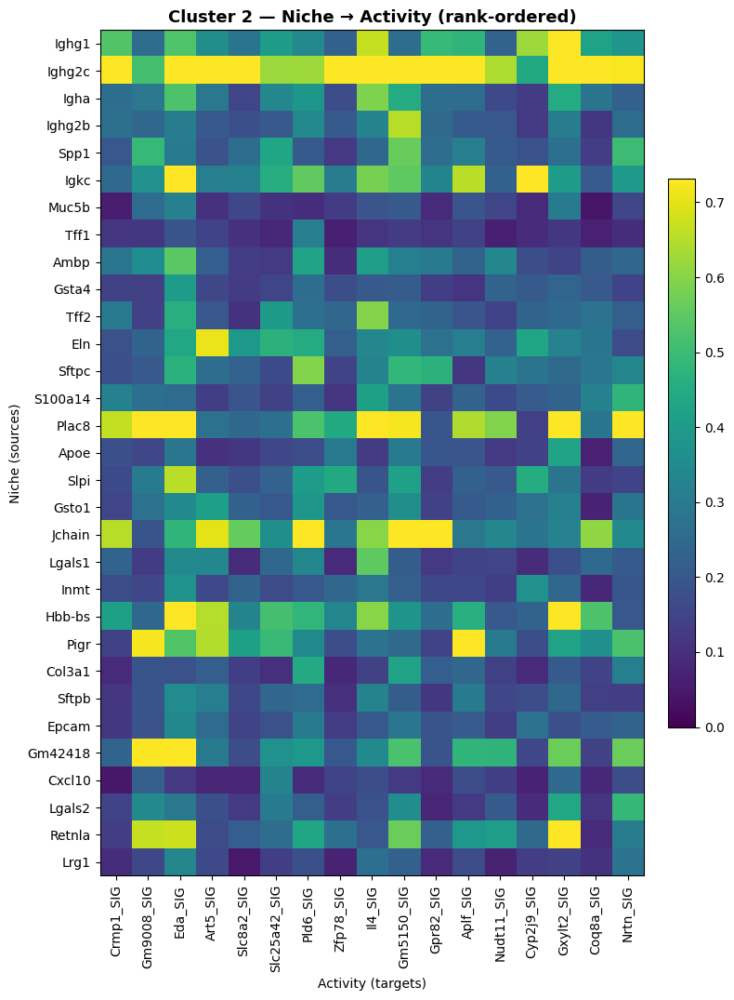

['../Mongoose_post_hoc/heatmaps_from_csv/heatmap_cluster2.png']

In [3]:
# Visualize the uploaded CSV as rank-ordered heatmaps (per cluster) and a differential heatmap (if two clusters exist)
# - Uses matplotlib only (as requested by the tools policy).
# - Saves outputs to /mnt/data and also displays them inline.
#
# Path provided by you:
CSV_PATH = "../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251026_194037.csv"

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

OUTDIR = Path("../Mongoose_post_hoc/heatmaps_from_csv")
OUTDIR.mkdir(parents=True, exist_ok=True)

# ------- Load
df = pd.read_csv(CSV_PATH)

# ------- Basic normalization of column names (lowercase) and checks
df.columns = [c.strip().lower() for c in df.columns]
required = {"cluster","source","target","value","niche_rank","activity_rank"}
missing = required - set(df.columns)
if missing:
    raise SystemExit(f"Missing columns in CSV: {missing}")

# ------- Coerce numeric
for c in ["value","niche_rank","activity_rank","cluster"]:
    df[c] = pd.to_numeric(df[c], errors="coerce")
df = df.dropna(subset=["source","target","value","cluster"])

# ------- Keep only NICHE->ACTIVITY if a direction column exists
if "direction" in df.columns:
    mask = df["direction"].str.upper().str.replace(" ", "") == "NICHE->ACTIVITY"
    # Allow fallback if direction column exists but nothing matches exactly
    df_sub = df[mask].copy()
    if df_sub.empty:
        df_sub = df.copy()
else:
    df_sub = df.copy()

# ------- Aggregate edges within cluster
edges = (
    df_sub.groupby(["cluster","source","target"], as_index=False)["value"]
    .sum()
    .sort_values("value", ascending=False)
)

if edges.empty:
    raise SystemExit("No edges present after filtering/aggregation.")

# ------- Rank-based ordering (lower rank = earlier)
src_best = df_sub.groupby("source", as_index=True)["niche_rank"].min()
tgt_best = df_sub.groupby("target", as_index=True)["activity_rank"].min()

def order_by_rank(names, best_series):
    recs = []
    for n in names:
        r = best_series.get(n, np.nan)
        recs.append((n, r))
    recs.sort(key=lambda t: (not np.isfinite(t[1]), t[1], str(t[0]).lower()))
    return [n for n, _ in recs]

clusters_present = sorted(edges["cluster"].unique().tolist())
all_sources = order_by_rank(edges["source"].unique().tolist(), src_best)
all_targets = order_by_rank(edges["target"].unique().tolist(), tgt_best)

def cluster_matrix(c):
    sub = edges[edges["cluster"] == c]
    mat = pd.DataFrame(0.0, index=all_sources, columns=all_targets)
    for _, row in sub.iterrows():
        mat.loc[row["source"], row["target"]] = float(row["value"])
    return mat

mats = {c: cluster_matrix(c) for c in clusters_present}

# ------- Plot helper (matplotlib only; one chart per figure)
def plot_heatmap(matrix: pd.DataFrame, title: str, outpath: Path, vmin=None, vmax=None, center=None, cmap=None):
    plt.figure(figsize=(max(8, matrix.shape[1]*0.35), max(6, matrix.shape[0]*0.35)))
    # If center is provided, use TwoSlopeNorm to center the colormap at 0
    norm = None
    if center is not None:
        from matplotlib.colors import TwoSlopeNorm
        vmin = vmin if vmin is not None else float(np.nanmin(matrix.values))
        vmax = vmax if vmax is not None else float(np.nanmax(matrix.values))
        # ensure symmetric if not set
        max_abs = max(abs(vmin), abs(vmax))
        vmin, vmax = -max_abs, max_abs
        norm = TwoSlopeNorm(vmin=vmin, vcenter=center, vmax=vmax)

    im = plt.imshow(matrix.values, aspect='auto', interpolation='nearest',
                    vmin=vmin, vmax=vmax, cmap=cmap, norm=norm)
    plt.colorbar(im, fraction=0.046, pad=0.04)
    plt.title(title, fontsize=13, fontweight='bold')
    plt.xticks(ticks=np.arange(matrix.shape[1]), labels=matrix.columns, rotation=90)
    plt.yticks(ticks=np.arange(matrix.shape[0]), labels=matrix.index)
    plt.xlabel("Activity (targets)")
    plt.ylabel("Niche (sources)")
    plt.tight_layout()
    plt.savefig(outpath, dpi=300, bbox_inches="tight")
    plt.show()

# ------- Per-cluster heatmaps
saved_files = []
for c, mat in mats.items():
    out_png = OUTDIR / f"heatmap_cluster{int(c)}.png"
    # cap vmax for comparable scaling across clusters (p95)
    vmax = float(np.nanpercentile(mat.values, 95)) if np.isfinite(mat.values).any() else None
    plot_heatmap(mat, f"Cluster {int(c)} — Niche → Activity (rank-ordered)",
                 out_png, vmin=0, vmax=vmax, center=None, cmap="viridis")
    saved_files.append(str(out_png))
    # also export matrix
    mat.to_csv(OUTDIR / f"matrix_cluster{int(c)}.csv")

# ------- Differential heatmap (if at least two clusters)
if len(clusters_present) >= 2:
    # choose two clusters deterministically (first two in ascending order)
    cA, cB = clusters_present[:2]
    diff_mat = mats[cA] - mats[cB]
    out_png = OUTDIR / f"heatmap_diff_C{int(cA)}_minus_C{int(cB)}.png"
    plot_heatmap(diff_mat, f"Differential (Cluster {int(cA)} − Cluster {int(cB)}) — Niche → Activity",
                 out_png, vmin=None, vmax=None, center=0.0, cmap="RdBu_r")
    saved_files.append(str(out_png))
    diff_mat.to_csv(OUTDIR / f"matrix_diff_C{int(cA)}_minus_C{int(cB)}.csv")

saved_files


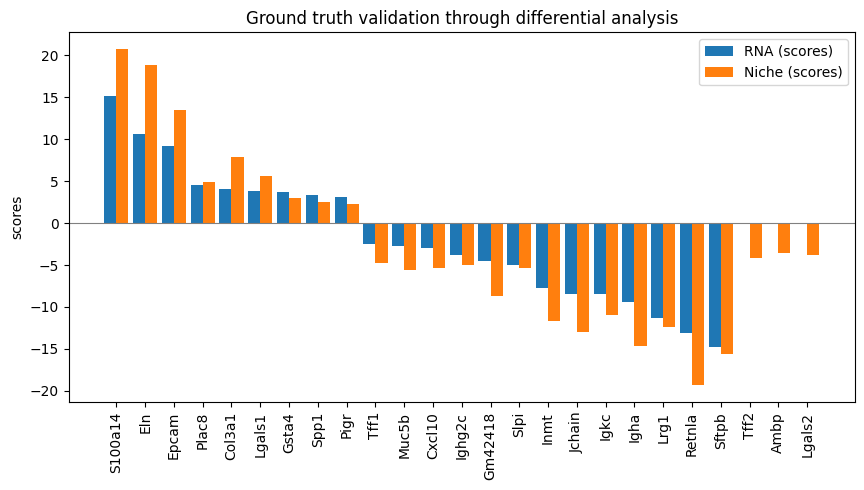

In [47]:
# --- RNA vs Niche barplot, original size + ranked ---
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

# ---- paths ----
RNA_DEG   = Path("../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv")
NICHE_DEG = Path("../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv")
EDGES_CSV = Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251026_194037.csv")

# ---- ranking rule ----
# options: "RNA", "Niche", "mean", "sum", "absmax"
ORDER_BY = "RNA"

def detect_gene_col(df: pd.DataFrame) -> str:
    for c in df.columns:
        if c.lower() in {"names","gene","genesymbol","symbol"}:
            return c
    return df.columns[0]

def load_deg_scores(path: Path) -> pd.DataFrame:
    df = pd.read_csv(path)
    gcol = detect_gene_col(df)
    scol = "scores" if "scores" in df.columns else df.columns[1]
    out = df[[gcol, scol]].copy()
    out.columns = ["gene", "score"]
    out["gene"]  = out["gene"].astype(str)
    out["score"] = pd.to_numeric(out["score"], errors="coerce")
    return out

def load_edges(path: Path) -> pd.DataFrame:
    e = pd.read_csv(path)
    src = next((c for c in e.columns if c.lower() in {"source","src","from"}), e.columns[0])
    tgt = next((c for c in e.columns if c.lower() in {"target","tgt","to"}),    e.columns[1])
    return e[[src, tgt]].rename(columns={src:"source", tgt:"target"}).astype(str)

# ---- load & merge ----
rna_deg   = load_deg_scores(RNA_DEG)
niche_deg = load_deg_scores(NICHE_DEG)
edges     = load_edges(EDGES_CSV)

alluvial_genes = pd.unique(pd.concat([edges["source"], edges["target"]], ignore_index=True))

merged = (pd.DataFrame({"gene": alluvial_genes})
          .merge(rna_deg.rename(columns={"score":"RNA"}),   on="gene", how="left")
          .merge(niche_deg.rename(columns={"score":"Niche"}), on="gene", how="left"))

# keep genes with at least one score
merged = merged[merged[["RNA","Niche"]].notna().any(axis=1)].copy()

# ---- compute ordering key (ranking) ----
if ORDER_BY == "RNA":
    key = merged["RNA"].fillna(-np.inf)
elif ORDER_BY == "Niche":
    key = merged["Niche"].fillna(-np.inf)
elif ORDER_BY == "mean":
    key = merged[["RNA","Niche"]].mean(axis=1, skipna=True)
elif ORDER_BY == "sum":
    key = merged[["RNA","Niche"]].sum(axis=1, skipna=True)
elif ORDER_BY == "absmax":
    key = merged[["RNA","Niche"]].abs().max(axis=1, skipna=True)
else:
    key = merged["RNA"].fillna(-np.inf)

merged = merged.assign(_rank=key).sort_values("_rank", ascending=False).drop(columns="_rank")

# ---- plot: original size & bar width ----
genes = merged["gene"].tolist()
x = np.arange(len(genes))
width = 0.42  # original bar width

plt.figure(figsize=(max(8, len(genes)*0.35), 5))  # original sizing
plt.bar(x - width/2, np.nan_to_num(merged["RNA"].to_numpy(),   nan=0.0), width, label="RNA (scores)")
plt.bar(x + width/2, np.nan_to_num(merged["Niche"].to_numpy(), nan=0.0), width, label="Niche (scores)")

plt.axhline(0, lw=0.8, color="grey")
plt.xticks(x, genes, rotation=90)
plt.ylabel("scores")
plt.title("Ground truth validation through differential analysis")
plt.legend()
plt.tight_layout()
plt.show()


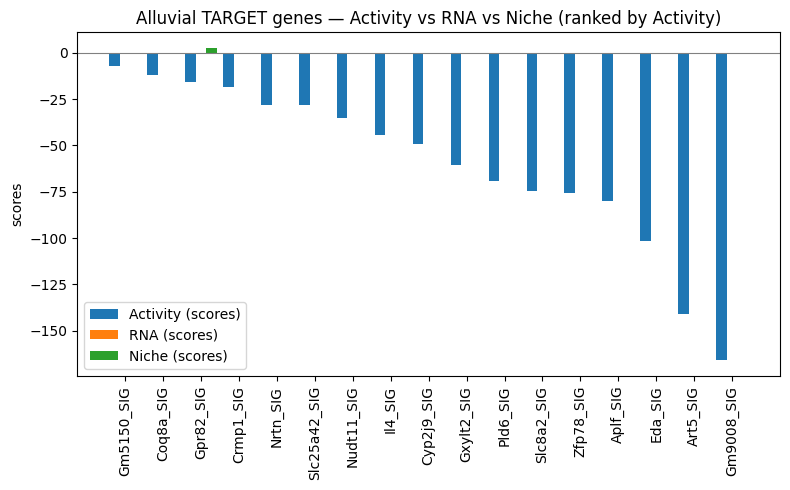

Alluvial_Target_Label Clean_Key  Activity_score  RNA_score  Niche_score
           Gm5150_SIG    GM5150       -7.179514        NaN          NaN
            Coq8a_SIG     COQ8A      -12.073387        NaN          NaN
            Gpr82_SIG     GPR82      -15.829248        NaN     2.693852
            Crmp1_SIG     CRMP1      -18.550592        NaN          NaN
             Nrtn_SIG      NRTN      -28.004988        NaN          NaN
         Slc25a42_SIG  SLC25A42      -28.332186        NaN          NaN
           Nudt11_SIG    NUDT11      -35.024643        NaN          NaN
              Il4_SIG       IL4      -44.416885        NaN          NaN
           Cyp2j9_SIG    CYP2J9      -49.091400        NaN          NaN
           Gxylt2_SIG    GXYLT2      -60.573578        NaN          NaN
             Pld6_SIG      PLD6      -69.411360        NaN          NaN
           Slc8a2_SIG    SLC8A2      -74.630150        NaN          NaN
            Zfp78_SIG     ZFP78      -75.564152        NaN      

In [5]:
# --- 3-bar plot for alluvial TARGETS with ORIGINAL target labels + score table ---
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
from pathlib import Path
from typing import Optional

# -------- Paths --------
RNA_DEG   = Path("../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv")
NICHE_DEG = Path("../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv")
ACTIVITY_DEG = Path("../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv")
EDGES_CSV    = Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251026_194037.csv")

TSCORE_PREFS = ["scores"]  # change if needed

def norm_key(x: str) -> str:
    x = str(x).strip()
    x = re.sub(r"(_SIG|_TF)$", "", x, flags=re.IGNORECASE)
    return x.upper()

def detect_gene_col(df: pd.DataFrame) -> str:
    cand = [c for c in df.columns if c.lower() in {"names","gene","genesymbol","symbol"}]
    return cand[0] if cand else df.columns[0]

def detect_score_col(df: pd.DataFrame) -> Optional[str]:
    cl = {c.lower(): c for c in df.columns}
    for pref in TSCORE_PREFS:
        if pref in cl:
            return cl[pref]
    return None

def load_deg(path: Path, label: str) -> pd.DataFrame:
    df = pd.read_csv(path)
    gcol = detect_gene_col(df)
    scol = detect_score_col(df)
    out = pd.DataFrame({
        "gene_key": df[gcol].astype(str).map(norm_key),
        f"score_{label}": pd.to_numeric(df[scol], errors="coerce") if scol else np.nan
    })
    return out.groupby("gene_key", as_index=False).agg({f"score_{label}": "mean"})

def load_edges_targets_with_labels(path: Path) -> pd.DataFrame:
    e = pd.read_csv(path)
    # find columns
    src = next((c for c in e.columns if c.lower() in {"source","src","from"}), None) \
          or next((c for c in e.columns if "source" in c.lower()), None) \
          or e.columns[0]
    tgt = next((c for c in e.columns if c.lower() in {"target","tgt","to"}), None) \
          or next((c for c in e.columns if "target" in c.lower()), None) \
          or e.columns[1]
    e = e[[tgt]].rename(columns={tgt: "target_raw"}).astype(str)
    e["gene_key"] = e["target_raw"].map(norm_key)

    # keep first seen original name per key so we can display original labels
    first_label = e.drop_duplicates("gene_key")
    return first_label[["gene_key", "target_raw"]].rename(columns={"target_raw": "label_original"})

# -------- Load & merge --------
targets = load_edges_targets_with_labels(EDGES_CSV)      # gene_key + original target label for display
deg_act = load_deg(ACTIVITY_DEG, "Activity")
deg_rna = load_deg(RNA_DEG,      "RNA")
deg_nic = load_deg(NICHE_DEG,    "Niche")

merged = (targets
          .merge(deg_act, on="gene_key", how="left")
          .merge(deg_rna, on="gene_key", how="left")
          .merge(deg_nic, on="gene_key", how="left"))

# keep genes with at least one score present
merged = merged[merged[["score_Activity","score_RNA","score_Niche"]].notna().any(axis=1)].copy()

# rank by Activity (change if you want)
ORDER_BY = "Activity"
rank_key = merged[f"score_{ORDER_BY}"].fillna(-np.inf)
merged = merged.assign(_rank=rank_key).sort_values("_rank", ascending=False).drop(columns="_rank")

# -------- Plot (original size, 3 bars) --------
labels = merged["label_original"].tolist()  # ORIGINAL alluvial target names on x-axis
x = np.arange(len(labels))
width = 0.28

plt.figure(figsize=(max(8, len(labels)*0.35), 5))
plt.bar(x - width, np.nan_to_num(merged["score_Activity"].to_numpy(), nan=0.0),
        width, label="Activity (scores)")
plt.bar(x,         np.nan_to_num(merged["score_RNA"].to_numpy(),      nan=0.0),
        width, label="RNA (scores)")
plt.bar(x + width, np.nan_to_num(merged["score_Niche"].to_numpy(),    nan=0.0),
        width, label="Niche (scores)")

plt.axhline(0, lw=0.8, color="grey")
plt.xticks(x, labels, rotation=90)
plt.ylabel("scores")
plt.title(f"Alluvial TARGET genes — Activity vs RNA vs Niche (ranked by {ORDER_BY})")
plt.legend()
plt.tight_layout()
plt.show()

# -------- Inspect exact values (why “no RNA?” etc.) --------
view_cols = ["label_original", "gene_key", "score_Activity", "score_RNA", "score_Niche"]
summary = merged[view_cols].copy().rename(columns={
    "label_original":"Alluvial_Target_Label",
    "gene_key":"Clean_Key",
    "score_Activity":"Activity_score",
    "score_RNA":"RNA_score",
    "score_Niche":"Niche_score"
})
# sort alike the plot order
print(summary.to_string(index=False))


In [ ]:
../GenKI/GenKI_NB_Tgfbr2_20251025_071826
../GenKI/GenKI_NB_Tgfbr2_SIG_20251025_072936

In [8]:
import os
import re
import pandas as pd
from datetime import datetime

# ========= PATHS (edit if needed) =========
SHAP_CSV     = "../Task2_CMP/capboost_cross_modal_analysis_20251026_092330/capboost_feature_feature_importance_activity_flux_niche.csv"
BIO_NICHE    = "../GenKI/GenKI_NB_Tgfbr2_20251025_071826/ALL_Significant_Genes_Combined.csv"
BIO_ACTIVITY = "../GenKI/GenKI_NB_Tgfbr2_SIG_20251025_123450/ALL_Significant_Genes_Combined.csv"

OUT_DIR = "../Mongoose_post_hoc/"
os.makedirs(OUT_DIR, exist_ok=True)
STAMP   = datetime.now().strftime("%Y%m%d_%H%M%S")
OUT_CSV = os.path.join(OUT_DIR, f"niche_to_activity_shap_edges_with_ranks_clusters45_{STAMP}.csv")

CLUSTERS_TO_KEEP = {0}

# ========= HELPERS =========
def clean_gene(x: str):
    if pd.isna(x): return None
    x = str(x).strip()
    x = re.sub(r"(_SIG|_TF)$", "", x, flags=re.IGNORECASE)
    return x.upper()

def detect_col(df, candidates_exact, candidates_contains=()):
    for c in df.columns:
        if c.lower() in candidates_exact:
            return c
    for c in df.columns:
        cl = c.lower()
        if any(k in cl for k in candidates_contains):
            return c
    return None

def pick_gene_col(df):
    prefer_exact = {"gene","genes","symbol","gene_symbol","names","name"}
    prefer_contains = ("gene","symbol","name")
    c = detect_col(df, prefer_exact, prefer_contains)
    if c: return c
    obj_cols = [c for c in df.columns if df[c].dtype == "O"]
    return obj_cols[0] if obj_cols else df.columns[0]

def pick_rank_col(df):
    # FIXED: Prioritize "rank" over "index" by checking rank first
    # Check for exact "rank" column first
    for c in df.columns:
        if c.lower() == "rank":
            return c
    
    # Then check for other exact matches (excluding "index" to avoid confusion)
    prefer_exact = {"order","position","rnk"}
    c = detect_col(df, prefer_exact, ("order","position"))
    if c: return c
    
    # Check for columns containing "rank" in the name
    for col in df.columns:
        if "rank" in col.lower() and pd.api.types.is_numeric_dtype(df[col]):
            return col
    
    # Only if nothing else found, check other numeric candidates
    for cand in ["dis","score","scores","priority"]:
        for col in df.columns:
            if col.lower()==cand and pd.api.types.is_numeric_dtype(df[col]):
                return col
    
    # Last resort: use row number or first numeric column
    numeric_cols = [c for c in df.columns if pd.api.types.is_numeric_dtype(df[c])]
    return numeric_cols[0] if numeric_cols else None

def load_gene_rank_lookup(path, role="niche"):
    df = pd.read_csv(path)
    gcol = pick_gene_col(df)
    rcol = pick_rank_col(df)
    if gcol is None:
        raise ValueError(f"[{role}] Could not detect gene column in {path}. Columns = {list(df.columns)}")
    if rcol is None:
        rcol = "__ROW_ORDER__"
        df[rcol] = range(1, len(df)+1)

    print(f"[INFO] {role}: Using gene column '{gcol}' and rank column '{rcol}'")

    tmp = df[[gcol, rcol]].copy()
    tmp["gene_clean"] = tmp[gcol].map(clean_gene)
    tmp = tmp.dropna(subset=["gene_clean"])

    with pd.option_context('mode.use_inf_as_na', True):
        tmp[rcol] = pd.to_numeric(tmp[rcol], errors="coerce")
    if not pd.api.types.is_numeric_dtype(tmp[rcol]):
        tmp[rcol] = pd.factorize(tmp[rcol])[0] + 1

    ser = tmp.groupby("gene_clean")[rcol].min().rename(f"{role}_rank")
    return ser.reset_index()

def pick_value_col(shap_df: pd.DataFrame) -> str:
    name_pat = re.compile(r"(shap|feature[_-]?importance|importance|weight|gain)$", re.I)
    cand = [c for c in shap_df.columns if name_pat.search(c)]
    cand = [c for c in cand if pd.api.types.is_numeric_dtype(shap_df[c])]
    if not cand:
        exclude_pat = re.compile(r"(source|target|gene|name|id|idx|rank|cluster)$", re.I)
        cand = [c for c in shap_df.columns
                if pd.api.types.is_numeric_dtype(shap_df[c]) and not exclude_pat.search(c)]
    if not cand:
        raise ValueError("Could not find a numeric SHAP/importance column in the SHAP CSV.")

    def score_col(c):
        has_shap = 0 if re.search(r"shap", c, re.I) else 1
        nunique  = shap_df[c].nunique()
        stdv     = float(shap_df[c].std(skipna=True) or 0.0)
        return (has_shap, -nunique, -stdv)

    cand.sort(key=score_col)
    return cand[0]

def pick_cluster_col(df):
    # common names: Cluster, cluster, cluster_id, cluster_label, etc.
    c = detect_col(df, {"cluster","cluster_id","clusters"}, ("cluster",))
    return c

def to_cluster_num(series):
    # Try numeric directly; if fails, extract first integer from strings like "Cluster 4"
    s = pd.to_numeric(series, errors="coerce")
    if s.notna().any():
        return s
    # extract first integer found per entry
    return series.astype(str).str.extract(r"(\d+)")[0].astype(float)

# ========= LOAD LOOKUPS =========
niche_lookup    = load_gene_rank_lookup(BIO_NICHE,    role="niche")
activity_lookup = load_gene_rank_lookup(BIO_ACTIVITY, role="activity")

print(f"\n[INFO] Loaded {len(niche_lookup)} niche genes with ranks from {min(niche_lookup['niche_rank'])} to {max(niche_lookup['niche_rank'])}")
print(f"[INFO] Loaded {len(activity_lookup)} activity genes with ranks from {min(activity_lookup['activity_rank'])} to {max(activity_lookup['activity_rank'])}")

# ========= READ SHAP, DETECT COLS, FILTER CLUSTERS =========
shap = pd.read_csv(SHAP_CSV)

src_col = detect_col(shap, {"source","src","from","niche","niche_gene"}, ("source","src","from","niche"))
tgt_col = detect_col(shap, {"target","tgt","to","activity","activity_gene"}, ("target","tgt","to","activity"))
cluster_col = pick_cluster_col(shap)

if not all([src_col, tgt_col]):
    raise ValueError(
        f"Could not infer source/target columns. source={src_col}, target={tgt_col}. "
        f"Columns available: {list(shap.columns)}"
    )

# Filter to clusters 4 & 5 if cluster column exists
if cluster_col:
    clusters_num = to_cluster_num(shap[cluster_col])
    shap = shap.loc[clusters_num.isin(CLUSTERS_TO_KEEP)].copy()
    shap["_cluster_num_"] = clusters_num.loc[shap.index]
else:
    print("[WARN] No cluster column detected; proceeding without cluster filter.")

# Now pick the best 'value' column AFTER cluster filtering
val_col = pick_value_col(shap)
shap[val_col] = pd.to_numeric(shap[val_col], errors="coerce")

print(f"[INFO] Using value column: {val_col} | nunique={shap[val_col].nunique()}")

# ========= CLEAN, MERGE RANKS, FILTER =========
cols = [src_col, tgt_col, val_col] + (["_cluster_num_"] if "_cluster_num_" in shap.columns else [])
df = shap[cols].copy()
rename_map = {src_col: "source", tgt_col: "target", val_col: "value"}
if "_cluster_num_" in df.columns:
    rename_map["_cluster_num_"] = "cluster"
df = df.rename(columns=rename_map)

df["source_clean"] = df["source"].map(clean_gene)
df["target_clean"] = df["target"].map(clean_gene)
df = df.dropna(subset=["source_clean","target_clean","value"])

df = df.merge(niche_lookup,    how="left", left_on="source_clean", right_on="gene_clean").drop(columns=["gene_clean"])
df = df.merge(activity_lookup, how="left", left_on="target_clean", right_on="gene_clean").drop(columns=["gene_clean"])

filtered = df[df["niche_rank"].notna() & df["activity_rank"].notna()].copy()
sort_keys = ["value","niche_rank","activity_rank"]
filtered = filtered.sort_values(sort_keys, ascending=[False, True, True]).reset_index(drop=True)

# ========= OUTPUT =========
keep_cols = ["source","target","value","niche_rank","activity_rank"]
if "cluster" in filtered.columns:
    keep_cols.insert(0, "cluster")  # put cluster first for readability
filtered_out = filtered[keep_cols].copy()

filtered_out.to_csv(OUT_CSV, index=False)
print(f"\nSaved: {OUT_CSV}")
print(f"Rows: {len(filtered_out)} | Unique sources: {filtered_out['source'].nunique()} | Unique targets: {filtered_out['target'].nunique()}")
print("\nPreview:")
print(filtered_out.head(20))

[INFO] niche: Using gene column 'Unnamed: 0' and rank column 'rank'
[INFO] activity: Using gene column 'Unnamed: 0' and rank column 'rank'

[INFO] Loaded 111 niche genes with ranks from 1 to 111
[INFO] Loaded 90 activity genes with ranks from 1 to 90
[INFO] Using value column: Value | nunique=4913

Saved: ../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251026_194538.csv
Rows: 0 | Unique sources: 0 | Unique targets: 0

Preview:
Empty DataFrame
Columns: [cluster, source, target, value, niche_rank, activity_rank]
Index: []


In [10]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from matplotlib import cm, colors as mpl_colors
from pathlib import Path

# ====== OPTIONS ======
CSV_PATH    = Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251026_194538.csv")
CLUSTERS    = None          # e.g., {0} or None
MIN_WEIGHT  = 0.1         # try 0.8 (few edges), 0.5, 0.3, etc.
TOP_N_EDGES = None          # e.g., 60 or None
TITLE       = "Alluvial (Sankey): Source → Target (rank-ordered, rank-colored)"
OUT_HTML    = "alluvial_rankordered_legend.html"
# =====================

def to_hex(v01, cmap="Oranges"):
    rgba = cm.get_cmap(cmap)(float(np.clip(v01, 0, 1)))
    return mpl_colors.to_hex(rgba)

# ---- Load ----
df = pd.read_csv(CSV_PATH)
req = {"cluster","source","target","value","niche_rank","activity_rank"}
missing = req - set(df.columns)
if missing:
    raise ValueError(f"Missing columns: {missing}")

if CLUSTERS is not None:
    df = df[df["cluster"].isin(CLUSTERS)].copy()

for c in ["value","niche_rank","activity_rank"]:
    df[c] = pd.to_numeric(df[c], errors="coerce")
df = df.dropna(subset=["source","target","value"])

# ---- Aggregate edges & filter ----
edges = (df.groupby(["source","target"], as_index=False)["value"].sum()
           .sort_values("value", ascending=False))
edges = edges[edges["value"] >= MIN_WEIGHT]
if TOP_N_EDGES:
    edges = edges.head(TOP_N_EDGES)
if edges.empty:
    raise SystemExit("No edges left — lower MIN_WEIGHT or adjust CLUSTERS.")

# ---- Best (smallest) per-node ranks ----
src_best = df.groupby("source")["niche_rank"].min()          # sources (left)
tgt_best = df.groupby("target")["activity_rank"].min()       # targets (right)

# ---- Order nodes darkest→light (best rank→worst) per side ----
def order_by_rank(names, best_series):
    recs = []
    for n in names:
        r = best_series.get(n, np.inf)       # missing ranks go to bottom
        recs.append((n, r))
    recs.sort(key=lambda t: (not np.isfinite(t[1]), t[1]))   # finite ranks first, ascending
    ordered_names  = [n for n, _ in recs]
    ordered_ranks  = [r if np.isfinite(r) else np.nan for _, r in recs]
    return ordered_names, ordered_ranks

unique_sources_raw = edges["source"].astype(str).unique()
unique_targets_raw = edges["target"].astype(str).unique()

ordered_sources, src_ranks_used = order_by_rank(unique_sources_raw, src_best)
ordered_targets, tgt_ranks_used = order_by_rank(unique_targets_raw, tgt_best)

# Re-map edges to the new node order
nodes = ordered_sources + ordered_targets
node_idx = {n: i for i, n in enumerate(nodes)}
edges_sorted = edges.copy()
edges_sorted["source_idx"] = edges_sorted["source"].astype(str).map(node_idx)
edges_sorted["target_idx"] = edges_sorted["target"].astype(str).map(node_idx)
edges_sorted = edges_sorted.sort_values(["source_idx","target_idx"])

link_source = edges_sorted["source_idx"].tolist()
link_target = edges_sorted["target_idx"].tolist()
link_value  = edges_sorted["value"].astype(float).tolist()

# ---- Colors from ranks (smaller rank = darker), normalized per side ----
def side_colors(names, ranks, cmap):
    arr = np.array(ranks, dtype=float)
    finite = np.isfinite(arr)
    if finite.any():
        rmin, rmax = np.nanmin(arr[finite]), np.nanmax(arr[finite])
        span = (rmax - rmin) if rmax != rmin else 1.0
        v01  = np.where(finite, (rmax - arr) / span, np.nan)   # 0..1 (best rank -> 1)
        v01  = np.nan_to_num(v01, nan=0.15)                    # missing -> light
        v01  = 0.15 + 0.85 * v01                               # visible range
    else:
        v01 = np.full(len(names), 0.4)                         # fallback
    return [to_hex(v, cmap) for v in v01], v01

src_colors, _ = side_colors(ordered_sources, src_ranks_used, "Oranges")
tgt_colors, _ = side_colors(ordered_targets, tgt_ranks_used, "Blues")
node_colors   = src_colors + tgt_colors

# ---- Node hover text with ranks ----
node_hover = []
for n, rk in zip(ordered_sources, src_ranks_used):
    node_hover.append(f"{n}<br>niche_rank: {rk:.0f}" if np.isfinite(rk) else f"{n}<br>niche_rank: NA")
for n, rk in zip(ordered_targets, tgt_ranks_used):
    node_hover.append(f"{n}<br>activity_rank: {rk:.0f}" if np.isfinite(rk) else f"{n}<br>activity_rank: NA")

# ---- Sankey ----
fig = go.Figure()

fig.add_trace(go.Sankey(
    arrangement="snap",   # respect our node ordering
    node=dict(
        pad=14, thickness=18, line=dict(color="black", width=0.5),
        label=nodes, color=node_colors,
        customdata=node_hover, hovertemplate="%{customdata}<extra></extra>",
    ),
    link=dict(
        source=link_source, target=link_target, value=link_value,
        color=["rgba(120,120,120,0.35)"] * len(link_value),
        hovertemplate="Source: %{source.label}<br>Target: %{target.label}"
                      "<br>Weight: %{value:.3g}<extra></extra>",
    )
))

# ---- Colorbar legends (reversed so rank 1 is darkest; start scale at 1) ----
def add_colorbar(fig, cmin, cmax, colorscale, title, x=1.02):
    cmin = 1 if np.isfinite(cmin) else 1
    if not np.isfinite(cmax) or cmax < cmin:
        cmax = cmin + 1
    fig.add_trace(go.Scatter(
        x=[None], y=[None], mode="markers",
        marker=dict(
            size=0.1,
            color=[cmin],
            cmin=cmin, cmax=cmax,
            colorscale=colorscale,
            reversescale=True,      # <<< lower rank (1) = darker on the legend
            showscale=True,
            colorbar=dict(
                title=title,
                x=x, xanchor="left",
                len=0.8, thickness=14,
                outlinewidth=0.5
            ),
        ),
        hoverinfo="skip",
        showlegend=False,
    ))

# Compute rank ranges, force legend to start at 1
src_finite = np.array([r for r in src_ranks_used if np.isfinite(r)])
tgt_finite = np.array([r for r in tgt_ranks_used if np.isfinite(r)])
src_min, src_max = (float(src_finite.min()), float(src_finite.max())) if src_finite.size else (1, 1)
tgt_min, tgt_max = (float(tgt_finite.min()), float(tgt_finite.max())) if tgt_finite.size else (1, 1)

add_colorbar(fig, src_min, src_max, "Oranges", "niche_rank",    x=1.02)
add_colorbar(fig, tgt_min, tgt_max, "Blues",   "activity_rank", x=1.10)

fig.update_layout(
    title=TITLE, font_size=11,
    height=740, width=1200,
    margin=dict(l=10, r=120, t=60, b=10)  # extra right margin for the two colorbars
)

fig.show()
fig.write_html(OUT_HTML, include_plotlyjs="cdn")
print(f"✓ Saved {OUT_HTML} | Sources: {len(ordered_sources)} | Targets: {len(ordered_targets)} | Edges: {len(edges_sorted)}")


SystemExit: No edges left — lower MIN_WEIGHT or adjust CLUSTERS.

/home/ggavriilidis/.conda/envs/uni_dev/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3558: UserWarning:

To exit: use 'exit', 'quit', or Ctrl-D.



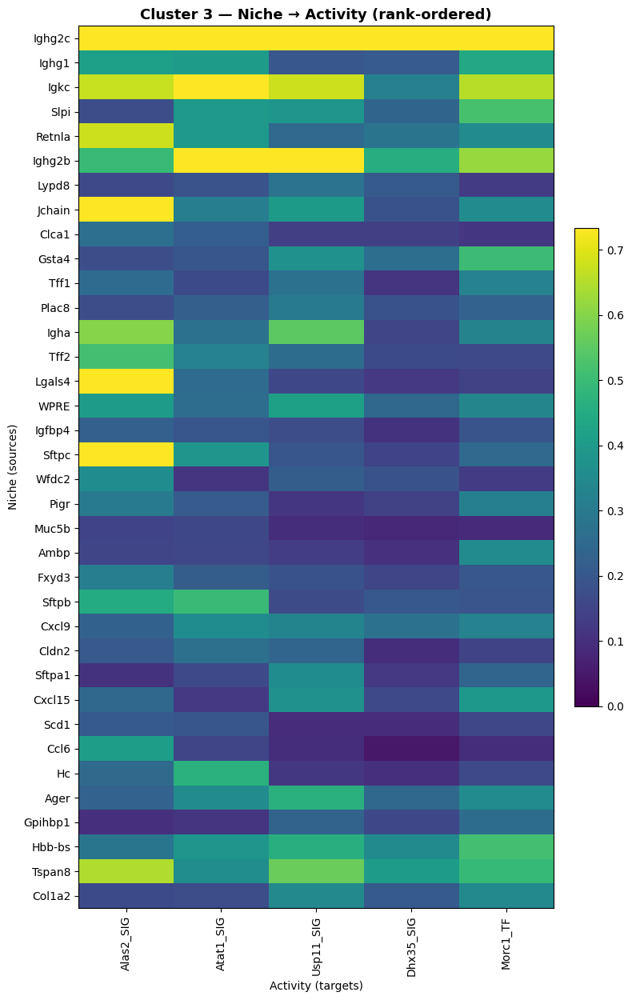

['../Mongoose_post_hoc/heatmaps_from_csv/heatmap_cluster3.png']

In [12]:
# Visualize the uploaded CSV as rank-ordered heatmaps (per cluster) and a differential heatmap (if two clusters exist)
# - Uses matplotlib only (as requested by the tools policy).
# - Saves outputs to /mnt/data and also displays them inline.
#
# Path provided by you:
CSV_PATH = "../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251025_202530.csv"

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

OUTDIR = Path("../Mongoose_post_hoc/heatmaps_from_csv")
OUTDIR.mkdir(parents=True, exist_ok=True)

# ------- Load
df = pd.read_csv(CSV_PATH)

# ------- Basic normalization of column names (lowercase) and checks
df.columns = [c.strip().lower() for c in df.columns]
required = {"cluster","source","target","value","niche_rank","activity_rank"}
missing = required - set(df.columns)
if missing:
    raise SystemExit(f"Missing columns in CSV: {missing}")

# ------- Coerce numeric
for c in ["value","niche_rank","activity_rank","cluster"]:
    df[c] = pd.to_numeric(df[c], errors="coerce")
df = df.dropna(subset=["source","target","value","cluster"])

# ------- Keep only NICHE->ACTIVITY if a direction column exists
if "direction" in df.columns:
    mask = df["direction"].str.upper().str.replace(" ", "") == "NICHE->ACTIVITY"
    # Allow fallback if direction column exists but nothing matches exactly
    df_sub = df[mask].copy()
    if df_sub.empty:
        df_sub = df.copy()
else:
    df_sub = df.copy()

# ------- Aggregate edges within cluster
edges = (
    df_sub.groupby(["cluster","source","target"], as_index=False)["value"]
    .sum()
    .sort_values("value", ascending=False)
)

if edges.empty:
    raise SystemExit("No edges present after filtering/aggregation.")

# ------- Rank-based ordering (lower rank = earlier)
src_best = df_sub.groupby("source", as_index=True)["niche_rank"].min()
tgt_best = df_sub.groupby("target", as_index=True)["activity_rank"].min()

def order_by_rank(names, best_series):
    recs = []
    for n in names:
        r = best_series.get(n, np.nan)
        recs.append((n, r))
    recs.sort(key=lambda t: (not np.isfinite(t[1]), t[1], str(t[0]).lower()))
    return [n for n, _ in recs]

clusters_present = sorted(edges["cluster"].unique().tolist())
all_sources = order_by_rank(edges["source"].unique().tolist(), src_best)
all_targets = order_by_rank(edges["target"].unique().tolist(), tgt_best)

def cluster_matrix(c):
    sub = edges[edges["cluster"] == c]
    mat = pd.DataFrame(0.0, index=all_sources, columns=all_targets)
    for _, row in sub.iterrows():
        mat.loc[row["source"], row["target"]] = float(row["value"])
    return mat

mats = {c: cluster_matrix(c) for c in clusters_present}

# ------- Plot helper (matplotlib only; one chart per figure)
def plot_heatmap(matrix: pd.DataFrame, title: str, outpath: Path, vmin=None, vmax=None, center=None, cmap=None):
    plt.figure(figsize=(max(8, matrix.shape[1]*0.35), max(6, matrix.shape[0]*0.35)))
    # If center is provided, use TwoSlopeNorm to center the colormap at 0
    norm = None
    if center is not None:
        from matplotlib.colors import TwoSlopeNorm
        vmin = vmin if vmin is not None else float(np.nanmin(matrix.values))
        vmax = vmax if vmax is not None else float(np.nanmax(matrix.values))
        # ensure symmetric if not set
        max_abs = max(abs(vmin), abs(vmax))
        vmin, vmax = -max_abs, max_abs
        norm = TwoSlopeNorm(vmin=vmin, vcenter=center, vmax=vmax)

    im = plt.imshow(matrix.values, aspect='auto', interpolation='nearest',
                    vmin=vmin, vmax=vmax, cmap=cmap, norm=norm)
    plt.colorbar(im, fraction=0.046, pad=0.04)
    plt.title(title, fontsize=13, fontweight='bold')
    plt.xticks(ticks=np.arange(matrix.shape[1]), labels=matrix.columns, rotation=90)
    plt.yticks(ticks=np.arange(matrix.shape[0]), labels=matrix.index)
    plt.xlabel("Activity (targets)")
    plt.ylabel("Niche (sources)")
    plt.tight_layout()
    plt.savefig(outpath, dpi=300, bbox_inches="tight")
    plt.show()

# ------- Per-cluster heatmaps
saved_files = []
for c, mat in mats.items():
    out_png = OUTDIR / f"heatmap_cluster{int(c)}.png"
    # cap vmax for comparable scaling across clusters (p95)
    vmax = float(np.nanpercentile(mat.values, 95)) if np.isfinite(mat.values).any() else None
    plot_heatmap(mat, f"Cluster {int(c)} — Niche → Activity (rank-ordered)",
                 out_png, vmin=0, vmax=vmax, center=None, cmap="viridis")
    saved_files.append(str(out_png))
    # also export matrix
    mat.to_csv(OUTDIR / f"matrix_cluster{int(c)}.csv")

# ------- Differential heatmap (if at least two clusters)
if len(clusters_present) >= 2:
    # choose two clusters deterministically (first two in ascending order)
    cA, cB = clusters_present[:2]
    diff_mat = mats[cA] - mats[cB]
    out_png = OUTDIR / f"heatmap_diff_C{int(cA)}_minus_C{int(cB)}.png"
    plot_heatmap(diff_mat, f"Differential (Cluster {int(cA)} − Cluster {int(cB)}) — Niche → Activity",
                 out_png, vmin=None, vmax=None, center=0.0, cmap="RdBu_r")
    saved_files.append(str(out_png))
    diff_mat.to_csv(OUTDIR / f"matrix_diff_C{int(cA)}_minus_C{int(cB)}.csv")

saved_files


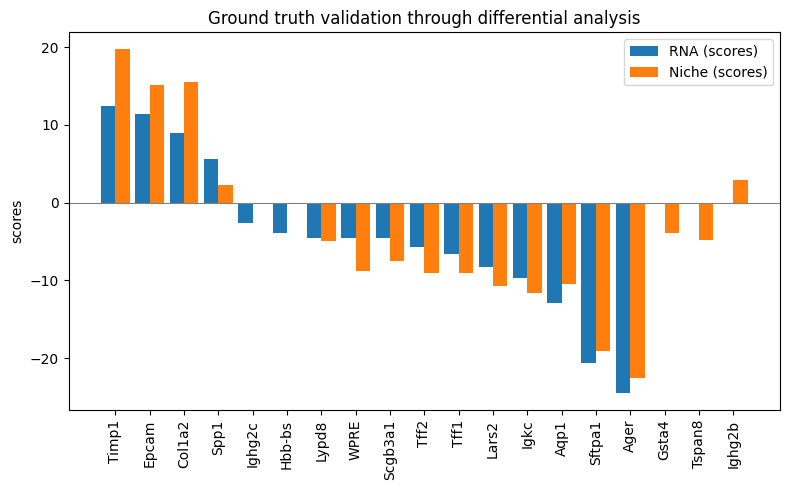

In [71]:
# --- RNA vs Niche barplot, original size + ranked ---
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

# ---- paths ----
RNA_DEG   = Path("../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv")
NICHE_DEG = Path("../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv")
EDGES_CSV = Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251025_075557.csv")

# ---- ranking rule ----
# options: "RNA", "Niche", "mean", "sum", "absmax"
ORDER_BY = "RNA"

def detect_gene_col(df: pd.DataFrame) -> str:
    for c in df.columns:
        if c.lower() in {"names","gene","genesymbol","symbol"}:
            return c
    return df.columns[0]

def load_deg_scores(path: Path) -> pd.DataFrame:
    df = pd.read_csv(path)
    gcol = detect_gene_col(df)
    scol = "scores" if "scores" in df.columns else df.columns[1]
    out = df[[gcol, scol]].copy()
    out.columns = ["gene", "score"]
    out["gene"]  = out["gene"].astype(str)
    out["score"] = pd.to_numeric(out["score"], errors="coerce")
    return out

def load_edges(path: Path) -> pd.DataFrame:
    e = pd.read_csv(path)
    src = next((c for c in e.columns if c.lower() in {"source","src","from"}), e.columns[0])
    tgt = next((c for c in e.columns if c.lower() in {"target","tgt","to"}),    e.columns[1])
    return e[[src, tgt]].rename(columns={src:"source", tgt:"target"}).astype(str)

# ---- load & merge ----
rna_deg   = load_deg_scores(RNA_DEG)
niche_deg = load_deg_scores(NICHE_DEG)
edges     = load_edges(EDGES_CSV)

alluvial_genes = pd.unique(pd.concat([edges["source"], edges["target"]], ignore_index=True))

merged = (pd.DataFrame({"gene": alluvial_genes})
          .merge(rna_deg.rename(columns={"score":"RNA"}),   on="gene", how="left")
          .merge(niche_deg.rename(columns={"score":"Niche"}), on="gene", how="left"))

# keep genes with at least one score
merged = merged[merged[["RNA","Niche"]].notna().any(axis=1)].copy()

# ---- compute ordering key (ranking) ----
if ORDER_BY == "RNA":
    key = merged["RNA"].fillna(-np.inf)
elif ORDER_BY == "Niche":
    key = merged["Niche"].fillna(-np.inf)
elif ORDER_BY == "mean":
    key = merged[["RNA","Niche"]].mean(axis=1, skipna=True)
elif ORDER_BY == "sum":
    key = merged[["RNA","Niche"]].sum(axis=1, skipna=True)
elif ORDER_BY == "absmax":
    key = merged[["RNA","Niche"]].abs().max(axis=1, skipna=True)
else:
    key = merged["RNA"].fillna(-np.inf)

merged = merged.assign(_rank=key).sort_values("_rank", ascending=False).drop(columns="_rank")

# ---- plot: original size & bar width ----
genes = merged["gene"].tolist()
x = np.arange(len(genes))
width = 0.42  # original bar width

plt.figure(figsize=(max(8, len(genes)*0.35), 5))  # original sizing
plt.bar(x - width/2, np.nan_to_num(merged["RNA"].to_numpy(),   nan=0.0), width, label="RNA (scores)")
plt.bar(x + width/2, np.nan_to_num(merged["Niche"].to_numpy(), nan=0.0), width, label="Niche (scores)")

plt.axhline(0, lw=0.8, color="grey")
plt.xticks(x, genes, rotation=90)
plt.ylabel("scores")
plt.title("Ground truth validation through differential analysis")
plt.legend()
plt.tight_layout()
plt.show()


## Metabolite test

## KP1_1

In [18]:
import pandas as pd
import re

# Paths
capboost_path = "../Task2_CMP/capboost_cross_modal_analysis_20251024_092343/capboost_feature_feature_importance_activity_flux_niche.csv"
sources_path  = "../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251025_201823.csv"
out_path      = "../Mongoose_post_hoc/cluster3_niche_to_flux_for_sources_from_second_csv_KP11.csv"

# Load data
capboost   = pd.read_csv(capboost_path)
sources_df = pd.read_csv(sources_path)

# ---- Helpers ----
def is_niche_to_flux(direction_value: str) -> bool:
    if not isinstance(direction_value, str):
        return False
    s = direction_value.strip().lower()
    # Accept "Niche→Flux", "Niche->Flux", "niche_to_flux", "niche2flux", etc.
    patterns = [
        r"^niche\s*[\u2192>\-to]*\s*flux$",
        r"^niche.*flux$"
    ]
    for p in patterns:
        if re.match(p, s):
            return True
    return ('niche' in s) and ('flux' in s) and (s.find('niche') < s.find('flux'))

def to_int_or_nan(x):
    try:
        return int(str(x).strip())
    except:
        return pd.NA

# ---- Prepare capboost ----
capboost['Cluster_std']   = capboost['Cluster'].apply(to_int_or_nan)
capboost['Direction_std'] = capboost['Direction'].astype(str)

# Filter capboost: Cluster 3 & Niche→Flux
mask_cluster3 = capboost['Cluster_std'] == 0
mask_n2f      = capboost['Direction_std'].apply(is_niche_to_flux)

# ---- Get source genes from the second CSV (keep exact strings, keep _SIG/_TF) ----
if 'source' not in sources_df.columns:
    raise ValueError("Second CSV must contain a 'source' column.")

source_genes = set(sources_df['source'].dropna().astype(str).unique())
mask_sources = capboost['Source'].astype(str).isin(source_genes)

filtered = capboost.loc[mask_cluster3 & mask_n2f & mask_sources,
                        ['Cluster', 'Direction', 'Source', 'Target', 'Value']].copy()

# Ensure numeric Value for sorting
filtered['Value_num'] = pd.to_numeric(filtered['Value'], errors='coerce')
filtered = filtered.dropna(subset=['Value_num'])
filtered = filtered.sort_values(by='Value_num', ascending=False).drop(columns=['Value_num'])

# ---- Bring in niche_rank per source from the second CSV ----
# If there are multiple rows per source in the second CSV, take the BEST (smallest) niche_rank.
if 'niche_rank' in sources_df.columns:
    src_rank = (sources_df[['source', 'niche_rank']]
                .dropna(subset=['source'])
                .copy())
    src_rank['niche_rank'] = pd.to_numeric(src_rank['niche_rank'], errors='coerce')
    src_rank = (src_rank
                .dropna(subset=['niche_rank'])
                .groupby('source', as_index=False)['niche_rank'].min())
    src_rank = src_rank.rename(columns={'source': 'Source'})
    # Merge onto filtered edges
    filtered = filtered.merge(src_rank, on='Source', how='left')
else:
    # If the column doesn't exist, still proceed but without rank
    filtered['niche_rank'] = pd.NA

# Save
filtered.to_csv(out_path, index=False)

print(f"Saved: {out_path}")
print(f"Rows: {len(filtered)} | Unique sources: {filtered['Source'].nunique()} | Unique targets: {filtered['Target'].nunique()}")
print(filtered.head(10))


Saved: ../Mongoose_post_hoc/cluster3_niche_to_flux_for_sources_from_second_csv_KP11.csv
Rows: 1550 | Unique sources: 31 | Unique targets: 50
   Cluster      Direction  Source                          Target  Value  \
0        0  NICHE -> FLUX  Ighg2c                     Chondroitin    1.0   
1        0  NICHE -> FLUX  Ighg2b                        Tyrosine    1.0   
2        0  NICHE -> FLUX   Gsta4  (Glc)3 (GlcNAc)2 (Man)9 (Asn)1    1.0   
3        0  NICHE -> FLUX   Gsta4                         Citrate    1.0   
4        0  NICHE -> FLUX  Ighg2b                      Isoleucine    1.0   
5        0  NICHE -> FLUX  Ighg2b                       Glutamate    1.0   
6        0  NICHE -> FLUX  Ighg2c                     Glutathione    1.0   
7        0  NICHE -> FLUX  Ighg2b                       B-Alanine    1.0   
8        0  NICHE -> FLUX  Ighg2c                            dCMP    1.0   
9        0  NICHE -> FLUX   Ighg1                    Oxaloacetate    1.0   

   niche_rank  
0     

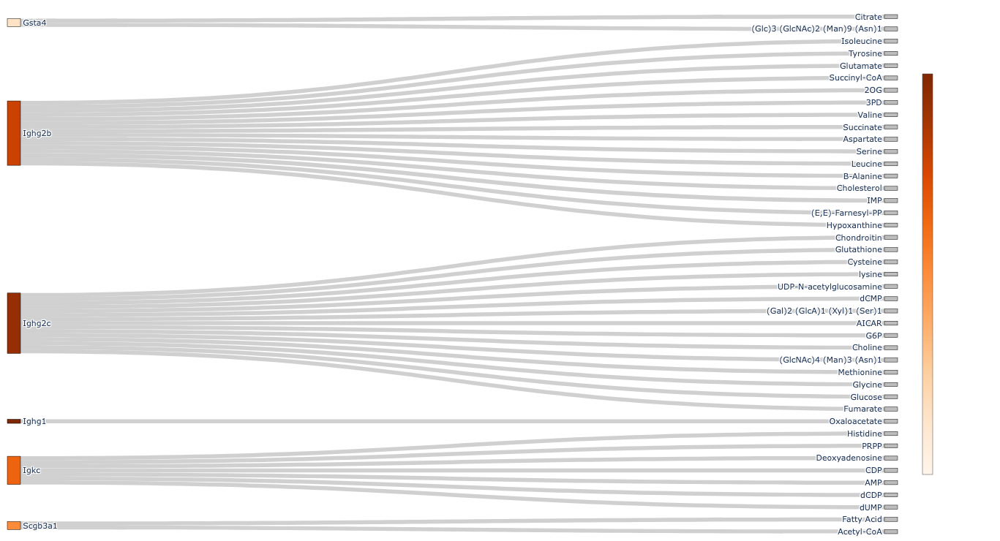

✓ Saved alluvial_cluster3_niche_to_flux.html | Sources: 6 | Targets: 43 | Edges: 43


In [43]:
#!/usr/bin/env python3
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from matplotlib import cm, colors as mpl_colors
from pathlib import Path
import re

# ========= USER OPTIONS =========
CSV_PATH     = Path("../Mongoose_post_hoc/cluster3_niche_to_flux_for_sources_from_second_csv_KP11.csv")
MIN_WEIGHT   = 1
TOP_N_EDGES  = None
USE_ABS      = False
STRICT_GT    = False
OUT_HTML     = "alluvial_cluster3_niche_to_flux.html"

FLUX_NODE_COLOR = "#bdbdbd"
LINK_COLOR_RGBA = "rgba(120,120,120,0.35)"
SOURCE_CMAP     = "Oranges"
# =================================

def to_hex(v01, cmap=SOURCE_CMAP):
    rgba = cm.get_cmap(cmap)(float(np.clip(v01, 0, 1)))
    return mpl_colors.to_hex(rgba)

def smart_read_csv(path: Path) -> pd.DataFrame:
    try:
        return pd.read_csv(path)
    except Exception:
        if path.suffix.lower() != ".csv":
            return pd.read_csv(path.with_suffix(".csv"))
        raise

def is_niche_to_flux(s: str) -> bool:
    s = str(s).strip().lower()
    return bool(s) and ("niche" in s) and ("flux" in s) and (s.find("niche") < s.find("flux"))

# ---- Load & checks ----
df = smart_read_csv(CSV_PATH).copy()
req = {"Cluster","Direction","Source","Target","Value","niche_rank"}
missing = req - set(df.columns)
if missing:
    raise ValueError(f"Missing columns: {missing}")

df["Value"] = pd.to_numeric(df["Value"], errors="coerce")
df["niche_rank"] = pd.to_numeric(df["niche_rank"], errors="coerce")
df = df.dropna(subset=["Source","Target","Value"])
df = df[df["Direction"].apply(is_niche_to_flux)].copy()

# ---- Aggregate and threshold ----
edges = (df.groupby(["Source","Target"], as_index=False)["Value"].sum()
           .sort_values("Value", ascending=False))

if USE_ABS:
    edges = edges[edges["Value"].abs() > MIN_WEIGHT] if STRICT_GT else edges[edges["Value"].abs() >= MIN_WEIGHT]
else:
    edges = edges[edges["Value"] > MIN_WEIGHT] if STRICT_GT else edges[edges["Value"] >= MIN_WEIGHT]

if TOP_N_EDGES:
    edges = edges.head(TOP_N_EDGES)
if edges.empty:
    raise SystemExit("No edges left — adjust thresholds.")

# ---- Per-source rank (color) & strength (hover) ----
src_rank = (df.groupby("Source", as_index=False)["niche_rank"].min()
              .rename(columns={"niche_rank":"niche_rank_src"}))
src_strength = edges.groupby("Source", as_index=False)["Value"].sum().rename(columns={"Value":"total_out"})

sources = edges["Source"].astype(str).unique().tolist()
targets = edges["Target"].astype(str).unique().tolist()
nodes   = sources + targets
node_idx = {n: i for i, n in enumerate(nodes)}

edges_sorted = edges.copy()
edges_sorted["source_idx"] = edges_sorted["Source"].astype(str).map(node_idx)
edges_sorted["target_idx"] = edges_sorted["Target"].astype(str).map(node_idx)
edges_sorted = edges_sorted.sort_values(["source_idx","target_idx"])

link_source = edges_sorted["source_idx"].tolist()
link_target = edges_sorted["target_idx"].tolist()
link_value  = edges_sorted["Value"].astype(float).tolist()

# ---- Source node colors from niche_rank (smaller rank = darker) ----
src_df = pd.DataFrame({"Source": sources}).merge(src_rank, on="Source", how="left").merge(src_strength, on="Source", how="left")
r = src_df["niche_rank_src"].to_numpy(dtype=float)
finite = np.isfinite(r)
if finite.any():
    rmin, rmax = np.nanmin(r[finite]), np.nanmax(r[finite])
    span = (rmax - rmin) if rmax != rmin else 1.0
    v01  = np.where(finite, (rmax - r) / span, np.nan)  # invert so smaller rank -> darker
    v01  = np.nan_to_num(v01, nan=0.15)
    v01  = 0.15 + 0.85 * v01
else:
    v01 = np.full(len(sources), 0.4)

source_colors = [to_hex(v, SOURCE_CMAP) for v in v01]
target_colors = [FLUX_NODE_COLOR] * len(targets)
node_colors   = source_colors + target_colors

# ---- Node hover text ----
src_hover = []
for name, rk, tout in zip(sources, src_df["niche_rank_src"].to_numpy(), src_df["total_out"].to_numpy(dtype=float)):
    h = f"{name}<br>niche_rank (best): " + (f"{rk:.0f}" if np.isfinite(rk) else "NA")
    h += f"<br>Σ outgoing weight: {tout:.3g}" if np.isfinite(tout) else "<br>Σ outgoing weight: NA"
    src_hover.append(h)
tgt_strength = edges.groupby("Target")["Value"].sum()
tgt_hover = [f"{name}<br>Σ incoming weight: {float(tgt_strength.get(name,0.0)):.3g}" for name in targets]
node_hover = src_hover + tgt_hover

# ---- Plot ----
fig = go.Figure()
fig.add_trace(go.Sankey(
    arrangement="snap",
    node=dict(
        pad=14, thickness=18, line=dict(color="black", width=0.5),
        label=nodes, color=node_colors,
        customdata=node_hover, hovertemplate="%{customdata}<extra></extra>",
    ),
    link=dict(
        source=link_source, target=link_target, value=link_value,
        color=[LINK_COLOR_RGBA]*len(link_value),
        hovertemplate="Source: %{source.label}<br>Target: %{target.label}<br>Weight: %{value:.3g}<extra></extra>",
    )
))

# ---- Colorbar (darker on TOP, lighter below) and NO ticks/title ----
if finite.any():
    cmin, cmax = float(rmin), float(rmax)
    if cmax <= cmin: cmax = cmin + 1.0
    fig.add_trace(go.Scatter(
        x=[None], y=[None], mode="markers",
        marker=dict(
            size=0.1, color=[cmin],
            cmin=cmin, cmax=cmax,
            colorscale=SOURCE_CMAP,
            reversescale=False,              # <<< darker at top, lighter below
            showscale=True,
            colorbar=dict(
                title='',                    # remove title
                ticks='',                    # hide tick marks
                tickmode='array',            # no ticks/labels
                tickvals=[], ticktext=[],
                outlinewidth=0.5,
                x=1.02, xanchor="left",
                len=0.8, thickness=14,
            ),
        ),
        hoverinfo="skip", showlegend=False,
    ))

# ---- Layout: no title and hide axes ----
fig.update_layout(
    title=None,               # remove plot title
    font_size=11,
    height=740, width=1200,
    margin=dict(l=10, r=140, t=20, b=10),
    plot_bgcolor="white",
)

# hide any visible axes (some renderers show them)
fig.update_xaxes(visible=False, showgrid=False, zeroline=False)
fig.update_yaxes(visible=False, showgrid=False, zeroline=False)

fig.show()
fig.write_html(OUT_HTML, include_plotlyjs="cdn")
print(f"✓ Saved {OUT_HTML} | Sources: {len(sources)} | Targets: {len(targets)} | Edges: {len(edges_sorted)}")


## Periphery

In [11]:
import pandas as pd
import re

# Paths
capboost_path = "../Task2_CMP/capboost_cross_modal_analysis_20251024_092343/capboost_feature_feature_importance_activity_flux_niche.csv"
sources_path  = "../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251025_202530.csv"
out_path      = "../Mongoose_post_hoc/cluster3_niche_to_flux_for_sources_from_second_csv.csv"

# Load data
capboost   = pd.read_csv(capboost_path)
sources_df = pd.read_csv(sources_path)

# ---- Helpers ----
def is_niche_to_flux(direction_value: str) -> bool:
    if not isinstance(direction_value, str):
        return False
    s = direction_value.strip().lower()
    # Accept "Niche→Flux", "Niche->Flux", "niche_to_flux", "niche2flux", etc.
    patterns = [
        r"^niche\s*[\u2192>\-to]*\s*flux$",
        r"^niche.*flux$"
    ]
    for p in patterns:
        if re.match(p, s):
            return True
    return ('niche' in s) and ('flux' in s) and (s.find('niche') < s.find('flux'))

def to_int_or_nan(x):
    try:
        return int(str(x).strip())
    except:
        return pd.NA

# ---- Prepare capboost ----
capboost['Cluster_std']   = capboost['Cluster'].apply(to_int_or_nan)
capboost['Direction_std'] = capboost['Direction'].astype(str)

# Filter capboost: Cluster 3 & Niche→Flux
mask_cluster3 = capboost['Cluster_std'] == 3
mask_n2f      = capboost['Direction_std'].apply(is_niche_to_flux)

# ---- Get source genes from the second CSV (keep exact strings, keep _SIG/_TF) ----
if 'source' not in sources_df.columns:
    raise ValueError("Second CSV must contain a 'source' column.")

source_genes = set(sources_df['source'].dropna().astype(str).unique())
mask_sources = capboost['Source'].astype(str).isin(source_genes)

filtered = capboost.loc[mask_cluster3 & mask_n2f & mask_sources,
                        ['Cluster', 'Direction', 'Source', 'Target', 'Value']].copy()

# Ensure numeric Value for sorting
filtered['Value_num'] = pd.to_numeric(filtered['Value'], errors='coerce')
filtered = filtered.dropna(subset=['Value_num'])
filtered = filtered.sort_values(by='Value_num', ascending=False).drop(columns=['Value_num'])

# ---- Bring in niche_rank per source from the second CSV ----
# If there are multiple rows per source in the second CSV, take the BEST (smallest) niche_rank.
if 'niche_rank' in sources_df.columns:
    src_rank = (sources_df[['source', 'niche_rank']]
                .dropna(subset=['source'])
                .copy())
    src_rank['niche_rank'] = pd.to_numeric(src_rank['niche_rank'], errors='coerce')
    src_rank = (src_rank
                .dropna(subset=['niche_rank'])
                .groupby('source', as_index=False)['niche_rank'].min())
    src_rank = src_rank.rename(columns={'source': 'Source'})
    # Merge onto filtered edges
    filtered = filtered.merge(src_rank, on='Source', how='left')
else:
    # If the column doesn't exist, still proceed but without rank
    filtered['niche_rank'] = pd.NA

# Save
filtered.to_csv(out_path, index=False)

print(f"Saved: {out_path}")
print(f"Rows: {len(filtered)} | Unique sources: {filtered['Source'].nunique()} | Unique targets: {filtered['Target'].nunique()}")
print(filtered.head(10))


Saved: ../Mongoose_post_hoc/cluster3_niche_to_flux_for_sources_from_second_csv.csv
Rows: 1800 | Unique sources: 36 | Unique targets: 50
   Cluster      Direction  Source       Target  Value  niche_rank
0        3  NICHE -> FLUX  Ighg2c  Glutathione    1.0         2.0
1        3  NICHE -> FLUX  Ighg2b     Tyrosine    1.0         8.0
2        3  NICHE -> FLUX  Ighg2b   Isoleucine    1.0         8.0
3        3  NICHE -> FLUX   Gsta4      Citrate    1.0        16.0
4        3  NICHE -> FLUX  Ighg2b    Glutamate    1.0         8.0
5        3  NICHE -> FLUX  Ighg2c  Chondroitin    1.0         2.0
6        3  NICHE -> FLUX    Igkc         dUMP    1.0         5.0
7        3  NICHE -> FLUX  Ighg2b          2OG    1.0         8.0
8        3  NICHE -> FLUX  Ighg2c       lysine    1.0         2.0
9        3  NICHE -> FLUX    Igkc          CDP    1.0         5.0


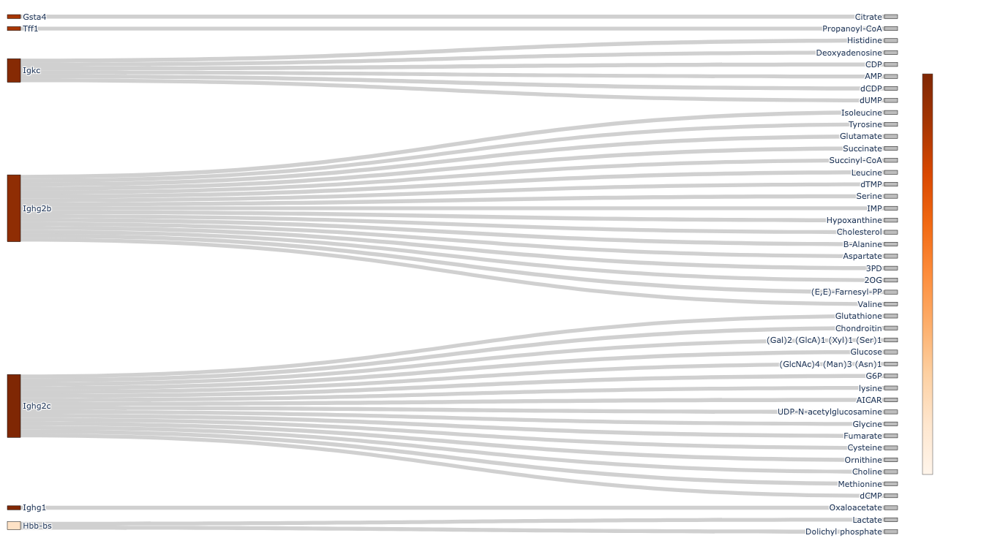

✓ Saved alluvial_cluster3_niche_to_flux.html | Sources: 7 | Targets: 44 | Edges: 44


In [14]:
#!/usr/bin/env python3
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from matplotlib import cm, colors as mpl_colors
from pathlib import Path
import re

# ========= USER OPTIONS =========
CSV_PATH     = Path("../Mongoose_post_hoc/cluster3_niche_to_flux_for_sources_from_second_csv.csv")
MIN_WEIGHT   = 1.0
TOP_N_EDGES  = None
USE_ABS      = False
STRICT_GT    = False
OUT_HTML     = "alluvial_cluster3_niche_to_flux.html"

FLUX_NODE_COLOR = "#bdbdbd"
LINK_COLOR_RGBA = "rgba(120,120,120,0.35)"
SOURCE_CMAP     = "Oranges"
# =================================

def to_hex(v01, cmap=SOURCE_CMAP):
    rgba = cm.get_cmap(cmap)(float(np.clip(v01, 0, 1)))
    return mpl_colors.to_hex(rgba)

def smart_read_csv(path: Path) -> pd.DataFrame:
    try:
        return pd.read_csv(path)
    except Exception:
        if path.suffix.lower() != ".csv":
            return pd.read_csv(path.with_suffix(".csv"))
        raise

def is_niche_to_flux(s: str) -> bool:
    s = str(s).strip().lower()
    return bool(s) and ("niche" in s) and ("flux" in s) and (s.find("niche") < s.find("flux"))

# ---- Load & checks ----
df = smart_read_csv(CSV_PATH).copy()
req = {"Cluster","Direction","Source","Target","Value","niche_rank"}
missing = req - set(df.columns)
if missing:
    raise ValueError(f"Missing columns: {missing}")

df["Value"] = pd.to_numeric(df["Value"], errors="coerce")
df["niche_rank"] = pd.to_numeric(df["niche_rank"], errors="coerce")
df = df.dropna(subset=["Source","Target","Value"])
df = df[df["Direction"].apply(is_niche_to_flux)].copy()

# ---- Aggregate and threshold ----
edges = (df.groupby(["Source","Target"], as_index=False)["Value"].sum()
           .sort_values("Value", ascending=False))

if USE_ABS:
    edges = edges[edges["Value"].abs() > MIN_WEIGHT] if STRICT_GT else edges[edges["Value"].abs() >= MIN_WEIGHT]
else:
    edges = edges[edges["Value"] > MIN_WEIGHT] if STRICT_GT else edges[edges["Value"] >= MIN_WEIGHT]

if TOP_N_EDGES:
    edges = edges.head(TOP_N_EDGES)
if edges.empty:
    raise SystemExit("No edges left — adjust thresholds.")

# ---- Per-source rank (color) & strength (hover) ----
src_rank = (df.groupby("Source", as_index=False)["niche_rank"].min()
              .rename(columns={"niche_rank":"niche_rank_src"}))
src_strength = edges.groupby("Source", as_index=False)["Value"].sum().rename(columns={"Value":"total_out"})

sources = edges["Source"].astype(str).unique().tolist()
targets = edges["Target"].astype(str).unique().tolist()
nodes   = sources + targets
node_idx = {n: i for i, n in enumerate(nodes)}

edges_sorted = edges.copy()
edges_sorted["source_idx"] = edges_sorted["Source"].astype(str).map(node_idx)
edges_sorted["target_idx"] = edges_sorted["Target"].astype(str).map(node_idx)
edges_sorted = edges_sorted.sort_values(["source_idx","target_idx"])

link_source = edges_sorted["source_idx"].tolist()
link_target = edges_sorted["target_idx"].tolist()
link_value  = edges_sorted["Value"].astype(float).tolist()

# ---- Source node colors from niche_rank (smaller rank = darker) ----
src_df = pd.DataFrame({"Source": sources}).merge(src_rank, on="Source", how="left").merge(src_strength, on="Source", how="left")
r = src_df["niche_rank_src"].to_numpy(dtype=float)
finite = np.isfinite(r)
if finite.any():
    rmin, rmax = np.nanmin(r[finite]), np.nanmax(r[finite])
    span = (rmax - rmin) if rmax != rmin else 1.0
    v01  = np.where(finite, (rmax - r) / span, np.nan)  # invert so smaller rank -> darker
    v01  = np.nan_to_num(v01, nan=0.15)
    v01  = 0.15 + 0.85 * v01
else:
    v01 = np.full(len(sources), 0.4)

source_colors = [to_hex(v, SOURCE_CMAP) for v in v01]
target_colors = [FLUX_NODE_COLOR] * len(targets)
node_colors   = source_colors + target_colors

# ---- Node hover text ----
src_hover = []
for name, rk, tout in zip(sources, src_df["niche_rank_src"].to_numpy(), src_df["total_out"].to_numpy(dtype=float)):
    h = f"{name}<br>niche_rank (best): " + (f"{rk:.0f}" if np.isfinite(rk) else "NA")
    h += f"<br>Σ outgoing weight: {tout:.3g}" if np.isfinite(tout) else "<br>Σ outgoing weight: NA"
    src_hover.append(h)
tgt_strength = edges.groupby("Target")["Value"].sum()
tgt_hover = [f"{name}<br>Σ incoming weight: {float(tgt_strength.get(name,0.0)):.3g}" for name in targets]
node_hover = src_hover + tgt_hover

# ---- Plot ----
fig = go.Figure()
fig.add_trace(go.Sankey(
    arrangement="snap",
    node=dict(
        pad=14, thickness=18, line=dict(color="black", width=0.5),
        label=nodes, color=node_colors,
        customdata=node_hover, hovertemplate="%{customdata}<extra></extra>",
    ),
    link=dict(
        source=link_source, target=link_target, value=link_value,
        color=[LINK_COLOR_RGBA]*len(link_value),
        hovertemplate="Source: %{source.label}<br>Target: %{target.label}<br>Weight: %{value:.3g}<extra></extra>",
    )
))

# ---- Colorbar (darker on TOP, lighter below) and NO ticks/title ----
if finite.any():
    cmin, cmax = float(rmin), float(rmax)
    if cmax <= cmin: cmax = cmin + 1.0
    fig.add_trace(go.Scatter(
        x=[None], y=[None], mode="markers",
        marker=dict(
            size=0.1, color=[cmin],
            cmin=cmin, cmax=cmax,
            colorscale=SOURCE_CMAP,
            reversescale=False,              # <<< darker at top, lighter below
            showscale=True,
            colorbar=dict(
                title='',                    # remove title
                ticks='',                    # hide tick marks
                tickmode='array',            # no ticks/labels
                tickvals=[], ticktext=[],
                outlinewidth=0.5,
                x=1.02, xanchor="left",
                len=0.8, thickness=14,
            ),
        ),
        hoverinfo="skip", showlegend=False,
    ))

# ---- Layout: no title and hide axes ----
fig.update_layout(
    title=None,               # remove plot title
    font_size=11,
    height=740, width=1200,
    margin=dict(l=10, r=140, t=20, b=10),
    plot_bgcolor="white",
)

# hide any visible axes (some renderers show them)
fig.update_xaxes(visible=False, showgrid=False, zeroline=False)
fig.update_yaxes(visible=False, showgrid=False, zeroline=False)

fig.show()
fig.write_html(OUT_HTML, include_plotlyjs="cdn")
print(f"✓ Saved {OUT_HTML} | Sources: {len(sources)} | Targets: {len(targets)} | Edges: {len(edges_sorted)}")


# Plotting

## Alluvial

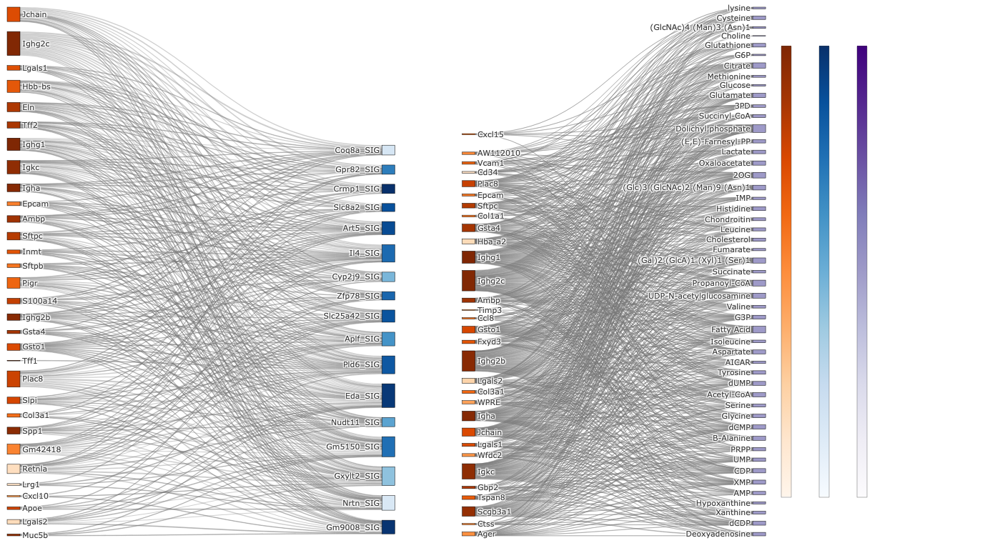

✓ Saved alluvial_2panel_shared_colorbars_clean.html


In [11]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from matplotlib import cm, colors as mpl_colors
from pathlib import Path

# ========= USER OPTIONS =========
CSV_PATHS   = [
    Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251026_194037.csv"),
    Path("../Mongoose_post_hoc/cluster3_niche_to_flux_for_sources_from_second_csv_KP11.csv"),
]
CLUSTERS     = None         # e.g., {4,5} or None
MIN_WEIGHT   = 0.2
TOP_N_EDGES  = None
ORIENTATION  = "1x2"        # "1x2" or "2x1"
OUT_HTML     = "alluvial_2panel_shared_colorbars_clean.html"
# =================================

def to_hex(v01, cmap="Oranges"):
    rgba = cm.get_cmap(cmap)(float(np.clip(v01, 0, 1)))
    return mpl_colors.to_hex(rgba)

def side_colors(names, ranks, cmap, fallback_intensity=0.4):
    arr = np.array(ranks, dtype=float)
    finite = np.isfinite(arr)
    if finite.any():
        rmin, rmax = np.nanmin(arr[finite]), np.nanmax(arr[finite])
        span = (rmax - rmin) if rmax != rmin else 1.0
        v01  = np.where(finite, (rmax - arr) / span, np.nan)   # 0..1 (best -> 1)
        v01  = np.nan_to_num(v01, nan=0.15)
        v01  = 0.15 + 0.85 * v01
    else:
        v01 = np.full(len(names), fallback_intensity)
    return [to_hex(v, cmap) for v in v01], v01

def order_by_rank(names, best_series):
    recs = []
    for n in names:
        r = best_series.get(n, np.inf)
        recs.append((n, r))
    recs.sort(key=lambda t: (not np.isfinite(t[1]), t[1]))
    ordered_names  = [n for n, _ in recs]
    ordered_ranks  = [r if np.isfinite(r) else np.nan for _, r in recs]
    return ordered_names, ordered_ranks

def _normalize_columns(df):
    # unify to lowercase expected names
    ren = {
        "Cluster":"cluster", "Source":"source", "Target":"target",
        "Value":"value", "Direction":"direction",
        "Niche_rank":"niche_rank", "Activity_rank":"activity_rank", "Flux_rank":"flux_rank"
    }
    return df.rename(columns=ren)

def _detect_panel_and_rank_col(df):
    """
    Returns (panel_type, target_rank_col, target_cmap).
    panel_type in {"activity","flux"}.
    If target rank missing (flux case), returns rank col name that may not exist; caller handles NaNs.
    """
    # primary by columns
    if "activity_rank" in df.columns:
        return "activity", "activity_rank", "Blues"
    if "flux_rank" in df.columns:
        return "flux", "flux_rank", "Purples"
    # fallback by Direction text if present
    if "direction" in df.columns:
        dvals = df["direction"].astype(str).str.upper().unique().tolist()
        if any("FLUX" in d for d in dvals):
            return "flux", "flux_rank", "Purples"
        if any("ACTIVITY" in d for d in dvals):
            return "activity", "activity_rank", "Blues"
    # default to activity if activity file structure (lowercase) else flux
    if "activity_rank" not in df.columns and "flux_rank" not in df.columns:
        # heuristic: if 'target' looks like metabolites (spaces, parentheses), call it flux
        sample = df["target"].astype(str).head(20).str.contains(r"[() ]").mean() if "target" in df.columns else 0
        if sample > 0.2:
            return "flux", "flux_rank", "Purples"
    return "activity", "activity_rank", "Blues"

def build_sankey_parts(csv_path, clusters=None, min_weight=0.5, top_n_edges=None):
    df = pd.read_csv(csv_path)
    df = _normalize_columns(df)

    # Basic required columns (after normalization)
    req_basic = {"source","target","value"}
    missing = req_basic - set(df.columns)
    if missing:
        raise ValueError(f"{csv_path.name}: Missing columns: {missing}")

    # Optional cluster filter (support both 'cluster' present or absent)
    if clusters is not None and "cluster" in df.columns:
        df = df[df["cluster"].isin(clusters)].copy()

    # Coerce numerics where present
    for c in ["value","niche_rank","activity_rank","flux_rank"]:
        if c in df.columns:
            df[c] = pd.to_numeric(df[c], errors="coerce")

    df = df.dropna(subset=["source","target","value"])
    if df.empty:
        raise SystemExit(f"{csv_path.name}: No rows left after cleaning.")

    # Which panel & which target rank to use?
    panel_type, tgt_rank_col, tgt_cmap = _detect_panel_and_rank_col(df)
    if "niche_rank" not in df.columns:
        raise ValueError(f"{csv_path.name}: Missing 'niche_rank' for sources.")

    # Collapse edges, keep strongest
    edges = (df.groupby(["source","target"], as_index=False)["value"].sum()
               .sort_values("value", ascending=False))
    edges = edges[edges["value"] >= min_weight]
    if top_n_edges:
        edges = edges.head(top_n_edges)
    if edges.empty:
        raise SystemExit(f"{csv_path.name}: No edges left — lower MIN_WEIGHT or adjust CLUSTERS.")

    # Best rank per node (source always by niche_rank; target by detected col if present)
    src_best = df.groupby("source")["niche_rank"].min()
    if tgt_rank_col in df.columns:
        tgt_best = df.groupby("target")[tgt_rank_col].min()
    else:
        # no target rank available (e.g., flux file) → all NaN; will trigger uniform target coloring
        tgt_best = pd.Series(dtype=float)

    # Order nodes by best rank
    unique_sources = edges["source"].astype(str).unique()
    unique_targets = edges["target"].astype(str).unique()
    ordered_sources, src_ranks_used = order_by_rank(unique_sources, src_best)
    # use NaNs if tgt_best missing
    if len(tgt_best) == 0:
        ordered_targets = list(unique_targets)
        tgt_ranks_used = [np.nan] * len(ordered_targets)
    else:
        ordered_targets, tgt_ranks_used = order_by_rank(unique_targets, tgt_best)

    nodes = ordered_sources + ordered_targets
    node_idx = {n: i for i, n in enumerate(nodes)}

    edges_sorted = edges.copy()
    edges_sorted["source_idx"] = edges_sorted["source"].astype(str).map(node_idx)
    edges_sorted["target_idx"] = edges_sorted["target"].astype(str).map(node_idx)
    edges_sorted = edges_sorted.sort_values(["source_idx","target_idx"])

    # Colors (targets fallback to uniform shade if ranks all NaN)
    src_colors, _ = side_colors(ordered_sources, src_ranks_used, "Oranges")
    # If all NaN, side_colors will return uniform intensity (fallback_intensity)
    tgt_colors, _ = side_colors(ordered_targets, tgt_ranks_used, tgt_cmap, fallback_intensity=0.5)
    node_colors   = src_colors + tgt_colors

    # Hover
    node_hover = []
    for n, rk in zip(ordered_sources, src_ranks_used):
        node_hover.append(f"{n}<br>niche_rank: {rk:.0f}" if np.isfinite(rk) else f"{n}<br>niche_rank: NA")
    label_name = f"{tgt_rank_col}"
    for n, rk in zip(ordered_targets, tgt_ranks_used):
        node_hover.append(f"{n}<br>{label_name}: {rk:.0f}" if np.isfinite(rk) else f"{n}<br>{label_name}: NA")

    sankey = go.Sankey(
        arrangement="snap",
        node=dict(
            pad=14, thickness=18, line=dict(color="black", width=0.5),
            label=nodes, color=node_colors,
            customdata=node_hover, hovertemplate="%{customdata}<extra></extra>",
        ),
        link=dict(
            source=edges_sorted["source_idx"].tolist(),
            target=edges_sorted["target_idx"].tolist(),
            value =edges_sorted["value"].astype(float).tolist(),
            color =["rgba(120,120,120,0.35)"] * len(edges_sorted),
            hovertemplate="Source: %{source.label}<br>Target: %{target.label}<br>Weight: %{value:.3g}<extra></extra>",
        ),
    )
    sankey.meta = {"target_cmap": tgt_cmap, "panel_type": panel_type}
    return sankey

def add_shared_colorbars(fig, orientation):
    # Right-side slim bars: Oranges (niche), Blues (activity), Purples (flux)
    if orientation == "1x2":
        cb_len = 0.88
        x_positions = [0.91, 0.955, 1.00]  # left→right
        right_margin = 210
    else:
        cb_len = 0.80
        x_positions = [0.92, 0.965, 1.00]
        right_margin = 210

    def _add_bar(xpos, colorscale):
        fig.add_trace(go.Scatter(
            x=[None], y=[None], mode="markers",
            marker=dict(
                size=0.1,
                color=[2], cmin=1, cmax=2,
                colorscale=colorscale,
                reversescale=False,
                showscale=True,
                colorbar=dict(
                    title="", x=xpos, xanchor="left",
                    len=cb_len, thickness=14,
                    outlinewidth=0.4, ticks="", showticklabels=False
                ),
            ),
            hoverinfo="skip", showlegend=False,
        ))
        return right_margin

    _add_bar(x_positions[0], "Oranges")  # niche
    _add_bar(x_positions[1], "Blues")    # activity
    _add_bar(x_positions[2], "Purples")  # flux
    return right_margin

# --- Build the figure with two panels ---
fig = go.Figure()

# Domains for panels (reserve extra right margin for 3 colorbars)
if ORIENTATION == "1x2":
    domains = [
        dict(x=[0.00, 0.46], y=[0.00, 1.00]),
        dict(x=[0.54, 0.90], y=[0.00, 1.00]),  # right margin area for colorbars
    ]
    margin = dict(l=10, r=210, t=10, b=10)
elif ORIENTATION == "2x1":
    domains = [
        dict(x=[0.00, 1.00], y=[0.54, 0.96]),
        dict(x=[0.00, 1.00], y=[0.04, 0.46]),
    ]
    margin = dict(l=10, r=210, t=10, b=40)
else:
    raise ValueError("ORIENTATION must be '1x2' or '2x1'.")

# Add both Sankeys (no titles/annotations)
for i, csv_path in enumerate(CSV_PATHS):
    sankey = build_sankey_parts(
        csv_path=csv_path, clusters=CLUSTERS, min_weight=MIN_WEIGHT, top_n_edges=TOP_N_EDGES
    )
    sankey.domain = domains[i]
    fig.add_trace(sankey)

# Shared, clean colorbars (Oranges + Blues + Purples)
_ = add_shared_colorbars(fig, ORIENTATION)

# Layout: no titles, no axes
fig.update_layout(
    font_size=11,
    height=760 if ORIENTATION=="1x2" else 1100,
    width=1300 if ORIENTATION=="1x2" else 900,
    margin=margin,
)

# Remove background grid/tint
fig.update_layout(template="none", paper_bgcolor="rgba(0,0,0,0)", plot_bgcolor="rgba(0,0,0,0)")
fig.update_xaxes(visible=False)
fig.update_yaxes(visible=False)

fig.show()
fig.write_html(OUT_HTML, include_plotlyjs="cdn")
print(f"✓ Saved {OUT_HTML}")



=== niche_to_activity_shap_edges_with_ranks_clusters45_20251026_194037.csv | Panel: ACTIVITY ===
Niche sources (best→worst):
                      Ighg1   rank=  2   color=#7f2704
                     Ighg2c   rank=  3   color=#812804
                       Igha   rank=  4   color=#852904
                     Ighg2b   rank=  5   color=#892b04
                       Spp1   rank=  6   color=#8b2c04
                       Igkc   rank=  7   color=#8f2d04
                       Ambp   rank= 12   color=#a03403
                       Tff2   rank= 15   color=#ab3803
                        Eln   rank= 16   color=#b03903
                      Sftpc   rank= 18   color=#b83c02
                      Plac8   rank= 23   color=#ce4401
                       Slpi   rank= 25   color=#d64701
                     Jchain   rank= 28   color=#de4e05
                     Lgals1   rank= 29   color=#e05206
                     Hbb-bs   rank= 32   color=#e65a0b
                       Pigr   rank= 37   color=#f

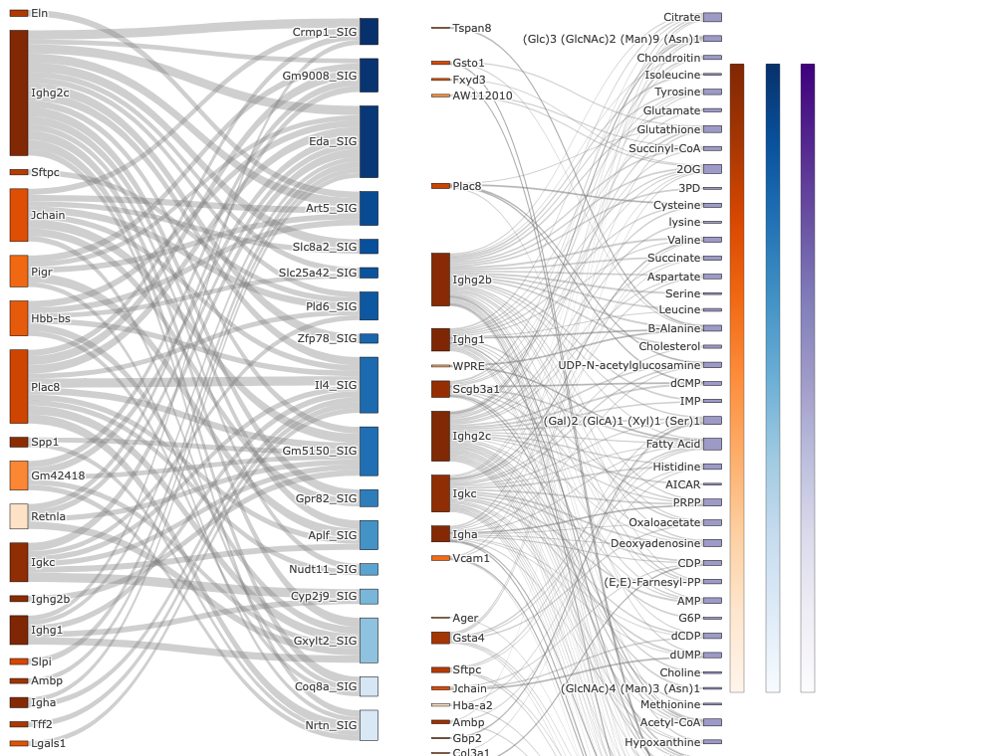

In [1]:
#!/usr/bin/env python3
"""
Rank-ordered two-panel alluvial (Sankey) with printed node orders.

- Left side (sources): Niche nodes, colored with Oranges. Best rank (1,2,3,...) at the TOP and darkest.
- Right side (targets): Activity (Blues) or Flux (Purples), auto-detected per CSV. Best rank at the TOP and darkest.
- Prints ordered node lists (best→worst) with ranks and hex colors for both sides.
- Adds shared slim colorbars for Niche/Activity/Flux on the right.

Author: Mongoose project
"""

import pandas as pd
import numpy as np
import plotly.graph_objects as go
from matplotlib import cm, colors as mpl_colors
from pathlib import Path

# ========= USER OPTIONS =========
CSV_PATHS   = [
    Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251026_194037.csv"),
    Path("../Mongoose_post_hoc/cluster3_niche_to_flux_for_sources_from_second_csv_KP11.csv"),
]
CLUSTERS     = None         # e.g., {4,5} or None
MIN_WEIGHT   = 0.5
TOP_N_EDGES  = None
ORIENTATION  = "1x2"        # "1x2" or "2x1"
OUT_HTML     = "alluvial_2panel_shared_colorbars_clean.html"
SHOW_FIG     = True         # set False on headless servers
# =================================


# ---------- Helpers ----------
def to_hex(v01, cmap="Oranges"):
    rgba = cm.get_cmap(cmap)(float(np.clip(v01, 0, 1)))
    return mpl_colors.to_hex(rgba)


def side_colors(names, ranks, cmap, fallback_intensity=0.4):
    """
    Map ranks to colors. Smaller rank (better) -> darker color.
    If ranks contain NaN only, use a uniform fallback intensity.
    """
    arr = np.array(ranks, dtype=float)
    finite = np.isfinite(arr)
    if finite.any():
        rmin, rmax = np.nanmin(arr[finite]), np.nanmax(arr[finite])
        span = (rmax - rmin) if rmax != rmin else 1.0
        # invert so best rank (smallest) -> 1.0 (darkest end of colormap)
        v01  = np.where(finite, (rmax - arr) / span, np.nan)
        v01  = np.nan_to_num(v01, nan=0.15)  # NaNs get light but non-zero shade
        v01  = 0.15 + 0.85 * v01            # avoid ultra-light
    else:
        v01 = np.full(len(names), fallback_intensity)
    return [to_hex(v, cmap) for v in v01], v01


def order_by_rank(names, best_series):
    """
    Return (ordered_names, ordered_ranks) ascending by rank (1=best), NaNs last.
    """
    recs = []
    for n in names:
        r = best_series.get(n, np.inf)
        recs.append((n, r))
    recs.sort(key=lambda t: (not np.isfinite(t[1]), t[1]))
    ordered_names  = [n for n, _ in recs]
    ordered_ranks  = [r if np.isfinite(r) else np.nan for _, r in recs]
    return ordered_names, ordered_ranks


def _normalize_columns(df):
    """Unify common mixed-case column names to lowercase."""
    ren = {
        "Cluster":"cluster", "Source":"source", "Target":"target",
        "Value":"value", "Direction":"direction",
        "Niche_rank":"niche_rank", "Activity_rank":"activity_rank", "Flux_rank":"flux_rank"
    }
    return df.rename(columns=ren)


def _detect_panel_and_rank_col(df):
    """
    Returns (panel_type, target_rank_col, target_cmap).
    panel_type ∈ {"activity","flux"}; target_rank_col may be missing in flux CSVs.
    """
    cols = set(df.columns)
    if "activity_rank" in cols:
        return "activity", "activity_rank", "Blues"
    if "flux_rank" in cols:
        return "flux", "flux_rank", "Purples"
    if "direction" in cols:
        dvals = df["direction"].astype(str).str.upper().unique().tolist()
        if any("FLUX" in d for d in dvals):
            return "flux", "flux_rank", "Purples"
        if any("ACTIVITY" in d for d in dvals):
            return "activity", "activity_rank", "Blues"
    # Heuristic fallback
    if "target" in cols:
        looks_like_metab = df["target"].astype(str).head(20).str.contains(r"[() ]").mean() > 0.2
        if looks_like_metab:
            return "flux", "flux_rank", "Purples"
    return "activity", "activity_rank", "Blues"


def _top_to_bottom_positions(n):
    """Evenly spaced y positions. First entry at TOP."""
    if n <= 1:
        return [0.5]
    pad = 0.5 / n
    ys = np.linspace(pad, 1.0 - pad, n)
    return ys.tolist()


# ---------- Core builder ----------
def build_sankey_parts(csv_path, clusters=None, min_weight=0.5, top_n_edges=None):
    df = pd.read_csv(csv_path)
    df = _normalize_columns(df)

    req_basic = {"source","target","value"}
    missing = req_basic - set(df.columns)
    if missing:
        raise ValueError(f"{csv_path.name}: Missing columns: {missing}")

    if clusters is not None and "cluster" in df.columns:
        df = df[df["cluster"].isin(clusters)].copy()

    for c in ["value","niche_rank","activity_rank","flux_rank"]:
        if c in df.columns:
            df[c] = pd.to_numeric(df[c], errors="coerce")

    df = df.dropna(subset=["source","target","value"])
    if df.empty:
        raise SystemExit(f"{csv_path.name}: No rows left after cleaning.")

    panel_type, tgt_rank_col, tgt_cmap = _detect_panel_and_rank_col(df)
    if "niche_rank" not in df.columns:
        raise ValueError(f"{csv_path.name}: Missing 'niche_rank' for sources.")

    # Collapse edges, keep strongest by summed value
    edges = (df.groupby(["source","target"], as_index=False)["value"].sum()
               .sort_values("value", ascending=False))
    edges = edges[edges["value"] >= min_weight]
    if top_n_edges:
        edges = edges.head(top_n_edges)
    if edges.empty:
        raise SystemExit(f"{csv_path.name}: No edges left — lower MIN_WEIGHT or adjust CLUSTERS.")

    # Best rank per node
    src_best = df.groupby("source")["niche_rank"].min()
    tgt_best = df.groupby("target")[tgt_rank_col].min() if tgt_rank_col in df.columns else pd.Series(dtype=float)

    # Ordered node lists (best→worst)
    unique_sources = edges["source"].astype(str).unique()
    unique_targets = edges["target"].astype(str).unique()
    ordered_sources, src_ranks_used = order_by_rank(unique_sources, src_best)

    if len(tgt_best) == 0:
        ordered_targets = list(unique_targets)
        tgt_ranks_used = [np.nan] * len(ordered_targets)
    else:
        ordered_targets, tgt_ranks_used = order_by_rank(unique_targets, tgt_best)

    # Colors (darker for better ranks)
    src_colors, _ = side_colors(ordered_sources, src_ranks_used, "Oranges")
    tgt_colors, _ = side_colors(ordered_targets, tgt_ranks_used, tgt_cmap, fallback_intensity=0.5)
    node_colors   = src_colors + tgt_colors

    # Explicit positions to pin vertical order (best at TOP)
    ys_left  = _top_to_bottom_positions(len(ordered_sources))
    ys_right = _top_to_bottom_positions(len(ordered_targets))
    xs_left  = [0.0] * len(ordered_sources)
    xs_right = [1.0] * len(ordered_targets)

    nodes = ordered_sources + ordered_targets
    node_x = xs_left + xs_right
    node_y = ys_left + ys_right
    node_idx = {n: i for i, n in enumerate(nodes)}

    edges_sorted = edges.copy()
    edges_sorted["source_idx"] = edges_sorted["source"].astype(str).map(node_idx)
    edges_sorted["target_idx"] = edges_sorted["target"].astype(str).map(node_idx)
    edges_sorted = edges_sorted.sort_values(["source_idx","target_idx"])

    # Hover text
    node_hover = []
    for n, rk in zip(ordered_sources, src_ranks_used):
        node_hover.append(f"{n}<br>niche_rank: {rk:.0f}" if np.isfinite(rk) else f"{n}<br>niche_rank: NA")
    label_name = f"{tgt_rank_col}"
    for n, rk in zip(ordered_targets, tgt_ranks_used):
        node_hover.append(f"{n}<br>{label_name}: {rk:.0f}" if np.isfinite(rk) else f"{n}<br>{label_name}: NA")

    # Console printouts (best→worst)
    print(f"\n=== {csv_path.name} | Panel: {panel_type.upper()} ===")
    print("Niche sources (best→worst):")
    for n, r, c in zip(ordered_sources, src_ranks_used, src_colors):
        rtxt = "NA" if not np.isfinite(r) else int(r)
        print(f"  {n:>25}   rank={rtxt:>3}   color={c}")

    tgt_title = "Activity targets" if panel_type == "activity" else "Flux targets"
    print(f"{tgt_title} (best→worst):")
    for n, r, c in zip(ordered_targets, tgt_ranks_used, tgt_colors):
        rtxt = "NA" if not np.isfinite(r) else int(r)
        print(f"  {n:>25}   rank={rtxt:>3}   color={c}")

    sankey = go.Sankey(
        arrangement="snap",
        node=dict(
            pad=14, thickness=18, line=dict(color="black", width=0.5),
            label=nodes, color=node_colors,
            x=node_x, y=node_y,  # <- pins the sorted vertical order
            customdata=node_hover, hovertemplate="%{customdata}<extra></extra>",
        ),
        link=dict(
            source=edges_sorted["source_idx"].tolist(),
            target=edges_sorted["target_idx"].tolist(),
            value =edges_sorted["value"].astype(float).tolist(),
            color =["rgba(120,120,120,0.35)"] * len(edges_sorted),
            hovertemplate="Source: %{source.label}<br>Target: %{target.label}<br>Weight: %{value:.3g}<extra></extra>",
        ),
    )
    sankey.meta = {"target_cmap": tgt_cmap, "panel_type": panel_type}
    return sankey


def add_shared_colorbars(fig, orientation):
    """Right-side slim colorbars for Oranges (Niche), Blues (Activity), Purples (Flux)."""
    if orientation == "1x2":
        cb_len = 0.88
        x_positions = [0.91, 0.955, 1.00]  # left→right
        right_margin = 210
    else:
        cb_len = 0.80
        x_positions = [0.92, 0.965, 1.00]
        right_margin = 210

    def _add_bar(xpos, colorscale):
        fig.add_trace(go.Scatter(
            x=[None], y=[None], mode="markers",
            marker=dict(
                size=0.1,
                color=[2], cmin=1, cmax=2,
                colorscale=colorscale,
                reversescale=False,
                showscale=True,
                colorbar=dict(
                    title="", x=xpos, xanchor="left",
                    len=cb_len, thickness=14,
                    outlinewidth=0.4, ticks="", showticklabels=False
                ),
            ),
            hoverinfo="skip", showlegend=False,
        ))
        return right_margin

    _add_bar(x_positions[0], "Oranges")  # Niche
    _add_bar(x_positions[1], "Blues")    # Activity
    _add_bar(x_positions[2], "Purples")  # Flux
    return right_margin


# ---------- Build the figure ----------
def main():
    fig = go.Figure()

    # Domains for panels (reserve right margin for colorbars)
    if ORIENTATION == "1x2":
        domains = [
            dict(x=[0.00, 0.46], y=[0.00, 1.00]),
            dict(x=[0.54, 0.90], y=[0.00, 1.00]),
        ]
        margin = dict(l=10, r=210, t=10, b=10)
    elif ORIENTATION == "2x1":
        domains = [
            dict(x=[0.00, 1.00], y=[0.54, 0.96]),
            dict(x=[0.00, 1.00], y=[0.04, 0.46]),
        ]
        margin = dict(l=10, r=210, t=10, b=40)
    else:
        raise ValueError("ORIENTATION must be '1x2' or '2x1'.")

    # Two panels
    for i, csv_path in enumerate(CSV_PATHS):
        sankey = build_sankey_parts(
            csv_path=csv_path, clusters=CLUSTERS, min_weight=MIN_WEIGHT, top_n_edges=TOP_N_EDGES
        )
        sankey.domain = domains[i]
        fig.add_trace(sankey)

    # Shared colorbars
    _ = add_shared_colorbars(fig, ORIENTATION)

    # Minimal layout
    fig.update_layout(
        font_size=11,
        height=760 if ORIENTATION == "1x2" else 1100,
        width=1300 if ORIENTATION == "1x2" else 900,
        margin=margin,
        template="none",
        paper_bgcolor="rgba(0,0,0,0)",
        plot_bgcolor="rgba(0,0,0,0)",
    )
    fig.update_xaxes(visible=False)
    fig.update_yaxes(visible=False)

    # Save & (optionally) show
    fig.write_html(OUT_HTML, include_plotlyjs="cdn")
    print(f"\n✓ Saved {OUT_HTML}")
    if SHOW_FIG:
        fig.show()


if __name__ == "__main__":
    main()


In [ ]:
# keep

✓ Saved alluvial_compact_ranked_1x2_gap_closed.html


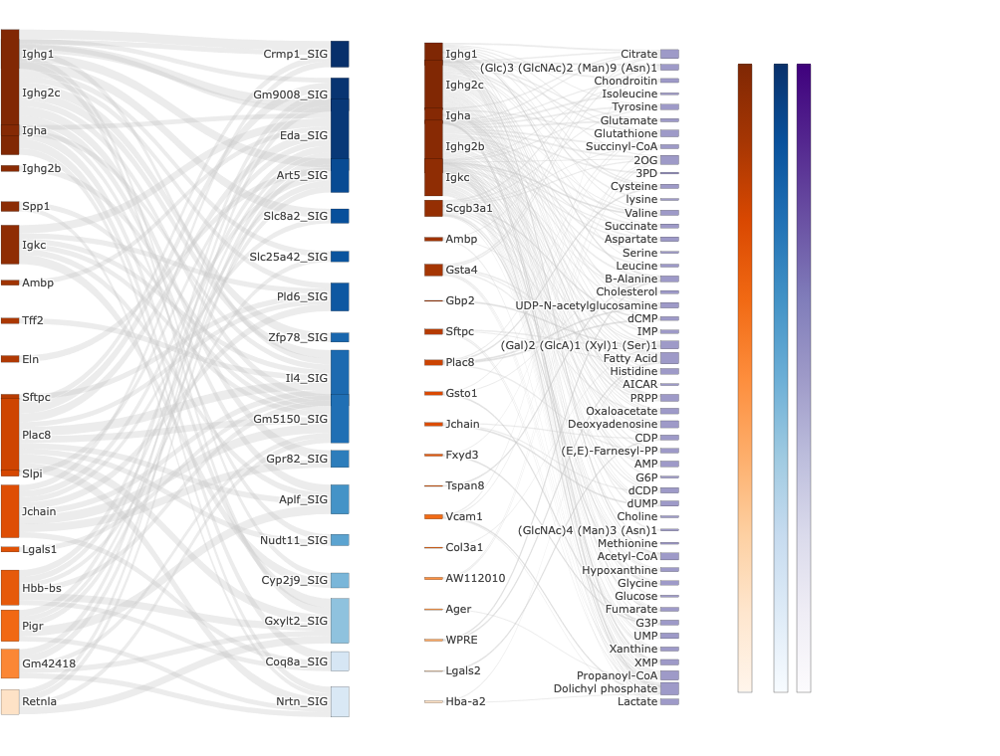

In [10]:
#!/usr/bin/env python3
"""
Compact 1x2 rank-ordered alluvial with the center gap closed.
- Overlaps the two Sankey domains a bit.
- Pins node columns tighter to the shared boundary.
- Removes link outlines to avoid a visible seam.
"""

import pandas as pd
import numpy as np
import plotly.graph_objects as go
from matplotlib import cm, colors as mpl_colors
from pathlib import Path

# ---------- LAYOUT KNOBS ----------
WIDTH        = 1300
HEIGHT       = 760
FONT_SIZE    = 11
NODE_THICK   = 18
NODE_PAD     = 14
V_SPREAD     = 0.88
COLORBAR_RM  = 210
EDGE_EPS     = 1e-4        # tighter pin to panel edges
PANEL_OVERLAP = 0.15       # 3% overlap to close the middle gap
# ----------------------------------

# ---------- USER INPUT ----------
CSV_PATHS = [
    Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251026_194037.csv"),
    Path("../Mongoose_post_hoc/cluster3_niche_to_flux_for_sources_from_second_csv_KP11.csv"),
]
CLUSTERS     = None
MIN_WEIGHT   = 0.5
TOP_N_EDGES  = None
OUT_HTML     = "alluvial_compact_ranked_1x2_gap_closed.html"
SHOW_FIG     = True
# ---------------------------------

# ---------- helpers ----------
def to_hex(v01, cmap="Oranges"):
    rgba = cm.get_cmap(cmap)(float(np.clip(v01, 0, 1)))
    return mpl_colors.to_hex(rgba)

def side_colors(names, ranks, cmap, fallback_intensity=0.4):
    arr = np.array(ranks, dtype=float)
    finite = np.isfinite(arr)
    if finite.any():
        rmin, rmax = np.nanmin(arr[finite]), np.nanmax(arr[finite])
        span = (rmax - rmin) if rmax != rmin else 1.0
        v01  = np.where(finite, (rmax - arr) / span, np.nan)  # best→1
        v01  = np.nan_to_num(v01, nan=0.15)
        v01  = 0.15 + 0.85 * v01
    else:
        v01 = np.full(len(names), fallback_intensity)
    return [to_hex(v, cmap) for v in v01], v01

def order_by_rank(names, best_series):
    recs = [(n, best_series.get(n, np.inf)) for n in names]
    recs.sort(key=lambda t: (not np.isfinite(t[1]), t[1]))  # NaNs last
    ordered_names  = [n for n, _ in recs]
    ordered_ranks  = [r if np.isfinite(r) else np.nan for _, r in recs]
    return ordered_names, ordered_ranks

def _normalize_columns(df):
    return df.rename(columns={
        "Cluster":"cluster","Source":"source","Target":"target","Value":"value","Direction":"direction",
        "Niche_rank":"niche_rank","Activity_rank":"activity_rank","Flux_rank":"flux_rank"
    })

def _detect_panel_and_rank_col(df):
    cols = set(df.columns)
    if "activity_rank" in cols: return "activity","activity_rank","Blues"
    if "flux_rank"     in cols: return "flux","flux_rank","Purples"
    if "direction" in cols:
        ups = df["direction"].astype(str).str.upper()
        if ups.str.contains("FLUX").any():     return "flux","flux_rank","Purples"
        if ups.str.contains("ACTIVITY").any(): return "activity","activity_rank","Blues"
    if "target" in cols and df["target"].astype(str).head(20).str.contains(r"[() ]").mean() > 0.2:
        return "flux","flux_rank","Purples"
    return "activity","activity_rank","Blues"

def _local_y_positions(n, v_spread=0.88):
    if n <= 1: return [0.5]
    top    = (1.0 - v_spread) / 2.0
    bottom = 1.0 - top
    return np.linspace(top, bottom, n).tolist()

def _to_domain_coords(local_vals, dom_lo, dom_hi):
    span = dom_hi - dom_lo
    return [dom_lo + v * span for v in local_vals]

# ---------- core ----------
def build_sankey_for_domain(csv_path, domain, clusters=None, min_weight=0.5, top_n_edges=None):
    df = pd.read_csv(csv_path)
    df = _normalize_columns(df)

    need = {"source","target","value"}
    miss = need - set(df.columns)
    if miss: raise ValueError(f"{csv_path.name}: Missing columns: {miss}")

    if clusters is not None and "cluster" in df.columns:
        df = df[df["cluster"].isin(clusters)].copy()

    for c in ["value","niche_rank","activity_rank","flux_rank"]:
        if c in df.columns: df[c] = pd.to_numeric(df[c], errors="coerce")

    df = df.dropna(subset=["source","target","value"])
    if df.empty: raise SystemExit(f"{csv_path.name}: no rows after cleaning.")

    panel_type, tgt_rank_col, tgt_cmap = _detect_panel_and_rank_col(df)
    if "niche_rank" not in df.columns:
        raise ValueError(f"{csv_path.name}: Missing 'niche_rank'.")

    edges = (df.groupby(["source","target"], as_index=False)["value"].sum()
               .sort_values("value", ascending=False))
    edges = edges[edges["value"] >= min_weight]
    if top_n_edges: edges = edges.head(top_n_edges)
    if edges.empty: raise SystemExit(f"{csv_path.name}: no edges — relax MIN_WEIGHT/top_n.")

    src_best = df.groupby("source")["niche_rank"].min()
    tgt_best = df.groupby("target")[tgt_rank_col].min() if tgt_rank_col in df.columns else pd.Series(dtype=float)

    src_u = edges["source"].astype(str).unique()
    tgt_u = edges["target"].astype(str).unique()
    ordered_sources, src_ranks = order_by_rank(src_u, src_best)
    if len(tgt_best) == 0:
        ordered_targets, tgt_ranks = list(tgt_u), [np.nan]*len(tgt_u)
    else:
        ordered_targets, tgt_ranks = order_by_rank(tgt_u, tgt_best)

    src_colors, _ = side_colors(ordered_sources, src_ranks, "Oranges")
    tgt_colors, _ = side_colors(ordered_targets, tgt_ranks, tgt_cmap, fallback_intensity=0.5)
    node_colors   = src_colors + tgt_colors

    # domain-aware positions (flush to edges)
    x0, x1 = domain["x"]; y0, y1 = domain["y"]
    ys_left_local  = _local_y_positions(len(ordered_sources), V_SPREAD)
    ys_right_local = _local_y_positions(len(ordered_targets), V_SPREAD)
    ys_left  = _to_domain_coords(ys_left_local,  y0, y1)
    ys_right = _to_domain_coords(ys_right_local, y0, y1)

    xs_left_col  = [x0 + EDGE_EPS] * len(ordered_sources)
    xs_right_col = [x1 - EDGE_EPS] * len(ordered_targets)

    nodes  = ordered_sources + ordered_targets
    node_x = xs_left_col + xs_right_col
    node_y = ys_left + ys_right
    node_idx = {n: i for i, n in enumerate(nodes)}

    edges_sorted = edges.copy()
    edges_sorted["source_idx"] = edges_sorted["source"].astype(str).map(node_idx)
    edges_sorted["target_idx"] = edges_sorted["target"].astype(str).map(node_idx)
    edges_sorted = edges_sorted.sort_values(["source_idx","target_idx"])

    sankey = go.Sankey(
        arrangement="fixed",
        node=dict(
            pad=NODE_PAD, thickness=NODE_THICK, line=dict(color="black", width=0.2),
            label=nodes, color=node_colors,
            x=node_x, y=node_y,
            hovertemplate="%{label}<extra></extra>",
        ),
        link=dict(
            source=edges_sorted["source_idx"].tolist(),
            target=edges_sorted["target_idx"].tolist(),
            value =edges_sorted["value"].astype(float).tolist(),
            color =["rgba(200,200,200,0.35)"] * len(edges_sorted),
            line=dict(width=0),  # no link outline → no seam
            hovertemplate="Source: %{source.label}<br>Target: %{target.label}<br>Weight: %{value:.3g}<extra></extra>",
        ),
    )
    return sankey

def add_shared_colorbars(fig):
    cb_len = 0.88
    x_positions = [0.92, 0.965, 0.995]  # Oranges, Blues, Purples
    def _bar(xpos, colorscale):
        fig.add_trace(go.Scatter(
            x=[None], y=[None], mode="markers",
            marker=dict(size=0.1, color=[2], cmin=1, cmax=2, colorscale=colorscale,
                        showscale=True,
                        colorbar=dict(title="", x=xpos, xanchor="left",
                                      len=cb_len, thickness=14, outlinewidth=0.4,
                                      ticks="", showticklabels=False)),
            hoverinfo="skip", showlegend=False,
        ))
    _bar(x_positions[0], "Oranges")
    _bar(x_positions[1], "Blues")
    _bar(x_positions[2], "Purples")

# ---------- build compact 1x2 figure ----------
def main():
    fig = go.Figure()

    # Overlap the domains around the center to visually close the gap
    left_end    = 0.50 + PANEL_OVERLAP
    right_start = 0.50 - PANEL_OVERLAP

    domains = [
        dict(x=[0.00, left_end],     y=[0.00, 1.00]),
        dict(x=[right_start, 0.90],  y=[0.00, 1.00]),
    ]
    margin = dict(l=10, r=COLORBAR_RM, t=10, b=10)

    for i, csv_path in enumerate(CSV_PATHS):
        tr = build_sankey_for_domain(
            csv_path=csv_path, domain=domains[i],
            clusters=CLUSTERS, min_weight=MIN_WEIGHT, top_n_edges=TOP_N_EDGES
        )
        tr.domain = domains[i]
        fig.add_trace(tr)

    add_shared_colorbars(fig)

    fig.update_layout(
        font=dict(size=FONT_SIZE),
        height=HEIGHT, width=WIDTH, margin=margin,
        template="none", paper_bgcolor="rgba(0,0,0,0)", plot_bgcolor="rgba(0,0,0,0)",
    )
    fig.update_xaxes(visible=False); fig.update_yaxes(visible=False)

    fig.write_html(OUT_HTML, include_plotlyjs="cdn")
    print(f"✓ Saved {OUT_HTML}")
    if SHOW_FIG:
        fig.show()

if __name__ == "__main__":
    main()


https://version-12-0.string-db.org/cgi/network?networkId=bvEZx3cmPDv6

### KP1_1

✓ Saved alluvial_compact_ranked_1x2_gap_closed.html


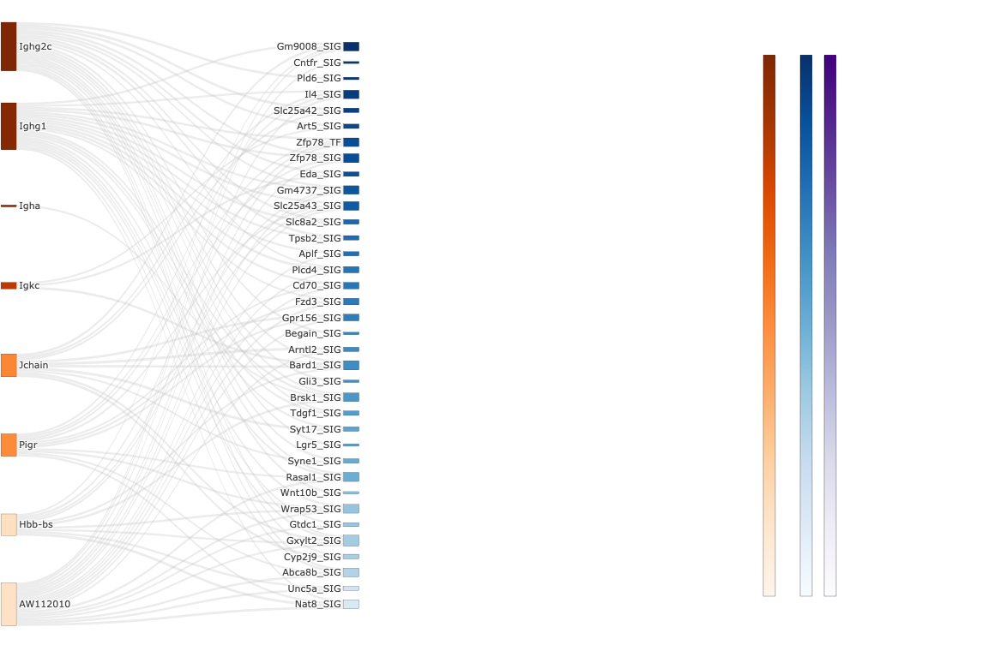

In [4]:
#!/usr/bin/env python3
"""
Compact 1x2 rank-ordered alluvial with the center gap closed.
- Overlaps the two Sankey domains a bit.
- Pins node columns tighter to the shared boundary.
- Removes link outlines to avoid a visible seam.
"""

import pandas as pd
import numpy as np
import plotly.graph_objects as go
from matplotlib import cm, colors as mpl_colors
from pathlib import Path

# ---------- LAYOUT KNOBS ----------
WIDTH        = 1300
HEIGHT       = 760
FONT_SIZE    = 11
NODE_THICK   = 18
NODE_PAD     = 14
V_SPREAD     = 0.88
COLORBAR_RM  = 210
EDGE_EPS     = 1e-4        # tighter pin to panel edges
PANEL_OVERLAP = 0.15       # 3% overlap to close the middle gap
# ----------------------------------

# ---------- USER INPUT ----------
CSV_PATHS = [
    Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251115_180636.csv"),
    # Path("../Mongoose_post_hoc/cluster3_niche_to_flux_for_sources_from_second_csv_KP11.csv"),
]
CLUSTERS     = None
MIN_WEIGHT   = 0.8
TOP_N_EDGES  = None
OUT_HTML     = "alluvial_compact_ranked_1x2_gap_closed.html"
SHOW_FIG     = True
# ---------------------------------

# ---------- helpers ----------
def to_hex(v01, cmap="Oranges"):
    rgba = cm.get_cmap(cmap)(float(np.clip(v01, 0, 1)))
    return mpl_colors.to_hex(rgba)

def side_colors(names, ranks, cmap, fallback_intensity=0.4):
    arr = np.array(ranks, dtype=float)
    finite = np.isfinite(arr)
    if finite.any():
        rmin, rmax = np.nanmin(arr[finite]), np.nanmax(arr[finite])
        span = (rmax - rmin) if rmax != rmin else 1.0
        v01  = np.where(finite, (rmax - arr) / span, np.nan)  # best→1
        v01  = np.nan_to_num(v01, nan=0.15)
        v01  = 0.15 + 0.85 * v01
    else:
        v01 = np.full(len(names), fallback_intensity)
    return [to_hex(v, cmap) for v in v01], v01

def order_by_rank(names, best_series):
    recs = [(n, best_series.get(n, np.inf)) for n in names]
    recs.sort(key=lambda t: (not np.isfinite(t[1]), t[1]))  # NaNs last
    ordered_names  = [n for n, _ in recs]
    ordered_ranks  = [r if np.isfinite(r) else np.nan for _, r in recs]
    return ordered_names, ordered_ranks

def _normalize_columns(df):
    return df.rename(columns={
        "Cluster":"cluster","Source":"source","Target":"target","Value":"value","Direction":"direction",
        "Niche_rank":"niche_rank","Activity_rank":"activity_rank","Flux_rank":"flux_rank"
    })

def _detect_panel_and_rank_col(df):
    cols = set(df.columns)
    if "activity_rank" in cols: return "activity","activity_rank","Blues"
    if "flux_rank"     in cols: return "flux","flux_rank","Purples"
    if "direction" in cols:
        ups = df["direction"].astype(str).str.upper()
        if ups.str.contains("FLUX").any():     return "flux","flux_rank","Purples"
        if ups.str.contains("ACTIVITY").any(): return "activity","activity_rank","Blues"
    if "target" in cols and df["target"].astype(str).head(20).str.contains(r"[() ]").mean() > 0.2:
        return "flux","flux_rank","Purples"
    return "activity","activity_rank","Blues"

def _local_y_positions(n, v_spread=0.88):
    if n <= 1: return [0.5]
    top    = (1.0 - v_spread) / 2.0
    bottom = 1.0 - top
    return np.linspace(top, bottom, n).tolist()

def _to_domain_coords(local_vals, dom_lo, dom_hi):
    span = dom_hi - dom_lo
    return [dom_lo + v * span for v in local_vals]

# ---------- core ----------
def build_sankey_for_domain(csv_path, domain, clusters=None, min_weight=0.5, top_n_edges=None):
    df = pd.read_csv(csv_path)
    df = _normalize_columns(df)

    need = {"source","target","value"}
    miss = need - set(df.columns)
    if miss: raise ValueError(f"{csv_path.name}: Missing columns: {miss}")

    if clusters is not None and "cluster" in df.columns:
        df = df[df["cluster"].isin(clusters)].copy()

    for c in ["value","niche_rank","activity_rank","flux_rank"]:
        if c in df.columns: df[c] = pd.to_numeric(df[c], errors="coerce")

    df = df.dropna(subset=["source","target","value"])
    if df.empty: raise SystemExit(f"{csv_path.name}: no rows after cleaning.")

    panel_type, tgt_rank_col, tgt_cmap = _detect_panel_and_rank_col(df)
    if "niche_rank" not in df.columns:
        raise ValueError(f"{csv_path.name}: Missing 'niche_rank'.")

    edges = (df.groupby(["source","target"], as_index=False)["value"].sum()
               .sort_values("value", ascending=False))
    edges = edges[edges["value"] >= min_weight]
    if top_n_edges: edges = edges.head(top_n_edges)
    if edges.empty: raise SystemExit(f"{csv_path.name}: no edges — relax MIN_WEIGHT/top_n.")

    src_best = df.groupby("source")["niche_rank"].min()
    tgt_best = df.groupby("target")[tgt_rank_col].min() if tgt_rank_col in df.columns else pd.Series(dtype=float)

    src_u = edges["source"].astype(str).unique()
    tgt_u = edges["target"].astype(str).unique()
    ordered_sources, src_ranks = order_by_rank(src_u, src_best)
    if len(tgt_best) == 0:
        ordered_targets, tgt_ranks = list(tgt_u), [np.nan]*len(tgt_u)
    else:
        ordered_targets, tgt_ranks = order_by_rank(tgt_u, tgt_best)

    src_colors, _ = side_colors(ordered_sources, src_ranks, "Oranges")
    tgt_colors, _ = side_colors(ordered_targets, tgt_ranks, tgt_cmap, fallback_intensity=0.5)
    node_colors   = src_colors + tgt_colors

    # domain-aware positions (flush to edges)
    x0, x1 = domain["x"]; y0, y1 = domain["y"]
    ys_left_local  = _local_y_positions(len(ordered_sources), V_SPREAD)
    ys_right_local = _local_y_positions(len(ordered_targets), V_SPREAD)
    ys_left  = _to_domain_coords(ys_left_local,  y0, y1)
    ys_right = _to_domain_coords(ys_right_local, y0, y1)

    xs_left_col  = [x0 + EDGE_EPS] * len(ordered_sources)
    xs_right_col = [x1 - EDGE_EPS] * len(ordered_targets)

    nodes  = ordered_sources + ordered_targets
    node_x = xs_left_col + xs_right_col
    node_y = ys_left + ys_right
    node_idx = {n: i for i, n in enumerate(nodes)}

    edges_sorted = edges.copy()
    edges_sorted["source_idx"] = edges_sorted["source"].astype(str).map(node_idx)
    edges_sorted["target_idx"] = edges_sorted["target"].astype(str).map(node_idx)
    edges_sorted = edges_sorted.sort_values(["source_idx","target_idx"])

    sankey = go.Sankey(
        arrangement="fixed",
        node=dict(
            pad=NODE_PAD, thickness=NODE_THICK, line=dict(color="black", width=0.2),
            label=nodes, color=node_colors,
            x=node_x, y=node_y,
            hovertemplate="%{label}<extra></extra>",
        ),
        link=dict(
            source=edges_sorted["source_idx"].tolist(),
            target=edges_sorted["target_idx"].tolist(),
            value =edges_sorted["value"].astype(float).tolist(),
            color =["rgba(200,200,200,0.35)"] * len(edges_sorted),
            line=dict(width=0),  # no link outline → no seam
            hovertemplate="Source: %{source.label}<br>Target: %{target.label}<br>Weight: %{value:.3g}<extra></extra>",
        ),
    )
    return sankey

def add_shared_colorbars(fig):
    cb_len = 0.88
    x_positions = [0.92, 0.965, 0.995]  # Oranges, Blues, Purples
    def _bar(xpos, colorscale):
        fig.add_trace(go.Scatter(
            x=[None], y=[None], mode="markers",
            marker=dict(size=0.1, color=[2], cmin=1, cmax=2, colorscale=colorscale,
                        showscale=True,
                        colorbar=dict(title="", x=xpos, xanchor="left",
                                      len=cb_len, thickness=14, outlinewidth=0.4,
                                      ticks="", showticklabels=False)),
            hoverinfo="skip", showlegend=False,
        ))
    _bar(x_positions[0], "Oranges")
    _bar(x_positions[1], "Blues")
    _bar(x_positions[2], "Purples")

# ---------- build compact 1x2 figure ----------
def main():
    fig = go.Figure()

    # Overlap the domains around the center to visually close the gap
    left_end    = 0.50 + PANEL_OVERLAP
    right_start = 0.50 - PANEL_OVERLAP

    domains = [
        dict(x=[0.00, left_end],     y=[0.00, 1.00]),
        dict(x=[right_start, 0.90],  y=[0.00, 1.00]),
    ]
    margin = dict(l=10, r=COLORBAR_RM, t=10, b=10)

    for i, csv_path in enumerate(CSV_PATHS):
        tr = build_sankey_for_domain(
            csv_path=csv_path, domain=domains[i],
            clusters=CLUSTERS, min_weight=MIN_WEIGHT, top_n_edges=TOP_N_EDGES
        )
        tr.domain = domains[i]
        fig.add_trace(tr)

    add_shared_colorbars(fig)

    fig.update_layout(
        font=dict(size=FONT_SIZE),
        height=HEIGHT, width=WIDTH, margin=margin,
        template="none", paper_bgcolor="rgba(0,0,0,0)", plot_bgcolor="rgba(0,0,0,0)",
    )
    fig.update_xaxes(visible=False); fig.update_yaxes(visible=False)

    fig.write_html(OUT_HTML, include_plotlyjs="cdn")
    print(f"✓ Saved {OUT_HTML}")
    if SHOW_FIG:
        fig.show()

if __name__ == "__main__":
    main()


In [2]:
import pandas as pd

# Load the file
df = pd.read_csv("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251115_180636.csv")

# Cleaning function
def clean_gene(x):
    x = str(x)
    return x.replace("_SIG", "").replace("_TF", "")

# Clean both columns
df["Source_clean"] = df["source"].apply(clean_gene)
df["Target_clean"] = df["target"].apply(clean_gene)

# Combine → unique genes
all_genes = sorted(set(df["Source_clean"]).union(set(df["Target_clean"])))

# Print line-by-line
for g in all_genes:
    print(g)

print("\nTotal genes:", len(all_genes))

AW112010
Abca8b
Ager
Ambp
Aplf
Arntl2
Art5
Bard1
Begain
Brsk1
Cd70
Cfb
Cntfr
Col1a1
Cxcl9
Cyp2j9
Eda
Eln
Epcam
Fxyd3
Fzd3
Gli3
Gm42418
Gm4737
Gm9008
Gpr156
Gpx3
Gsta4
Gsto1
Gtdc1
Gxylt2
Hba-a1
Hbb-bs
Igha
Ighg1
Ighg2b
Ighg2c
Igkc
Il4
Inmt
Jchain
Lgals1
Lgr5
Mmp8
Nat8
Pigr
Plac8
Plcd4
Pld6
Rasal1
S100a14
Sftpb
Slc25a42
Slc25a43
Slc8a2
Slpi
Syne1
Syt17
Tdgf1
Tff2
Timp1
Tpsb2
Tspan8
Unc5a
Vim
WPRE
Wnt10b
Wrap53
Zfp78

Total genes: 69


In [3]:
import gseapy as gp
from gseapy.plot import dotplot
import matplotlib.pyplot as plt

In [5]:
enr_res_tgfbr2 = gp.enrichr(
    gene_list=all_genes,
    gene_sets='BioPlanet_2019',  # or another library if you prefer
    cutoff=0.05                          # keeps only significant terms
)

# The results dataframe
res = enr_res_tgfbr2.results
print(res.head())
print(res.columns)

         Gene_set                                    Term Overlap   P-value  \
0  BioPlanet_2019         Interleukin-4 signaling pathway   4/104  0.000460   
1  BioPlanet_2019                  Glutathione metabolism    3/51  0.000727   
2  BioPlanet_2019                    Basal cell carcinoma    3/55  0.000907   
3  BioPlanet_2019          Wnt/calcium/cyclic GMP pathway    3/74  0.002138   
4  BioPlanet_2019  Cytokine-cytokine receptor interaction   5/265  0.002215   

   Adjusted P-value  Old P-value  Old Adjusted P-value  Odds Ratio  \
0          0.057730            0                     0   12.203692   
1          0.057730            0                     0   18.828598   
2          0.057730            0                     0   17.376748   
3          0.076246            0                     0   12.714469   
4          0.076246            0                     0    5.910757   

   Combined Score                     Genes  
0       93.773798     COL1A1;IL4;PIGR;IGHG1  
1      136.0

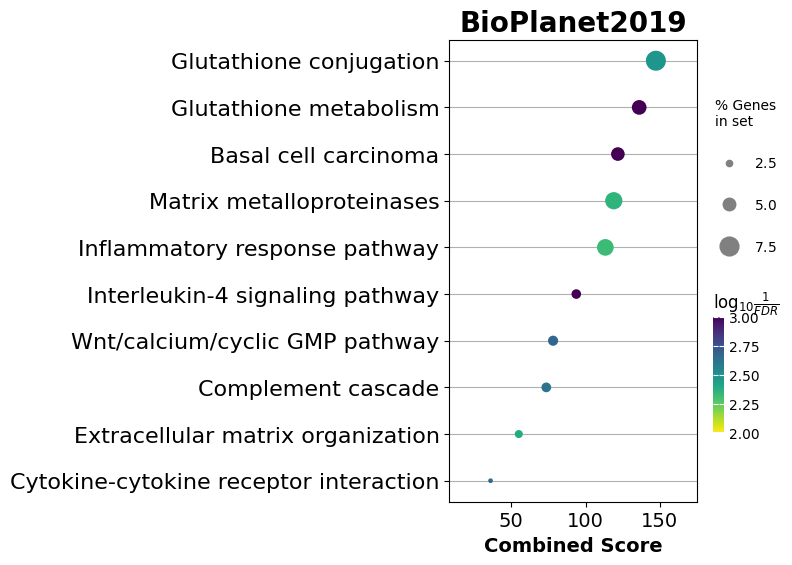

In [9]:
# Sort by Combined Score (descending) and take top 20
res_top20 = (
    res
    .sort_values("Combined Score", ascending=False)
    .head(30)
    .reset_index(drop=True)
)

import gseapy as gp
from gseapy.plot import dotplot
import matplotlib.pyplot as plt

# Make a copy so your original results stay intact
enr_copy = enr_res_tgfbr2

# Replace adjusted q-values with raw p-values
enr_copy.res2d['Adjusted P-value'] = enr_copy.res2d['P-value']

# Now dotplot will use your chosen P-value cutoff (instead of q-value)
ax = dotplot(
    enr_copy.res2d,
    title='BioPlanet2019',
    cmap='viridis_r',
    size=20,
    figsize=(4,6),
    cutoff=0.05   # NOW applies to P-values
)

# Get colorbar from the figure
fig = ax.get_figure()
for obj in fig.axes:
    if hasattr(obj, 'get_ylabel'):
        if obj.get_ylabel() == 'log10(1 / FDR)':
            obj.set_ylabel('log10(1 / P-value)', fontsize=10)


plt.show()

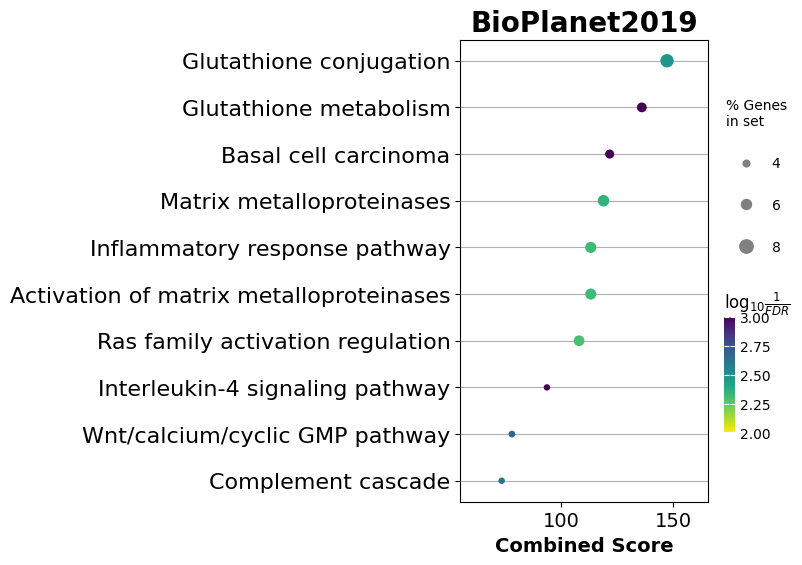

In [16]:
res_top30 = (
    enr_copy.res2d
    .sort_values("Combined Score", ascending=False)
    .head(30)
    .reset_index(drop=True)
)

# overwrite Adjusted P-value WITHIN this filtered table
res_top30["Adjusted P-value"] = res_top30["P-value"]

ax = dotplot(
    res_top30,            # ← ONLY feed the top30 table
    title='BioPlanet2019',
    cmap='viridis_r',
    size=20,
    figsize=(4,6),
    cutoff=10      # applied to P-values now
)
plt.show()

### periphery

✓ Saved alluvial_compact_ranked_1x2_gap_closed.html


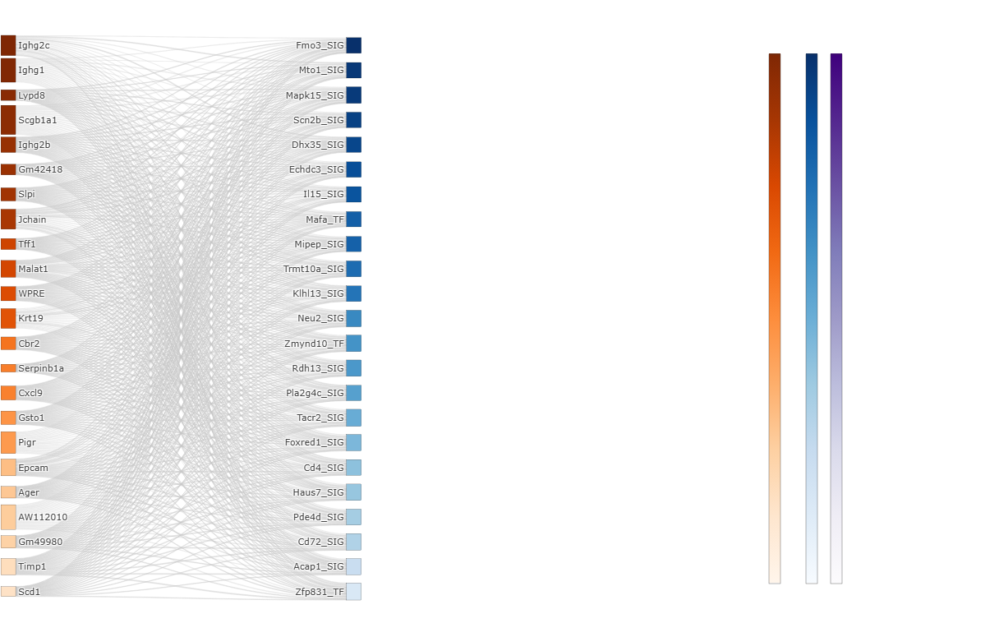

In [72]:
#!/usr/bin/env python3
"""
Compact 1x2 rank-ordered alluvial with the center gap closed.
- Overlaps the two Sankey domains a bit.
- Pins node columns tighter to the shared boundary.
- Removes link outlines to avoid a visible seam.
"""

import pandas as pd
import numpy as np
import plotly.graph_objects as go
from matplotlib import cm, colors as mpl_colors
from pathlib import Path

# ---------- LAYOUT KNOBS ----------
WIDTH        = 1300
HEIGHT       = 760
FONT_SIZE    = 11
NODE_THICK   = 18
NODE_PAD     = 14
V_SPREAD     = 0.88
COLORBAR_RM  = 210
EDGE_EPS     = 1e-4        # tighter pin to panel edges
PANEL_OVERLAP = 0.15       # 3% overlap to close the middle gap
# ----------------------------------

# ---------- USER INPUT ----------
CSV_PATHS = [
    Path("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251115_180250.csv"),
    # Path("../Mongoose_post_hoc/cluster3_niche_to_flux_for_sources_from_second_csv_KP11.csv"),
]
CLUSTERS     = None
MIN_WEIGHT   = 0.2
TOP_N_EDGES  = None
OUT_HTML     = "alluvial_compact_ranked_1x2_gap_closed.html"
SHOW_FIG     = True
# ---------------------------------

# ---------- helpers ----------
def to_hex(v01, cmap="Oranges"):
    rgba = cm.get_cmap(cmap)(float(np.clip(v01, 0, 1)))
    return mpl_colors.to_hex(rgba)

def side_colors(names, ranks, cmap, fallback_intensity=0.4):
    arr = np.array(ranks, dtype=float)
    finite = np.isfinite(arr)
    if finite.any():
        rmin, rmax = np.nanmin(arr[finite]), np.nanmax(arr[finite])
        span = (rmax - rmin) if rmax != rmin else 1.0
        v01  = np.where(finite, (rmax - arr) / span, np.nan)  # best→1
        v01  = np.nan_to_num(v01, nan=0.15)
        v01  = 0.15 + 0.85 * v01
    else:
        v01 = np.full(len(names), fallback_intensity)
    return [to_hex(v, cmap) for v in v01], v01

def order_by_rank(names, best_series):
    recs = [(n, best_series.get(n, np.inf)) for n in names]
    recs.sort(key=lambda t: (not np.isfinite(t[1]), t[1]))  # NaNs last
    ordered_names  = [n for n, _ in recs]
    ordered_ranks  = [r if np.isfinite(r) else np.nan for _, r in recs]
    return ordered_names, ordered_ranks

def _normalize_columns(df):
    return df.rename(columns={
        "Cluster":"cluster","Source":"source","Target":"target","Value":"value","Direction":"direction",
        "Niche_rank":"niche_rank","Activity_rank":"activity_rank","Flux_rank":"flux_rank"
    })

def _detect_panel_and_rank_col(df):
    cols = set(df.columns)
    if "activity_rank" in cols: return "activity","activity_rank","Blues"
    if "flux_rank"     in cols: return "flux","flux_rank","Purples"
    if "direction" in cols:
        ups = df["direction"].astype(str).str.upper()
        if ups.str.contains("FLUX").any():     return "flux","flux_rank","Purples"
        if ups.str.contains("ACTIVITY").any(): return "activity","activity_rank","Blues"
    if "target" in cols and df["target"].astype(str).head(20).str.contains(r"[() ]").mean() > 0.2:
        return "flux","flux_rank","Purples"
    return "activity","activity_rank","Blues"

def _local_y_positions(n, v_spread=0.88):
    if n <= 1: return [0.5]
    top    = (1.0 - v_spread) / 2.0
    bottom = 1.0 - top
    return np.linspace(top, bottom, n).tolist()

def _to_domain_coords(local_vals, dom_lo, dom_hi):
    span = dom_hi - dom_lo
    return [dom_lo + v * span for v in local_vals]

# ---------- core ----------
def build_sankey_for_domain(csv_path, domain, clusters=None, min_weight=0.5, top_n_edges=None):
    df = pd.read_csv(csv_path)
    df = _normalize_columns(df)

    need = {"source","target","value"}
    miss = need - set(df.columns)
    if miss: raise ValueError(f"{csv_path.name}: Missing columns: {miss}")

    if clusters is not None and "cluster" in df.columns:
        df = df[df["cluster"].isin(clusters)].copy()

    for c in ["value","niche_rank","activity_rank","flux_rank"]:
        if c in df.columns: df[c] = pd.to_numeric(df[c], errors="coerce")

    df = df.dropna(subset=["source","target","value"])
    if df.empty: raise SystemExit(f"{csv_path.name}: no rows after cleaning.")

    panel_type, tgt_rank_col, tgt_cmap = _detect_panel_and_rank_col(df)
    if "niche_rank" not in df.columns:
        raise ValueError(f"{csv_path.name}: Missing 'niche_rank'.")

    edges = (df.groupby(["source","target"], as_index=False)["value"].sum()
               .sort_values("value", ascending=False))
    edges = edges[edges["value"] >= min_weight]
    if top_n_edges: edges = edges.head(top_n_edges)
    if edges.empty: raise SystemExit(f"{csv_path.name}: no edges — relax MIN_WEIGHT/top_n.")

    src_best = df.groupby("source")["niche_rank"].min()
    tgt_best = df.groupby("target")[tgt_rank_col].min() if tgt_rank_col in df.columns else pd.Series(dtype=float)

    src_u = edges["source"].astype(str).unique()
    tgt_u = edges["target"].astype(str).unique()
    ordered_sources, src_ranks = order_by_rank(src_u, src_best)
    if len(tgt_best) == 0:
        ordered_targets, tgt_ranks = list(tgt_u), [np.nan]*len(tgt_u)
    else:
        ordered_targets, tgt_ranks = order_by_rank(tgt_u, tgt_best)

    src_colors, _ = side_colors(ordered_sources, src_ranks, "Oranges")
    tgt_colors, _ = side_colors(ordered_targets, tgt_ranks, tgt_cmap, fallback_intensity=0.5)
    node_colors   = src_colors + tgt_colors

    # domain-aware positions (flush to edges)
    x0, x1 = domain["x"]; y0, y1 = domain["y"]
    ys_left_local  = _local_y_positions(len(ordered_sources), V_SPREAD)
    ys_right_local = _local_y_positions(len(ordered_targets), V_SPREAD)
    ys_left  = _to_domain_coords(ys_left_local,  y0, y1)
    ys_right = _to_domain_coords(ys_right_local, y0, y1)

    xs_left_col  = [x0 + EDGE_EPS] * len(ordered_sources)
    xs_right_col = [x1 - EDGE_EPS] * len(ordered_targets)

    nodes  = ordered_sources + ordered_targets
    node_x = xs_left_col + xs_right_col
    node_y = ys_left + ys_right
    node_idx = {n: i for i, n in enumerate(nodes)}

    edges_sorted = edges.copy()
    edges_sorted["source_idx"] = edges_sorted["source"].astype(str).map(node_idx)
    edges_sorted["target_idx"] = edges_sorted["target"].astype(str).map(node_idx)
    edges_sorted = edges_sorted.sort_values(["source_idx","target_idx"])

    sankey = go.Sankey(
        arrangement="fixed",
        node=dict(
            pad=NODE_PAD, thickness=NODE_THICK, line=dict(color="black", width=0.2),
            label=nodes, color=node_colors,
            x=node_x, y=node_y,
            hovertemplate="%{label}<extra></extra>",
        ),
        link=dict(
            source=edges_sorted["source_idx"].tolist(),
            target=edges_sorted["target_idx"].tolist(),
            value =edges_sorted["value"].astype(float).tolist(),
            color =["rgba(200,200,200,0.35)"] * len(edges_sorted),
            line=dict(width=0),  # no link outline → no seam
            hovertemplate="Source: %{source.label}<br>Target: %{target.label}<br>Weight: %{value:.3g}<extra></extra>",
        ),
    )
    return sankey

def add_shared_colorbars(fig):
    cb_len = 0.88
    x_positions = [0.92, 0.965, 0.995]  # Oranges, Blues, Purples
    def _bar(xpos, colorscale):
        fig.add_trace(go.Scatter(
            x=[None], y=[None], mode="markers",
            marker=dict(size=0.1, color=[2], cmin=1, cmax=2, colorscale=colorscale,
                        showscale=True,
                        colorbar=dict(title="", x=xpos, xanchor="left",
                                      len=cb_len, thickness=14, outlinewidth=0.4,
                                      ticks="", showticklabels=False)),
            hoverinfo="skip", showlegend=False,
        ))
    _bar(x_positions[0], "Oranges")
    _bar(x_positions[1], "Blues")
    _bar(x_positions[2], "Purples")

# ---------- build compact 1x2 figure ----------
def main():
    fig = go.Figure()

    # Overlap the domains around the center to visually close the gap
    left_end    = 0.50 + PANEL_OVERLAP
    right_start = 0.50 - PANEL_OVERLAP

    domains = [
        dict(x=[0.00, left_end],     y=[0.00, 1.00]),
        dict(x=[right_start, 0.90],  y=[0.00, 1.00]),
    ]
    margin = dict(l=10, r=COLORBAR_RM, t=10, b=10)

    for i, csv_path in enumerate(CSV_PATHS):
        tr = build_sankey_for_domain(
            csv_path=csv_path, domain=domains[i],
            clusters=CLUSTERS, min_weight=MIN_WEIGHT, top_n_edges=TOP_N_EDGES
        )
        tr.domain = domains[i]
        fig.add_trace(tr)

    add_shared_colorbars(fig)

    fig.update_layout(
        font=dict(size=FONT_SIZE),
        height=HEIGHT, width=WIDTH, margin=margin,
        template="none", paper_bgcolor="rgba(0,0,0,0)", plot_bgcolor="rgba(0,0,0,0)",
    )
    fig.update_xaxes(visible=False); fig.update_yaxes(visible=False)

    fig.write_html(OUT_HTML, include_plotlyjs="cdn")
    print(f"✓ Saved {OUT_HTML}")
    if SHOW_FIG:
        fig.show()

if __name__ == "__main__":
    main()


In [17]:
import pandas as pd

# Load the file
df = pd.read_csv("../Mongoose_post_hoc/niche_to_activity_shap_edges_with_ranks_clusters45_20251115_180250.csv")

# Cleaning function
def clean_gene(x):
    x = str(x)
    return x.replace("_SIG", "").replace("_TF", "")

# Clean both columns
df["Source_clean"] = df["source"].apply(clean_gene)
df["Target_clean"] = df["target"].apply(clean_gene)

# Combine → unique genes
all_genes = sorted(set(df["Source_clean"]).union(set(df["Target_clean"])))

# Print line-by-line
for g in all_genes:
    print(g)

print("\nTotal genes:", len(all_genes))

AW112010
Acap1
Ager
Cbr2
Cd4
Cd72
Cxcl9
Dhx35
Echdc3
Epcam
Fmo3
Foxred1
Gm42418
Gm49980
Gsto1
Haus7
Ighg1
Ighg2b
Ighg2c
Il15
Jchain
Klhl13
Krt19
Lypd8
Mafa
Malat1
Mapk15
Mipep
Mto1
Neu2
Pde4d
Pigr
Pla2g4c
Rdh13
Scd1
Scgb1a1
Scn2b
Serpinb1a
Slpi
Tacr2
Tff1
Timp1
Trmt10a
WPRE
Zfp831
Zmynd10

Total genes: 46


In [18]:
enr_res_tgfbr2 = gp.enrichr(
    gene_list=all_genes,
    gene_sets='BioPlanet_2019',  # or another library if you prefer
    cutoff=0.05                          # keeps only significant terms
)

# The results dataframe
res = enr_res_tgfbr2.results
print(res.head())
print(res.columns)

         Gene_set                                          Term Overlap  \
0  BioPlanet_2019           Leptin influence on immune response   3/110   
1  BioPlanet_2019           Cytokines and inflammatory response    2/35   
2  BioPlanet_2019      Interleukin-23-mediated signaling events    2/37   
3  BioPlanet_2019                                 HNF3A pathway    2/44   
4  BioPlanet_2019  Intestinal immune network for IgA production    2/48   

    P-value  Adjusted P-value  Old P-value  Old Adjusted P-value  Odds Ratio  \
0  0.002069          0.162162            0                     0   12.940882   
1  0.002934          0.162162            0                     0   27.439394   
2  0.003274          0.162162            0                     0   25.868831   
3  0.004604          0.162162            0                     0   21.549784   
4  0.005458          0.162162            0                     0   19.671937   

   Combined Score           Genes  
0       79.983752  CD4;IL15;TIMP

In [21]:
res.head(40)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,BioPlanet_2019,Leptin influence on immune response,3/110,0.002069,0.162162,0,0,12.940882,79.983752,CD4;IL15;TIMP1
1,BioPlanet_2019,Cytokines and inflammatory response,2/35,0.002934,0.162162,0,0,27.439394,160.010169,CD4;IL15
2,BioPlanet_2019,Interleukin-23-mediated signaling events,2/37,0.003274,0.162162,0,0,25.868831,148.010991,CXCL9;CD4
3,BioPlanet_2019,HNF3A pathway,2/44,0.004604,0.162162,0,0,21.549784,115.956336,SCGB1A1;TFF1
4,BioPlanet_2019,Intestinal immune network for IgA production,2/48,0.005458,0.162162,0,0,19.671937,102.505202,PIGR;IL15
5,BioPlanet_2019,RAGE pathway,2/60,0.008416,0.162162,0,0,15.592476,74.495821,TIMP1;AGER
6,BioPlanet_2019,Catalytic cycle of mammalian FMOs,1/5,0.011448,0.162162,0,0,110.833333,495.415956,FMO3
7,BioPlanet_2019,Tachykinin receptors bind tachykinins,1/5,0.011448,0.162162,0,0,110.833333,495.415956,TACR2
8,BioPlanet_2019,Seven transmembrane receptor signaling through...,2/74,0.012583,0.162162,0,0,12.551768,54.918831,PDE4D;MAPK15
9,BioPlanet_2019,Antigen-activated B-cell receptor generation o...,3/211,0.012594,0.162162,0,0,6.623211,28.973361,CD4;CD72;MAPK15


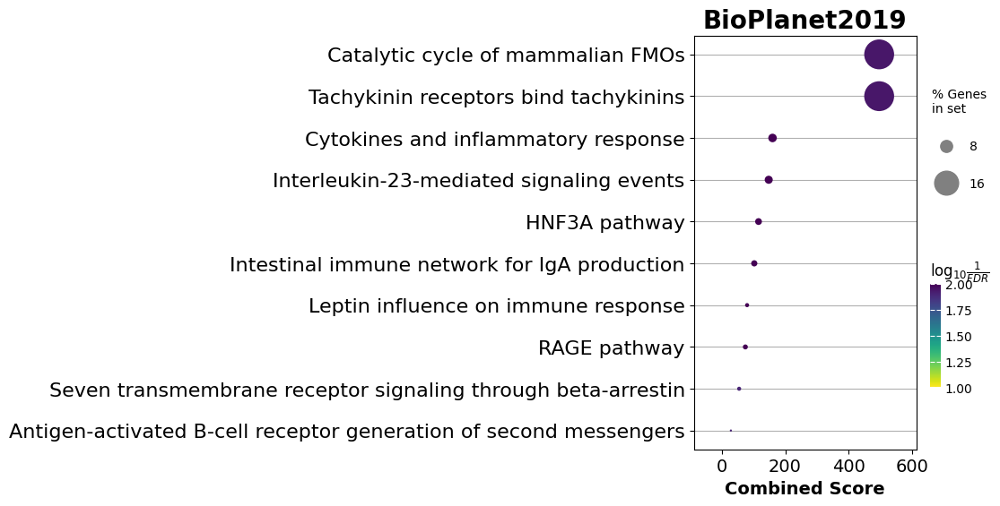

In [19]:
# Sort by Combined Score (descending) and take top 20
res_top20 = (
    res
    .sort_values("Combined Score", ascending=False)
    .head(30)
    .reset_index(drop=True)
)

import gseapy as gp
from gseapy.plot import dotplot
import matplotlib.pyplot as plt

# Make a copy so your original results stay intact
enr_copy = enr_res_tgfbr2

# Replace adjusted q-values with raw p-values
enr_copy.res2d['Adjusted P-value'] = enr_copy.res2d['P-value']

# Now dotplot will use your chosen P-value cutoff (instead of q-value)
ax = dotplot(
    enr_copy.res2d,
    title='BioPlanet2019',
    cmap='viridis_r',
    size=20,
    figsize=(4,6),
    cutoff=0.05   # NOW applies to P-values
)

# Get colorbar from the figure
fig = ax.get_figure()
for obj in fig.axes:
    if hasattr(obj, 'get_ylabel'):
        if obj.get_ylabel() == 'log10(1 / FDR)':
            obj.set_ylabel('log10(1 / P-value)', fontsize=10)


plt.show()

# Ablation study: Using GenKI on RNA modality

## KP1_1

### RNA

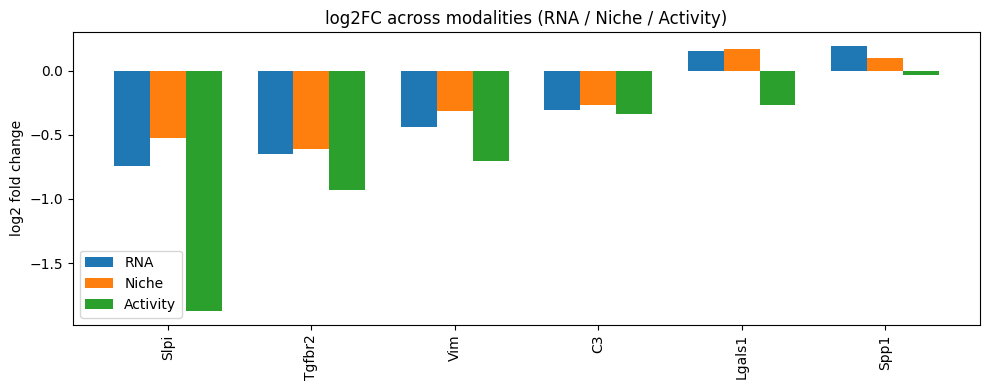

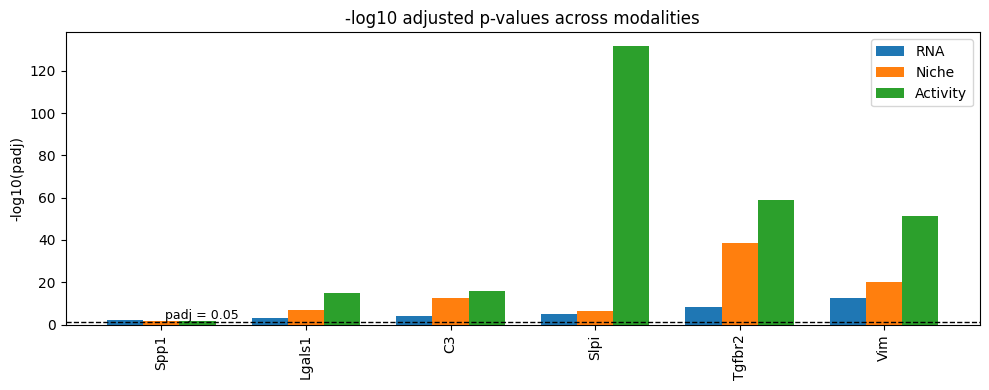

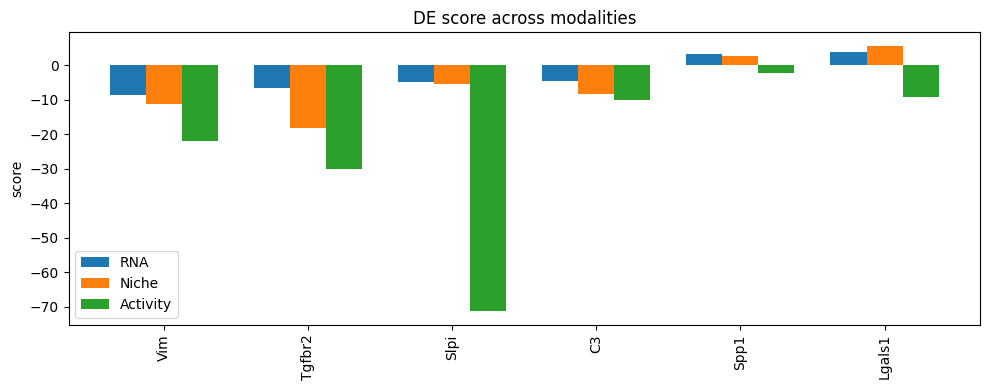

In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_20251115_224145/ALL_Significant_Genes_Combined.csv",
    index_col=0
)

deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe indices ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

# =====================
# 2. Rename DEG columns
# =====================
# assume columns: names, scores, logfoldchanges, pvals, pvals_adj
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})

deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})

deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. Merge everything
# =====================
# genes present in all three DEGs + all_sig
common_genes = (
    all_sig.index
    .intersection(deg_rna.index)
    .intersection(deg_niche.index)
    .intersection(deg_activity.index)
)

merged = all_sig.loc[common_genes].copy()

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

# -log10(padj) per modality
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col])

# =====================
# helper for grouped barplots
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title, sort_col=None):
    # sort by chosen column if available
    if sort_col is not None and sort_col in df.columns:
        df_plot = df.sort_values(sort_col)
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(10, len(genes) * 0.35), 4))
    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width, df_plot[c], width, label=lab, color=colr)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 4. log2FC concordance
# =====================
logfc_cols   = ["logFC_rna", "logFC_niche", "logFC_activity"]
logfc_labels = ["RNA", "Niche", "Activity"]
logfc_colors = ["tab:blue", "tab:orange", "tab:green"]

grouped_barplot(
    merged,
    cols=logfc_cols,
    labels=logfc_labels,
    colors=logfc_colors,
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_col="logFC_rna"  # change to another if you prefer
)

# =====================
# 5. -log10(padj) concordance
# =====================
padj_cols   = ["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"]
padj_labels = ["RNA", "Niche", "Activity"]
padj_colors = ["tab:blue", "tab:orange", "tab:green"]

# custom grouped barplot with the horizontal dotted line
def padj_barplot(df, cols, labels, colors, sort_col=None):
    if sort_col is not None and sort_col in df.columns:
        df_plot = df.sort_values(sort_col)
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(10, len(genes) * 0.35), 4))
    
    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width, df_plot[c], width, label=lab, color=colr)

    # --- significance cutoff line (padj = 0.05 → -log10 ≈ 1.3010) ---
    plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
    plt.text(0, 1.32, " padj = 0.05 ", ha="left", va="bottom", fontsize=9, color="black")

    plt.xticks(x, genes, rotation=90)
    plt.ylabel("-log10(padj)")
    plt.title("-log10 adjusted p-values across modalities")
    plt.legend()
    plt.tight_layout()
    plt.show()

# Run the updated plot
padj_barplot(
    merged,
    cols=padj_cols,
    labels=padj_labels,
    colors=padj_colors,
    sort_col="-log10_padj_rna"
)


# =====================
# 6. Score concordance (from DEG tables)
# =====================
score_cols   = ["score_rna", "score_niche", "score_activity"]
score_labels = ["RNA", "Niche", "Activity"]
score_colors = ["tab:blue", "tab:orange", "tab:green"]

grouped_barplot(
    merged,
    cols=score_cols,
    labels=score_labels,
    colors=score_colors,
    ylabel="score",
    title="DE score across modalities",
    sort_col="score_rna"
)


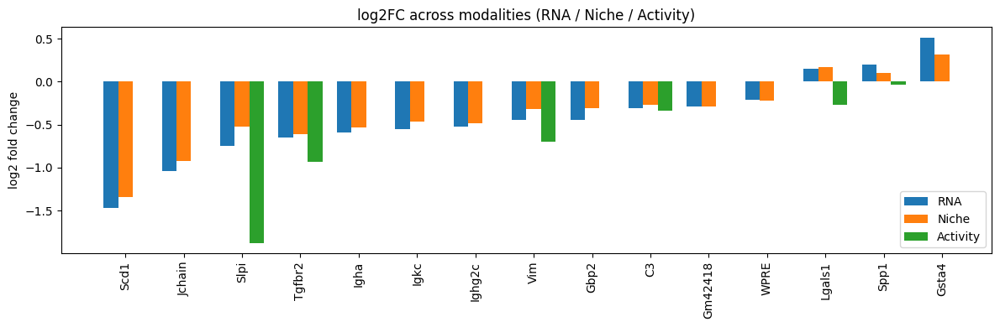

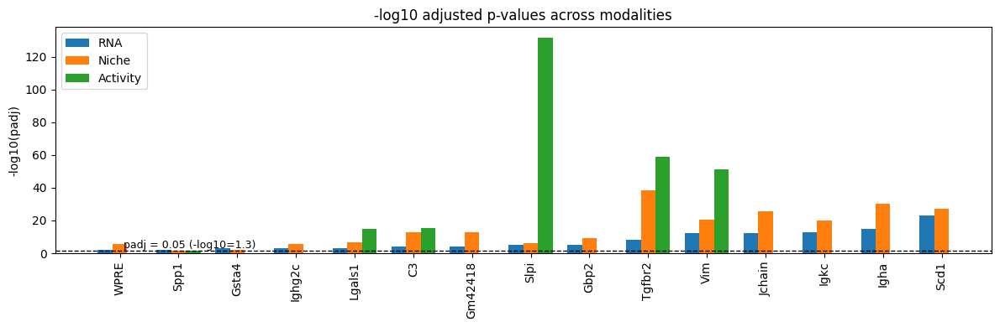

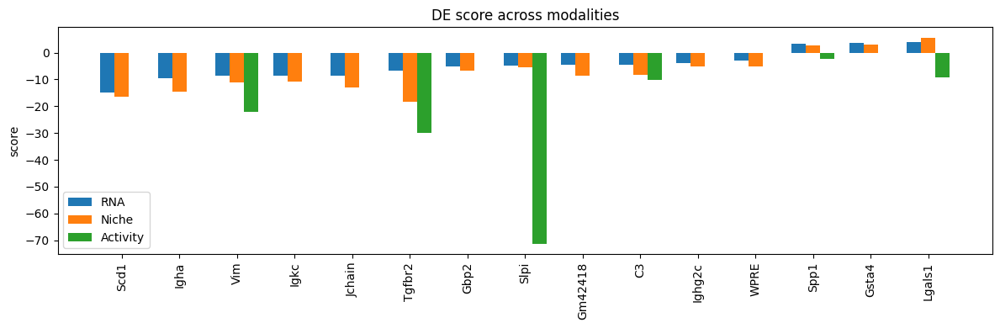

In [23]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_20251115_224145/ALL_Significant_Genes_Combined.csv",
    index_col=0
)

deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

# =====================
# 2. Rename columns
# =====================
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})

deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})

deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. MERGE using UNION of DEGs
# =====================

# Genes that are DE in ANY modality
genes_union_deg = (
    deg_rna.index
    .union(deg_niche.index)
    .union(deg_activity.index)
)

# ONLY keep genes that also appear in all_sig
common_genes = all_sig.index.intersection(genes_union_deg)

# Build merged table
merged = all_sig.loc[common_genes].copy()

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

# Add -log10(padj)
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col])

# =====================
# helper for grouped barplots
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title, dotted_line=False, sort_col=None):
    if sort_col is not None and sort_col in df.columns:
        df_plot = df.sort_values(sort_col)
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(12, len(genes) * 0.35), 4))

    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width, df_plot[c], width, label=lab, color=colr)

    # add dotted line if required
    if dotted_line:
        plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
        plt.text(0, 1.34, " padj = 0.05 (-log10=1.3) ", ha="left", va="bottom", fontsize=9)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 4. Plots
# =====================

### log2FC
grouped_barplot(
    merged,
    cols=["logFC_rna", "logFC_niche", "logFC_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_col="logFC_rna"
)

### -log10(padj)
grouped_barplot(
    merged,
    cols=["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="-log10(padj)",
    title="-log10 adjusted p-values across modalities",
    dotted_line=True,
    sort_col="-log10_padj_rna"
)

### scores
grouped_barplot(
    merged,
    cols=["score_rna", "score_niche", "score_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="score",
    title="DE score across modalities",
    sort_col="score_rna"
)


all_sig genes: 20
genes after merge: 20


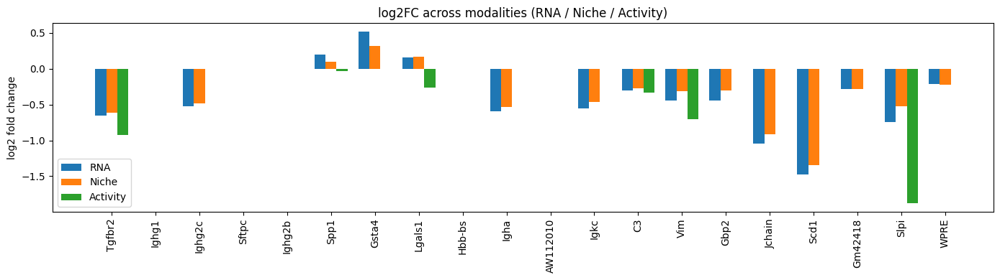

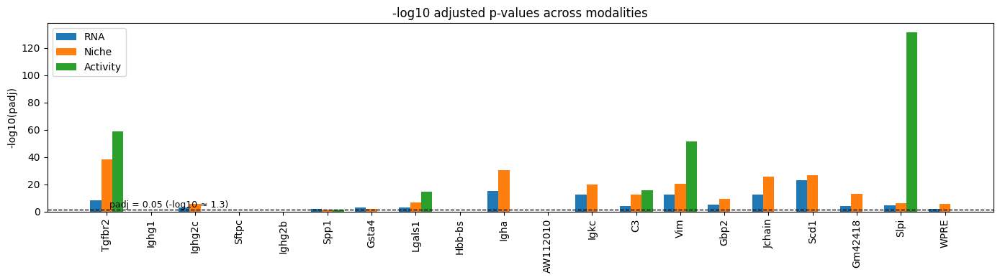

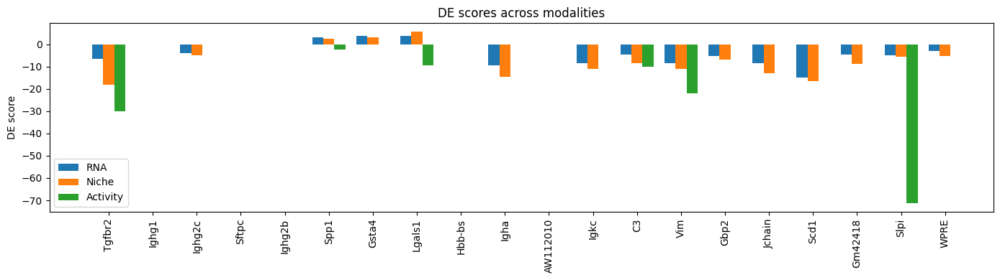

In [25]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_20251115_224145/ALL_Significant_Genes_Combined.csv",
    index_col=0
)

deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe indices (just in case) ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

print("all_sig genes:", len(all_sig))  # should be 79

# =====================
# 2. Rename DEG columns so they are modality-specific
# =====================
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})

deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})

deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. Merge WITHOUT dropping any all_sig genes
#    all_sig is the master list
# =====================
merged = all_sig.copy()  # all 79 genes

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

print("genes after merge:", len(merged))  # should still be 79

# add -log10(padj) per modality (avoid infs from 0)
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col].replace(0, np.nan))

# =====================
# helper for grouped barplots
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title,
                    dotted_line=False, sort_by=None):
    # keep gene order from all_sig unless a sort is requested
    if sort_by is not None and sort_by in df.columns:
        df_plot = df.sort_values(sort_by)
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(14, len(genes) * 0.35), 4))

    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width, df_plot[c], width, label=lab, color=colr)

    if dotted_line:
        plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
        plt.text(0, 1.34, " padj = 0.05 (-log10 ≈ 1.3) ",
                 ha="left", va="bottom", fontsize=9)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 4. Plots (all 79 genes)
#    If you prefer to keep the GenKI order, set sort_by=None.
#    If you want to sort by e.g. all_sig 'scores', use sort_by="scores".
# =====================

# log2FC across modalities
grouped_barplot(
    merged,
    cols=["logFC_rna", "logFC_niche", "logFC_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_by=None    # or "scores" if you want them ranked
)

# -log10(padj) across modalities, with significance line
grouped_barplot(
    merged,
    cols=["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="-log10(padj)",
    title="-log10 adjusted p-values across modalities",
    dotted_line=True,
    sort_by=None
)

# DEG scores across modalities
grouped_barplot(
    merged,
    cols=["score_rna", "score_niche", "score_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="DE score",
    title="DE scores across modalities",
    sort_by=None
)


### niche

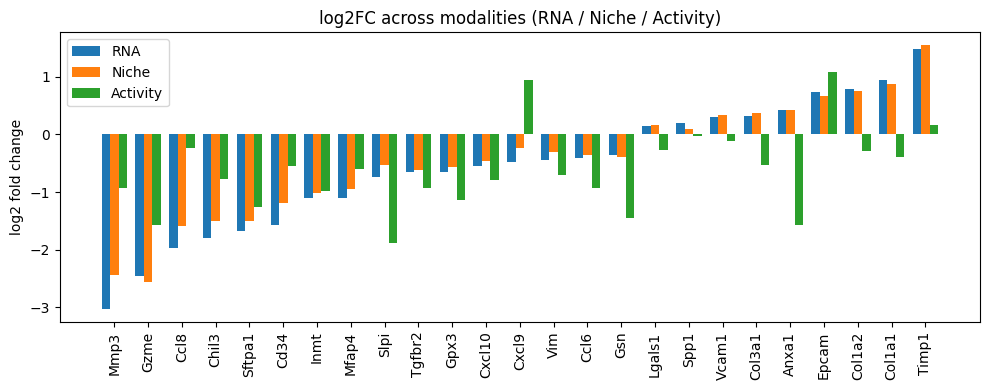

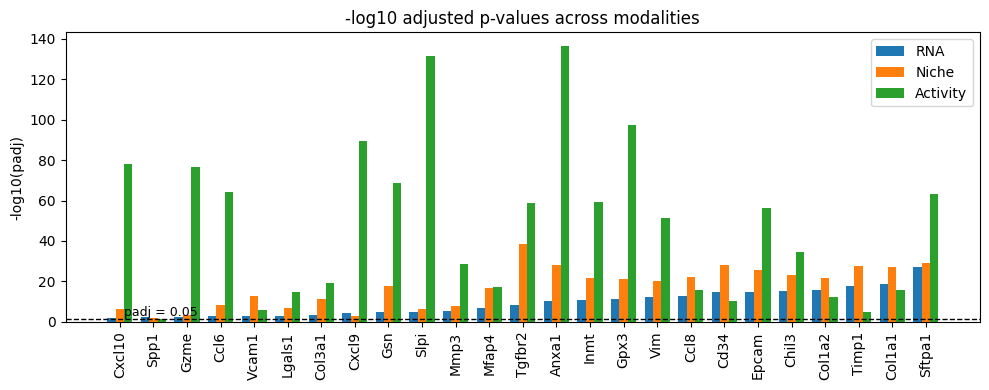

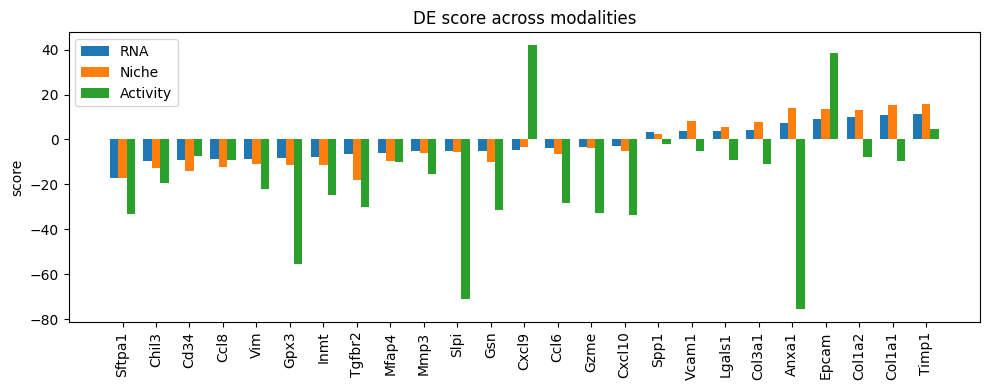

In [24]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_20251115_171757/ALL_Significant_Genes_Combined.csv",
    index_col=0
)

deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe indices ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

# =====================
# 2. Rename DEG columns
# =====================
# assume columns: names, scores, logfoldchanges, pvals, pvals_adj
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})

deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})

deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. Merge everything
# =====================
# genes present in all three DEGs + all_sig
common_genes = (
    all_sig.index
    .intersection(deg_rna.index)
    .intersection(deg_niche.index)
    .intersection(deg_activity.index)
)

merged = all_sig.loc[common_genes].copy()

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

# -log10(padj) per modality
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col])

# =====================
# helper for grouped barplots
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title, sort_col=None):
    # sort by chosen column if available
    if sort_col is not None and sort_col in df.columns:
        df_plot = df.sort_values(sort_col)
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(10, len(genes) * 0.35), 4))
    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width, df_plot[c], width, label=lab, color=colr)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 4. log2FC concordance
# =====================
logfc_cols   = ["logFC_rna", "logFC_niche", "logFC_activity"]
logfc_labels = ["RNA", "Niche", "Activity"]
logfc_colors = ["tab:blue", "tab:orange", "tab:green"]

grouped_barplot(
    merged,
    cols=logfc_cols,
    labels=logfc_labels,
    colors=logfc_colors,
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_col="logFC_rna"  # change to another if you prefer
)

# =====================
# 5. -log10(padj) concordance
# =====================
padj_cols   = ["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"]
padj_labels = ["RNA", "Niche", "Activity"]
padj_colors = ["tab:blue", "tab:orange", "tab:green"]

# custom grouped barplot with the horizontal dotted line
def padj_barplot(df, cols, labels, colors, sort_col=None):
    if sort_col is not None and sort_col in df.columns:
        df_plot = df.sort_values(sort_col)
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(10, len(genes) * 0.35), 4))
    
    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width, df_plot[c], width, label=lab, color=colr)

    # --- significance cutoff line (padj = 0.05 → -log10 ≈ 1.3010) ---
    plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
    plt.text(0, 1.32, " padj = 0.05 ", ha="left", va="bottom", fontsize=9, color="black")

    plt.xticks(x, genes, rotation=90)
    plt.ylabel("-log10(padj)")
    plt.title("-log10 adjusted p-values across modalities")
    plt.legend()
    plt.tight_layout()
    plt.show()

# Run the updated plot
padj_barplot(
    merged,
    cols=padj_cols,
    labels=padj_labels,
    colors=padj_colors,
    sort_col="-log10_padj_rna"
)


# =====================
# 6. Score concordance (from DEG tables)
# =====================
score_cols   = ["score_rna", "score_niche", "score_activity"]
score_labels = ["RNA", "Niche", "Activity"]
score_colors = ["tab:blue", "tab:orange", "tab:green"]

grouped_barplot(
    merged,
    cols=score_cols,
    labels=score_labels,
    colors=score_colors,
    ylabel="score",
    title="DE score across modalities",
    sort_col="score_rna"
)


all_sig genes: 79
genes after merge: 79


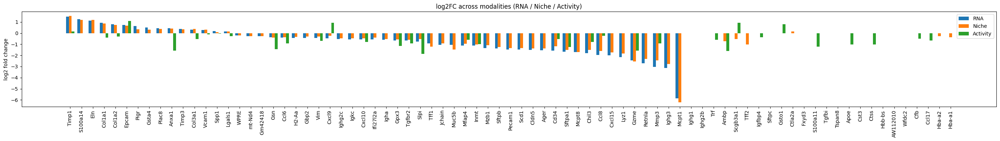

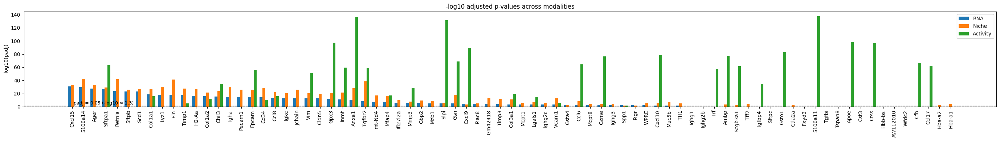

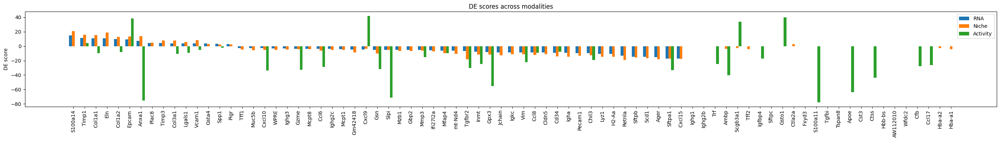

In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_20251115_171757/ALL_Significant_Genes_Combined.csv",
    index_col=0
)

deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe indices (just in case) ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

print("all_sig genes:", len(all_sig))  # should be 79

# =====================
# 2. Rename DEG columns so they are modality-specific
# =====================
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})

deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})

deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. Merge WITHOUT dropping any all_sig genes
#    all_sig is the master list
# =====================
merged = all_sig.copy()  # all 79 genes

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

print("genes after merge:", len(merged))  # should still be 79

# add -log10(padj) per modality (avoid infs from 0)
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col].replace(0, np.nan))

# =====================
# helper for grouped barplots (with sorting high → low)
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title,
                    dotted_line=False, sort_by=None, descending=True):
    # sort genes if requested
    if sort_by is not None and sort_by in df.columns:
        df_plot = df.sort_values(sort_by, ascending=not descending)
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(14, len(genes) * 0.35), 4))

    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width, df_plot[c], width, label=lab, color=colr)

    if dotted_line:
        plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
        plt.text(0, 1.34, " padj = 0.05 (-log10 ≈ 1.3) ",
                 ha="left", va="bottom", fontsize=9)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 4. Plots (all 79 genes, sorted)
# =====================

# log2FC across modalities – sorted by RNA logFC (high → low)
grouped_barplot(
    merged,
    cols=["logFC_rna", "logFC_niche", "logFC_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_by="logFC_rna",
    descending=True
)

# -log10(padj) across modalities – sorted by RNA -log10(padj) (most significant first)
grouped_barplot(
    merged,
    cols=["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="-log10(padj)",
    title="-log10 adjusted p-values across modalities",
    dotted_line=True,
    sort_by="-log10_padj_rna",
    descending=True
)

# DEG scores across modalities – sorted by RNA score (high → low)
grouped_barplot(
    merged,
    cols=["score_rna", "score_niche", "score_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="DE score",
    title="DE scores across modalities",
    sort_by="score_rna",
    descending=True
)


### activity

all_sig genes: 72
genes after merge: 72


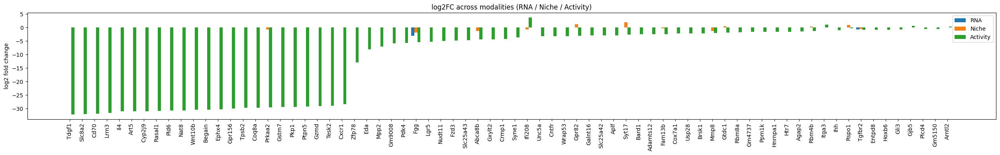

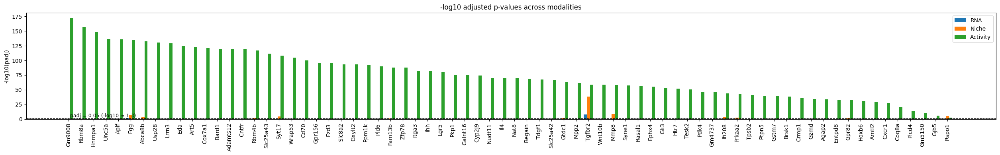

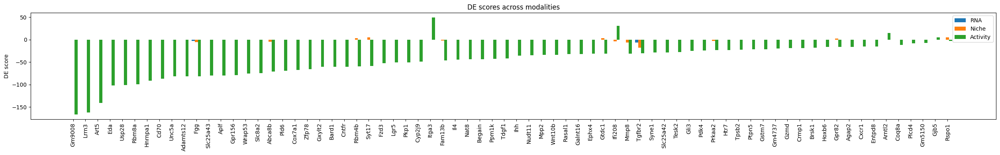

In [30]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_173901/ALL_Significant_Genes_Combined.csv",
    index_col=0
)
all_sig.index = all_sig.index.str.replace("_SIG","",regex=False)

deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)
deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)
deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-1/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe indices (just in case) ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

print("all_sig genes:", len(all_sig))  # should be 79

# =====================
# 2. Rename DEG columns so they are modality-specific
# =====================
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})
deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})
deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. Merge WITHOUT dropping any all_sig genes
# =====================
merged = all_sig.copy()  # all 79 genes

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

print("genes after merge:", len(merged))  # should still be 79

# add -log10(padj) per modality (avoid infs from 0)
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col].replace(0, np.nan))

# =====================
# 3b. Create sort keys: "big → small"
# =====================
# strongest |logFC| across any modality
merged["logFC_sort"] = merged[["logFC_rna", "logFC_niche", "logFC_activity"]].abs().max(axis=1)

# most significant p-value (largest -log10 padj)
merged["padj_sort"] = merged[["-log10_padj_rna",
                              "-log10_padj_niche",
                              "-log10_padj_activity"]].max(axis=1)

# strongest |score| across modalities
merged["score_sort"] = merged[["score_rna", "score_niche", "score_activity"]].abs().max(axis=1)

# =====================
# helper for grouped barplots (with sorting high → low)
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title,
                    dotted_line=False, sort_by=None, descending=True):
    if sort_by is not None and sort_by in df.columns:
        df_plot = df.sort_values(sort_by, ascending=not descending, na_position="last")
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(14, len(genes) * 0.35), 4))

    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width, df_plot[c], width, label=lab, color=colr)

    if dotted_line:
        plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
        plt.text(0, 1.34, " padj = 0.05 (-log10 ≈ 1.3) ",
                 ha="left", va="bottom", fontsize=9)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 4. Plots (all 79 genes, sorted big → small)
# =====================

# log2FC across modalities – sort by strongest |logFC| overall
grouped_barplot(
    merged,
    cols=["logFC_rna", "logFC_niche", "logFC_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_by="logFC_sort",
    descending=True
)

# -log10(padj) across modalities – sort by most significant p-value
grouped_barplot(
    merged,
    cols=["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="-log10(padj)",
    title="-log10 adjusted p-values across modalities",
    dotted_line=True,
    sort_by="padj_sort",
    descending=True
)

# DEG scores across modalities – sort by strongest |score|
grouped_barplot(
    merged,
    cols=["score_rna", "score_niche", "score_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="DE score",
    title="DE scores across modalities",
    sort_by="score_sort",
    descending=True
)


## Periphery

### RNA

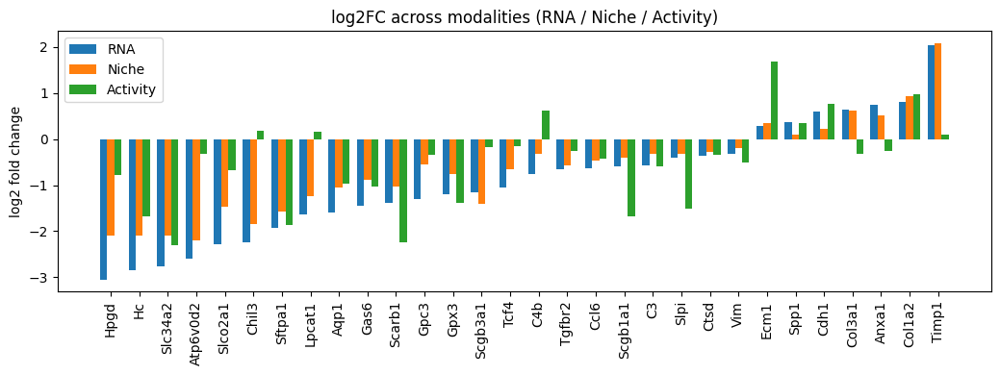

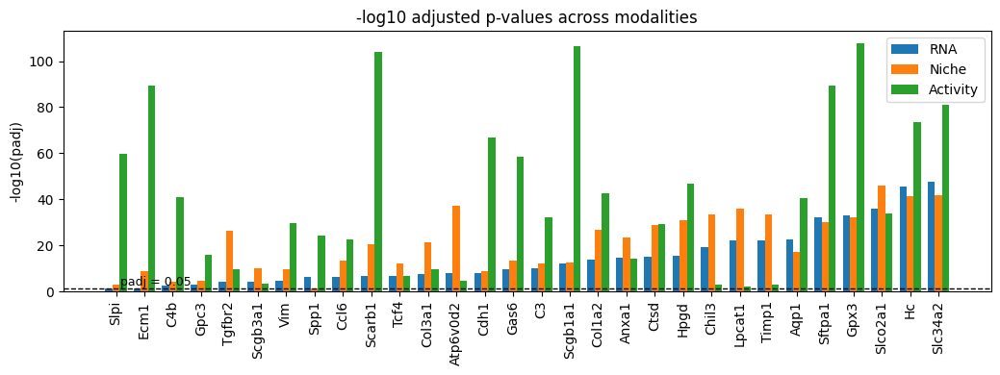

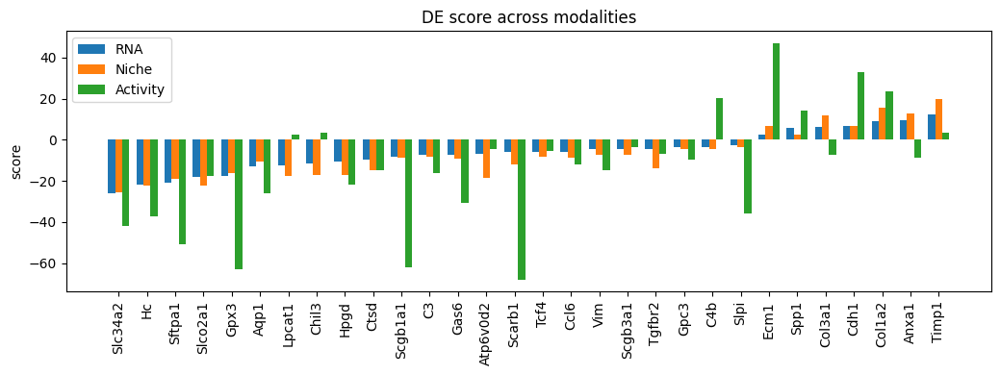

In [31]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_20251115_224749/ALL_Significant_Genes_Combined.csv",
    index_col=0
)

deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe indices ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

# =====================
# 2. Rename DEG columns
# =====================
# assume columns: names, scores, logfoldchanges, pvals, pvals_adj
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})

deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})

deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. Merge everything
# =====================
# genes present in all three DEGs + all_sig
common_genes = (
    all_sig.index
    .intersection(deg_rna.index)
    .intersection(deg_niche.index)
    .intersection(deg_activity.index)
)

merged = all_sig.loc[common_genes].copy()

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

# -log10(padj) per modality
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col])

# =====================
# helper for grouped barplots
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title, sort_col=None):
    # sort by chosen column if available
    if sort_col is not None and sort_col in df.columns:
        df_plot = df.sort_values(sort_col)
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(10, len(genes) * 0.35), 4))
    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width, df_plot[c], width, label=lab, color=colr)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 4. log2FC concordance
# =====================
logfc_cols   = ["logFC_rna", "logFC_niche", "logFC_activity"]
logfc_labels = ["RNA", "Niche", "Activity"]
logfc_colors = ["tab:blue", "tab:orange", "tab:green"]

grouped_barplot(
    merged,
    cols=logfc_cols,
    labels=logfc_labels,
    colors=logfc_colors,
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_col="logFC_rna"  # change to another if you prefer
)

# =====================
# 5. -log10(padj) concordance
# =====================
padj_cols   = ["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"]
padj_labels = ["RNA", "Niche", "Activity"]
padj_colors = ["tab:blue", "tab:orange", "tab:green"]

# custom grouped barplot with the horizontal dotted line
def padj_barplot(df, cols, labels, colors, sort_col=None):
    if sort_col is not None and sort_col in df.columns:
        df_plot = df.sort_values(sort_col)
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(10, len(genes) * 0.35), 4))
    
    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width, df_plot[c], width, label=lab, color=colr)

    # --- significance cutoff line (padj = 0.05 → -log10 ≈ 1.3010) ---
    plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
    plt.text(0, 1.32, " padj = 0.05 ", ha="left", va="bottom", fontsize=9, color="black")

    plt.xticks(x, genes, rotation=90)
    plt.ylabel("-log10(padj)")
    plt.title("-log10 adjusted p-values across modalities")
    plt.legend()
    plt.tight_layout()
    plt.show()

# Run the updated plot
padj_barplot(
    merged,
    cols=padj_cols,
    labels=padj_labels,
    colors=padj_colors,
    sort_col="-log10_padj_rna"
)


# =====================
# 6. Score concordance (from DEG tables)
# =====================
score_cols   = ["score_rna", "score_niche", "score_activity"]
score_labels = ["RNA", "Niche", "Activity"]
score_colors = ["tab:blue", "tab:orange", "tab:green"]

grouped_barplot(
    merged,
    cols=score_cols,
    labels=score_labels,
    colors=score_colors,
    ylabel="score",
    title="DE score across modalities",
    sort_col="score_rna"
)


all_sig genes: 105
genes after merge: 105


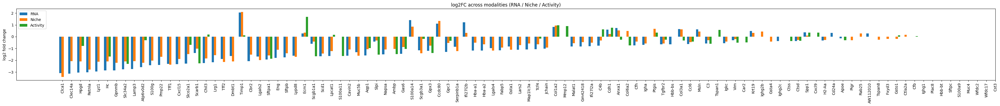

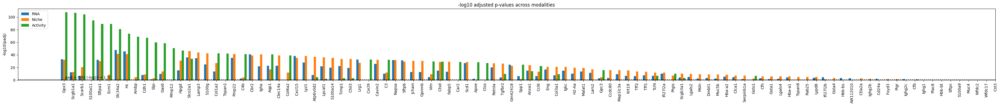

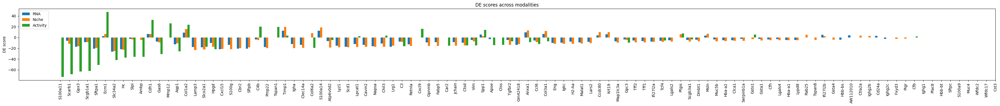

In [33]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_20251115_224749/ALL_Significant_Genes_Combined.csv",
    index_col=0
)

deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe indices (just in case) ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

print("all_sig genes:", len(all_sig))

# =====================
# 2. Rename DEG columns so they are modality-specific
# =====================
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})

deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})

deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. Merge WITHOUT dropping any all_sig genes
#    all_sig is the master list
# =====================
merged = all_sig.copy()

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

print("genes after merge:", len(merged))

# add -log10(padj) per modality (avoid infs from 0)
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col].replace(0, np.nan))

# =====================
# 4. Create sort keys (BIG → SMALL)
# =====================

# strongest |logFC| across modalities
merged["sort_logFC"] = merged[["logFC_rna", "logFC_niche", "logFC_activity"]].abs().max(axis=1)

# most significant p-value (largest -log10(padj))
merged["sort_padj"] = merged[["-log10_padj_rna",
                              "-log10_padj_niche",
                              "-log10_padj_activity"]].max(axis=1)

# strongest |score| across modalities
merged["sort_score"] = merged[["score_rna", "score_niche", "score_activity"]].abs().max(axis=1)

# =====================
# 5. Helper for grouped barplots (sorted high → low)
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title,
                    dotted_line=False, sort_by=None, descending=True):

    if sort_by is not None and sort_by in df.columns:
        df_plot = df.sort_values(sort_by, ascending=not descending, na_position="last")
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(14, len(genes) * 0.35), 4))

    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width,
                    df_plot[c],
                    width,
                    label=lab,
                    color=colr)

    if dotted_line:
        plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
        plt.text(0, 1.34, " padj = 0.05 (-log10 ≈ 1.3) ",
                 ha="left", va="bottom", fontsize=9)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 6. Plots (sorted big → small)
# =====================

# log2FC across modalities – sort by strongest |logFC|
grouped_barplot(
    merged,
    cols=["logFC_rna", "logFC_niche", "logFC_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_by="sort_logFC",
    descending=True
)

# -log10(padj) across modalities – sort by most significant p-value
grouped_barplot(
    merged,
    cols=["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="-log10(padj)",
    title="-log10 adjusted p-values across modalities",
    dotted_line=True,
    sort_by="sort_padj",
    descending=True
)

# DEG scores across modalities – sort by strongest |score|
grouped_barplot(
    merged,
    cols=["score_rna", "score_niche", "score_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="DE score",
    title="DE scores across modalities",
    sort_by="sort_score",
    descending=True
)

### niche

all_sig genes: 90
genes after merge: 90


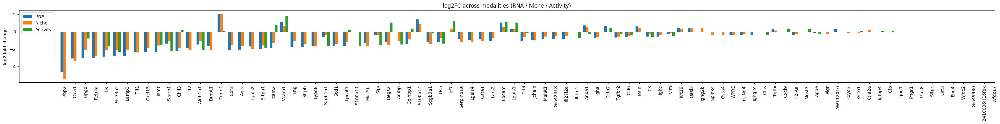

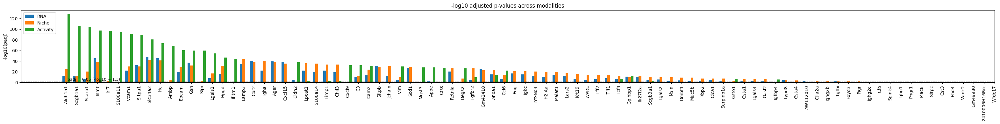

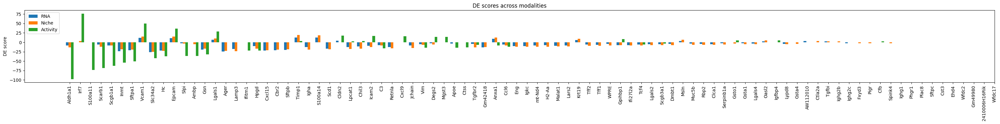

In [34]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_20251115_171959/ALL_Significant_Genes_Combined.csv",
    index_col=0
)

deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe indices (just in case) ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

print("all_sig genes:", len(all_sig))

# =====================
# 2. Rename DEG columns so they are modality-specific
# =====================
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})

deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})

deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. Merge WITHOUT dropping any all_sig genes
#    all_sig is the master list
# =====================
merged = all_sig.copy()

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

print("genes after merge:", len(merged))

# add -log10(padj) per modality (avoid infs from 0)
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col].replace(0, np.nan))

# =====================
# 4. Create sort keys (BIG → SMALL)
# =====================

# strongest |logFC| across modalities
merged["sort_logFC"] = merged[["logFC_rna", "logFC_niche", "logFC_activity"]].abs().max(axis=1)

# most significant p-value (largest -log10(padj))
merged["sort_padj"] = merged[["-log10_padj_rna",
                              "-log10_padj_niche",
                              "-log10_padj_activity"]].max(axis=1)

# strongest |score| across modalities
merged["sort_score"] = merged[["score_rna", "score_niche", "score_activity"]].abs().max(axis=1)

# =====================
# 5. Helper for grouped barplots (sorted high → low)
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title,
                    dotted_line=False, sort_by=None, descending=True):

    if sort_by is not None and sort_by in df.columns:
        df_plot = df.sort_values(sort_by, ascending=not descending, na_position="last")
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(14, len(genes) * 0.35), 4))

    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width,
                    df_plot[c],
                    width,
                    label=lab,
                    color=colr)

    if dotted_line:
        plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
        plt.text(0, 1.34, " padj = 0.05 (-log10 ≈ 1.3) ",
                 ha="left", va="bottom", fontsize=9)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 6. Plots (sorted big → small)
# =====================

# log2FC across modalities – sort by strongest |logFC|
grouped_barplot(
    merged,
    cols=["logFC_rna", "logFC_niche", "logFC_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_by="sort_logFC",
    descending=True
)

# -log10(padj) across modalities – sort by most significant p-value
grouped_barplot(
    merged,
    cols=["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="-log10(padj)",
    title="-log10 adjusted p-values across modalities",
    dotted_line=True,
    sort_by="sort_padj",
    descending=True
)

# DEG scores across modalities – sort by strongest |score|
grouped_barplot(
    merged,
    cols=["score_rna", "score_niche", "score_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="DE score",
    title="DE scores across modalities",
    sort_by="sort_score",
    descending=True
)

### activity

all_sig genes: 93
genes after merge: 93


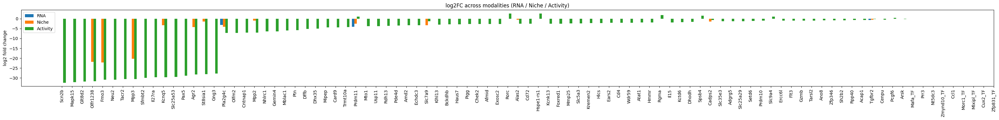

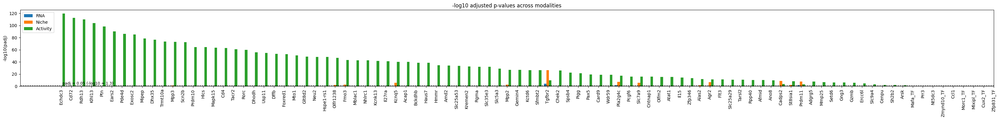

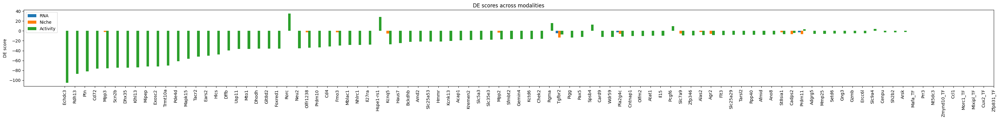

In [35]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_174028/ALL_Significant_Genes_Combined.csv",
    index_col=0
)
all_sig.index = all_sig.index.str.replace("_SIG","",regex=False)


deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_periphery/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe indices (just in case) ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

print("all_sig genes:", len(all_sig))  # should be 79

# =====================
# 2. Rename DEG columns so they are modality-specific
# =====================
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})
deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})
deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. Merge WITHOUT dropping any all_sig genes
# =====================
merged = all_sig.copy()  # all 79 genes

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

print("genes after merge:", len(merged))  # should still be 79

# add -log10(padj) per modality (avoid infs from 0)
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col].replace(0, np.nan))

# =====================
# 3b. Create sort keys: "big → small"
# =====================
# strongest |logFC| across any modality
merged["logFC_sort"] = merged[["logFC_rna", "logFC_niche", "logFC_activity"]].abs().max(axis=1)

# most significant p-value (largest -log10 padj)
merged["padj_sort"] = merged[["-log10_padj_rna",
                              "-log10_padj_niche",
                              "-log10_padj_activity"]].max(axis=1)

# strongest |score| across modalities
merged["score_sort"] = merged[["score_rna", "score_niche", "score_activity"]].abs().max(axis=1)

# =====================
# helper for grouped barplots (with sorting high → low)
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title,
                    dotted_line=False, sort_by=None, descending=True):
    if sort_by is not None and sort_by in df.columns:
        df_plot = df.sort_values(sort_by, ascending=not descending, na_position="last")
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(14, len(genes) * 0.35), 4))

    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width, df_plot[c], width, label=lab, color=colr)

    if dotted_line:
        plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
        plt.text(0, 1.34, " padj = 0.05 (-log10 ≈ 1.3) ",
                 ha="left", va="bottom", fontsize=9)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 4. Plots (all 79 genes, sorted big → small)
# =====================

# log2FC across modalities – sort by strongest |logFC| overall
grouped_barplot(
    merged,
    cols=["logFC_rna", "logFC_niche", "logFC_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_by="logFC_sort",
    descending=True
)

# -log10(padj) across modalities – sort by most significant p-value
grouped_barplot(
    merged,
    cols=["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="-log10(padj)",
    title="-log10 adjusted p-values across modalities",
    dotted_line=True,
    sort_by="padj_sort",
    descending=True
)

# DEG scores across modalities – sort by strongest |score|
grouped_barplot(
    merged,
    cols=["score_rna", "score_niche", "score_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="DE score",
    title="DE scores across modalities",
    sort_by="score_sort",
    descending=True
)


## KP1_2

## KP1_3

### rna

all_sig genes: 85
genes after merge: 85


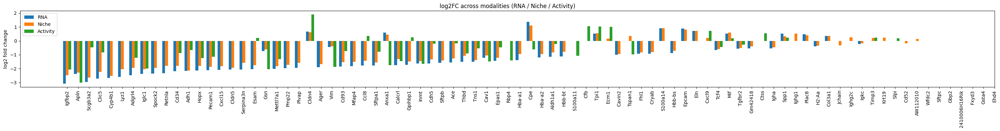

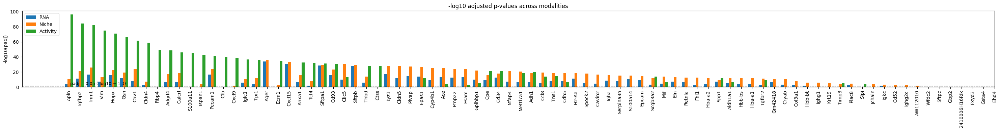

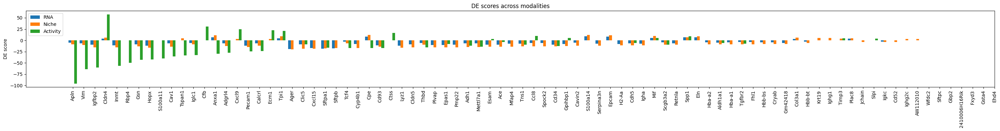

In [43]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_20251115_235015/ALL_Significant_Genes_Combined.csv",
    index_col=0
)

deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-3/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-3/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-3/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe indices (just in case) ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

print("all_sig genes:", len(all_sig))

# =====================
# 2. Rename DEG columns so they are modality-specific
# =====================
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})

deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})

deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. Merge WITHOUT dropping any all_sig genes
#    all_sig is the master list
# =====================
merged = all_sig.copy()

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

print("genes after merge:", len(merged))

# add -log10(padj) per modality (avoid infs from 0)
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col].replace(0, np.nan))

# =====================
# 4. Create sort keys (BIG → SMALL)
# =====================

# strongest |logFC| across modalities
merged["sort_logFC"] = merged[["logFC_rna", "logFC_niche", "logFC_activity"]].abs().max(axis=1)

# most significant p-value (largest -log10(padj))
merged["sort_padj"] = merged[["-log10_padj_rna",
                              "-log10_padj_niche",
                              "-log10_padj_activity"]].max(axis=1)

# strongest |score| across modalities
merged["sort_score"] = merged[["score_rna", "score_niche", "score_activity"]].abs().max(axis=1)

# =====================
# 5. Helper for grouped barplots (sorted high → low)
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title,
                    dotted_line=False, sort_by=None, descending=True):

    if sort_by is not None and sort_by in df.columns:
        df_plot = df.sort_values(sort_by, ascending=not descending, na_position="last")
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(14, len(genes) * 0.35), 4))

    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width,
                    df_plot[c],
                    width,
                    label=lab,
                    color=colr)

    if dotted_line:
        plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
        plt.text(0, 1.34, " padj = 0.05 (-log10 ≈ 1.3) ",
                 ha="left", va="bottom", fontsize=9)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 6. Plots (sorted big → small)
# =====================

# log2FC across modalities – sort by strongest |logFC|
grouped_barplot(
    merged,
    cols=["logFC_rna", "logFC_niche", "logFC_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_by="sort_logFC",
    descending=True
)

# -log10(padj) across modalities – sort by most significant p-value
grouped_barplot(
    merged,
    cols=["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="-log10(padj)",
    title="-log10 adjusted p-values across modalities",
    dotted_line=True,
    sort_by="sort_padj",
    descending=True
)

# DEG scores across modalities – sort by strongest |score|
grouped_barplot(
    merged,
    cols=["score_rna", "score_niche", "score_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="DE score",
    title="DE scores across modalities",
    sort_by="sort_score",
    descending=True
)

### niche

all_sig genes: 68
genes after merge: 68


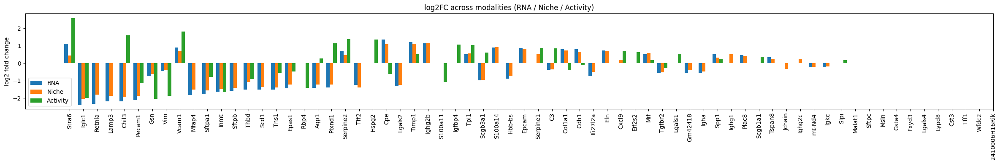

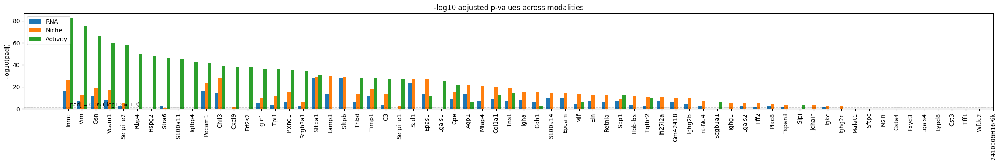

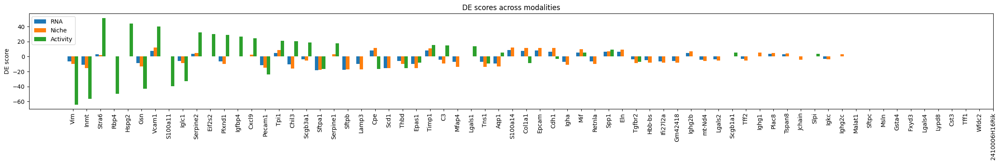

In [44]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_20251115_172120/ALL_Significant_Genes_Combined.csv",
    index_col=0
)

deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-3/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-3/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-3/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe indices (just in case) ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

print("all_sig genes:", len(all_sig))

# =====================
# 2. Rename DEG columns so they are modality-specific
# =====================
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})

deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})

deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. Merge WITHOUT dropping any all_sig genes
#    all_sig is the master list
# =====================
merged = all_sig.copy()

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

print("genes after merge:", len(merged))

# add -log10(padj) per modality (avoid infs from 0)
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col].replace(0, np.nan))

# =====================
# 4. Create sort keys (BIG → SMALL)
# =====================

# strongest |logFC| across modalities
merged["sort_logFC"] = merged[["logFC_rna", "logFC_niche", "logFC_activity"]].abs().max(axis=1)

# most significant p-value (largest -log10(padj))
merged["sort_padj"] = merged[["-log10_padj_rna",
                              "-log10_padj_niche",
                              "-log10_padj_activity"]].max(axis=1)

# strongest |score| across modalities
merged["sort_score"] = merged[["score_rna", "score_niche", "score_activity"]].abs().max(axis=1)

# =====================
# 5. Helper for grouped barplots (sorted high → low)
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title,
                    dotted_line=False, sort_by=None, descending=True):

    if sort_by is not None and sort_by in df.columns:
        df_plot = df.sort_values(sort_by, ascending=not descending, na_position="last")
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(14, len(genes) * 0.35), 4))

    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width,
                    df_plot[c],
                    width,
                    label=lab,
                    color=colr)

    if dotted_line:
        plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
        plt.text(0, 1.34, " padj = 0.05 (-log10 ≈ 1.3) ",
                 ha="left", va="bottom", fontsize=9)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 6. Plots (sorted big → small)
# =====================

# log2FC across modalities – sort by strongest |logFC|
grouped_barplot(
    merged,
    cols=["logFC_rna", "logFC_niche", "logFC_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_by="sort_logFC",
    descending=True
)

# -log10(padj) across modalities – sort by most significant p-value
grouped_barplot(
    merged,
    cols=["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="-log10(padj)",
    title="-log10 adjusted p-values across modalities",
    dotted_line=True,
    sort_by="sort_padj",
    descending=True
)

# DEG scores across modalities – sort by strongest |score|
grouped_barplot(
    merged,
    cols=["score_rna", "score_niche", "score_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="DE score",
    title="DE scores across modalities",
    sort_by="sort_score",
    descending=True
)

### activity

all_sig genes: 7
genes after merge: 7


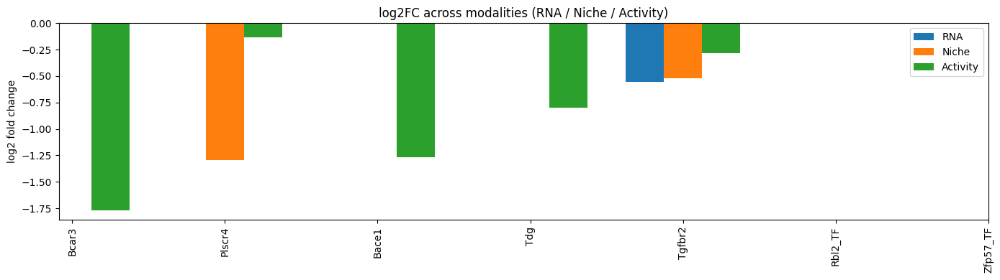

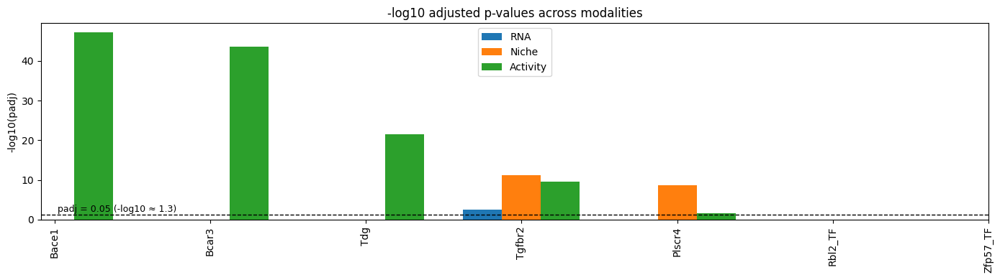

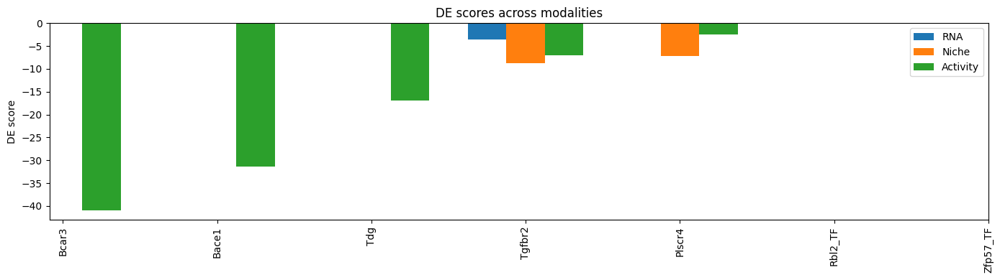

In [45]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# =====================
# 1. Load data
# =====================
all_sig = pd.read_csv(
    "../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_174155/ALL_Significant_Genes_Combined.csv",
    index_col=0
)
all_sig.index = all_sig.index.str.replace("_SIG","",regex=False)

deg_rna = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only/Tgfbr2_1_vs_KP_1-3/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_niche = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Niche/Tgfbr2_1_vs_KP_1-3/DEGs_padj_lt_0.05.csv",
    index_col=0
)

deg_activity = pd.read_csv(
    "../Scripts/GSEAPY_Enrichr_Only_Activity/Tgfbr2_1_vs_KP_1-3/DEGs_padj_lt_0.05.csv",
    index_col=0
)

# --- dedupe indices (just in case) ---
all_sig      = all_sig[~all_sig.index.duplicated(keep="first")]
deg_rna      = deg_rna[~deg_rna.index.duplicated(keep="first")]
deg_niche    = deg_niche[~deg_niche.index.duplicated(keep="first")]
deg_activity = deg_activity[~deg_activity.index.duplicated(keep="first")]

print("all_sig genes:", len(all_sig))  # should be 79

# =====================
# 2. Rename DEG columns so they are modality-specific
# =====================
deg_rna = deg_rna.rename(columns={
    "logfoldchanges": "logFC_rna",
    "pvals_adj": "padj_rna",
    "scores": "score_rna"
})
deg_niche = deg_niche.rename(columns={
    "logfoldchanges": "logFC_niche",
    "pvals_adj": "padj_niche",
    "scores": "score_niche"
})
deg_activity = deg_activity.rename(columns={
    "logfoldchanges": "logFC_activity",
    "pvals_adj": "padj_activity",
    "scores": "score_activity"
})

# =====================
# 3. Merge WITHOUT dropping any all_sig genes
# =====================
merged = all_sig.copy()  # all 79 genes

merged = (
    merged
    .join(deg_rna[["logFC_rna", "padj_rna", "score_rna"]], how="left")
    .join(deg_niche[["logFC_niche", "padj_niche", "score_niche"]], how="left")
    .join(deg_activity[["logFC_activity", "padj_activity", "score_activity"]], how="left")
)

print("genes after merge:", len(merged))  # should still be 79

# add -log10(padj) per modality (avoid infs from 0)
for col in ["padj_rna", "padj_niche", "padj_activity"]:
    merged[f"-log10_{col}"] = -np.log10(merged[col].replace(0, np.nan))

# =====================
# 3b. Create sort keys: "big → small"
# =====================
# strongest |logFC| across any modality
merged["logFC_sort"] = merged[["logFC_rna", "logFC_niche", "logFC_activity"]].abs().max(axis=1)

# most significant p-value (largest -log10 padj)
merged["padj_sort"] = merged[["-log10_padj_rna",
                              "-log10_padj_niche",
                              "-log10_padj_activity"]].max(axis=1)

# strongest |score| across modalities
merged["score_sort"] = merged[["score_rna", "score_niche", "score_activity"]].abs().max(axis=1)

# =====================
# helper for grouped barplots (with sorting high → low)
# =====================
def grouped_barplot(df, cols, labels, colors, ylabel, title,
                    dotted_line=False, sort_by=None, descending=True):
    if sort_by is not None and sort_by in df.columns:
        df_plot = df.sort_values(sort_by, ascending=not descending, na_position="last")
    else:
        df_plot = df.copy()

    genes = df_plot.index.to_list()
    x = np.arange(len(genes))
    width = 0.25

    plt.figure(figsize=(max(14, len(genes) * 0.35), 4))

    for i, (c, lab, colr) in enumerate(zip(cols, labels, colors)):
        if c in df_plot.columns:
            plt.bar(x + (i - 1) * width, df_plot[c], width, label=lab, color=colr)

    if dotted_line:
        plt.axhline(1.3, color="black", linestyle="--", linewidth=1)
        plt.text(0, 1.34, " padj = 0.05 (-log10 ≈ 1.3) ",
                 ha="left", va="bottom", fontsize=9)

    plt.xticks(x, genes, rotation=90)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

# =====================
# 4. Plots (all 79 genes, sorted big → small)
# =====================

# log2FC across modalities – sort by strongest |logFC| overall
grouped_barplot(
    merged,
    cols=["logFC_rna", "logFC_niche", "logFC_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="log2 fold change",
    title="log2FC across modalities (RNA / Niche / Activity)",
    sort_by="logFC_sort",
    descending=True
)

# -log10(padj) across modalities – sort by most significant p-value
grouped_barplot(
    merged,
    cols=["-log10_padj_rna", "-log10_padj_niche", "-log10_padj_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="-log10(padj)",
    title="-log10 adjusted p-values across modalities",
    dotted_line=True,
    sort_by="padj_sort",
    descending=True
)

# DEG scores across modalities – sort by strongest |score|
grouped_barplot(
    merged,
    cols=["score_rna", "score_niche", "score_activity"],
    labels=["RNA", "Niche", "Activity"],
    colors=["tab:blue", "tab:orange", "tab:green"],
    ylabel="DE score",
    title="DE scores across modalities",
    sort_by="score_sort",
    descending=True
)


# Sandbox

Activity to Niche

In [32]:
import os
import re
import pandas as pd
from datetime import datetime

# ========= PATHS (edit if needed) =========
SHAP_CSV     = "../Task2_CMP/capboost_cross_modal_analysis_20251204_134420/capboost_feature_feature_importance_activity_flux_niche.csv"
BIO_ACTIVITY = "../GenKI/GenKI_NB_Tgfbr2_SIG_20251115_173901/ALL_Significant_Genes_Combined.csv"
BIO_NICHE    = "../GenKI/GenKI_NB_Tgfbr2_20251115_171757/ALL_Significant_Genes_Combined.csv"

OUT_DIR = "../Mongoose_post_hoc/"
os.makedirs(OUT_DIR, exist_ok=True)
STAMP   = datetime.now().strftime("%Y%m%d_%H%M%S")
OUT_CSV = os.path.join(OUT_DIR, f"activity_to_niche_shap_edges_with_ranks_cluster0_{STAMP}.csv")

CLUSTERS_TO_KEEP = {0}   # UnitedNet cluster to retain


# ========= BASIC HELPERS =========
def clean_gene(x: str):
    if pd.isna(x):
        return None
    x = str(x).strip()
    x = re.sub(r"(_SIG|_TF)$", "", x, flags=re.IGNORECASE)
    return x.upper()


def pick_gene_col(df: pd.DataFrame) -> str:
    prefer_exact = {"gene", "symbol", "genes", "names", "name", "gene_name", "Unnamed: 0"}
    for c in df.columns:
        if c in prefer_exact or c.lower() in prefer_exact:
            return c
    obj_cols = [c for c in df.columns if df[c].dtype == "O"]
    return obj_cols[0] if obj_cols else df.columns[0]


def pick_rank_col(df: pd.DataFrame) -> str:
    # Prefer a column literally called "rank"
    for c in df.columns:
        if c.lower() == "rank":
            return c
    # fallback: first numeric
    num_cols = [c for c in df.columns if pd.api.types.is_numeric_dtype(df[c])]
    return num_cols[0] if num_cols else df.columns[0]


def load_gene_rank_lookup(path: str, role: str) -> pd.DataFrame:
    df = pd.read_csv(path)
    gcol = pick_gene_col(df)
    rcol = pick_rank_col(df)

    print(f"[INFO] {role}: gene='{gcol}', rank='{rcol}'")

    df["gene_clean"] = df[gcol].map(clean_gene)
    df = df.dropna(subset=["gene_clean"])
    df[rcol] = pd.to_numeric(df[rcol], errors="coerce")

    ser = df.groupby("gene_clean")[rcol].min().rename(f"{role}_rank")
    return ser.reset_index()


# ========= LOAD RANKS =========
# Activity ranks will be used for SOURCE genes
# Niche ranks will be used for TARGET genes
activity_lookup = load_gene_rank_lookup(BIO_ACTIVITY, role="activity")
niche_lookup    = load_gene_rank_lookup(BIO_NICHE,    role="niche")

print(f"[INFO] Loaded ranks: activity={len(activity_lookup)}, niche={len(niche_lookup)}")


# ========= LOAD SHAP =========
shap = pd.read_csv(SHAP_CSV)

# We know the column names now; be explicit to avoid mis-detection
if "Source" not in shap.columns or "Target" not in shap.columns:
    raise ValueError(f"Expected 'Source' and 'Target' in SHAP file. Got: {list(shap.columns)}")

src_col = "Source"   # ACTIVITY
tgt_col = "Target"   # NICHE

# Cluster column
if "Cluster" in shap.columns:
    shap["cluster_num"] = pd.to_numeric(shap["Cluster"], errors="coerce")
    shap = shap[shap["cluster_num"].isin(CLUSTERS_TO_KEEP)].copy()
else:
    print("[WARN] No 'Cluster' column found – skipping cluster filtering.")

# Optional: restrict to ACTIVITY -> NICHE edges using Direction column, if present
if "Direction" in shap.columns:
    shap = shap[shap["Direction"] == "ACTIVITY -> NICHE"].copy()

# === VALUE COLUMN: FORCE 'Value' ===
if "Value" not in shap.columns:
    raise ValueError(f"'Value' column (SHAP weight) not found in SHAP file. Columns: {list(shap.columns)}")

val_col = "Value"
shap[val_col] = pd.to_numeric(shap[val_col], errors="coerce")
print(f"[INFO] Using SHAP value column: {val_col} (non-null={shap[val_col].notna().sum()})")


# ========= CLEAN, MERGE WITH RANKS, FILTER =========
cols = [src_col, tgt_col, val_col] + (["cluster_num"] if "cluster_num" in shap.columns else [])
df = shap[cols].copy()
df = df.rename(columns={src_col: "source", tgt_col: "target", val_col: "value"})

df["source_clean"] = df["source"].map(clean_gene)
df["target_clean"] = df["target"].map(clean_gene)

# Merge activity ranks to SOURCE (activity) and niche ranks to TARGET (niche)
df = df.merge(activity_lookup, how="left", left_on="source_clean", right_on="gene_clean").drop(columns=["gene_clean"])
df = df.merge(niche_lookup,    how="left", left_on="target_clean", right_on="gene_clean").drop(columns=["gene_clean"])

filtered = df[df["activity_rank"].notna() & df["niche_rank"].notna()].copy()

# Sort by SHAP value (descending) then by ranks (ascending)
filtered = filtered.sort_values(
    ["value", "activity_rank", "niche_rank"],
    ascending=[False, True, True]
).reset_index(drop=True)

# ========= OUTPUT =========
out_cols = ["source", "target", "value", "activity_rank", "niche_rank"]
if "cluster_num" in filtered.columns:
    out_cols.insert(0, "cluster_num")

filtered_out = filtered[out_cols]
filtered_out.to_csv(OUT_CSV, index=False)

print(f"\nSaved: {OUT_CSV}")
print(f"Rows={len(filtered_out)}, Unique sources={filtered_out['source'].nunique()}, Unique targets={filtered_out['target'].nunique()}")
print(filtered_out.head(20))


[INFO] activity: gene='Unnamed: 0', rank='rank'
[INFO] niche: gene='Unnamed: 0', rank='rank'
[INFO] Loaded ranks: activity=72, niche=79
[INFO] Using SHAP value column: Value (non-null=2500)

Saved: ../Mongoose_post_hoc/activity_to_niche_shap_edges_with_ranks_cluster0_20251204_163857.csv
Rows=1221, Unique sources=37, Unique targets=33
    cluster_num        source target     value  activity_rank  niche_rank
0             0     Zfp78_SIG  Ighg1  1.000000           11.0         3.0
1             0     Zfp78_SIG   Gpx3  1.000000           11.0        75.0
2             0  Slc25a43_SIG   Inmt  1.000000           15.0        47.0
3             0     Syt17_SIG   Gpx3  0.957785           38.0        75.0
4             0  Slc25a43_SIG   Gpx3  0.925431           15.0        75.0
5             0     Syt17_SIG   Inmt  0.925196           38.0        47.0
6             0       Eda_SIG   Gpx3  0.876397           12.0        75.0
7             0       Eda_SIG   Inmt  0.849284           12.0        47.

In [1]:
import os
import re
import pandas as pd
from datetime import datetime

# ========= PATHS (edit if needed) =========
SHAP_CSV     = "../Task2_CMP/capboost_cross_modal_analysis_20251115_164209/capboost_feature_feature_importance_activity_flux_niche.csv"
BIO_NICHE    = "../GenKI/GenKI_NB_Tgfbr2_20251115_171757/ALL_Significant_Genes_Combined.csv"

OUT_DIR = "../Mongoose_post_hoc/"
os.makedirs(OUT_DIR, exist_ok=True)
STAMP   = datetime.now().strftime("%Y%m%d_%H%M%S")
OUT_CSV = os.path.join(OUT_DIR, f"niche_to_flux_shap_edges_with_ranks_cluster0_{STAMP}.csv")

CLUSTERS_TO_KEEP = {0}   # UnitedNet cluster to retain


# ========= BASIC HELPERS =========
def clean_gene(x: str):
    if pd.isna(x):
        return None
    x = str(x).strip()
    x = re.sub(r"(_SIG|_TF)$", "", x, flags=re.IGNORECASE)
    return x.upper()


def pick_gene_col(df: pd.DataFrame) -> str:
    prefer_exact = {"gene", "symbol", "genes", "names", "name", "gene_name", "Unnamed: 0"}
    for c in df.columns:
        if c in prefer_exact or c.lower() in prefer_exact:
            return c
    obj_cols = [c for c in df.columns if df[c].dtype == "O"]
    return obj_cols[0] if obj_cols else df.columns[0]


def pick_rank_col(df: pd.DataFrame) -> str:
    # Prefer a column literally called "rank"
    for c in df.columns:
        if c.lower() == "rank":
            return c
    # fallback: first numeric
    num_cols = [c for c in df.columns if pd.api.types.is_numeric_dtype(df[c])]
    return num_cols[0] if num_cols else df.columns[0]


def load_gene_rank_lookup(path: str, role: str) -> pd.DataFrame:
    df = pd.read_csv(path)
    gcol = pick_gene_col(df)
    rcol = pick_rank_col(df)

    print(f"[INFO] {role}: gene='{gcol}', rank='{rcol}'")

    df["gene_clean"] = df[gcol].map(clean_gene)
    df = df.dropna(subset=["gene_clean"])
    df[rcol] = pd.to_numeric(df[rcol], errors="coerce")

    ser = df.groupby("gene_clean")[rcol].min().rename(f"{role}_rank")
    return ser.reset_index()


# ========= LOAD RANKS =========
# Niche ranks will be used for SOURCE genes (NICHE → FLUX)
niche_lookup = load_gene_rank_lookup(BIO_NICHE, role="niche")

print(f"[INFO] Loaded ranks: niche={len(niche_lookup)}")


# ========= LOAD SHAP =========
shap = pd.read_csv(SHAP_CSV)

# We know the column names now; be explicit to avoid mis-detection
if "Source" not in shap.columns or "Target" not in shap.columns:
    raise ValueError(f"Expected 'Source' and 'Target' in SHAP file. Got: {list(shap.columns)}")

src_col = "Source"   # NICHE genes
tgt_col = "Target"   # FLUX metabolites

# Cluster column
if "Cluster" in shap.columns:
    shap["cluster_num"] = pd.to_numeric(shap["Cluster"], errors="coerce")
    shap = shap[shap["cluster_num"].isin(CLUSTERS_TO_KEEP)].copy()
else:
    print("[WARN] No 'Cluster' column found – skipping cluster filtering.")

# CRITICAL: restrict to NICHE -> FLUX edges using Direction column
if "Direction" in shap.columns:
    shap = shap[shap["Direction"] == "NICHE -> FLUX"].copy()
    print(f"[INFO] Filtered to NICHE -> FLUX edges: {len(shap)} rows")
else:
    print("[WARN] No 'Direction' column found – cannot filter to NICHE -> FLUX!")

# === VALUE COLUMN: FORCE 'Value' ===
if "Value" not in shap.columns:
    raise ValueError(f"'Value' column (SHAP weight) not found in SHAP file. Columns: {list(shap.columns)}")

val_col = "Value"
shap[val_col] = pd.to_numeric(shap[val_col], errors="coerce")
print(f"[INFO] Using SHAP value column: {val_col} (non-null={shap[val_col].notna().sum()})")


# ========= CLEAN, MERGE WITH RANKS, FILTER =========
cols = [src_col, tgt_col, val_col] + (["cluster_num"] if "cluster_num" in shap.columns else [])
df = shap[cols].copy()
df = df.rename(columns={src_col: "source", tgt_col: "target", val_col: "value"})

df["source_clean"] = df["source"].map(clean_gene)
# Note: FLUX targets are metabolites, so we don't clean them the same way
# Keep target as-is for metabolite names

# Merge niche ranks to SOURCE (niche genes)
df = df.merge(niche_lookup, how="left", left_on="source_clean", right_on="gene_clean").drop(columns=["gene_clean"])

# Filter to keep only edges where SOURCE has a niche rank (i.e., is in GenKI results)
filtered = df[df["niche_rank"].notna()].copy()

# Sort by SHAP value (descending) then by niche rank (ascending)
filtered = filtered.sort_values(
    ["value", "niche_rank"],
    ascending=[False, True]
).reset_index(drop=True)

# ========= OUTPUT =========
out_cols = ["source", "target", "value", "niche_rank"]
if "cluster_num" in filtered.columns:
    out_cols.insert(0, "cluster_num")

filtered_out = filtered[out_cols]
filtered_out.to_csv(OUT_CSV, index=False)

print(f"\n{'='*60}")
print(f"SAVED: {OUT_CSV}")
print(f"{'='*60}")
print(f"Total rows: {len(filtered_out)}")
print(f"Unique NICHE sources: {filtered_out['source'].nunique()}")
print(f"Unique FLUX targets: {filtered_out['target'].nunique()}")
print(f"\nTop 20 NICHE → FLUX connections:")
print(filtered_out.head(20))

[INFO] niche: gene='Unnamed: 0', rank='rank'
[INFO] Loaded ranks: niche=79
[INFO] Filtered to NICHE -> FLUX edges: 2500 rows
[INFO] Using SHAP value column: Value (non-null=2500)

SAVED: ../Mongoose_post_hoc/niche_to_flux_shap_edges_with_ranks_cluster0_20251207_201807.csv
Total rows: 1650
Unique NICHE sources: 33
Unique FLUX targets: 50

Top 20 NICHE → FLUX connections:
    cluster_num  source                        target  value  niche_rank
0             0  Ighg2c                Deoxyadenosine    1.0         2.0
1             0  Ighg2c                           G6P    1.0         2.0
2             0  Ighg2c                     Succinate    1.0         2.0
3             0   Ighg1                     Histidine    1.0         3.0
4             0   Ighg1                    Isoleucine    1.0         3.0
5             0    Igkc                           XMP    1.0        12.0
6             0  Ighg2c  (Gal)2 (GlcA)1 (Xyl)1 (Ser)1    1.0         2.0
7             0  Ighg2c                    